In [182]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [183]:
df = pd.read_excel(r'C:\Users\mrosk\OneDrive\Desktop\Mental-Health-in-Tech\Preprocessing\encoded_data.xlsx')

In [184]:
df.drop(df.columns[0], inplace = True, axis =1)

In [185]:
df.head()

,is_self_employed,num_employees,is_tech_company,provides_mental_health_benefits,has_discussed_mental_health,offers_mental_health_resources,is_anonymity_protected,ease_of_leave_for_mental_health,mental_health_discussion_consequences,physical_health_discussion_consequences,...,front_end_developer,hr_rep,one_person_shop,other_job_description,sales_rep,supervisor_team_lead,support_rep,gender_Female,gender_Male,gender_Non-Binary/Other
0,0,3,1,2,1,1,0,6,1,1,...,0,0,0,0,0,0,0,False,True,False
1,0,2,1,1,3,3,3,4,1,1,...,1,0,0,0,0,0,0,False,True,False
2,0,2,1,1,1,1,0,1,0,1,...,0,0,0,0,0,0,0,False,True,False
3,1,0,2,3,2,2,2,2,2,2,...,0,0,0,0,0,1,0,False,True,False
4,0,2,0,4,1,1,1,1,3,0,...,1,0,0,0,0,1,1,True,False,False


In [186]:
#Includes all diagnosis and work position features
df.drop(df.columns[0], inplace = True, axis = 1) 

features_to_drop = [
    'y__dissociative', 'y_eating', 'y_ocd', 'y_psychotic', 'm_adhd', 'm_eating', 
    'm_mood_disorder', 'm_ocd', 'm_personality', 'm_ptsd', 'm_psychotic', 
    'pro_dissociative', 'pro_eating',  'pro_ocd', 'pro_psychotic', 'y_addictive', 
    'y_anxiety_stress', 'y_mood_disorder', 'y_autism_develop', 'y_other', 'y_ptsd', 'y_adhd', 
    'y_personality', 'm_addictive', 'm_anxiety_stress', 'm_autism_develop', 'm_other', 'm_dissociative', 
    'pro_adhd', 'pro_addictive', 'pro_anxiety_stress', 'pro_autism_develop', 'pro_mood_disorder', 
    'pro_ptsd', 'pro_personality', 'pro_other', 'back_end_developer', 'designer', 'dev_evangelist_advocate', 
    'devops_sysadmin', 'executive_leadership', 'front_end_developer', 'hr_rep', 'one_person_shop', 
    'other_job_description', 'sales_rep', 'supervisor_team_lead', 'support_rep', 'y_no_diagnosis', 'pro_no_diagnosis', 'm_no_diagnosis'
]



df = df.drop(columns = features_to_drop)

'''
Already have detailed information about the most prevalent work positions and the current, believed, and professionally diagnosed disorders from your exploratory data analysis (EDA), 
dropping these features could help reduce redundant dimensionality. This can be particularly beneficial for improving model performance and interpretability by removing potential noise.
'''

'\nAlready have detailed information about the most prevalent work positions and the current, believed, and professionally diagnosed disorders from your exploratory data analysis (EDA), \ndropping these features could help reduce redundant dimensionality. This can be particularly beneficial for improving model performance and interpretability by removing potential noise.\n'

In [187]:
#normalize data

from sklearn.preprocessing import StandardScaler, MinMaxScaler

S_scaler = StandardScaler()
Z_standard = S_scaler.fit_transform(df)


MM_scaler = MinMaxScaler()
Z_minmax = MM_scaler.fit_transform(df)

In [188]:
#Feature Selection
from sklearn.feature_selection import VarianceThreshold, SelectKBest, mutual_info_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans

In [189]:
#Variance Threshold
selector = VarianceThreshold(threshold=0.1)
data_high_variance_MM = selector.fit_transform(Z_minmax)
print('Number of features after variance thresholding:' , data_high_variance_MM.shape[1])

feature_mask = selector.get_support()
feature_names = df.columns[feature_mask]
print(feature_names)

''' 
Analysis: The variance threshold method is a good initial filter for removing features with very low variance, which are likely uninformative.
Advice: Since it retained 25 features, this method effectively reduced the feature space. Ensure these features are still relevant to your analysis.

Result with Standard Scaler: Using the Standard Scaler, the Variance Threshold method did not remove any features, retaining all original features.
Implication: This suggests that all features have variances above the specified threshold. 
It implies that none of the features are constant or near-constant in the scaled data, 
which can happen if the features have similar scales and ranges after standardization.
'''


Number of features after variance thresholding: 25
Index(['num_employees', 'provides_mental_health_benefits',
       'offers_mental_health_resources', 'is_anonymity_protected',
       'mental_health_discussion_consequences',
       'comfort_discussing_mental_health_with_coworkers',
       'comfort_discussing_mental_health_with_supervisor',
       'employer_values_mental_equal_physical', 'has_previous_employers',
       'previous_employers_mental_health_benefits',
       'aware_of_mental_health_care_options_previous',
       'anonymity_protected_previous_employers',
       'mental_health_discussion_consequences_previous',
       'willing_discuss_physical_health_in_interview',
       'identified_mental_health_impact_career',
       'team_view_negatively_mental_health', 'family_history_mental_illness',
       'had_mental_health_disorder_past',
       'currently_has_mental_health_disorder', 'diagnosed_by_professional',
       'sought_mental_health_treatment', 'interference_with_work_when_t

' \nAnalysis: The variance threshold method is a good initial filter for removing features with very low variance, which are likely uninformative.\nAdvice: Since it retained 25 features, this method effectively reduced the feature space. Ensure these features are still relevant to your analysis.\n\nResult with Standard Scaler: Using the Standard Scaler, the Variance Threshold method did not remove any features, retaining all original features.\nImplication: This suggests that all features have variances above the specified threshold. \nIt implies that none of the features are constant or near-constant in the scaled data, \nwhich can happen if the features have similar scales and ranges after standardization.\n'

In [190]:
#Mutual Information 
kmeans_initial = KMeans(n_clusters=3, random_state=42)
initial_labels = kmeans_initial.fit_predict(df)
initial_labels_S = kmeans_initial.fit_predict(Z_standard)
selector =SelectKBest(mutual_info_classif,k=10)
data_selected_mi_S = selector.fit_transform(df,initial_labels_S)
feature_mask_S = selector.get_support()
feature_names_S = df.columns[feature_mask_S]
print('Top Features (Mutual Information) - Standard Scaler:', data_selected_mi_S.shape[1])
print(feature_names_S)

'''
Standard Scaler:

Analysis: The selected features focus on previous employers' mental health policies and the individual's mental health history.
Advice: This selection is insightful as it highlights both organizational and personal factors affecting mental health.
'''

kmeans_initial = KMeans(n_clusters=4, random_state=42)
initial_labels_MM = kmeans_initial.fit_predict(Z_minmax)
selector =SelectKBest(mutual_info_classif,k=10)
data_selected_mi_MM = selector.fit_transform(df,initial_labels)
feature_mask_MM = selector.get_support()
feature_names_MM = df.columns[feature_mask]
print('Top Features (Mutual Information) - MinMax Scaler:', data_selected_mi_MM.shape[1])
feature_mask_S = selector.get_support()
feature_names_MM = df.columns[feature_mask_MM]
print(feature_names_MM)

''' 
MinMax Scaler:

Analysis: The selected features include more general mental health-related questions and demographic information (gender).
Advice: Including demographic information can be useful but ensure it doesn’t introduce bias in your analysis.
'''

Top Features (Mutual Information) - Standard Scaler: 10
Index(['has_previous_employers', 'previous_employers_discussed_mental_health',
       'previous_employers_offered_mental_health_resources',
       'physical_health_discussion_consequences_previous',
       'willing_discuss_mental_health_previous_coworkers',
       'willing_discuss_mental_health_previous_supervisor',
       'observed_neg_consequences_previous_workplaces',
       'had_mental_health_disorder_past', 'diagnosed_by_professional',
       'sought_mental_health_treatment'],
      dtype='object')
Top Features (Mutual Information) - MinMax Scaler: 10
Index(['is_tech_company', 'ease_of_leave_for_mental_health',
       'mental_health_discussion_consequences',
       'physical_health_discussion_consequences',
       'comfort_discussing_mental_health_with_coworkers',
       'comfort_discussing_mental_health_with_supervisor',
       'physical_health_discussion_consequences_previous',
       'willing_discuss_mental_health_previous

' \nMinMax Scaler:\n\nAnalysis: The selected features include more general mental health-related questions and demographic information (gender).\nAdvice: Including demographic information can be useful but ensure it doesn’t introduce bias in your analysis.\n'

For Standard Scale:
anonymity_protected_previous_employers
num_employees
team_view_negatively_mental_health
ease_of_leave_for_mental_health
provides_mental_health_benefits
willing_share_mental_health_with_friends_family
age
previous_employers_valued_mental_equal_physical
aware_of_mental_health_care_options_previous
mental_health_discussion_consequences_previous
previous_employers_mental_health_benefits
family_history_mental_illness
willing_discuss_mental_health_previous_supervisor
previous_employers_discussed_mental_health
interference_with_work_when_not_treated
physical_health_discussion_consequences_previous
previous_employers_offered_mental_health_resources
willing_discuss_mental_health_previous_coworkers
has_previous_employers
observed_neg_consequences_previous_workplaces
interference_with_work_when_treated
currently_has_mental_health_disorder
sought_mental_health_treatment
diagnosed_by_professional
had_mental_health_disorder_past


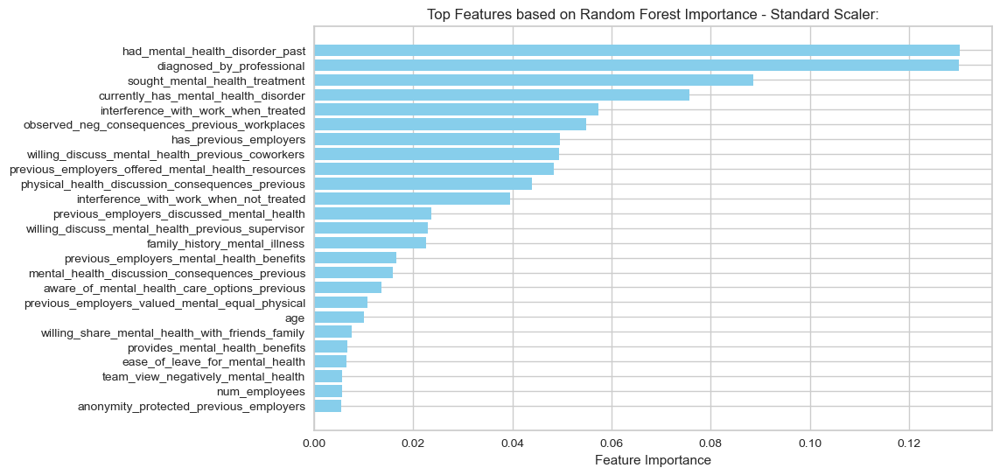



For MinMax Scale:
employer_values_mental_equal_physical
comfort_discussing_mental_health_with_supervisor
family_history_mental_illness
provides_mental_health_benefits
mental_health_discussion_consequences_previous
aware_of_mental_health_care_options_previous
previous_employers_mental_health_benefits
is_anonymity_protected
mental_health_discussion_consequences
age
has_discussed_mental_health
offers_mental_health_resources
currently_has_mental_health_disorder
comfort_discussing_mental_health_with_coworkers
interference_with_work_when_not_treated
observed_neg_consequences_for_coworkers
interference_with_work_when_treated
physical_health_discussion_consequences
is_tech_company
num_employees
had_mental_health_disorder_past
diagnosed_by_professional
sought_mental_health_treatment
gender_Female
gender_Male


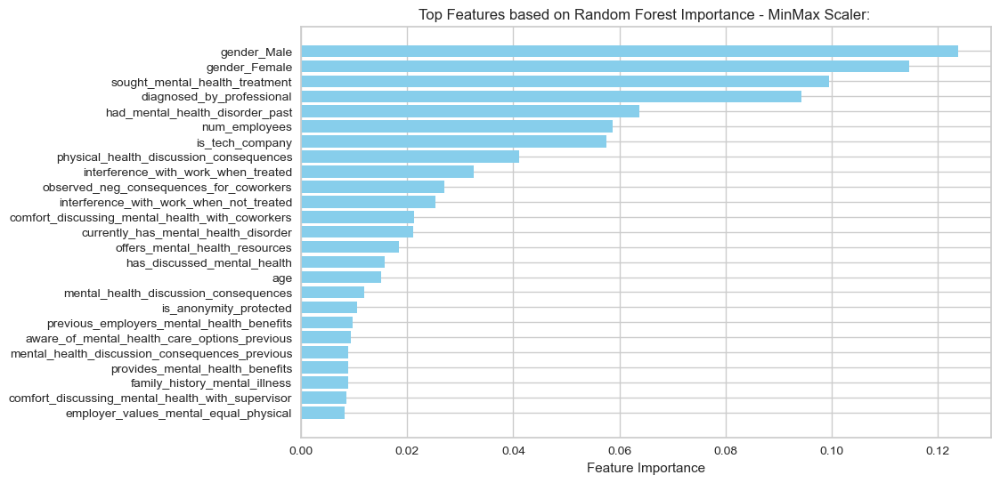

' \nMinMax Scaler:\n\nAnalysis: This includes demographic information and organizational factors.\nAdvice: Similar to the Mutual Information advice, ensure demographic factors are used appropriately to avoid biased outcomes.\n'

In [191]:
#Feature Importance from Random Forest 
clf = RandomForestClassifier(random_state=42)
clf.fit(df,initial_labels_S)
importances = clf.feature_importances_
indices = np.argsort(importances)[-25:]
data_selected_rf = df.iloc[:, indices]
feature_names_rf = df.columns[indices]

print('For Standard Scale:')
for feature in feature_names_rf:
    print(feature)

#Visualization of feature importance based on Random Forest
plt.figure(figsize=(10,6))
plt.barh(df.columns[indices], importances[indices], color ='skyblue')
plt.xlabel('Feature Importance')
plt.title('Top Features based on Random Forest Importance - Standard Scaler:')
plt.show()

''' 
Standard Scaler:

Analysis: The selected features emphasize personal mental health history and experiences with previous employers.
Advice: This aligns well with the goal of identifying key factors related to mental health in the tech industry. Consider the top features for deeper analysis.
'''
print('\n')

print('For MinMax Scale:')
#Feature Importance from Random Forest 
clf = RandomForestClassifier(random_state=42)
clf.fit(df,initial_labels_MM)
importances = clf.feature_importances_
indices = np.argsort(importances)[-25:]
data_selected_rf = df.iloc[:, indices]
feature_names_rf = df.columns[indices]

for feature in feature_names_rf:
    print(feature)

#Visualization of feature importance based on Random Forest
plt.figure(figsize=(10,6))
plt.barh(df.columns[indices], importances[indices], color ='skyblue')
plt.xlabel('Feature Importance')
plt.title('Top Features based on Random Forest Importance - MinMax Scaler: ')
plt.show()

''' 
MinMax Scaler:

Analysis: This includes demographic information and organizational factors.
Advice: Similar to the Mutual Information advice, ensure demographic factors are used appropriately to avoid biased outcomes.
'''


In [192]:
#The features that are selected below are a combination of all feature selection techniques will apply Dimensionality reduction to them and reiterate.

top_features = [
    'had_mental_health_disorder_past', 'diagnosed_by_professional', 
    'sought_mental_health_treatment', 'currently_has_mental_health_disorder', 
    'interference_with_work_when_treated', 'observed_neg_consequences_previous_workplaces', 
    'has_previous_employers', 'willing_discuss_mental_health_previous_coworkers', 
    'previous_employers_offered_mental_health_resources', 'previous_employers_discussed_mental_health', 
    'gender_Male', 'gender_Female', 'num_employees', 'is_tech_company', 
    'physical_health_discussion_consequences', 'interference_with_work_when_not_treated', 
    'observed_neg_consequences_for_coworkers', 'comfort_discussing_mental_health_with_coworkers', 
    'offers_mental_health_resources', 'age', 'provides_mental_health_benefits', 
    'is_anonymity_protected', 'mental_health_discussion_consequences', 
    'comfort_discussing_mental_health_with_supervisor', 'employer_values_mental_equal_physical', 
    'previous_employers_mental_health_benefits', 'aware_of_mental_health_care_options_previous', 
    'anonymity_protected_previous_employers', 'mental_health_discussion_consequences_previous', 
    'willing_discuss_physical_health_in_interview', 'identified_mental_health_impact_career', 
    'team_view_negatively_mental_health', 'family_history_mental_illness', 
    'works_remotely', 'willing_discuss_mental_health_previous_supervisor'
]

#from MinMax Scaler RF Importance
# top_features = [
#     'employer_values_mental_equal_physical', 'comfort_discussing_mental_health_with_supervisor',
#     'family_history_mental_illness', 'provides_mental_health_benefits',
#     'mental_health_discussion_consequences_previous', 'aware_of_mental_health_care_options_previous',
#     'previous_employers_mental_health_benefits', 'is_anonymity_protected',
#     'mental_health_discussion_consequences', 'age',
#     'has_discussed_mental_health', 'offers_mental_health_resources',
#     'currently_has_mental_health_disorder', 'comfort_discussing_mental_health_with_coworkers',
#     'interference_with_work_when_not_treated', 'observed_neg_consequences_for_coworkers',
#     'interference_with_work_when_treated', 'physical_health_discussion_consequences',
#     'is_tech_company', 'num_employees',
#     'had_mental_health_disorder_past', 'diagnosed_by_professional',
#     'sought_mental_health_treatment', 'gender_Female',
#     'gender_Male'
# ]

#from Standard Scaler RF Importance
# top_features = [
#     'employer_values_mental_equal_physical', 'comfort_discussing_mental_health_with_supervisor',
#     'family_history_mental_illness', 'provides_mental_health_benefits',
#     'mental_health_discussion_consequences_previous', 'aware_of_mental_health_care_options_previous',
#     'previous_employers_mental_health_benefits', 'is_anonymity_protected',
#     'mental_health_discussion_consequences', 'age',
#     'has_discussed_mental_health', 'offers_mental_health_resources',
#     'currently_has_mental_health_disorder', 'comfort_discussing_mental_health_with_coworkers',
#     'interference_with_work_when_not_treated', 'observed_neg_consequences_for_coworkers',
#     'interference_with_work_when_treated', 'physical_health_discussion_consequences',
#     'is_tech_company', 'num_employees',
#     'had_mental_health_disorder_past', 'diagnosed_by_professional',
#     'sought_mental_health_treatment', 'gender_Female',
#     'gender_Male'
# ]

data_selected = df[top_features]

scaler_S = StandardScaler()
data_selected_S = scaler_S.fit_transform(data_selected)
data_standard_df = pd.DataFrame(data_selected_S, columns=top_features)

scaler_MM = MinMaxScaler()
data_selected_MM = scaler_MM.fit_transform(data_selected)
data_minmax_df = pd.DataFrame(data_selected_MM, columns=top_features)


#Apply Dimensionality Reduction Methods:
from sklearn.decomposition import PCA, FastICA
from prince import MCA
from sklearn.manifold import MDS, LocallyLinearEmbedding, Isomap, TSNE
import umap

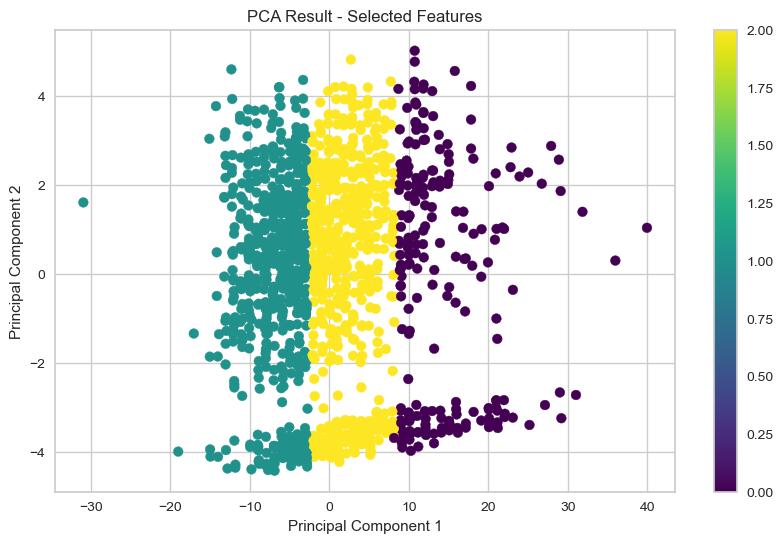

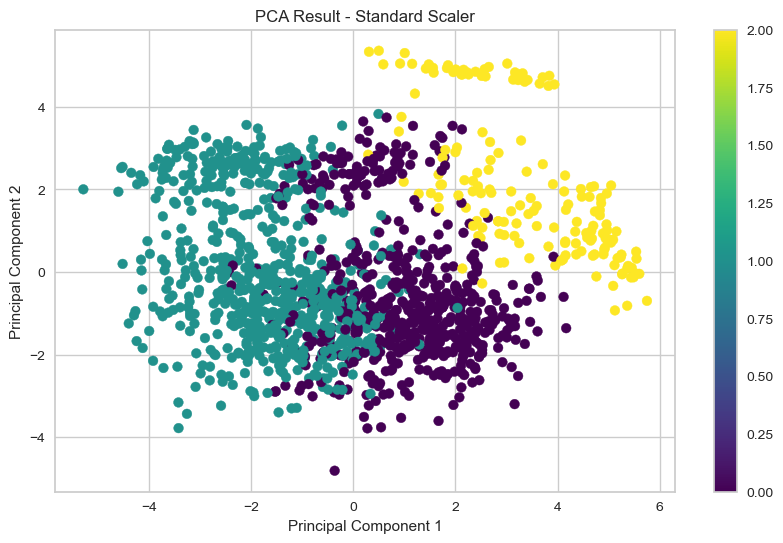

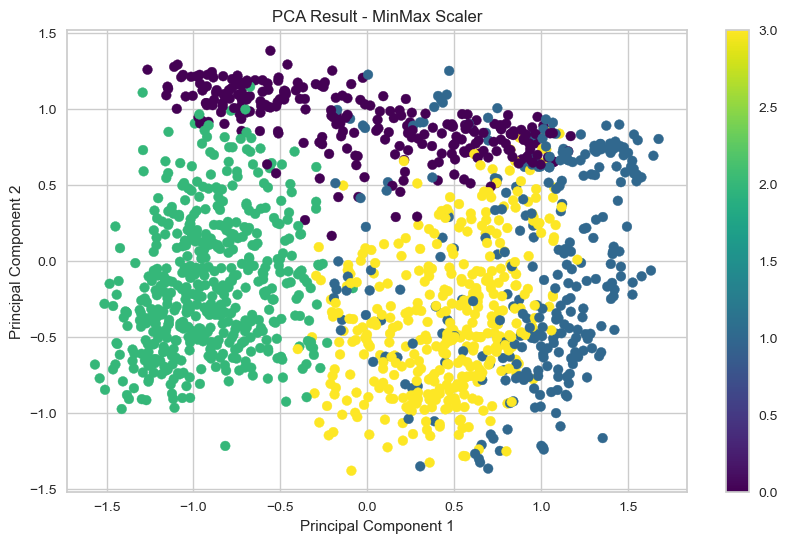

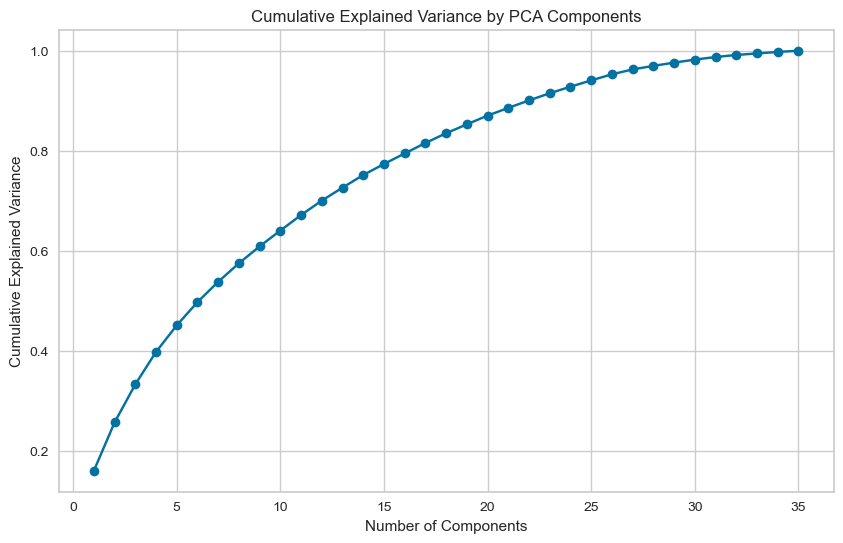

'\nPCA is a technique that reduces dimensionality by transforming features into principal components, \neach capturing the maximum variance possible. This helps simplify data while retaining its key variability.\n\n\nPCA Result - Selected Features:\nObservation: Clear and distinct cluster separation, indicating that the selected mental health features capture significant variance and effectively differentiate between groups.\n\nPCA Result - Standard Scaler:\nObservation: Balanced point distribution with noticeable cluster overlap. \nStandardization ensures equal feature contribution but may dilute the impact of highly informative features, resulting in less distinct clusters.\n\nPCA Result - MinMax Scaler:\nObservation: Distinct clusters with better separation. MinMax scaling preserves relative feature differences more effectively, \nhighlighting natural variance in the mental health data and improving cluster differentiation.\n'

In [152]:
#PCA 
pca = PCA(n_components=len(top_features))
pca_result= pca.fit_transform(data_selected)
pca_result_S = pca.fit_transform(data_selected_S)
pca_result_MM = pca.fit_transform(data_selected_MM)
explained_variance_pca = pca.explained_variance_ratio_.cumsum()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('PCA Result - Selected Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result_S[:, 0], pca_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('PCA Result - Standard Scaler')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result_MM[:, 0], pca_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('PCA Result - MinMax Scaler')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(range(1,len(explained_variance_pca) + 1), explained_variance_pca, marker = 'o')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

'''
PCA is a technique that reduces dimensionality by transforming features into principal components, 
each capturing the maximum variance possible. This helps simplify data while retaining its key variability.


PCA Result - Selected Features:
Observation: Clear and distinct cluster separation, indicating that the selected mental health features capture significant variance and effectively differentiate between groups.

PCA Result - Standard Scaler:
Observation: Balanced point distribution with noticeable cluster overlap. 
Standardization ensures equal feature contribution but may dilute the impact of highly informative features, resulting in less distinct clusters.

PCA Result - MinMax Scaler:
Observation: Distinct clusters with better separation. MinMax scaling preserves relative feature differences more effectively, 
highlighting natural variance in the mental health data and improving cluster differentiation.
'''




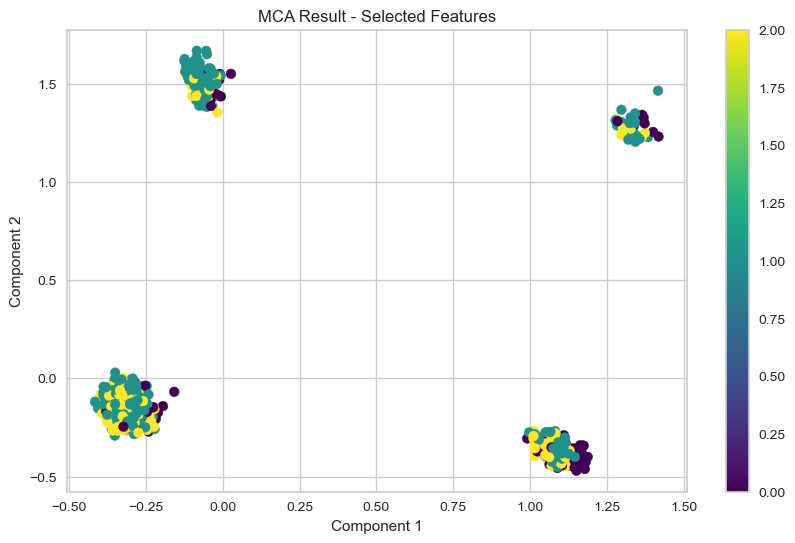

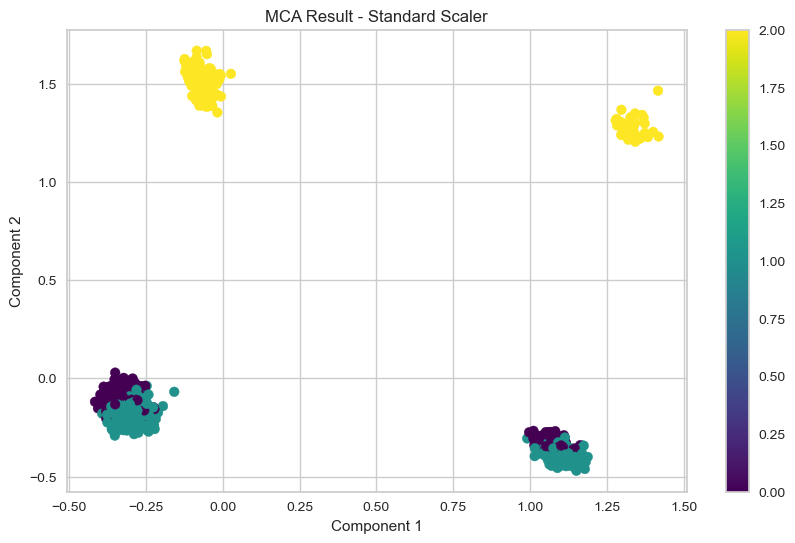

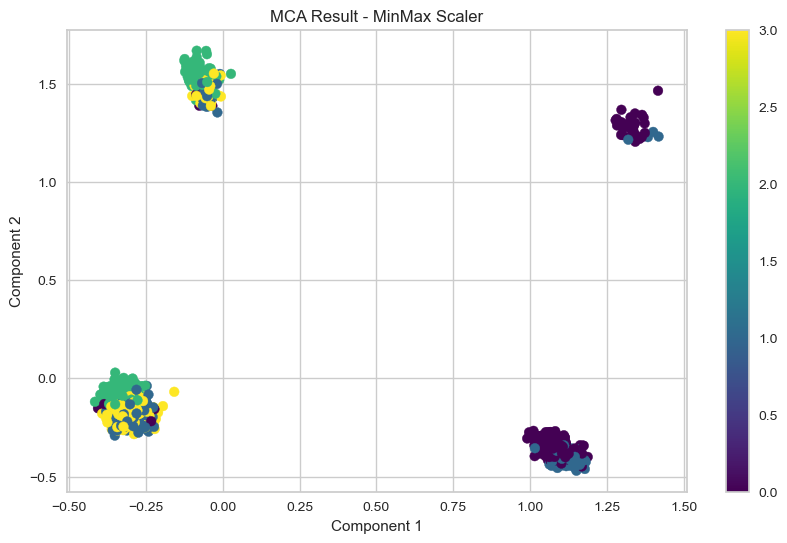

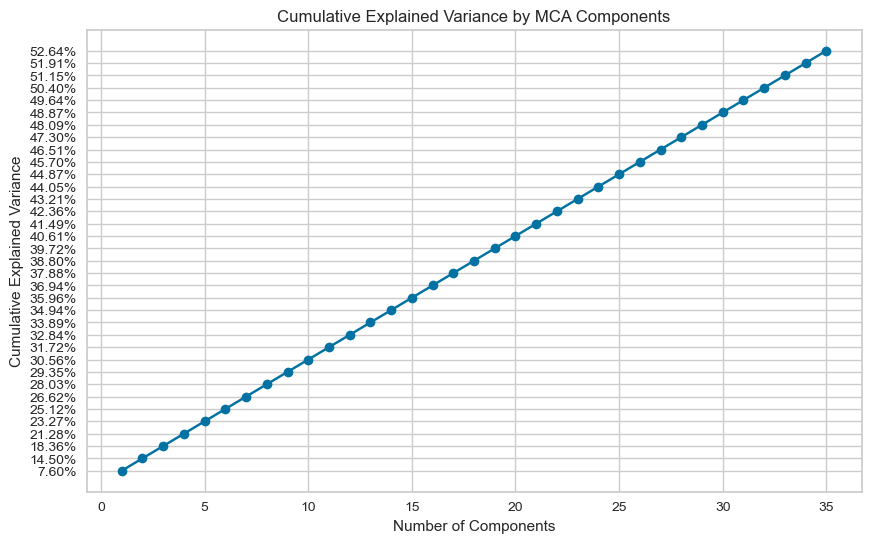

' \nMCA is a dimensionality reduction technique used for categorical data. \nIt transforms data into principal components that capture the most variance in the dataset, similar to PCA but for categorical variables.\n\nMCA Result - Selected Features:\nObservation: The scatter plot shows distinct clusters on either side of Component 1. \nThe separation indicates that the selected categorical features effectively capture the variance and differentiate between groups.\n\nMCA Result - Standard Scaler:\nObservation: The scatter plot shows similar clustering to the selected features, \nwith distinct groups on either side of Component 1. This suggests that standardization retains the variance captured by the categorical features, maintaining clear separation.\n\nMCA Result - MinMax Scaler:\nObservation: The scatter plot shows more compressed clusters compared to the standard scaler. \nThe MinMax scaling preserves relative differences between categorical features, resulting in a tighter groupin

In [153]:
#MCA 
mca = MCA(n_components = len(top_features))
mca_result = mca.fit_transform(data_selected)
mca_result_S = mca.fit_transform(data_standard_df)
mca_result_MM = mca.fit_transform(data_minmax_df)
explained_variance_mca =mca.eigenvalues_summary.iloc[:, 2].values

plt.figure(figsize=(10, 6))
plt.scatter(mca_result[0], mca_result[1], c=initial_labels, cmap='viridis')
plt.title('MCA Result - Selected Features')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mca_result_S[0], mca_result_S[1], c=initial_labels_S, cmap='viridis')
plt.title('MCA Result - Standard Scaler')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mca_result_MM[0], mca_result_MM[1], c=initial_labels_MM, cmap='viridis')
plt.title('MCA Result - MinMax Scaler')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

# Visualize MCA explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_mca) + 1), explained_variance_mca, marker='o')
plt.title('Cumulative Explained Variance by MCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

''' 
MCA is a dimensionality reduction technique used for categorical data. 
It transforms data into principal components that capture the most variance in the dataset, similar to PCA but for categorical variables.

MCA Result - Selected Features:
Observation: The scatter plot shows distinct clusters on either side of Component 1. 
The separation indicates that the selected categorical features effectively capture the variance and differentiate between groups.

MCA Result - Standard Scaler:
Observation: The scatter plot shows similar clustering to the selected features, 
with distinct groups on either side of Component 1. This suggests that standardization retains the variance captured by the categorical features, maintaining clear separation.

MCA Result - MinMax Scaler:
Observation: The scatter plot shows more compressed clusters compared to the standard scaler. 
The MinMax scaling preserves relative differences between categorical features, resulting in a tighter grouping but still clear separation.
'''





In [154]:
#MDS
mds = MDS (n_components=2, random_state=42, normalized_stress = 'auto')
mds_result = mds.fit_transform(data_selected)
mds_result_S = mds.fit_transform(data_selected_S)
mds_result_MM = mds.fit_transform(data_selected_MM)

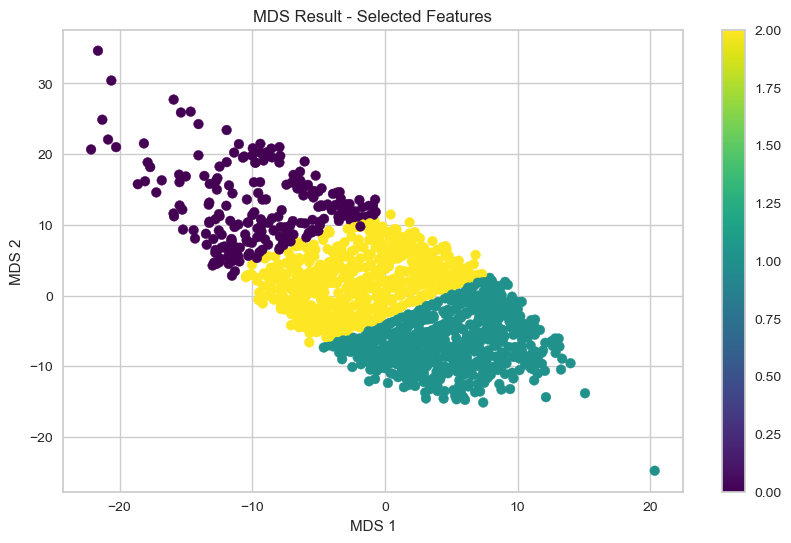

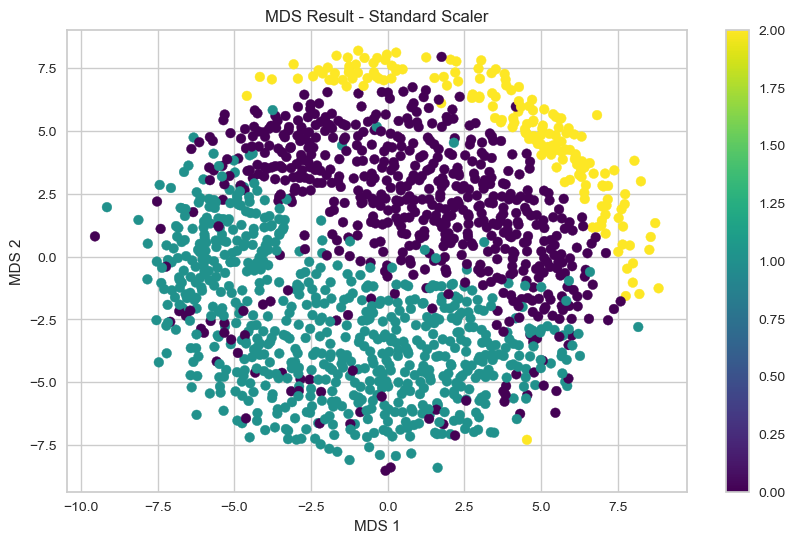

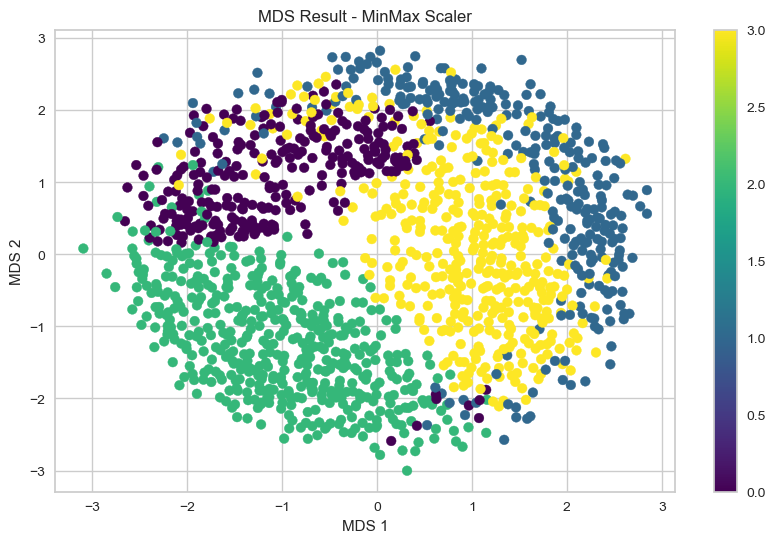

' \nMDS is a technique used to visualize the similarity or dissimilarity of data points in a lower-dimensional space. \nIt positions each object in N-dimensional space such that the between-object distances are preserved as well as possible. \nThe goal is to maintain the original distance relationships in the reduced dimensions.\n\n\nMDS Result - Selected Features:\nObservation: The scatter plot shows clear and distinct separation of clusters along the first dimension (MDS1). \nThis indicates that the selected features effectively capture the dissimilarity between groups, preserving the original distances well.\n\nMDS Result - Standard Scaler:\nObservation: The scatter plot shows a more circular distribution of points with significant cluster overlap. \nThe circular pattern suggests that the standard scaling equalizes feature contribution but may obscure the natural dissimilarities between clusters, leading to less clear separation.\n\nMDS Result - MinMax Scaler:\nObservation: The scat

In [155]:
plt.figure(figsize=(10, 6))
plt.scatter(mds_result[:, 0], mds_result[:, 1],c=initial_labels, cmap='viridis')
plt.title('MDS Result - Selected Features')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mds_result_S[:, 0], mds_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('MDS Result - Standard Scaler')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mds_result_MM[:, 0], mds_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('MDS Result - MinMax Scaler')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

''' 
MDS is a technique used to visualize the similarity or dissimilarity of data points in a lower-dimensional space. 
It positions each object in N-dimensional space such that the between-object distances are preserved as well as possible. 
The goal is to maintain the original distance relationships in the reduced dimensions.


MDS Result - Selected Features:
Observation: The scatter plot shows clear and distinct separation of clusters along the first dimension (MDS1). 
This indicates that the selected features effectively capture the dissimilarity between groups, preserving the original distances well.

MDS Result - Standard Scaler:
Observation: The scatter plot shows a more circular distribution of points with significant cluster overlap. 
The circular pattern suggests that the standard scaling equalizes feature contribution but may obscure the natural dissimilarities between clusters, leading to less clear separation.

MDS Result - MinMax Scaler:
Observation: The scatter plot also shows a circular distribution but with better separation compared to the standard scaler. 
MinMax scaling preserves relative differences more effectively, resulting in clearer cluster differentiation while still maintaining a circular layout.
'''

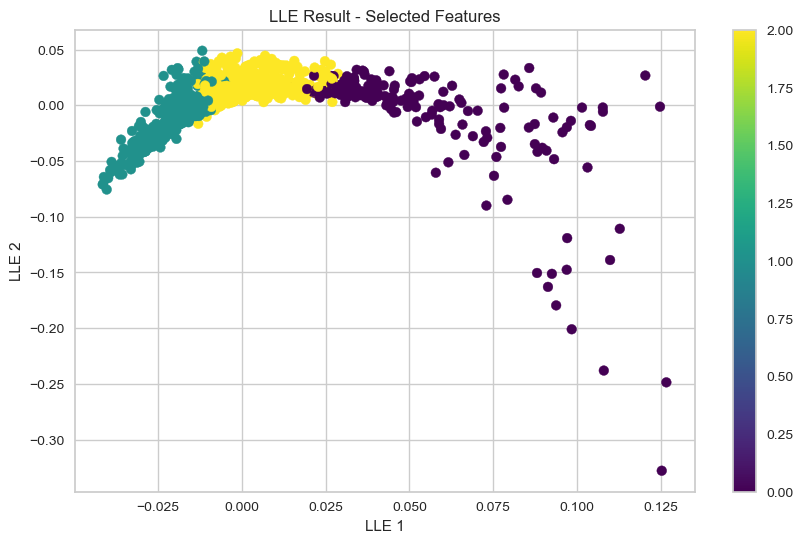

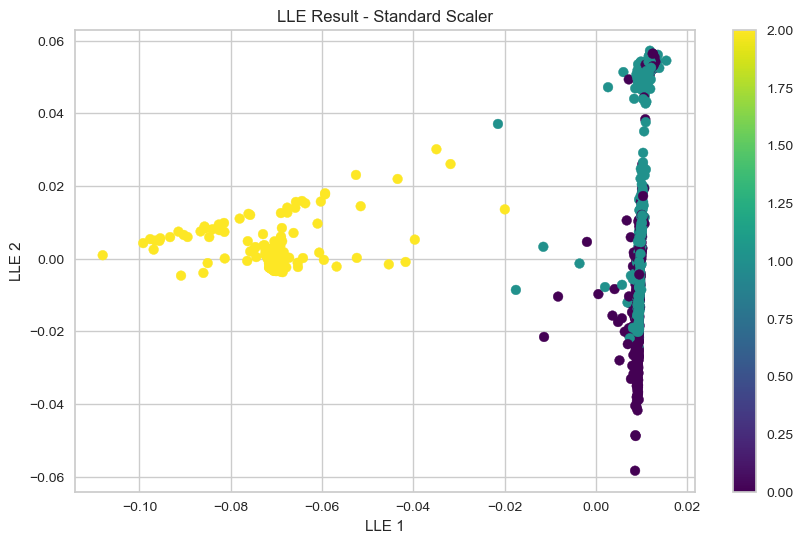

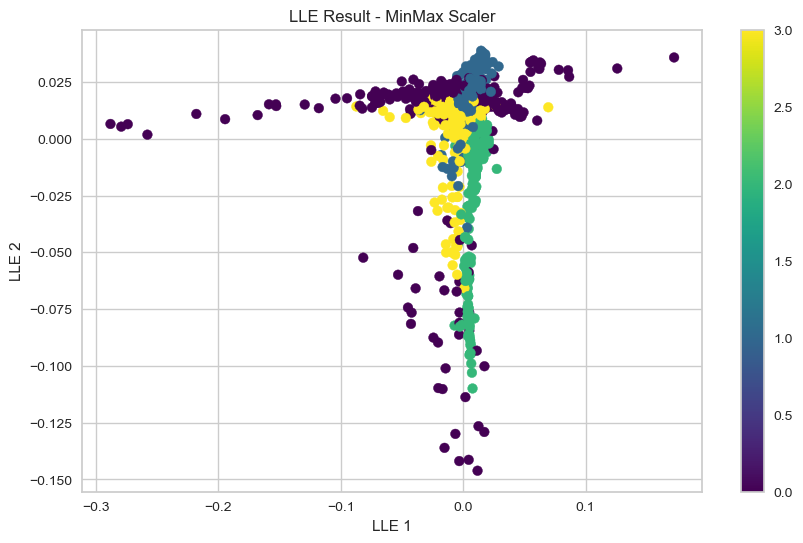

' \nLLE is a non-linear dimensionality reduction technique that preserves the local relationships of data points. \nIt aims to map data into a lower-dimensional space while maintaining the neighborhood structure of each data point.\n\n\nLLE Result - Selected Features:\nObservation: The scatter plot shows a stretched cluster formation with some distinct separation along LLE 1. \nThis indicates that the selected features capture local relationships, but there is some mixing of clusters.\n\nLLE Result - Standard Scaler:\nObservation: The scatter plot shows a more compressed distribution of points with less distinct cluster separation. \nhe standard scaler appears to cause a compression effect, reducing the ability to clearly separate clusters based on local relationships.\n\nLLE Result - MinMax Scaler:\nObservation: The scatter plot shows a more spread-out distribution with slightly better separation compared to the standard scaler. \nMinMax scaling preserves relative differences more eff

In [156]:
#lle
lle = LocallyLinearEmbedding(n_components=2,n_neighbors=10, random_state=42)
lle_result = lle.fit_transform(data_selected)
lle_result_S = lle.fit_transform(data_selected_S)
lle_result_MM = lle.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(lle_result[:, 0], lle_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('LLE Result - Selected Features')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(lle_result_S[:, 0], lle_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('LLE Result - Standard Scaler')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(lle_result_MM[:, 0], lle_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('LLE Result - MinMax Scaler')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

''' 
LLE is a non-linear dimensionality reduction technique that preserves the local relationships of data points. 
It aims to map data into a lower-dimensional space while maintaining the neighborhood structure of each data point.


LLE Result - Selected Features:
Observation: The scatter plot shows a stretched cluster formation with some distinct separation along LLE 1. 
This indicates that the selected features capture local relationships, but there is some mixing of clusters.

LLE Result - Standard Scaler:
Observation: The scatter plot shows a more compressed distribution of points with less distinct cluster separation. 
he standard scaler appears to cause a compression effect, reducing the ability to clearly separate clusters based on local relationships.

LLE Result - MinMax Scaler:
Observation: The scatter plot shows a more spread-out distribution with slightly better separation compared to the standard scaler. 
MinMax scaling preserves relative differences more effectively, but clusters are still mixed, indicating challenges in capturing local relationships clearly.
'''


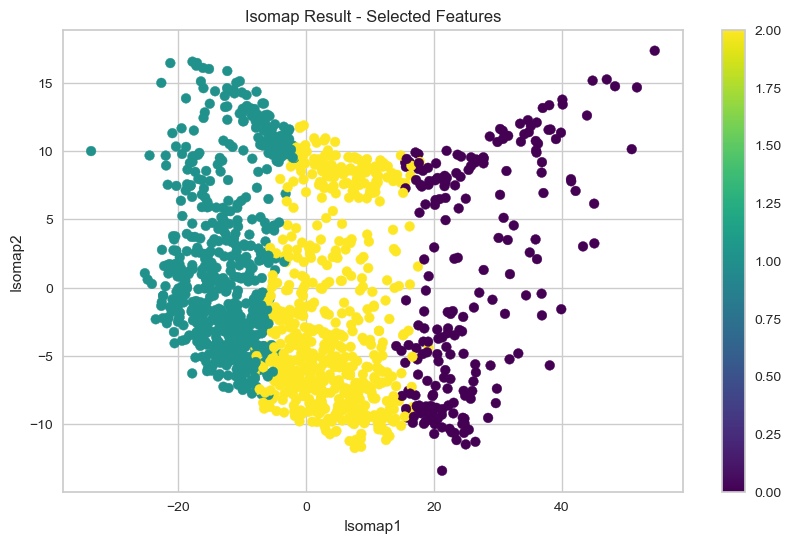

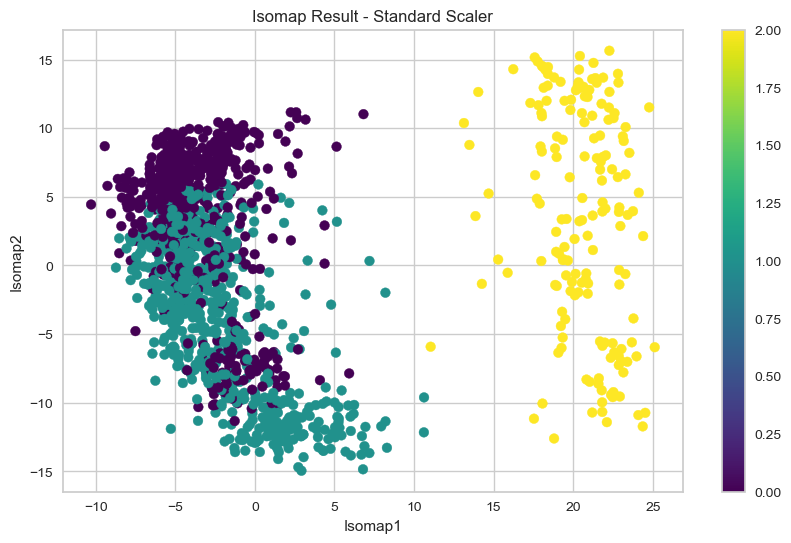

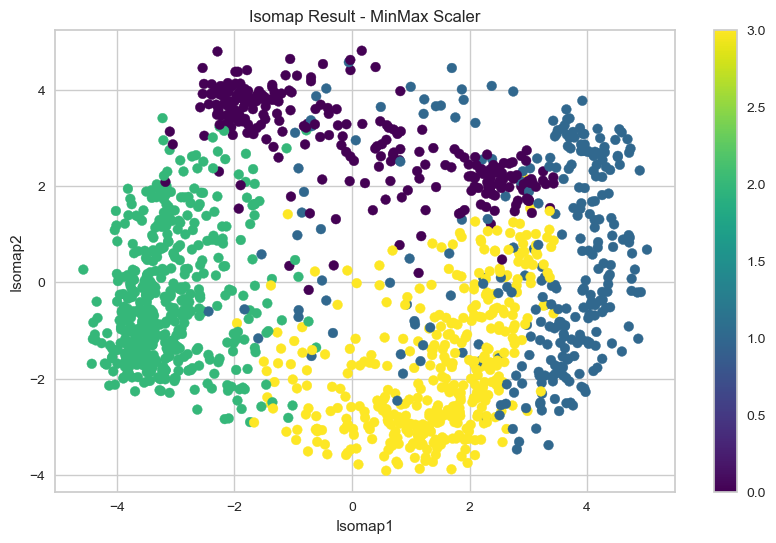

'\nIsomap is a non-linear dimensionality reduction technique that extends MDS by using geodesic distances on a neighborhood graph to preserve the global structure of the data. \nIt aims to maintain the manifold structure in a lower-dimensional space.\n\n\nIsomap Result - Selected Features:\nObservation: The scatter plot shows clear and distinct cluster separation along Isomap1, \nndicating that the selected features effectively capture the global structure and variance of the mental health dataset.\n\nIsomap Result - Standard Scaler:\nObservation: The scatter plot shows a more intertwined and compressed distribution of points with significant cluster overlap. \nStandard scaling equalizes feature contributions but may obscure the global structure, leading to less distinct clusters.\n\nIsomap Result - MinMax Scaler:\nObservation: The scatter plot shows better-separated clusters compared to the standard scaler, though with a more spread-out distribution. \nMinMax scaling preserves relativ

In [157]:
#Isomap

isomap = Isomap(n_components=2,n_neighbors=10)
isomap_result = isomap.fit_transform(data_selected)
isomap_result_S = isomap.fit_transform(data_selected_S)
isomap_result_MM = isomap.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result[:, 0], isomap_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('Isomap Result - Selected Features')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result_S[:, 0], isomap_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('Isomap Result - Standard Scaler')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result_MM[:, 0], isomap_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('Isomap Result - MinMax Scaler')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

'''
Isomap is a non-linear dimensionality reduction technique that extends MDS by using geodesic distances on a neighborhood graph to preserve the global structure of the data. 
It aims to maintain the manifold structure in a lower-dimensional space.


Isomap Result - Selected Features:
Observation: The scatter plot shows clear and distinct cluster separation along Isomap1, 
ndicating that the selected features effectively capture the global structure and variance of the mental health dataset.

Isomap Result - Standard Scaler:
Observation: The scatter plot shows a more intertwined and compressed distribution of points with significant cluster overlap. 
Standard scaling equalizes feature contributions but may obscure the global structure, leading to less distinct clusters.

Isomap Result - MinMax Scaler:
Observation: The scatter plot shows better-separated clusters compared to the standard scaler, though with a more spread-out distribution. 
MinMax scaling preserves relative differences effectively, resulting in improved cluster differentiation while maintaining the manifold structure.
'''


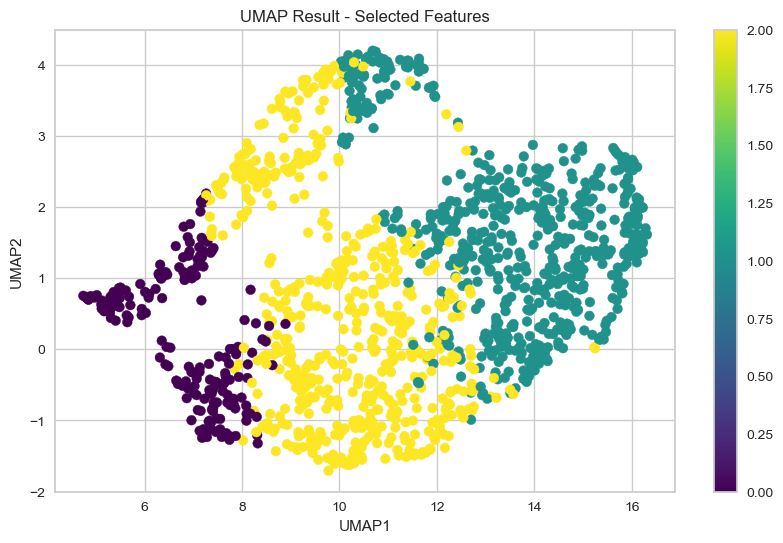

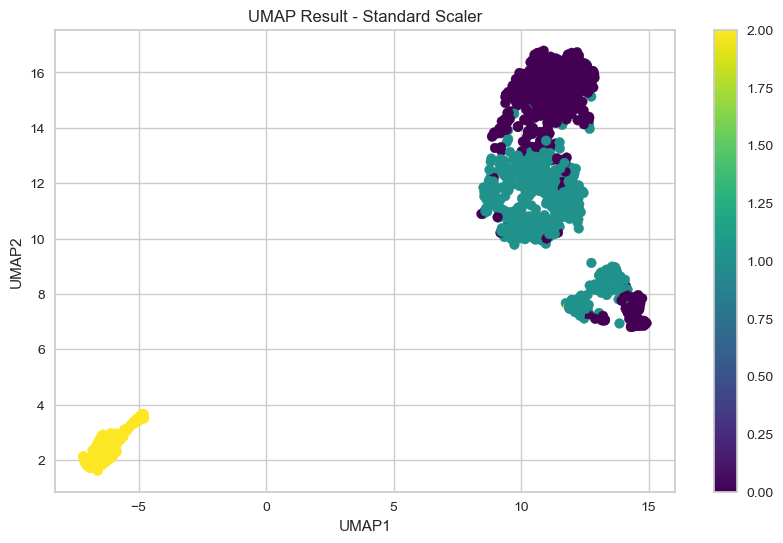

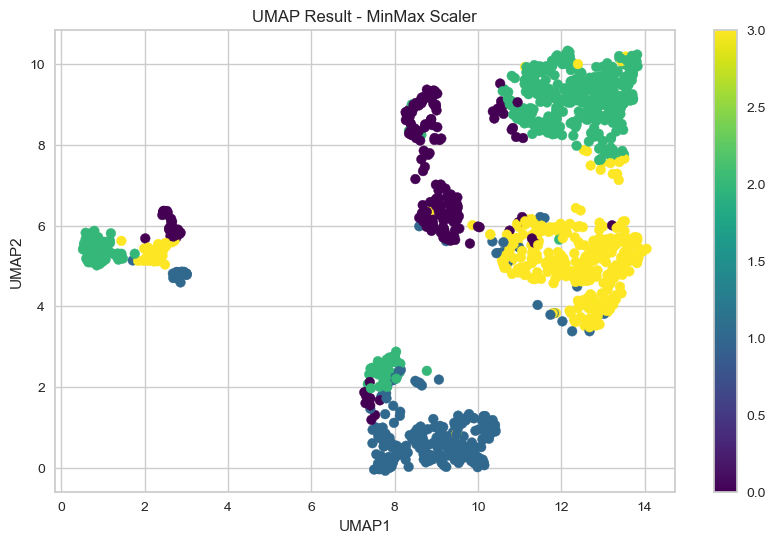

"\nUMAP is a non-linear dimensionality reduction technique that focuses on preserving the global and local structure of the data. \nIt aims to create a low-dimensional representation of data that maintains the topological structure of the original high-dimensional space.\n\nUMAP Result - Selected Features:\nObservation: The scatter plot shows clear and distinct cluster separation, with clusters well-distributed across the UMAP1 and UMAP2 axes. \nThe selected features effectively capture the data's structure, providing clear differentiation between groups.\n\nUMAP Result - Standard Scaler:\nObservation: The scatter plot shows distinct clusters, but they are more fragmented and dispersed compared to the selected features. \nStandard scaling results in smaller, isolated clusters, indicating that while some structure is preserved, the global relationships are less clear.\n\nUMAP Result - MinMax Scaler:\nObservation: The scatter plot shows well-separated clusters similar to the selected fea

In [158]:
#UMAP
umap_model = umap.UMAP(n_components=2)
umap_result = umap_model.fit_transform(data_selected)
umap_result_S = umap_model.fit_transform(data_selected_S)
umap_result_MM = umap_model.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(umap_result[:, 0], umap_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('UMAP Result - Selected Features')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()


plt.figure(figsize=(10, 6))
plt.scatter(umap_result_S[:, 0], umap_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('UMAP Result - Standard Scaler')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(umap_result_MM[:, 0], umap_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('UMAP Result - MinMax Scaler')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()

'''
UMAP is a non-linear dimensionality reduction technique that focuses on preserving the global and local structure of the data. 
It aims to create a low-dimensional representation of data that maintains the topological structure of the original high-dimensional space.

UMAP Result - Selected Features:
Observation: The scatter plot shows clear and distinct cluster separation, with clusters well-distributed across the UMAP1 and UMAP2 axes. 
The selected features effectively capture the data's structure, providing clear differentiation between groups.

UMAP Result - Standard Scaler:
Observation: The scatter plot shows distinct clusters, but they are more fragmented and dispersed compared to the selected features. 
Standard scaling results in smaller, isolated clusters, indicating that while some structure is preserved, the global relationships are less clear.

UMAP Result - MinMax Scaler:
Observation: The scatter plot shows well-separated clusters similar to the selected features but with more distinct groupings. 
MinMax scaling preserves the relative differences effectively, leading to better-defined clusters while maintaining the data's topological structure.
'''

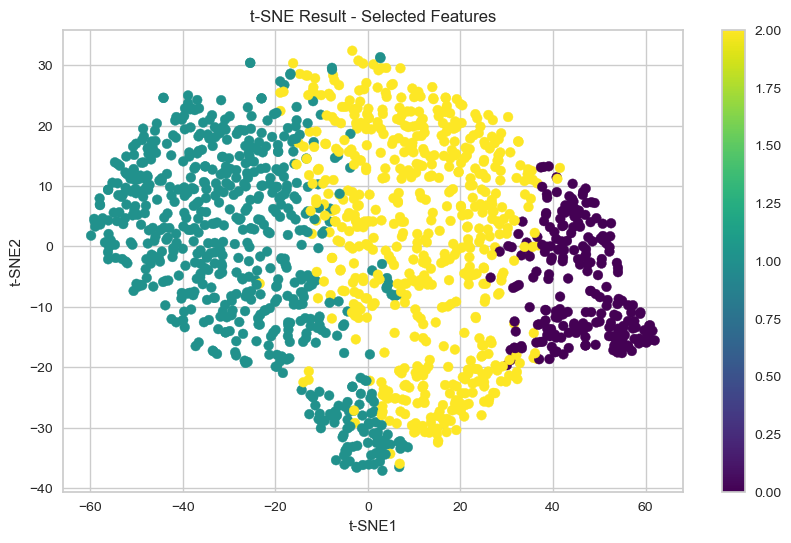

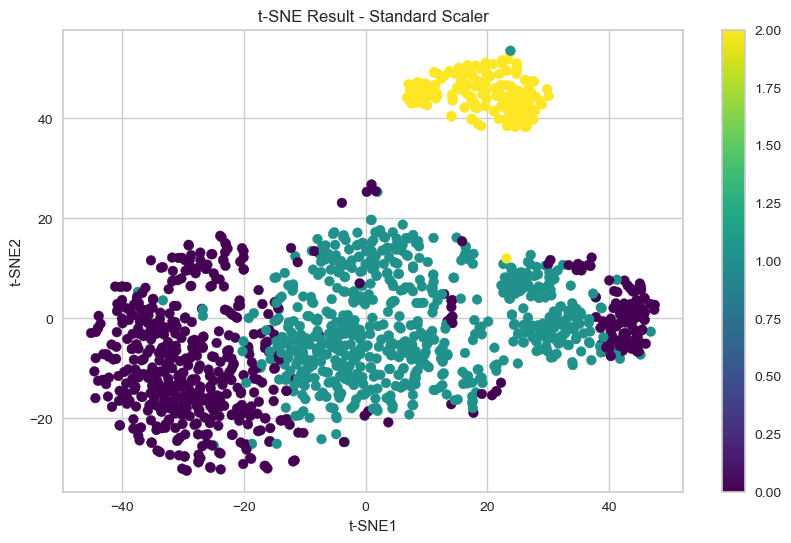

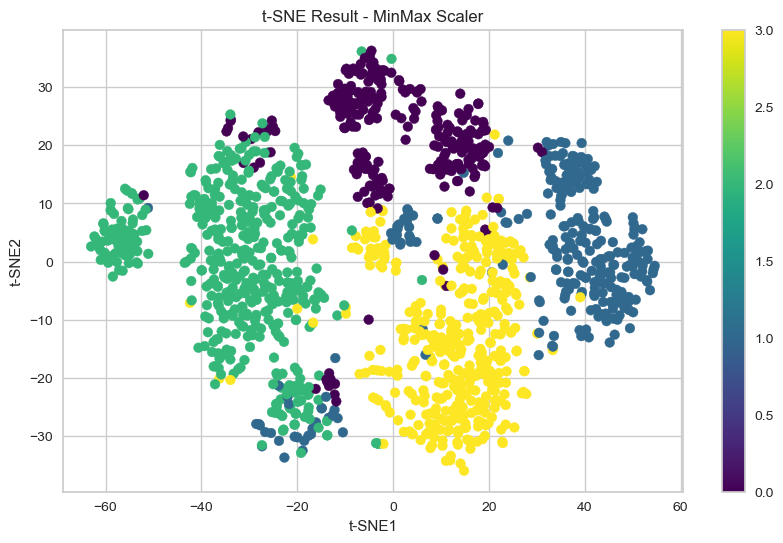

' \nt-SNE is a non-linear dimensionality reduction technique that is particularly well-suited for visualizing high-dimensional data. \nIt focuses on preserving local similarities and creating a map where similar data points are modeled by nearby points and dissimilar data points are modeled by distant points.\n\nt-SNE Result - Selected Features:\nObservation: The scatter plot shows distinct clusters with clear separation along the t-SNE axes. \nThe selected features effectively capture local similarities, resulting in well-defined clusters.\n\nt-SNE Result - Standard Scaler:\nObservation: The scatter plot shows distinct clusters but with less separation compared to the selected features. \nStandard scaling equalizes feature contributions, leading to some mixing of clusters but still preserving local similarities.\n\nt-SNE Result - MinMax Scaler:\nObservation: The scatter plot shows distinct clusters with better separation compared to the standard scaler. \nMinMax scaling preserves rela

In [159]:
#t-SNE
tsne = TSNE(n_components=2,random_state=42)
tsne_result = tsne.fit_transform(data_selected)
tsne_result_S = tsne.fit_transform(data_selected_S)
tsne_result_MM = tsne.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result[:, 0], tsne_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('t-SNE Result - Selected Features')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result_S[:, 0], tsne_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('t-SNE Result - Standard Scaler')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result_MM[:, 0], tsne_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('t-SNE Result - MinMax Scaler')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

''' 
t-SNE is a non-linear dimensionality reduction technique that is particularly well-suited for visualizing high-dimensional data. 
It focuses on preserving local similarities and creating a map where similar data points are modeled by nearby points and dissimilar data points are modeled by distant points.

t-SNE Result - Selected Features:
Observation: The scatter plot shows distinct clusters with clear separation along the t-SNE axes. 
The selected features effectively capture local similarities, resulting in well-defined clusters.

t-SNE Result - Standard Scaler:
Observation: The scatter plot shows distinct clusters but with less separation compared to the selected features. 
Standard scaling equalizes feature contributions, leading to some mixing of clusters but still preserving local similarities.

t-SNE Result - MinMax Scaler:
Observation: The scatter plot shows distinct clusters with better separation compared to the standard scaler. 
MinMax scaling preserves relative differences effectively, resulting in clear and well-defined clusters that capture local similarities.
'''


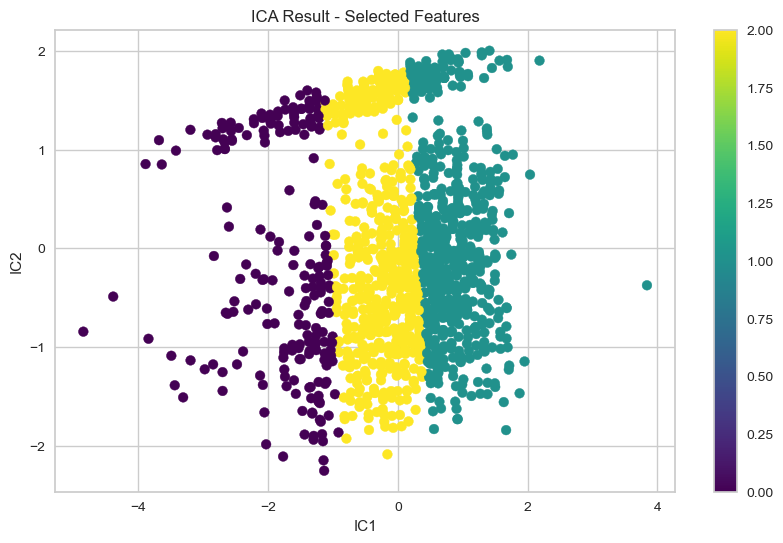

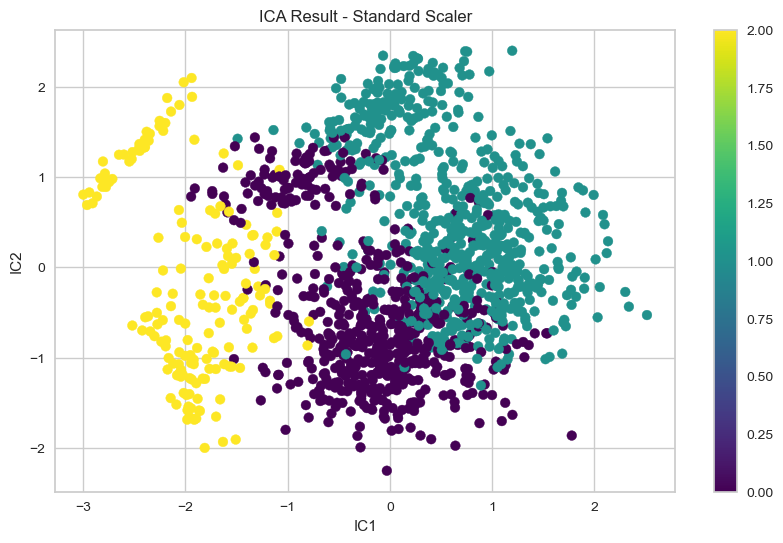

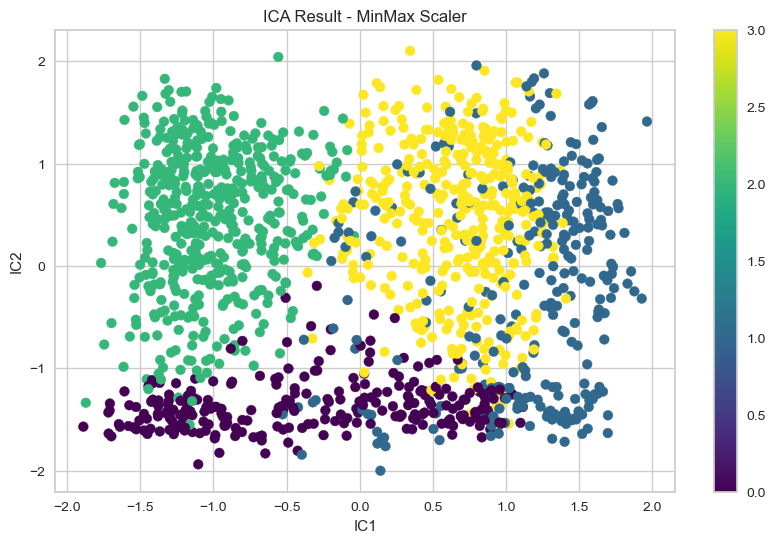

' \nICA is a computational method for separating a multivariate signal into additive, independent components. \nIt is often used for finding hidden factors or signals in the data.\n\nICA Result - Selected Features:\nObservation: The scatter plot shows distinct and clear cluster separation along the IC1 and IC2 axes. \nThe selected features capture significant independent components, effectively differentiating between groups.\n\nICA Result - Standard Scaler:\nObservation: The scatter plot shows clusters that are more spread out and less distinct. \nStandard scaling equalizes feature contributions, resulting in a more dispersed distribution and less clear separation of independent components.\n\nICA Result - MinMax Scaler:\nObservation: The scatter plot shows a better-defined separation compared to the standard scaler but with some overlap. \nMinMax scaling preserves relative differences more effectively, leading to clearer cluster differentiation along independent components.\n'

In [160]:
#ICA
ica= FastICA(n_components=2, random_state=42, whiten='unit-variance')
ica_result = ica.fit_transform(data_selected)
ica_result_S = ica.fit_transform(data_selected_S)
ica_result_MM = ica.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(ica_result[:, 0], ica_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('ICA Result - Selected Features')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(ica_result_S[:, 0], ica_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('ICA Result - Standard Scaler')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(ica_result_MM[:, 0], ica_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('ICA Result - MinMax Scaler')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()



''' 
ICA is a computational method for separating a multivariate signal into additive, independent components. 
It is often used for finding hidden factors or signals in the data.

ICA Result - Selected Features:
Observation: The scatter plot shows distinct and clear cluster separation along the IC1 and IC2 axes. 
The selected features capture significant independent components, effectively differentiating between groups.

ICA Result - Standard Scaler:
Observation: The scatter plot shows clusters that are more spread out and less distinct. 
Standard scaling equalizes feature contributions, resulting in a more dispersed distribution and less clear separation of independent components.

ICA Result - MinMax Scaler:
Observation: The scatter plot shows a better-defined separation compared to the standard scaler but with some overlap. 
MinMax scaling preserves relative differences more effectively, leading to clearer cluster differentiation along independent components.
'''



In [161]:
#Evaluate and Compare Dimensionality Reduction Methods with Clustering:

from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, MeanShift, AffinityPropagation, Birch, OPTICS, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from yellowbrick.cluster import KElbowVisualizer
from scipy.cluster.hierarchy import dendrogram, linkage

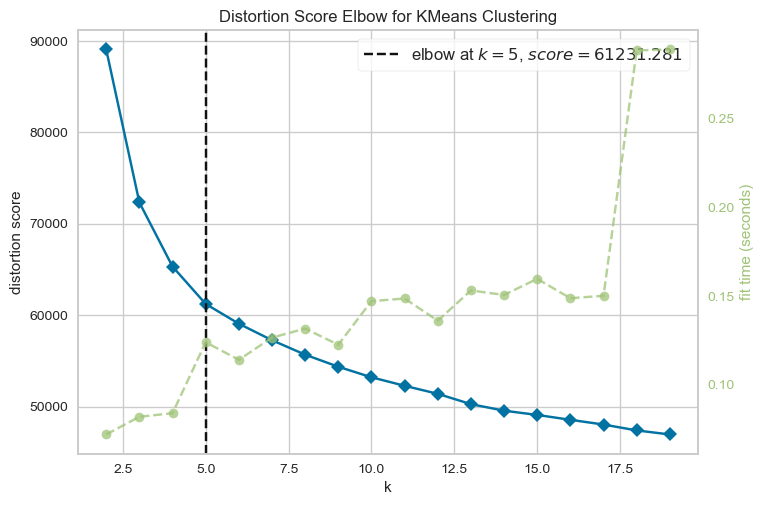

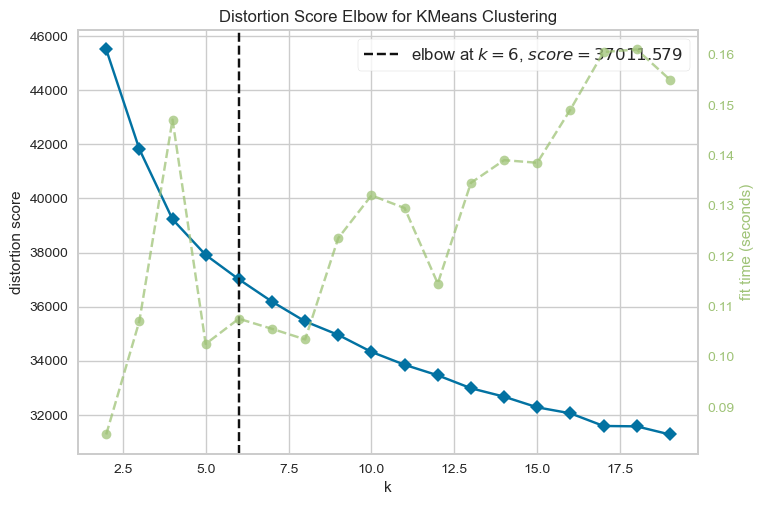

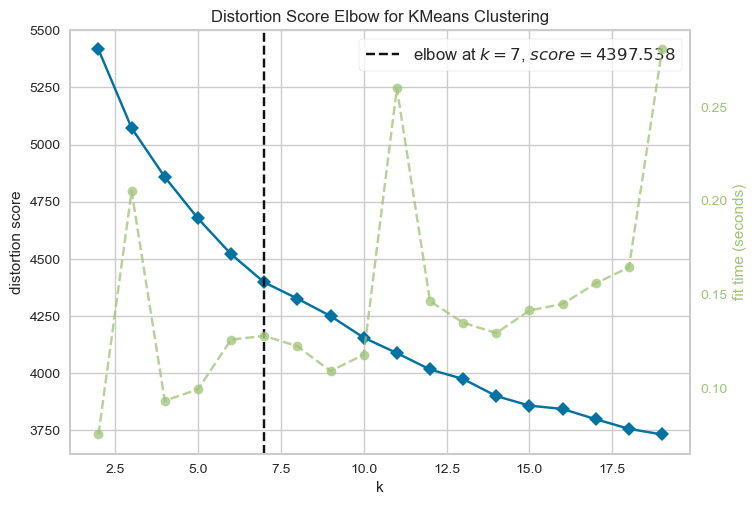

' \nThe Elbow Criterion is a method used to determine the optimal number of clusters (k) in a dataset for KMeans clustering. \nThe goal is to identify the point where the distortion score (within-cluster sum of squares) starts to diminish at a slower rate, forming an "elbow" in the plot. \nThis suggests that adding more clusters beyond this point yields diminishing returns.\n\n\nSelected Features: Optimal k = 5\nStandard Scaler: Optimal k = 7\nMinMax Scaler: Optimal k = 7\n\n'

In [162]:
# Suppress specific warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

def kmeans_elbow(data):
    model = KMeans()
    visualizer = KElbowVisualizer(model,k=(2,20))
    visualizer.fit(data)
    visualizer.show()

kmeans_elbow(data_selected)
kmeans_elbow(data_selected_S)
kmeans_elbow(data_selected_MM)

''' 
The Elbow Criterion is a method used to determine the optimal number of clusters (k) in a dataset for KMeans clustering. 
The goal is to identify the point where the distortion score (within-cluster sum of squares) starts to diminish at a slower rate, forming an "elbow" in the plot. 
This suggests that adding more clusters beyond this point yields diminishing returns.


Selected Features: Optimal k = 5
Standard Scaler: Optimal k = 7
MinMax Scaler: Optimal k = 7

'''



In [163]:
def plot_dendrogram(data_reduced,method_name):
    Z = linkage(data_reduced, method = 'ward')
    
    plt.figure(figsize=(10, 6))
    dendrogram(Z)
    plt.title(f'Dendrogram for Hierarchical Clustering ({method_name})')
    plt.xlabel('Sample index')
    plt.ylabel('Distance')
    plt.show()


In [180]:
def evaluate_clustering(data_reduced, method_name):

    #KMeans
    kmeans = KMeans(random_state=42)
    visualizer = KElbowVisualizer(kmeans, k=(2,10))
    visualizer.fit(data_reduced)
    visualizer.show()
    
    optimal_k = visualizer.elbow_value_
    kmeans = KMeans(n_clusters=optimal_k, random_state=42)
    kmeans_labels = kmeans.fit_predict(data_reduced)
    sil_score_kmeans = silhouette_score(data_reduced, kmeans_labels)
    davies_bouldin_kmeans = davies_bouldin_score(data_reduced,kmeans_labels)
    calinski_harabasz_kmeans = calinski_harabasz_score(data_reduced, kmeans_labels)

    print(f'KMeans - Silhouette Score for {method_name}: {sil_score_kmeans}')
    print(f'KMeans - Davies-Bouldin Index for {method_name}: {davies_bouldin_kmeans}')
    print(f'KMeans - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_kmeans}')

    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=kmeans_labels, cmap='viridis')
    plt.title(f'KMeans Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #GMM
    gmm = GaussianMixture(n_components=3, random_state=42)
    gmm_labels = gmm.fit_predict(data_reduced)
    sil_score_gmm = silhouette_score(data_reduced, gmm_labels)
    davies_bouldin_gmm = davies_bouldin_score(data_reduced,gmm_labels)
    calinski_harabasz_gmm = calinski_harabasz_score(data_reduced,gmm_labels)

    print(f'GMM - Silhouette Score for {method_name}: {sil_score_gmm}')
    print(f'GMM - Davies-Bouldin Index for {method_name}: {davies_bouldin_gmm}')
    print(f'GMM - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_gmm}')

    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=gmm_labels, cmap='viridis')
    plt.title(f'GMM Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Hierarchical Clustering
    hierarchical = AgglomerativeClustering(n_clusters=3)
    hierarchical_labels = hierarchical.fit_predict(data_reduced)
    sil_score_hierarchical = silhouette_score(data_reduced, hierarchical_labels)
    davies_bouldin_hierarchical = davies_bouldin_score(data_reduced, hierarchical_labels)
    calinski_harabasz_hierarchical = calinski_harabasz_score(data_reduced, hierarchical_labels)
    print(f'Hierarchical Clustering - Silhouette Score for {method_name}: {sil_score_hierarchical}')
    print(f'Hierarchical Clustering - Davies-Bouldin Index for {method_name}: {davies_bouldin_hierarchical}')
    print(f'Hierarchical Clustering - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_hierarchical}')

    # Visualize Hierarchical Clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=hierarchical_labels, cmap='viridis')
    plt.title(f'Hierarchical Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #DBSCAN 
    dbscan = DBSCAN(eps=0.5,min_samples=5)
    dbscan_labels = dbscan.fit_predict(data_reduced)
    if len(set(dbscan_labels)) > 1:
        sil_score_dbscan = silhouette_score(data_reduced, dbscan_labels)
        davies_bouldin_dbscan = davies_bouldin_score(data_reduced, dbscan_labels)
        calinski_harabasz_dbscan = calinski_harabasz_score(data_reduced, dbscan_labels)
        print(f'DBSCAN - Silhouette Score for {method_name}: {sil_score_dbscan}')
        print(f'DBSCAN - Davies-Bouldin Index for {method_name}: {davies_bouldin_dbscan}')
        print(f'DBSCAN - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_dbscan}')
    else:
        print(f'DBSCAN - Insufficient clusters for {method_name}')

    # Visualize DBSCAN clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=dbscan_labels, cmap='viridis')
    plt.title(f'DBSCAN Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Mean Shift 
    mean_shift = MeanShift()
    mean_shift_labels = mean_shift.fit_predict(data_reduced)
    # sil_score_mean_shift = silhouette_score(data_reduced, mean_shift_labels)
    # davies_bouldin_mean_shift = davies_bouldin_score(data_reduced, mean_shift_labels)
    # calinski_harabasz_mean_shift = calinski_harabasz_score(data_reduced, mean_shift_labels)
    # print(f'Mean Shift - Silhouette Score for {method_name}: {sil_score_mean_shift}')
    # print(f'Mean Shift - Davies-Bouldin Index for {method_name}: {davies_bouldin_mean_shift}')
    # print(f'Mean Shift - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_mean_shift}')

    # #Visualize Mean Shift clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=mean_shift_labels, cmap='viridis')
    plt.title(f'Mean Shift Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Affinity Propergation
    affinity_prop = AffinityPropagation(random_state=42)
    affinity_prop_labels = affinity_prop.fit_predict(data_reduced)
    sil_score_affinity_prop = silhouette_score(data_reduced, affinity_prop_labels)
    davies_bouldin_affinity_prop = davies_bouldin_score(data_reduced, affinity_prop_labels)
    calinski_harabasz_affinity_prop = calinski_harabasz_score(data_reduced, affinity_prop_labels)
    print(f'Affinity Propagation - Silhouette Score for {method_name}: {sil_score_affinity_prop}')
    print(f'Affinity Propagation - Davies-Bouldin Index for {method_name}: {davies_bouldin_affinity_prop}')
    print(f'Affinity Propagation - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_affinity_prop}')

    # Visualize Affinity Propagation clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=affinity_prop_labels, cmap='viridis')
    plt.title(f'Affinity Propagation Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Birch
    birch = Birch(n_clusters=3)
    birch_labels = birch.fit_predict(data_reduced)
    sil_score_birch = silhouette_score(data_reduced, birch_labels)
    davies_bouldin_birch = davies_bouldin_score(data_reduced, birch_labels)
    calinski_harabasz_birch = calinski_harabasz_score(data_reduced, birch_labels)
    print(f'Birch - Silhouette Score for {method_name}: {sil_score_birch}')
    print(f'Birch - Davies-Bouldin Index for {method_name}: {davies_bouldin_birch}')
    print(f'Birch - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_birch}')

    # Visualize Birch clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=birch_labels, cmap='viridis')
    plt.title(f'Birch Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #OPTICS
    optics = OPTICS(min_samples =5)
    optics_labels = optics.fit_predict(data_reduced)
    optics_labels = optics.fit_predict(data_reduced)
    if len(set(optics_labels)) > 1:
        sil_score_optics = silhouette_score(data_reduced, optics_labels)
        davies_bouldin_optics = davies_bouldin_score(data_reduced, optics_labels)
        calinski_harabasz_optics = calinski_harabasz_score(data_reduced, optics_labels)
        print(f'OPTICS - Silhouette Score for {method_name}: {sil_score_optics}')
        print(f'OPTICS - Davies-Bouldin Index for {method_name}: {davies_bouldin_optics}')
        print(f'OPTICS - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_optics}')
    else:
        print(f'OPTICS - Insufficient clusters for {method_name}')
    
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=optics_labels, cmap='viridis')
    plt.title(f'OPTICS Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Spectral CLustering
    spectral = SpectralClustering(n_clusters=optimal_k, random_state=42)
    spectral_labels = spectral.fit_predict(data_reduced)
    sil_score_spectral = silhouette_score(data_reduced, spectral_labels)
    davies_bouldin_spectral = davies_bouldin_score(data_reduced, spectral_labels)
    calinski_harabasz_spectral = calinski_harabasz_score(data_reduced, spectral_labels)
    print(f'Spectral Clustering - Silhouette Score for {method_name}: {sil_score_spectral}')
    print(f'Spectral Clustering - Davies-Bouldin Index for {method_name}: {davies_bouldin_spectral}')
    print(f'Spectral Clustering - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_spectral}')

    # Visualize Spectral Clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=spectral_labels, cmap='viridis')
    plt.title(f'Spectral Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()
    
    


In [177]:
''' 
1.KMeans
Description: KMeans is a centroid-based clustering algorithm that partitions the data into k clusters. Each cluster is represented by the centroid, which is the mean of the data points in the cluster.
Advantages: Simple, fast, and efficient for large datasets.
Disadvantages: Assumes clusters are spherical and of equal size; sensitive to initial centroid placement.


2. Gaussian Mixture Model (GMM)
Description: GMM is a probabilistic model that assumes the data is generated from a mixture of several Gaussian distributions. Each component represents a cluster.
Advantages: Can model elliptical clusters; provides a probabilistic cluster assignment.
Disadvantages: Can be computationally intensive; sensitive to initialization.


3. Hierarchical Clustering
Description: Hierarchical clustering builds a hierarchy of clusters by either merging smaller clusters (agglomerative) or splitting larger clusters (divisive).
Advantages: Does not require a predefined number of clusters; produces a dendrogram to visualize the clustering process.
Disadvantages: Computationally expensive for large datasets; less flexible for large datasets.


4. DBSCAN (Density-Based Spatial Clustering of Applications with Noise)
Description: DBSCAN groups points that are closely packed together and marks points that are in low-density regions as outliers.
Advantages: Can find clusters of arbitrary shapes; robust to noise and outliers.
Disadvantages: Requires careful tuning of parameters (eps and min_samples); less effective with varying densities.


5. Mean Shift
Description: Mean Shift is a centroid-based algorithm that iteratively shifts each data point to the mean of points in its neighborhood until convergence.
Advantages: Does not require a predefined number of clusters; can find clusters of arbitrary shapes.
Disadvantages: Computationally intensive; sensitive to bandwidth parameter.


6. Affinity Propagation
Description: Affinity Propagation identifies exemplars among data points and forms clusters by sending messages between points until convergence.
Advantages: Does not require a predefined number of clusters; flexible and robust.
Disadvantages: Can be slow for large datasets; requires careful tuning of damping parameter.


7. Birch (Balanced Iterative Reducing and Clustering using Hierarchies)
Description: Birch builds a clustering feature tree (CF Tree) for large datasets and incrementally clusters the data points.
Advantages: Efficient for large datasets; performs well with noise.
Disadvantages: Assumes spherical clusters; less effective for clusters of varying density.


8. OPTICS (Ordering Points to Identify the Clustering Structure)
Description: OPTICS is a density-based clustering algorithm similar to DBSCAN but can handle clusters of varying densities. It produces an ordering of points that represents the clustering structure.
Advantages: Can find clusters of varying density; provides hierarchical clustering structure.
Disadvantages: Computationally expensive; requires careful parameter tuning.


9. Spectral Clustering
Description: Spectral Clustering uses the eigenvalues of a similarity matrix to reduce the dimensionality of the data before applying KMeans clustering.
Advantages: Effective for non-convex clusters; captures complex structures.
Disadvantages: Requires computation of the similarity matrix; sensitive to choice of parameters.
'''

' \n1.KMeans\nDescription: KMeans is a centroid-based clustering algorithm that partitions the data into k clusters. Each cluster is represented by the centroid, which is the mean of the data points in the cluster.\nAdvantages: Simple, fast, and efficient for large datasets.\nDisadvantages: Assumes clusters are spherical and of equal size; sensitive to initial centroid placement.\n\n\n2. Gaussian Mixture Model (GMM)\nDescription: GMM is a probabilistic model that assumes the data is generated from a mixture of several Gaussian distributions. Each component represents a cluster.\nAdvantages: Can model elliptical clusters; provides a probabilistic cluster assignment.\nDisadvantages: Can be computationally intensive; sensitive to initialization.\n\n\n3. Hierarchical Clustering\nDescription: Hierarchical clustering builds a hierarchy of clusters by either merging smaller clusters (agglomerative) or splitting larger clusters (divisive).\nAdvantages: Does not require a predefined number of c

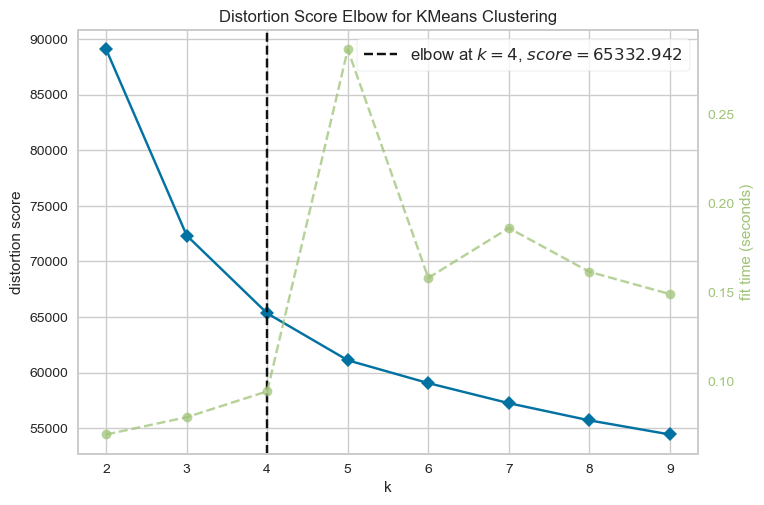

KMeans - Silhouette Score for PCA: 0.1661735805832974
KMeans - Davies-Bouldin Index for PCA: 1.6123647119619642
KMeans - Calinski-Harabasz Index for PCA: 612.7168724639034


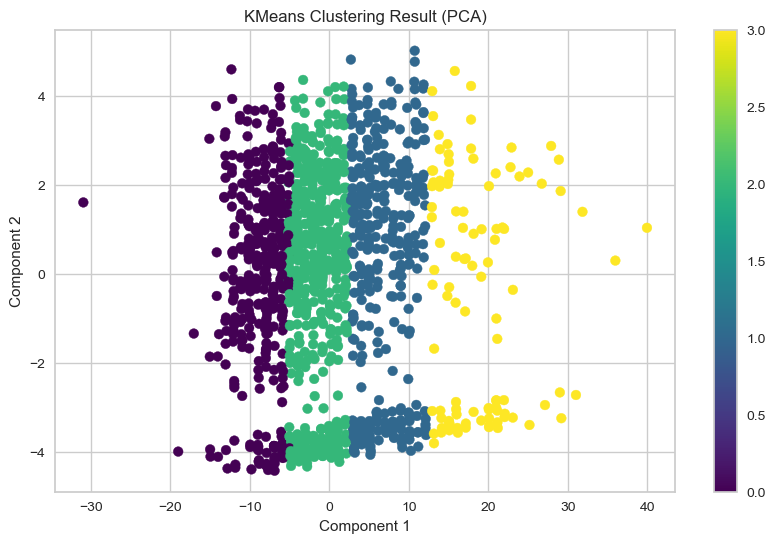

GMM - Silhouette Score for PCA: 0.01578787768384916
GMM - Davies-Bouldin Index for PCA: 3.385621995918887
GMM - Calinski-Harabasz Index for PCA: 60.57245831430859


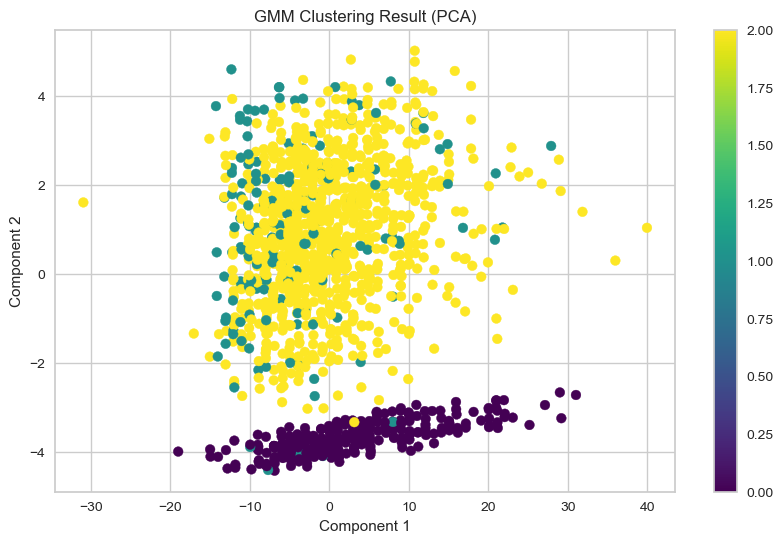

Hierarchical Clustering - Silhouette Score for PCA: 0.1935189488179397
Hierarchical Clustering - Davies-Bouldin Index for PCA: 1.5212491531749273
Hierarchical Clustering - Calinski-Harabasz Index for PCA: 703.2548196564737


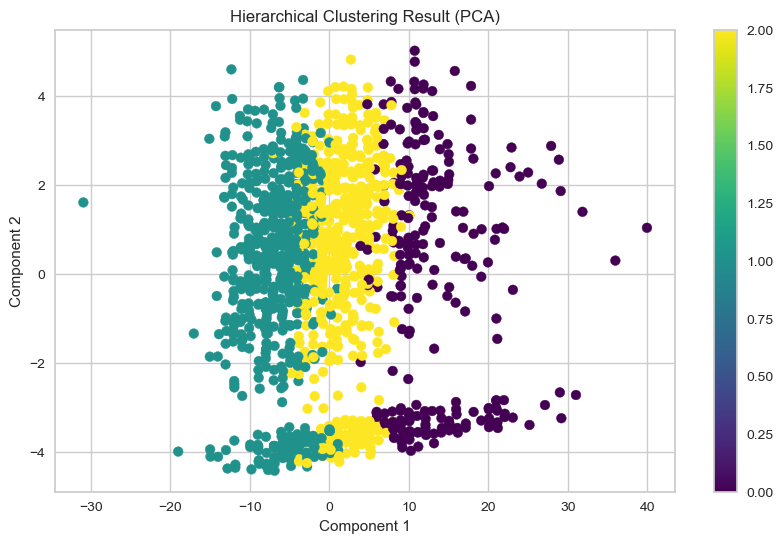

DBSCAN - Insufficient clusters for PCA


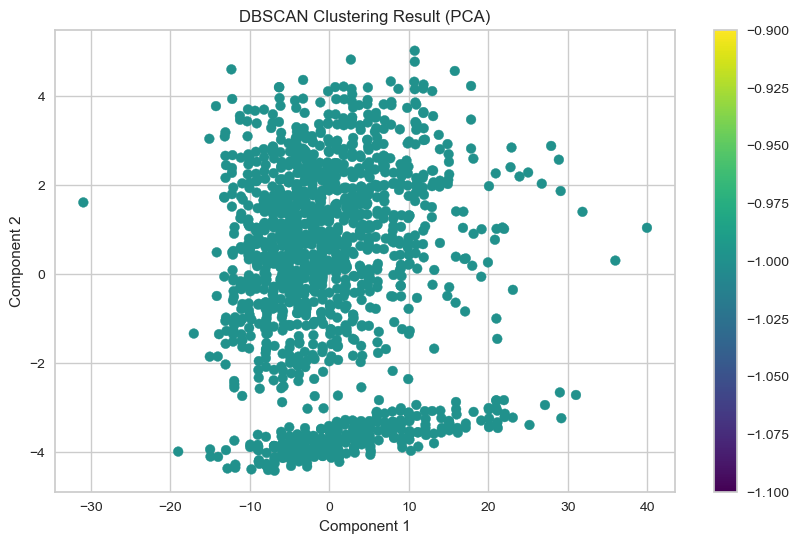

Mean Shift - Silhouette Score for PCA: 0.47624913124766927
Mean Shift - Davies-Bouldin Index for PCA: 0.6784575211068863
Mean Shift - Calinski-Harabasz Index for PCA: 12.37035476451107


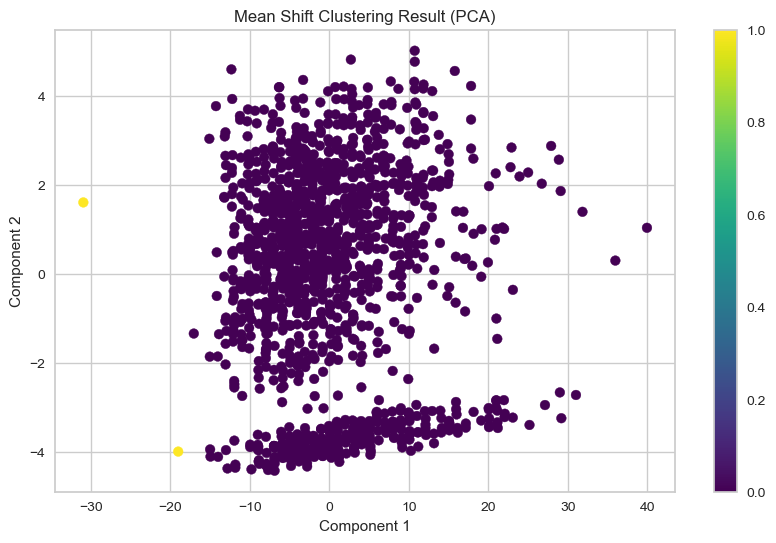

Affinity Propagation - Silhouette Score for PCA: 0.05321937923306808
Affinity Propagation - Davies-Bouldin Index for PCA: 2.2817971372493995
Affinity Propagation - Calinski-Harabasz Index for PCA: 50.79530995847009


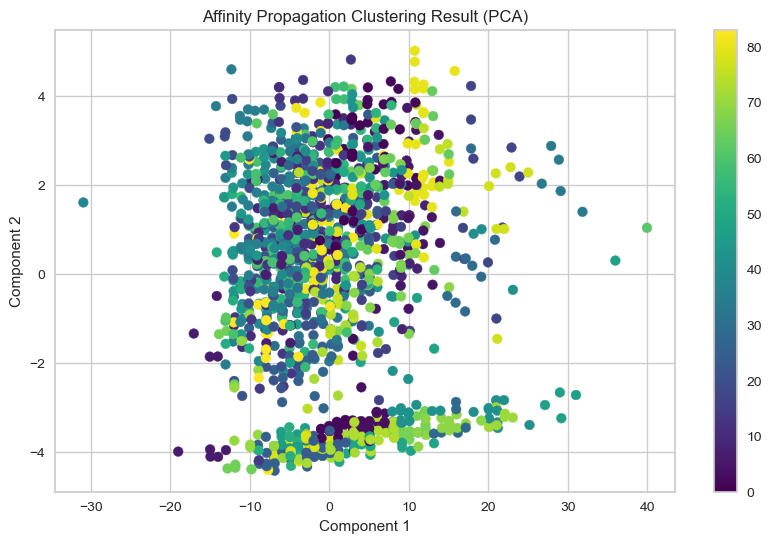

Birch - Silhouette Score for PCA: 0.19628202827903635
Birch - Davies-Bouldin Index for PCA: 1.5007678966112596
Birch - Calinski-Harabasz Index for PCA: 666.0732605572015


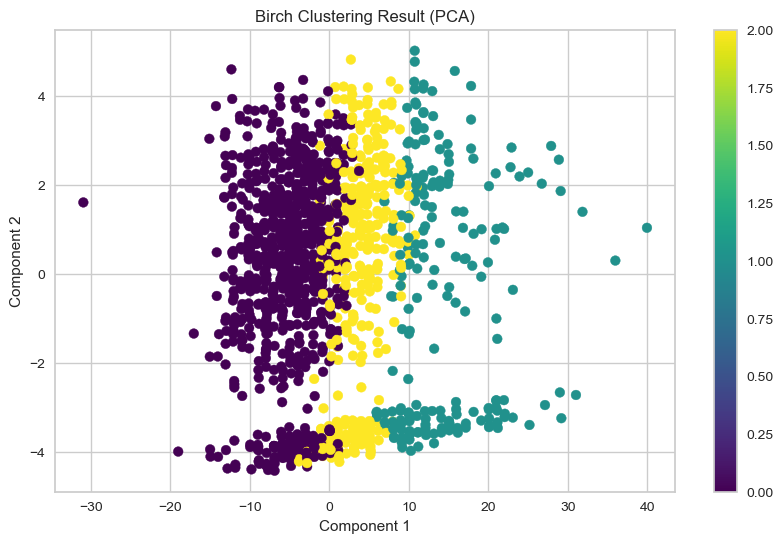

OPTICS - Silhouette Score for PCA: -0.35370984479619616
OPTICS - Davies-Bouldin Index for PCA: 1.8193298550626942
OPTICS - Calinski-Harabasz Index for PCA: 4.995493566321186


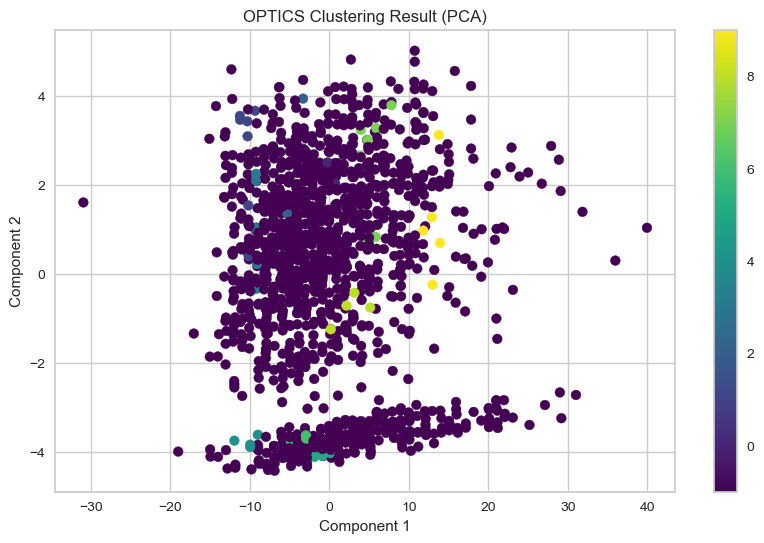

Spectral Clustering - Silhouette Score for PCA: 0.5750201052652257
Spectral Clustering - Davies-Bouldin Index for PCA: 0.2955185193056105
Spectral Clustering - Calinski-Harabasz Index for PCA: 9.696259334792275


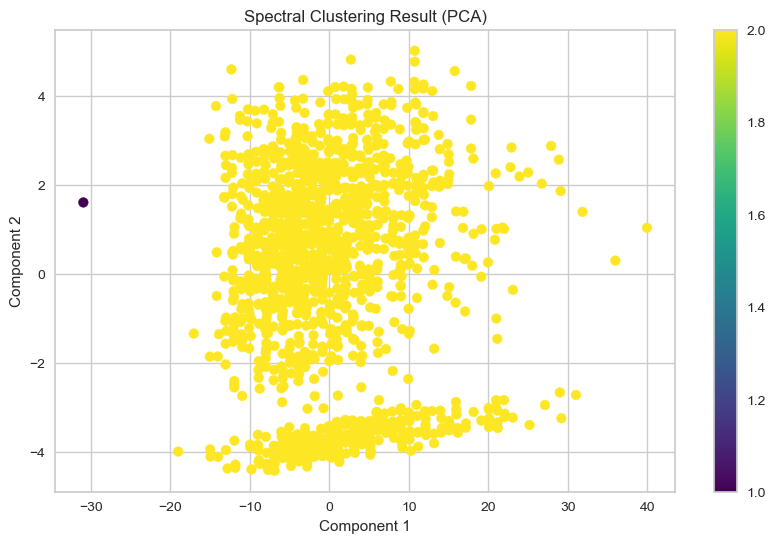

In [178]:
evaluate_clustering(pca_result, 'PCA')


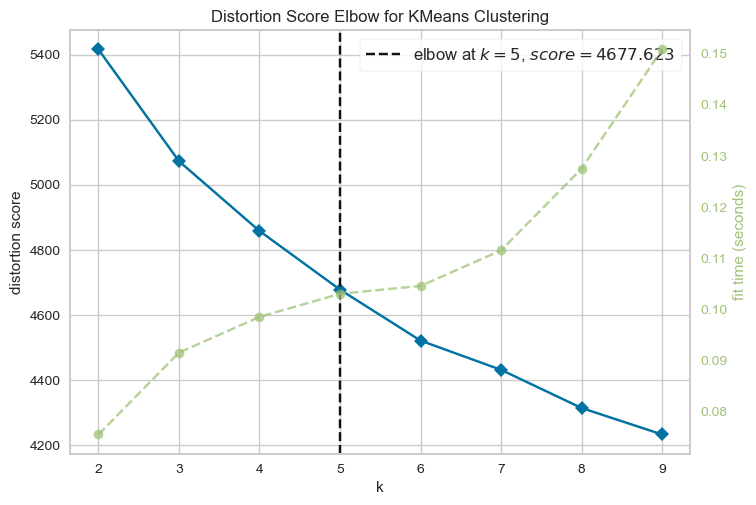

KMeans - Silhouette Score for PCA_MM: 0.09520364672990679
KMeans - Davies-Bouldin Index for PCA_MM: 2.6650000254251864
KMeans - Calinski-Harabasz Index for PCA_MM: 119.36426482252399


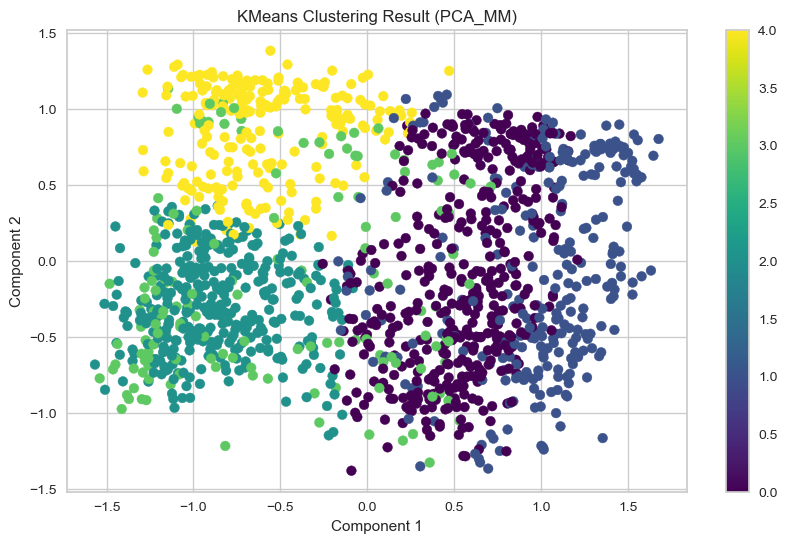

GMM - Silhouette Score for PCA_MM: 0.08172529978382313
GMM - Davies-Bouldin Index for PCA_MM: 2.7755604573138712
GMM - Calinski-Harabasz Index for PCA_MM: 128.2551237250123


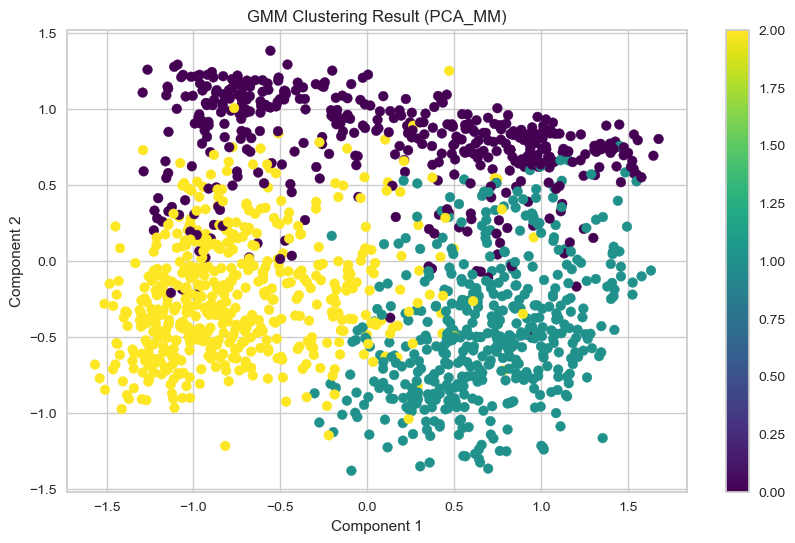

Hierarchical Clustering - Silhouette Score for PCA_MM: 0.06691318029118953
Hierarchical Clustering - Davies-Bouldin Index for PCA_MM: 2.9294761259401034
Hierarchical Clustering - Calinski-Harabasz Index for PCA_MM: 109.77946072341533


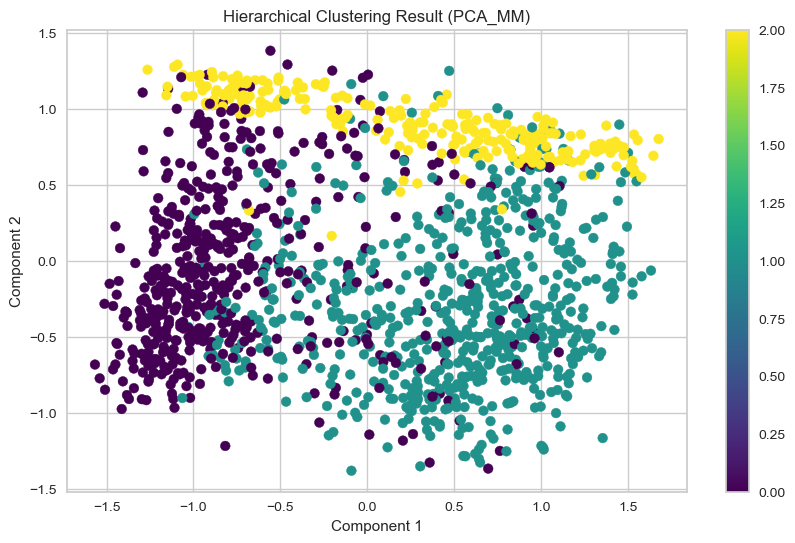

DBSCAN - Insufficient clusters for PCA_MM


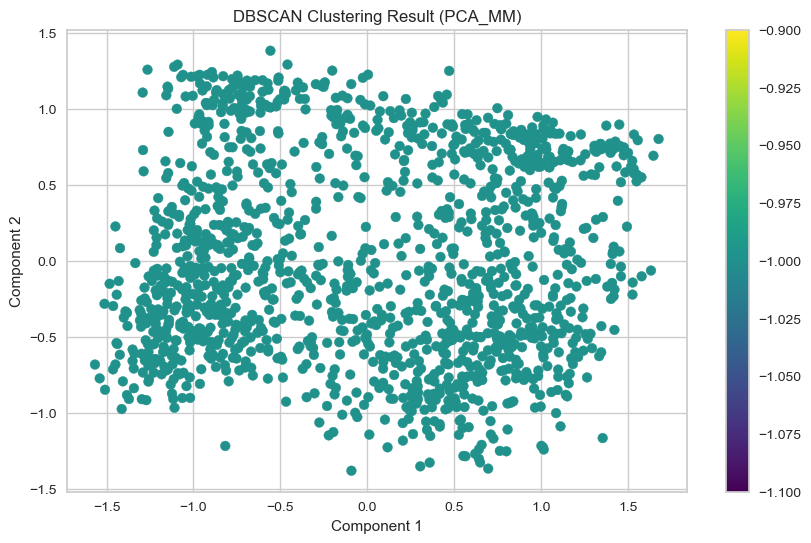

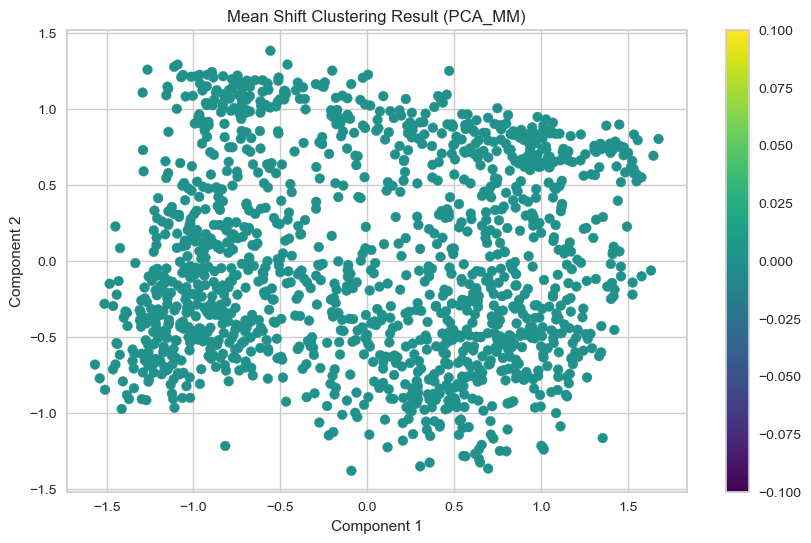

Affinity Propagation - Silhouette Score for PCA_MM: 0.04423640887115687
Affinity Propagation - Davies-Bouldin Index for PCA_MM: 2.5256040203114303
Affinity Propagation - Calinski-Harabasz Index for PCA_MM: 17.0779680778604


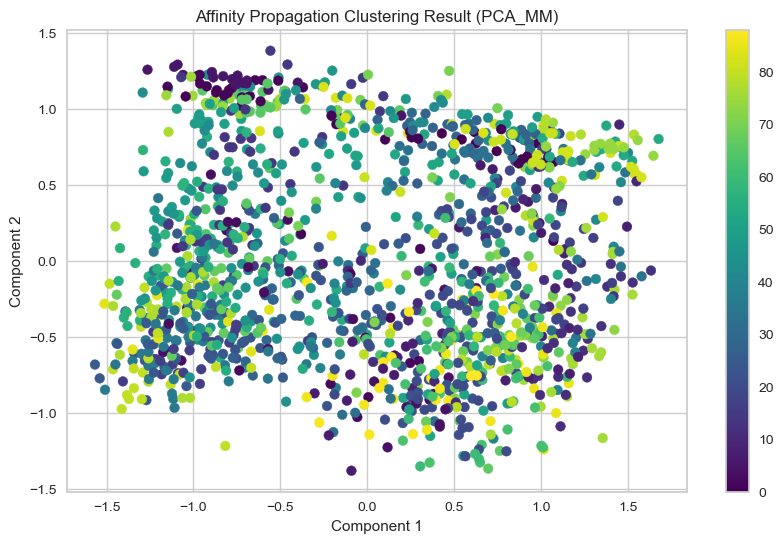

Birch - Silhouette Score for PCA_MM: 0.1087959101341919
Birch - Davies-Bouldin Index for PCA_MM: 2.512199844384915
Birch - Calinski-Harabasz Index for PCA_MM: 136.74766753852023


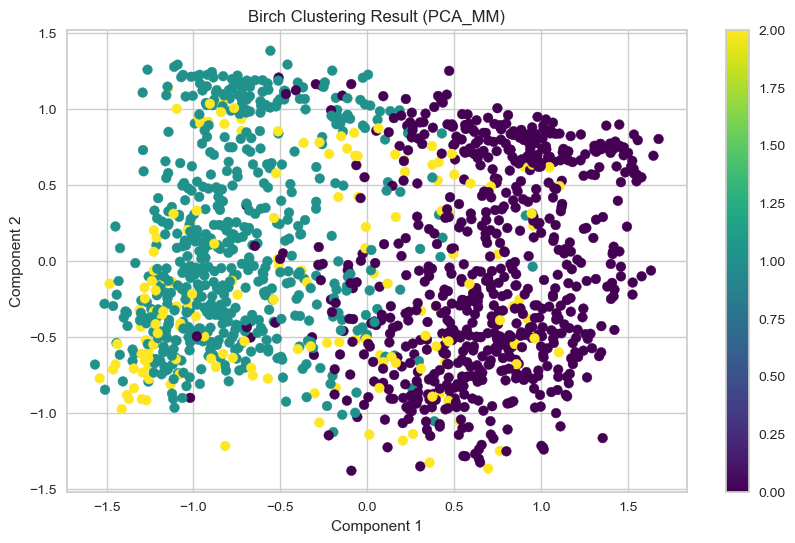

OPTICS - Silhouette Score for PCA_MM: -0.21295450945910133
OPTICS - Davies-Bouldin Index for PCA_MM: 1.5947152146128387
OPTICS - Calinski-Harabasz Index for PCA_MM: 5.758412060645739


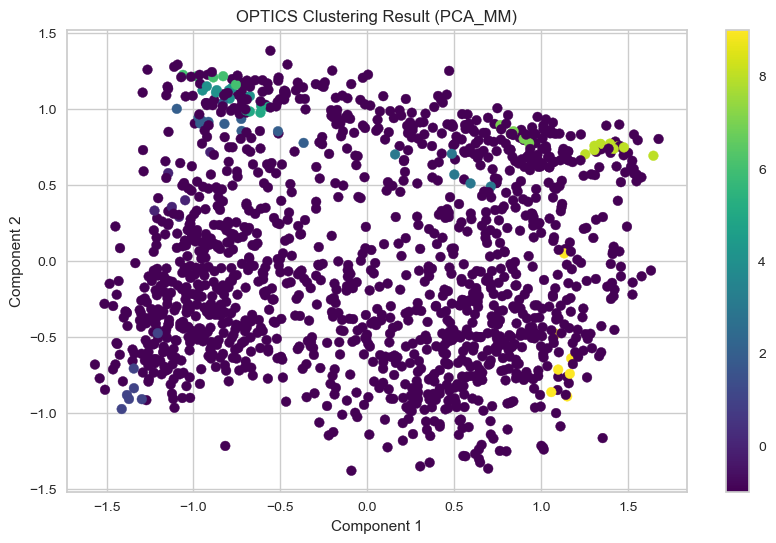

Spectral Clustering - Silhouette Score for PCA_MM: 0.09406410854089971
Spectral Clustering - Davies-Bouldin Index for PCA_MM: 2.418791335842361
Spectral Clustering - Calinski-Harabasz Index for PCA_MM: 116.83143430602104


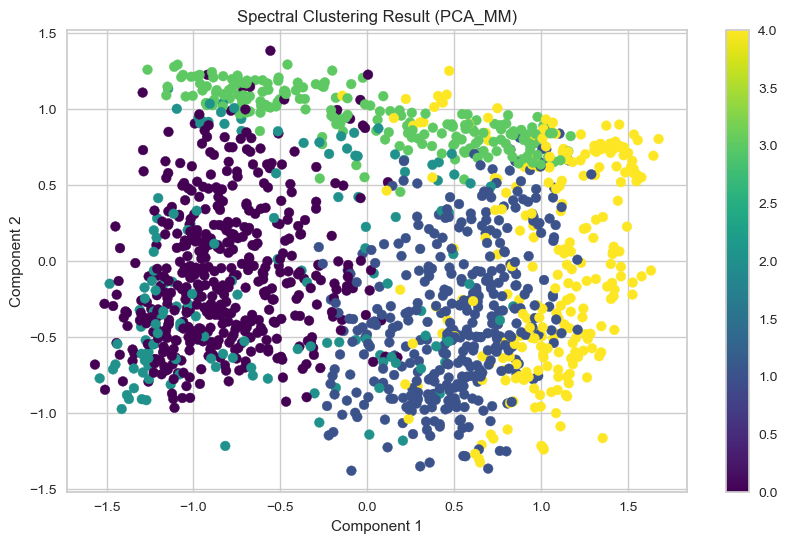

In [181]:
evaluate_clustering(pca_result_MM, 'PCA_MM')

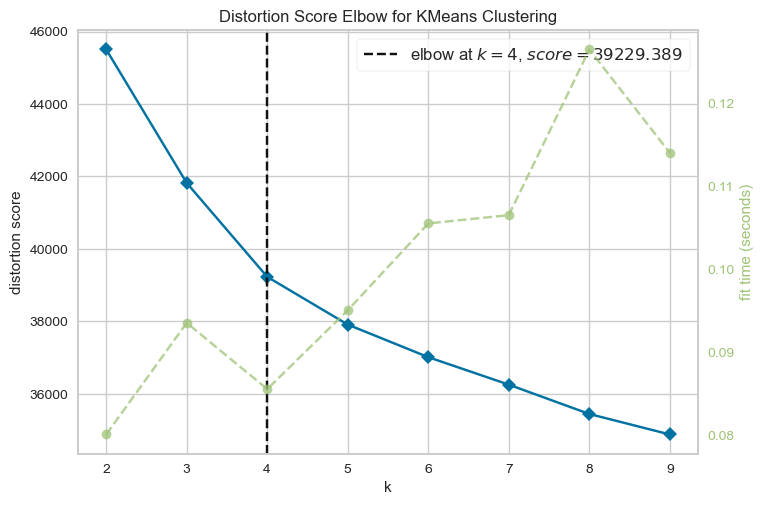

KMeans - Silhouette Score for PCA_S: 0.10620918704084167
KMeans - Davies-Bouldin Index for PCA_S: 2.546142108935122
KMeans - Calinski-Harabasz Index for PCA_S: 132.6615846590914


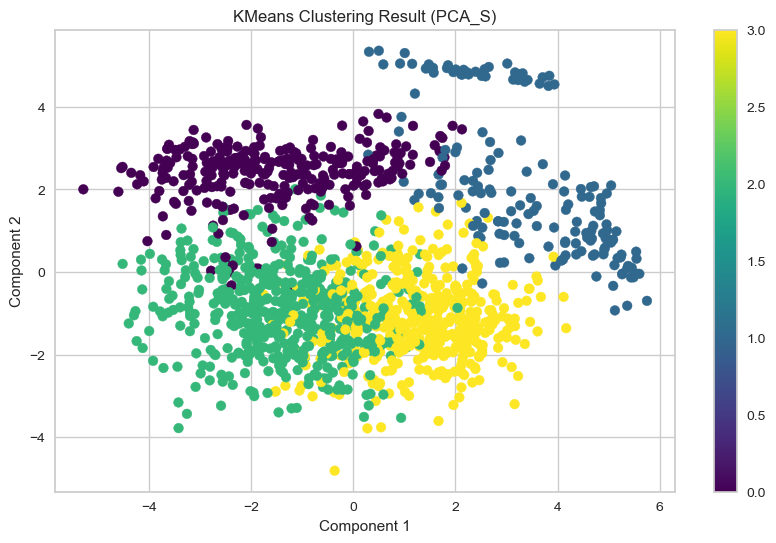

GMM - Silhouette Score for PCA_S: 0.06763665311036159
GMM - Davies-Bouldin Index for PCA_S: 3.3928942170182554
GMM - Calinski-Harabasz Index for PCA_S: 80.32186410897152


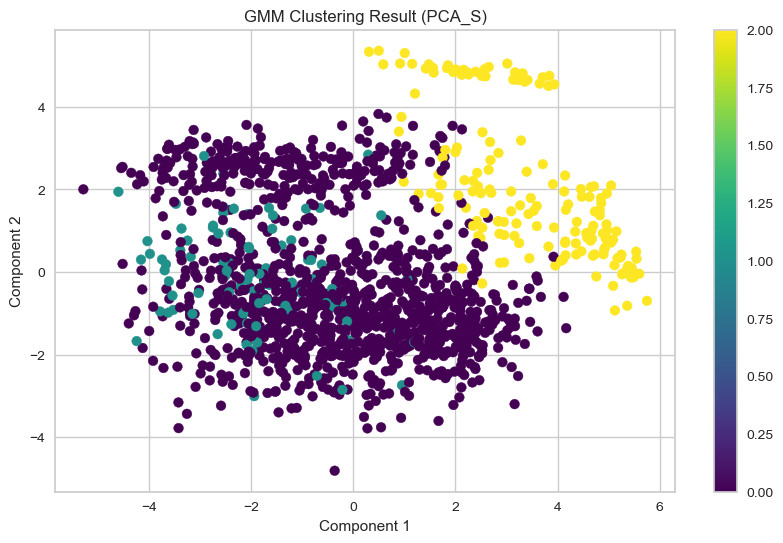

Hierarchical Clustering - Silhouette Score for PCA_S: 0.09300201364977101
Hierarchical Clustering - Davies-Bouldin Index for PCA_S: 2.356118825989029
Hierarchical Clustering - Calinski-Harabasz Index for PCA_S: 127.84743766503374


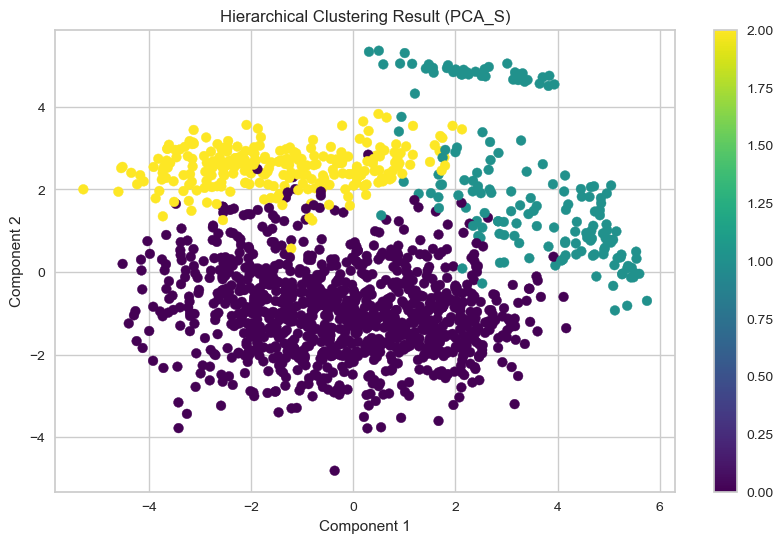

DBSCAN - Insufficient clusters for PCA_S


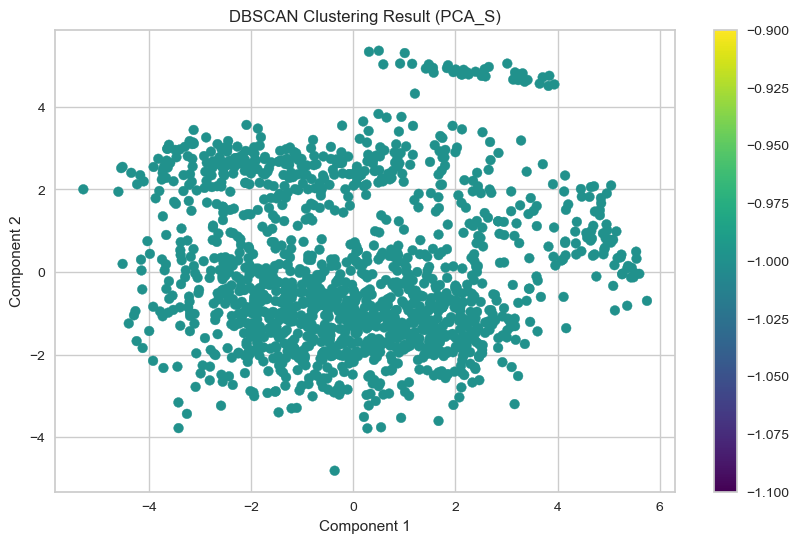

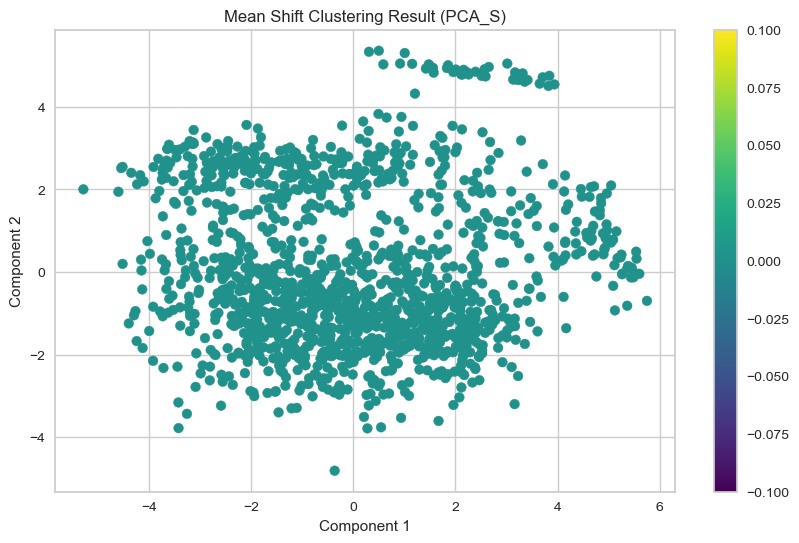

Affinity Propagation - Silhouette Score for PCA_S: 0.03768559806479654
Affinity Propagation - Davies-Bouldin Index for PCA_S: 2.5373068916615575
Affinity Propagation - Calinski-Harabasz Index for PCA_S: 14.681819992791521


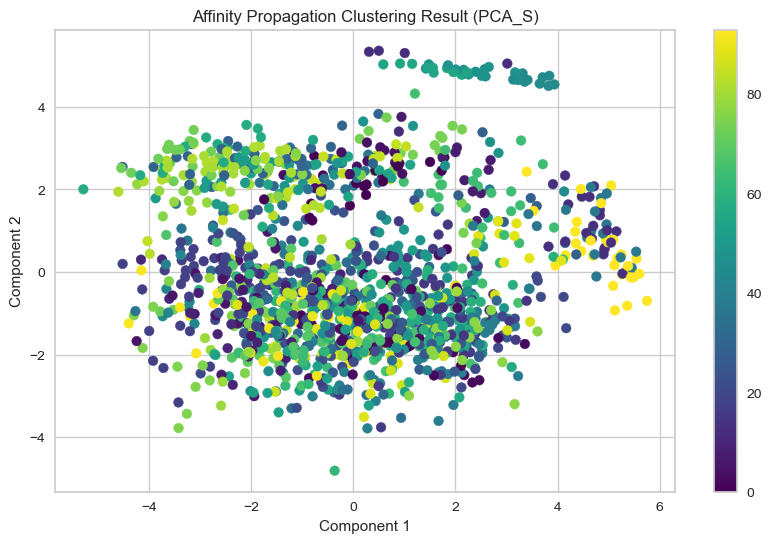

Birch - Silhouette Score for PCA_S: 0.09300201364977101
Birch - Davies-Bouldin Index for PCA_S: 2.356118825989029
Birch - Calinski-Harabasz Index for PCA_S: 127.84743766503374


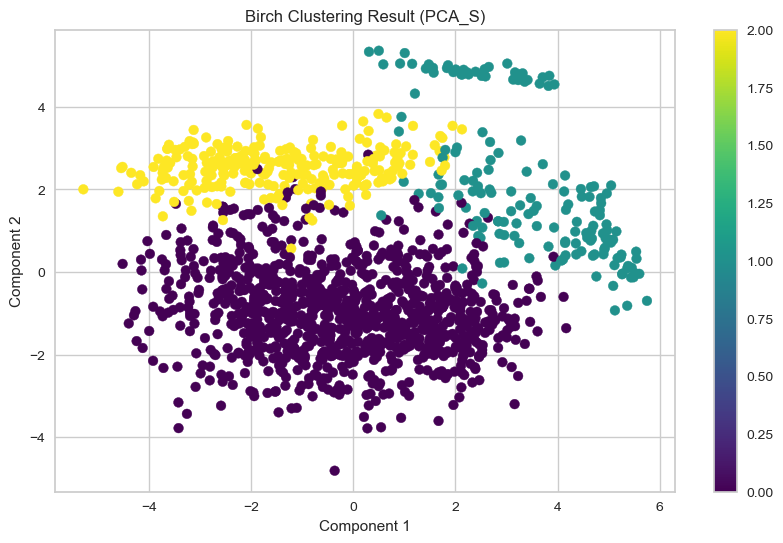

OPTICS - Silhouette Score for PCA_S: -0.20663366203882544
OPTICS - Davies-Bouldin Index for PCA_S: 1.7043176618880156
OPTICS - Calinski-Harabasz Index for PCA_S: 6.146820295116903


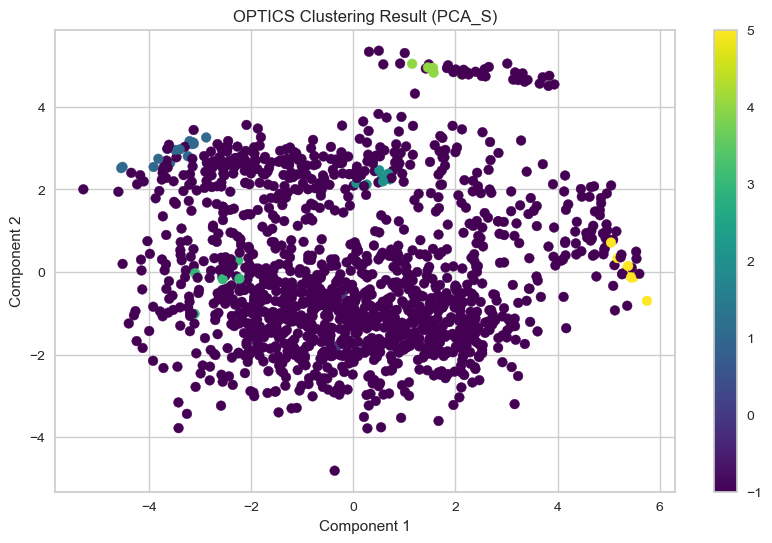

Spectral Clustering - Silhouette Score for PCA_S: 0.12479564114280599
Spectral Clustering - Davies-Bouldin Index for PCA_S: 0.9163430893477
Spectral Clustering - Calinski-Harabasz Index for PCA_S: 2.5125644826417797


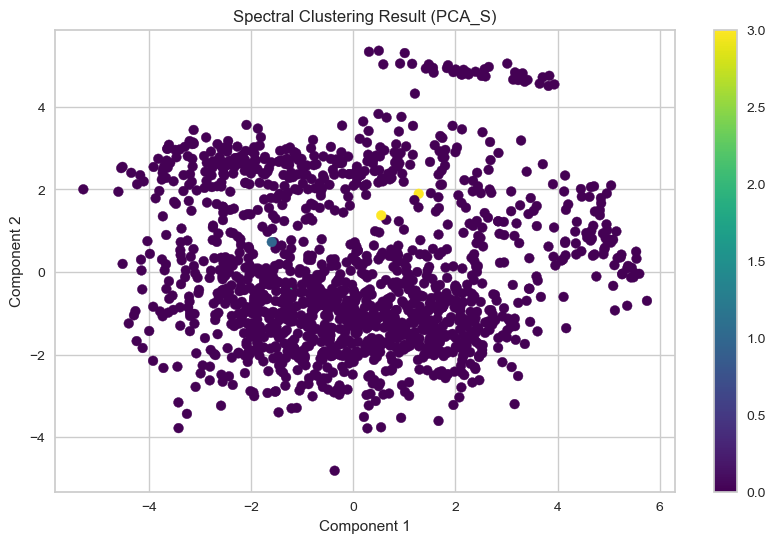

In [ ]:
evaluate_clustering(pca_result_S, 'PCA_S')

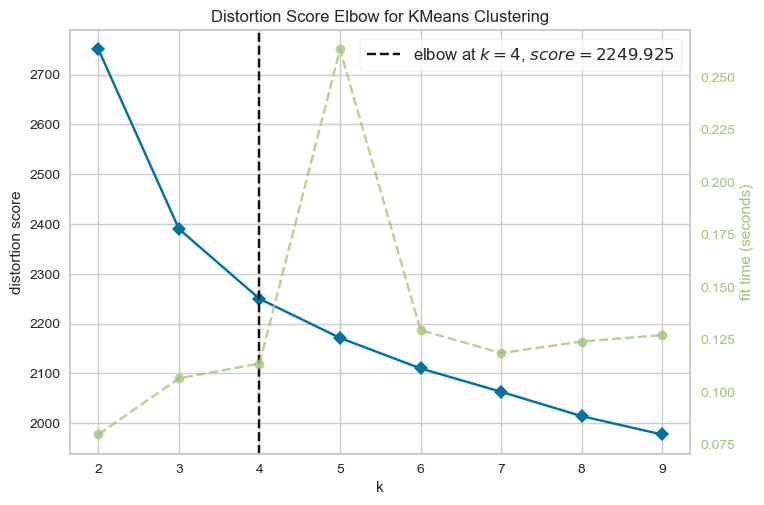

KMeans - Silhouette Score for MCA: 0.1372920973145127
KMeans - Davies-Bouldin Index for MCA: 2.3842115312825762
KMeans - Calinski-Harabasz Index for MCA: 203.5887106960234


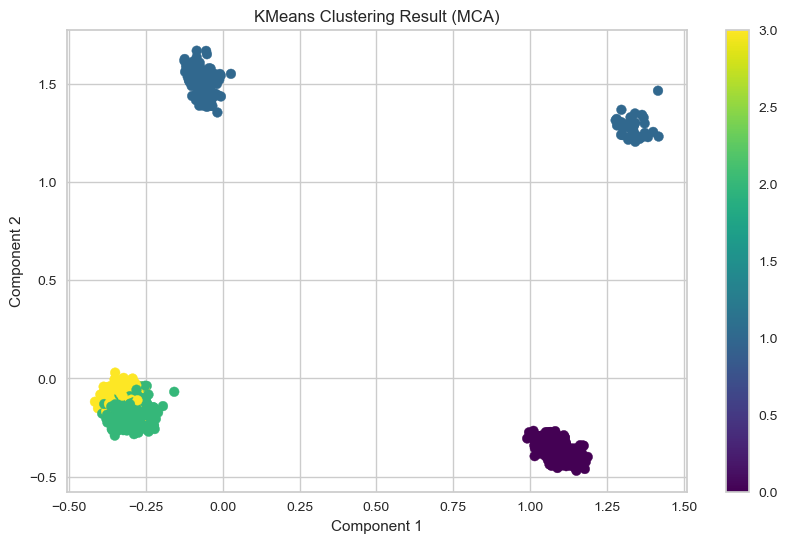

GMM - Silhouette Score for MCA: 0.20323394680942405
GMM - Davies-Bouldin Index for MCA: 1.958086918390835
GMM - Calinski-Harabasz Index for MCA: 200.99231305430632


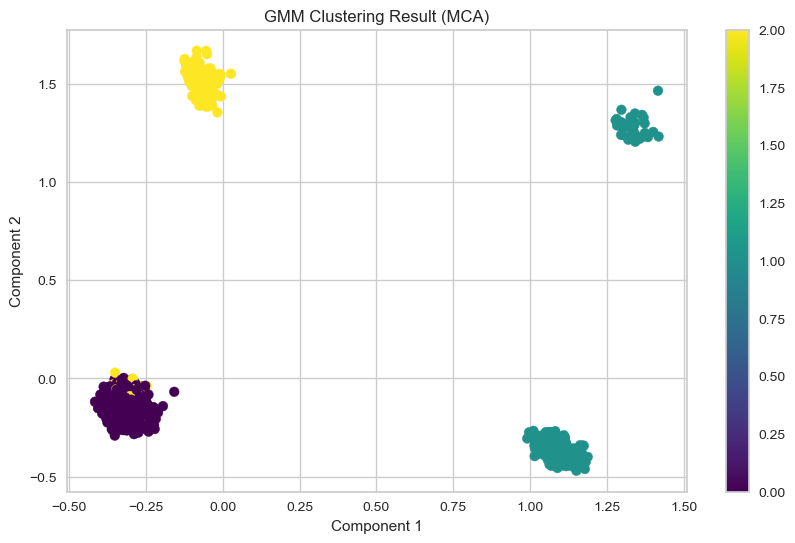

Hierarchical Clustering - Silhouette Score for MCA: 0.19897161914991457
Hierarchical Clustering - Davies-Bouldin Index for MCA: 1.600128133713664
Hierarchical Clustering - Calinski-Harabasz Index for MCA: 234.15913999876847


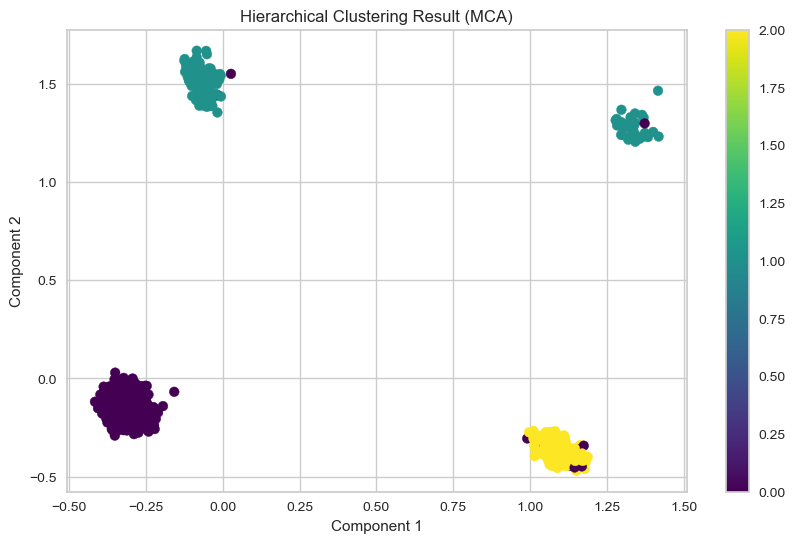

DBSCAN - Insufficient clusters for MCA


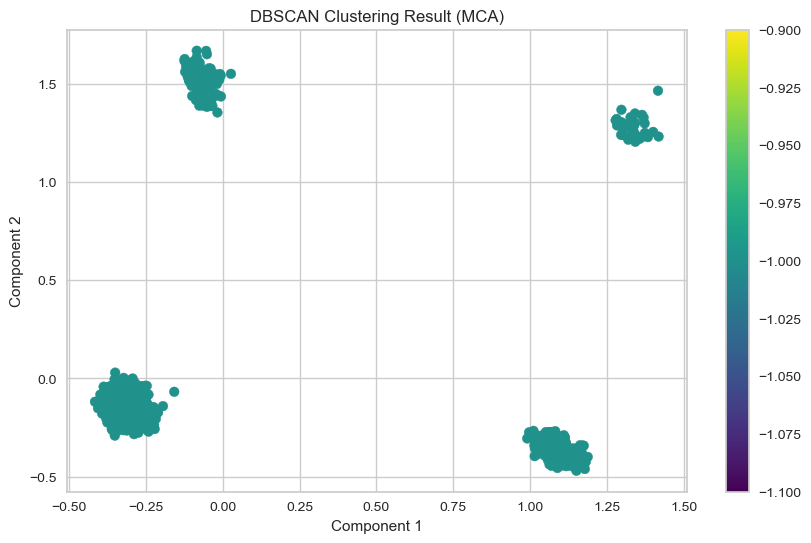

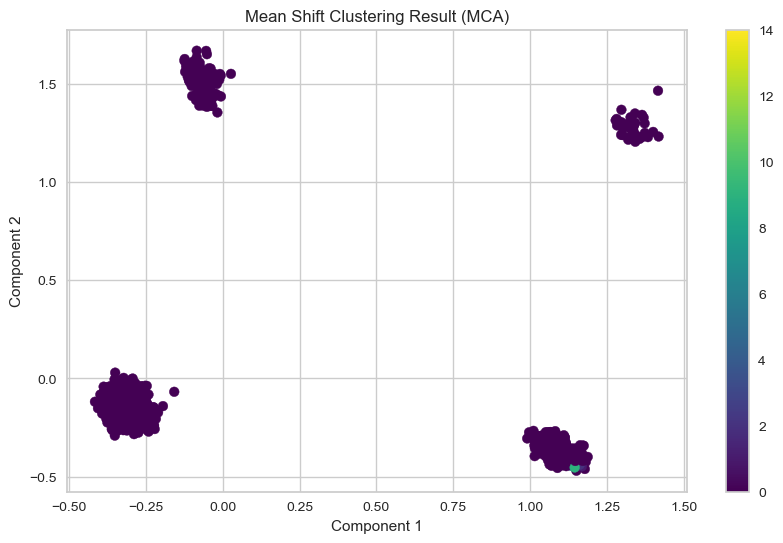

Affinity Propagation - Silhouette Score for MCA: 0.03901115392580448
Affinity Propagation - Davies-Bouldin Index for MCA: 2.14533525637972
Affinity Propagation - Calinski-Harabasz Index for MCA: 21.07838572696287


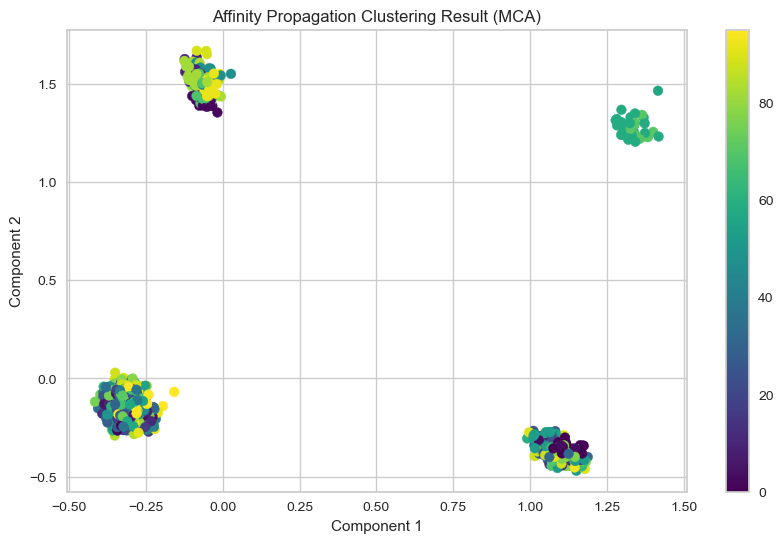

Birch - Silhouette Score for MCA: 0.20449925399577798
Birch - Davies-Bouldin Index for MCA: 1.6040859910476117
Birch - Calinski-Harabasz Index for MCA: 239.290885040817


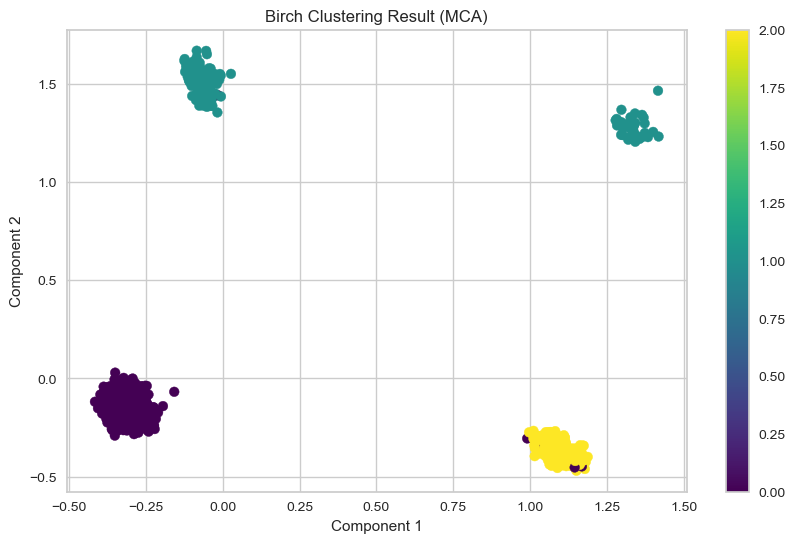

OPTICS - Silhouette Score for MCA: -0.07578121475506189
OPTICS - Davies-Bouldin Index for MCA: 1.287999126537532
OPTICS - Calinski-Harabasz Index for MCA: 9.360163670772156


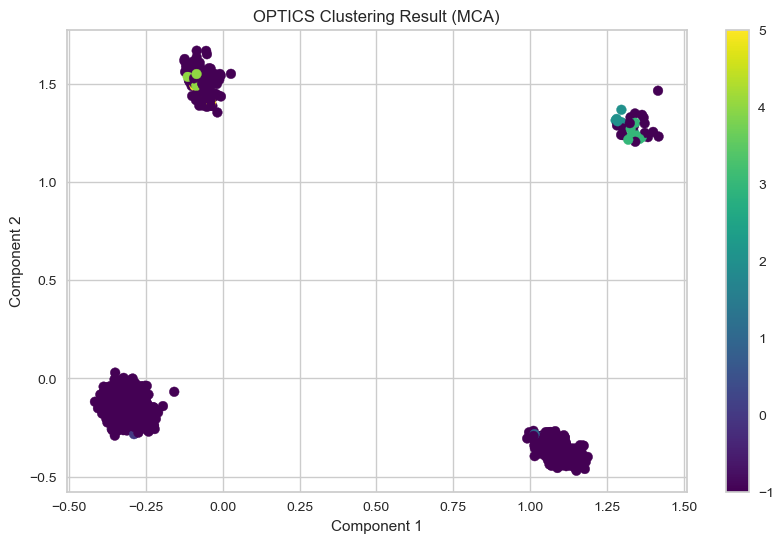

Spectral Clustering - Silhouette Score for MCA: 0.21064691740870176
Spectral Clustering - Davies-Bouldin Index for MCA: 1.540717331611814
Spectral Clustering - Calinski-Harabasz Index for MCA: 179.99684417686396


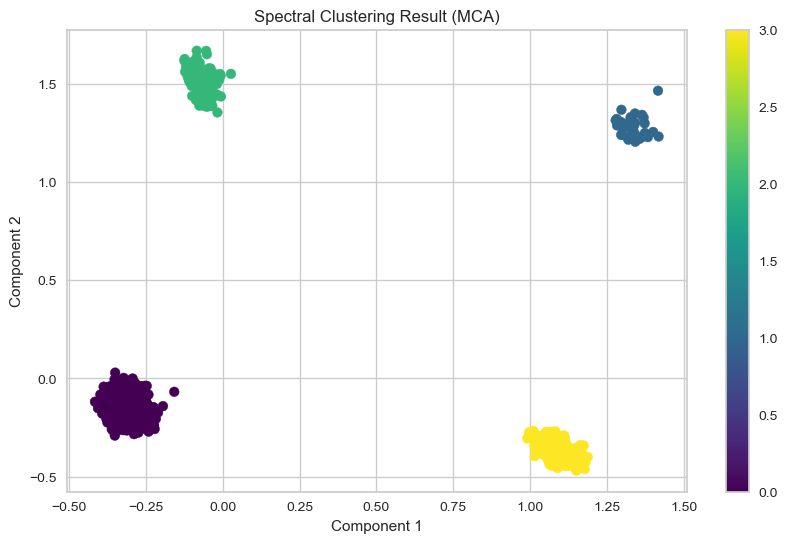

In [ ]:
if isinstance(mca_result, pd.DataFrame):
    mca_result = mca_result.values

evaluate_clustering(mca_result, 'MCA')

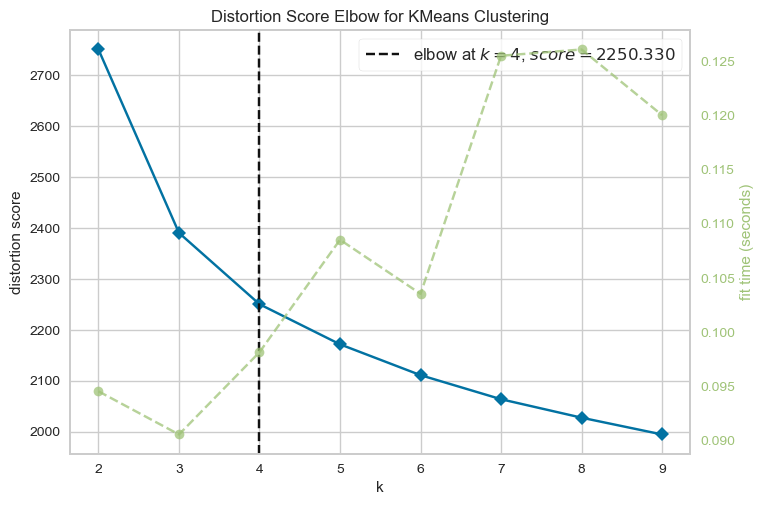

KMeans - Silhouette Score for MCA_MM: 0.13746708896446228
KMeans - Davies-Bouldin Index for MCA_MM: 2.3822669898638216
KMeans - Calinski-Harabasz Index for MCA_MM: 203.55560551667253


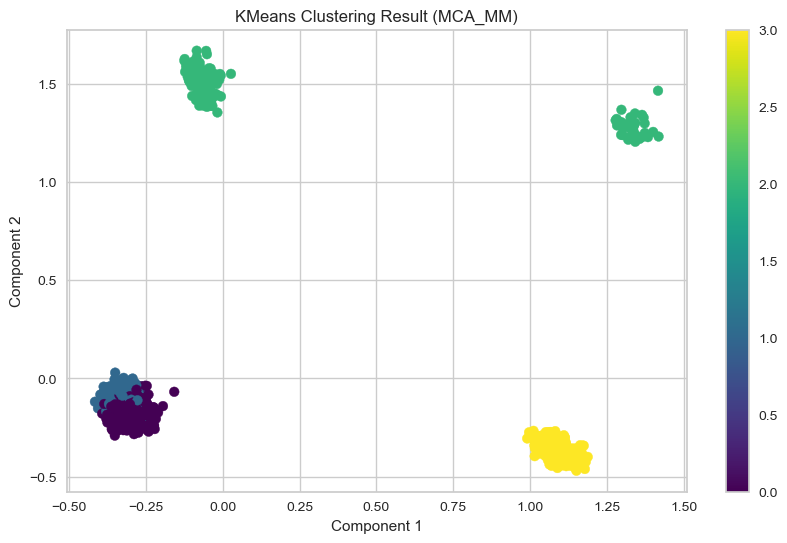

GMM - Silhouette Score for MCA_MM: 0.15112213889788573
GMM - Davies-Bouldin Index for MCA_MM: 2.4770527114266545
GMM - Calinski-Harabasz Index for MCA_MM: 177.16571600722006


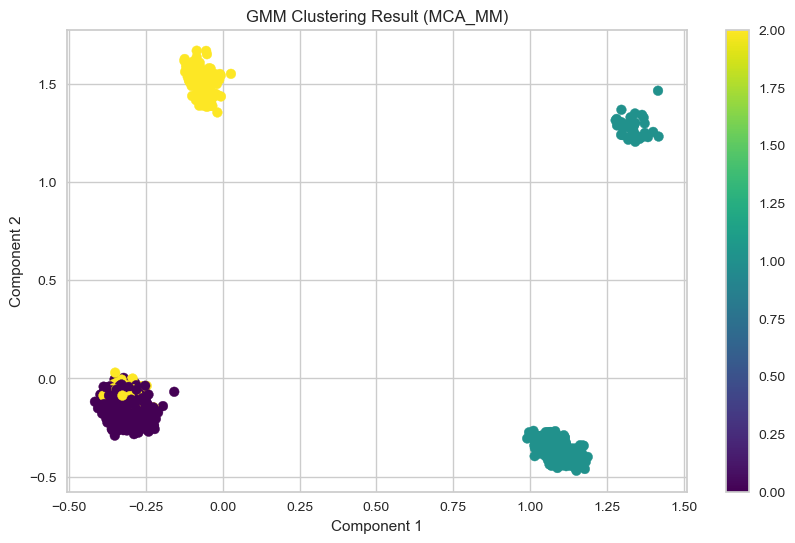

Hierarchical Clustering - Silhouette Score for MCA_MM: 0.20138232552462815
Hierarchical Clustering - Davies-Bouldin Index for MCA_MM: 1.607650546809537
Hierarchical Clustering - Calinski-Harabasz Index for MCA_MM: 232.4685711710975


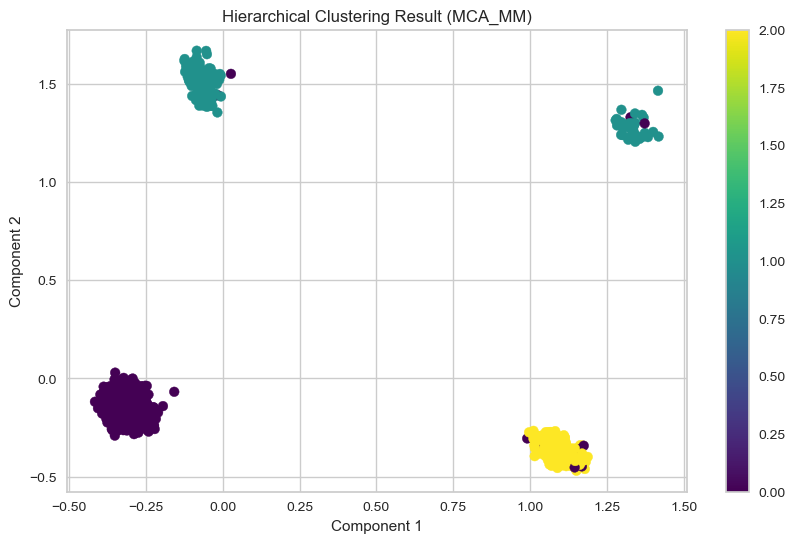

DBSCAN - Insufficient clusters for MCA_MM


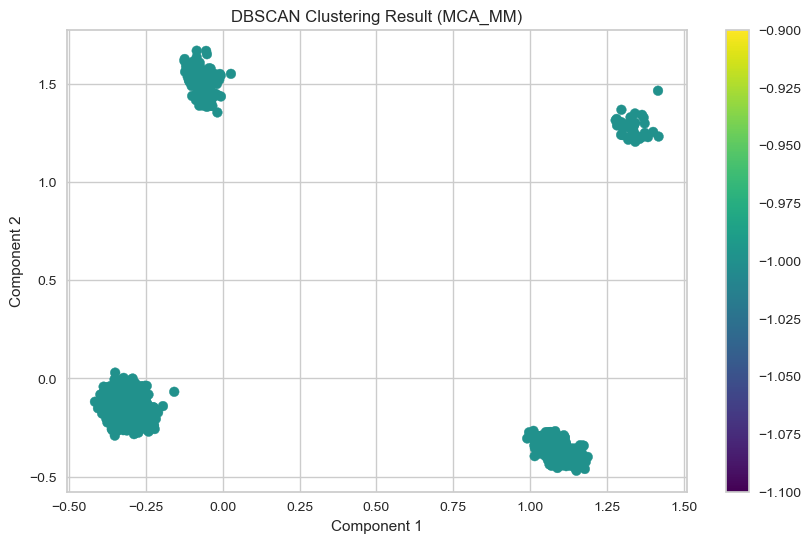

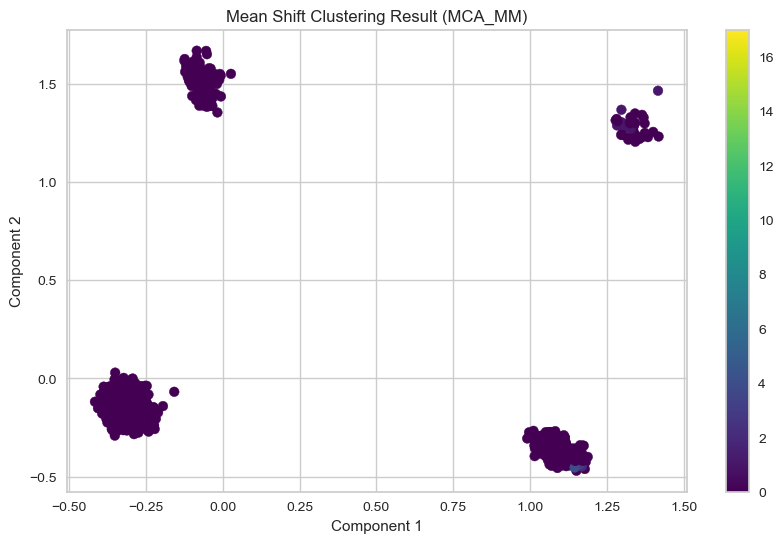

Affinity Propagation - Silhouette Score for MCA_MM: 0.03534747021800725
Affinity Propagation - Davies-Bouldin Index for MCA_MM: 2.111155569760401
Affinity Propagation - Calinski-Harabasz Index for MCA_MM: 20.474148732329187


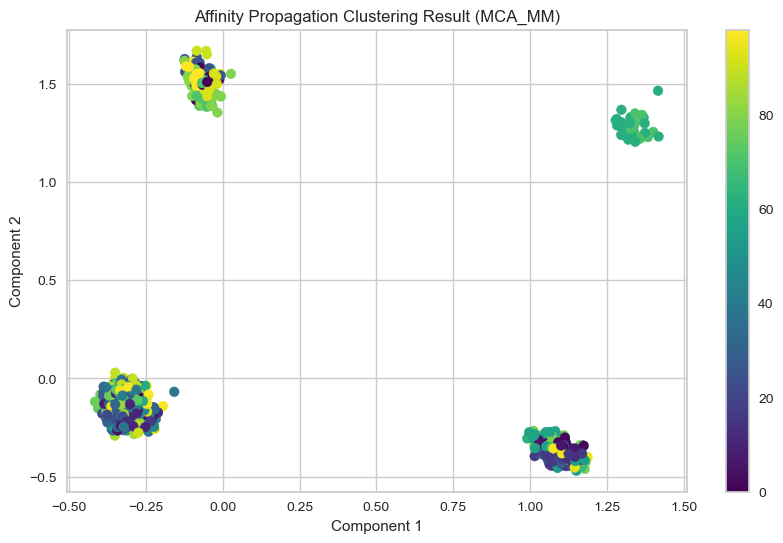

Birch - Silhouette Score for MCA_MM: 0.20157019204791937
Birch - Davies-Bouldin Index for MCA_MM: 1.6138057317727117
Birch - Calinski-Harabasz Index for MCA_MM: 232.5668572117521


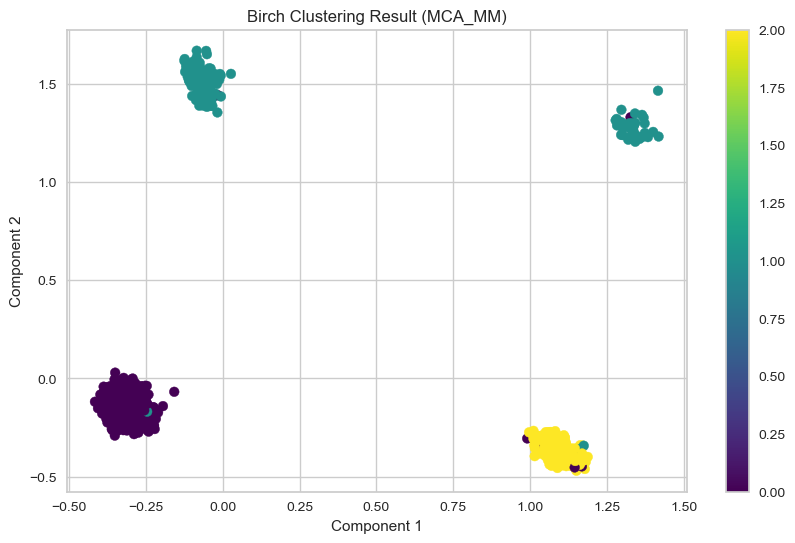

OPTICS - Silhouette Score for MCA_MM: -0.10480948156027214
OPTICS - Davies-Bouldin Index for MCA_MM: 1.5921013019759251
OPTICS - Calinski-Harabasz Index for MCA_MM: 37.580480905420714


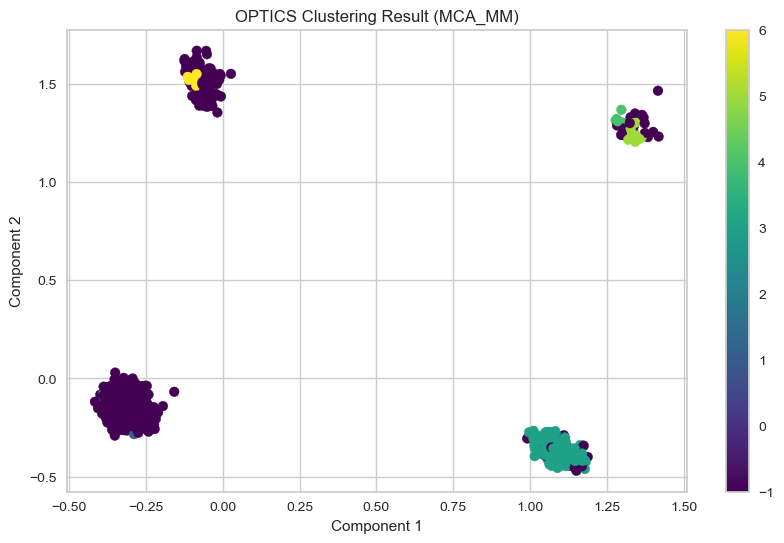

Spectral Clustering - Silhouette Score for MCA_MM: 0.20926722174417367
Spectral Clustering - Davies-Bouldin Index for MCA_MM: 1.5327179625128289
Spectral Clustering - Calinski-Harabasz Index for MCA_MM: 180.49951798392925


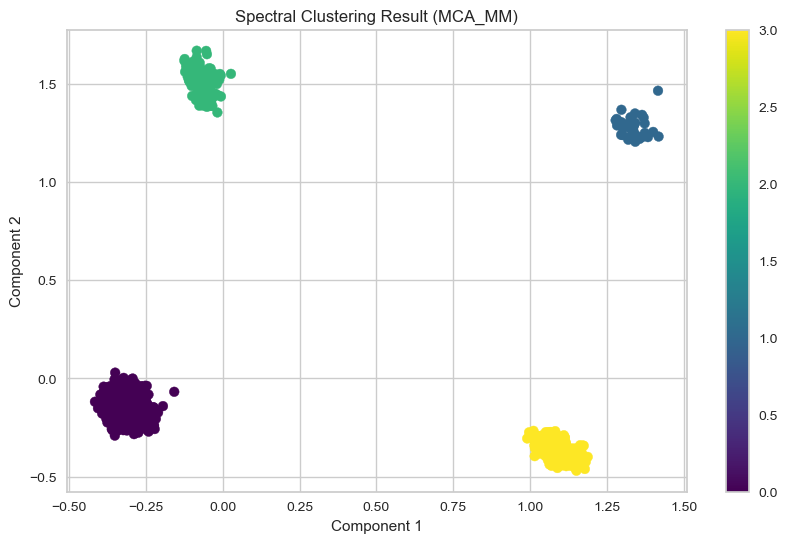

In [ ]:
if isinstance(mca_result_MM, pd.DataFrame):
    mca_result_MM = mca_result_MM.values

evaluate_clustering(mca_result_MM, 'MCA_MM')

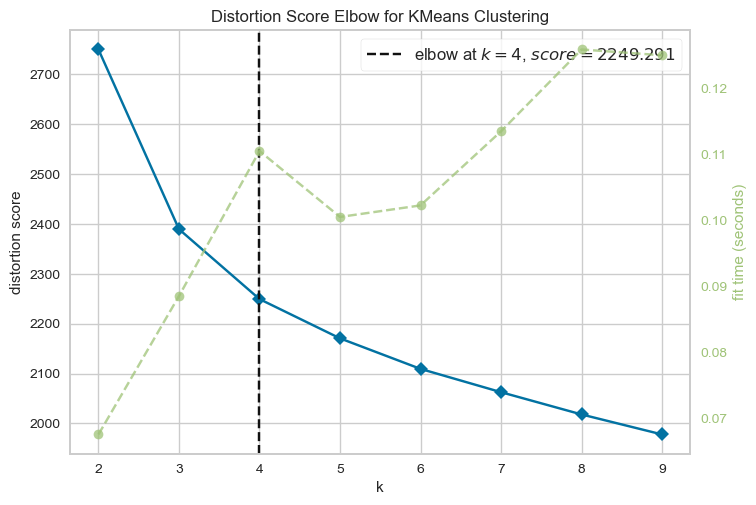

KMeans - Silhouette Score for MCA_S: 0.13720420478900644
KMeans - Davies-Bouldin Index for MCA_S: 2.382409245216576
KMeans - Calinski-Harabasz Index for MCA_S: 203.6573867074263


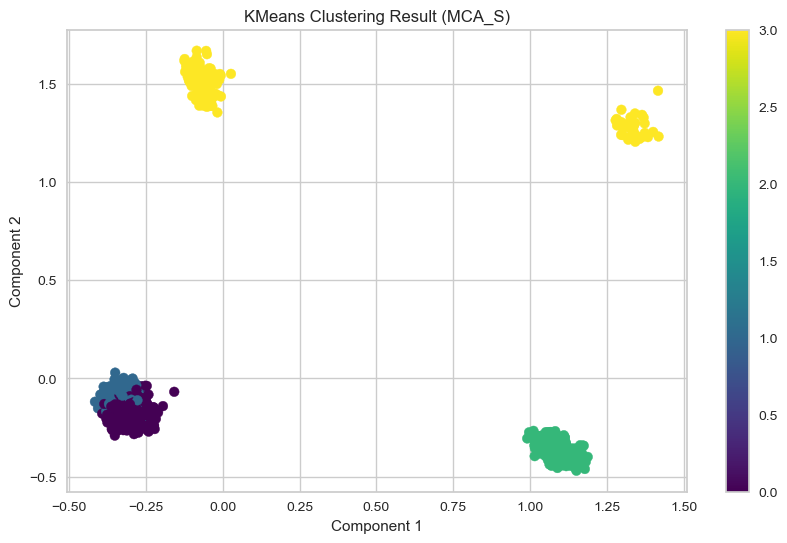

GMM - Silhouette Score for MCA_S: 0.12236378709043234
GMM - Davies-Bouldin Index for MCA_S: 2.799608654559023
GMM - Calinski-Harabasz Index for MCA_S: 167.24267747614113


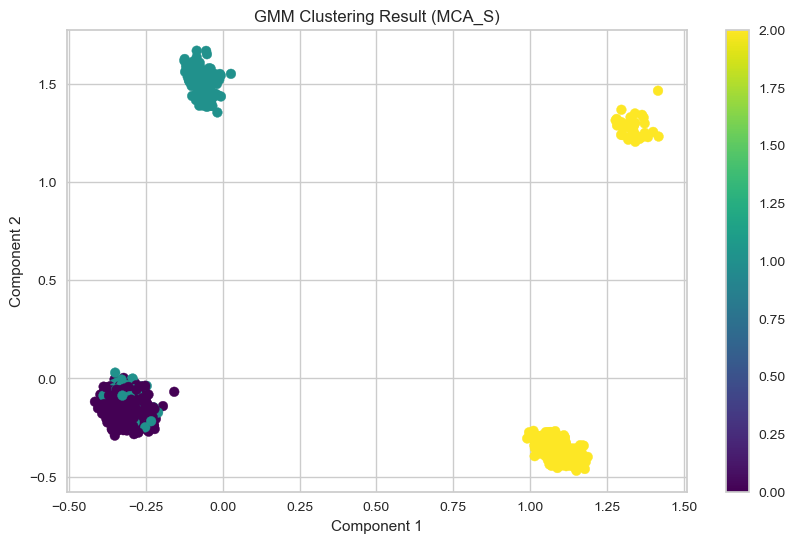

Hierarchical Clustering - Silhouette Score for MCA_S: 0.20165234656225878
Hierarchical Clustering - Davies-Bouldin Index for MCA_S: 1.5987152406560596
Hierarchical Clustering - Calinski-Harabasz Index for MCA_S: 234.4558923961673


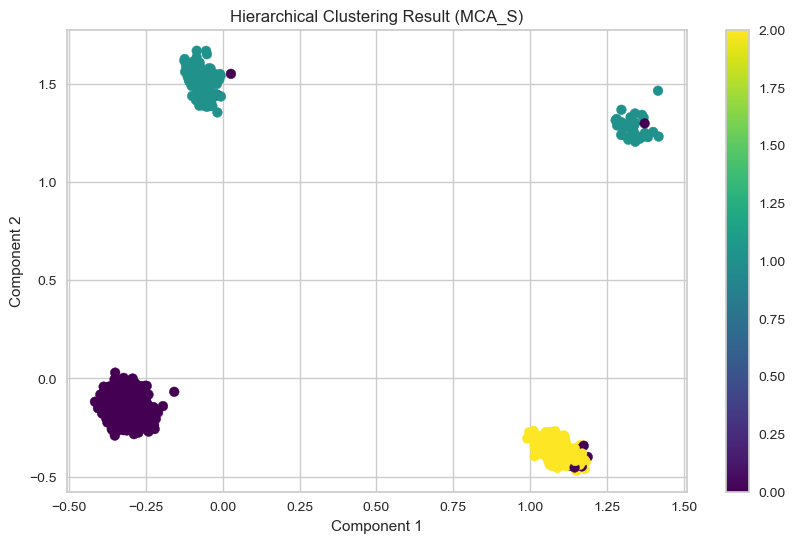

DBSCAN - Insufficient clusters for MCA_S


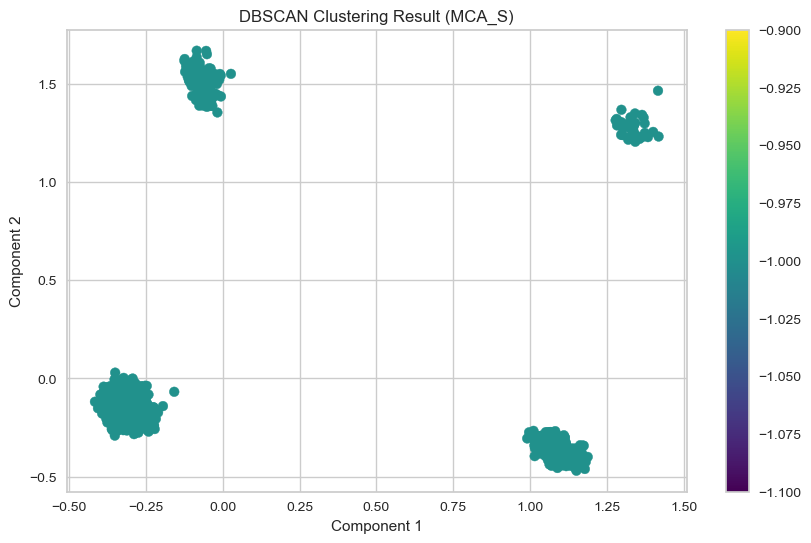

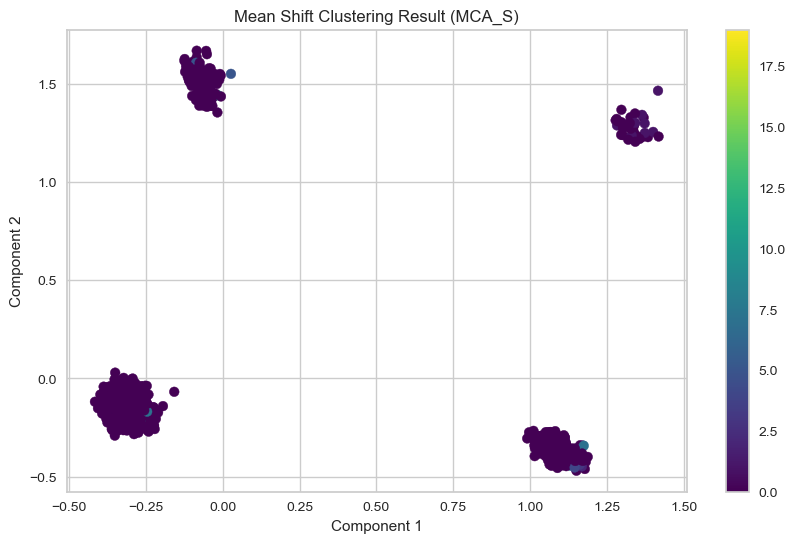

Affinity Propagation - Silhouette Score for MCA_S: 0.0390489504828046
Affinity Propagation - Davies-Bouldin Index for MCA_S: 2.114385003824645
Affinity Propagation - Calinski-Harabasz Index for MCA_S: 20.568027464648015


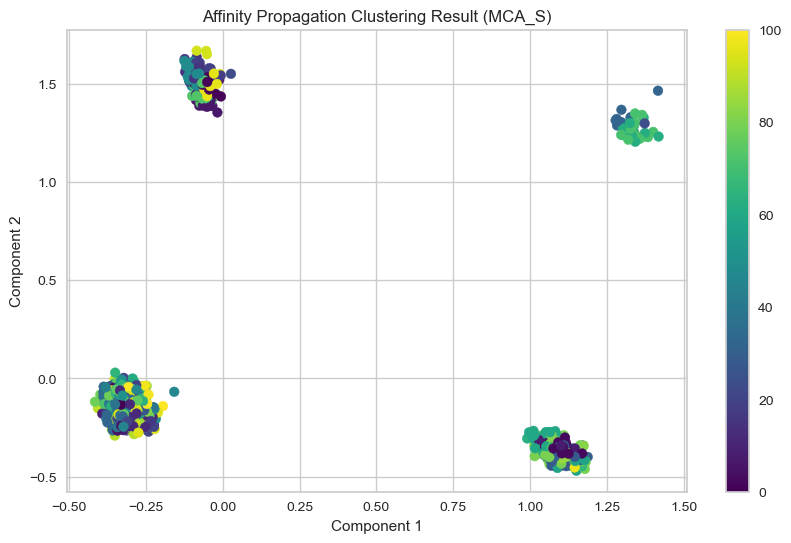

Birch - Silhouette Score for MCA_S: 0.20379073421169522
Birch - Davies-Bouldin Index for MCA_S: 1.6051852410396108
Birch - Calinski-Harabasz Index for MCA_S: 235.25654299605984


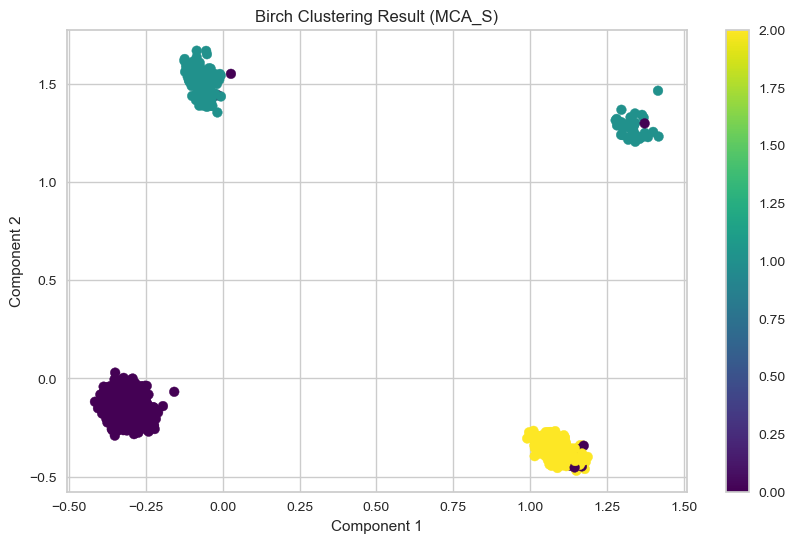

OPTICS - Silhouette Score for MCA_S: 0.06977449023725979
OPTICS - Davies-Bouldin Index for MCA_S: 1.3752916339660788
OPTICS - Calinski-Harabasz Index for MCA_S: 47.38662876021792


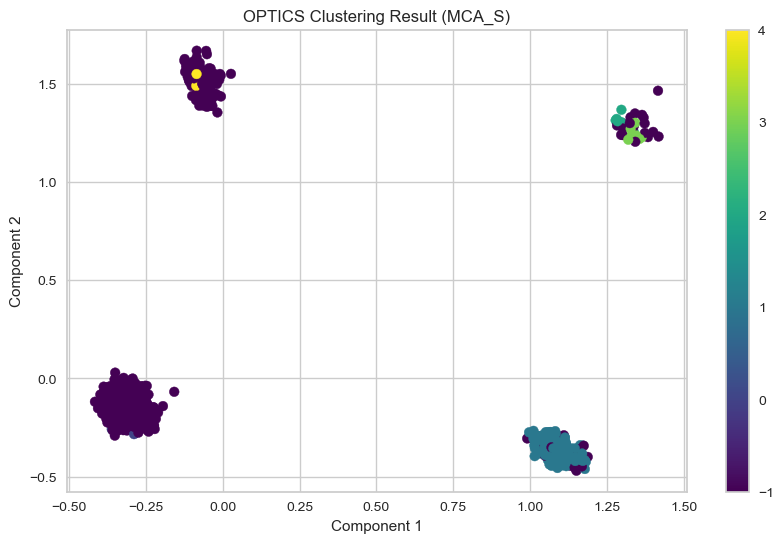

Spectral Clustering - Silhouette Score for MCA_S: 0.20962785330131675
Spectral Clustering - Davies-Bouldin Index for MCA_S: 1.5313554549881716
Spectral Clustering - Calinski-Harabasz Index for MCA_S: 180.60240400316061


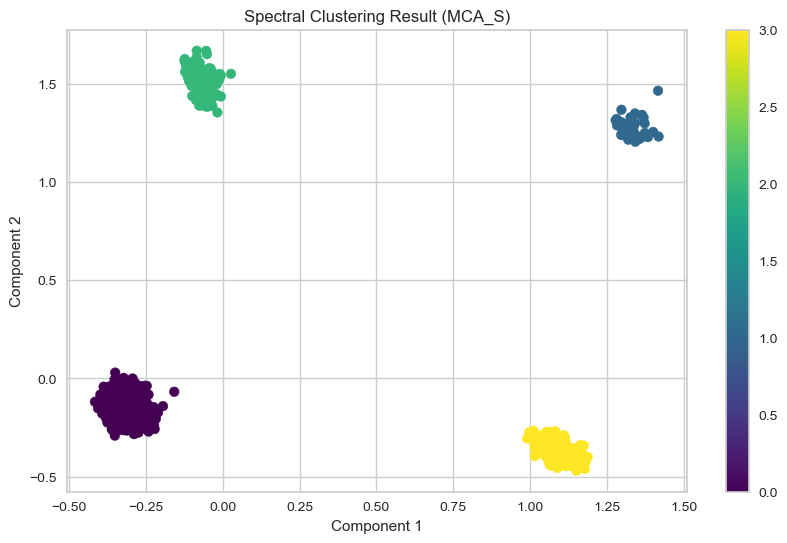

In [ ]:
if isinstance(mca_result_S, pd.DataFrame):
    mca_result_S = mca_result_S.values

evaluate_clustering(mca_result_S, 'MCA_S')

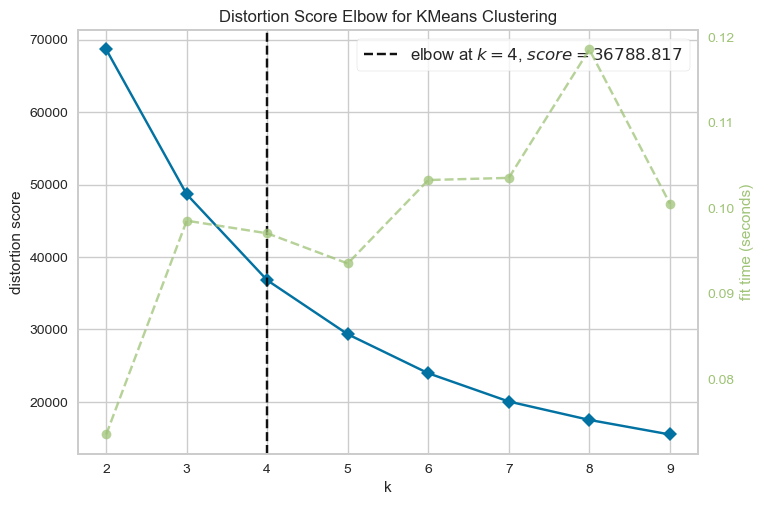

KMeans - Silhouette Score for MDS: 0.3849695321615497
KMeans - Davies-Bouldin Index for MDS: 0.8378101276402397
KMeans - Calinski-Harabasz Index for MDS: 1389.9496755677353


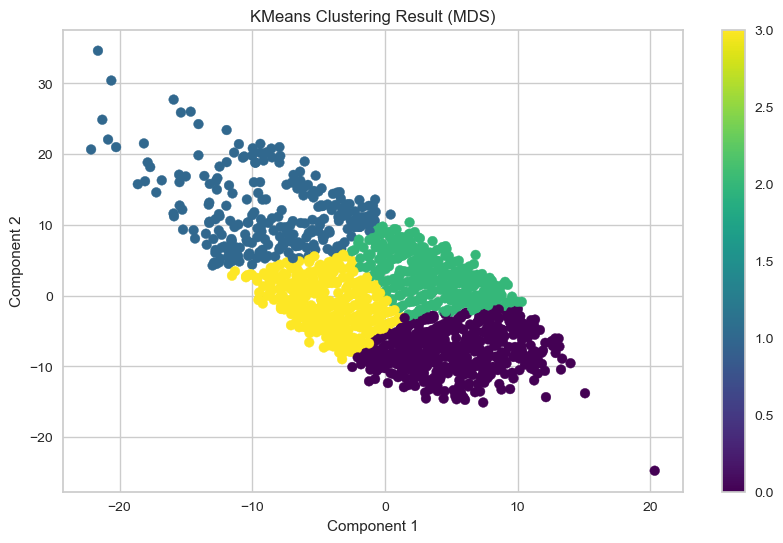

GMM - Silhouette Score for MDS: 0.3648728104571339
GMM - Davies-Bouldin Index for MDS: 0.9626565512611996
GMM - Calinski-Harabasz Index for MDS: 1378.7696746843621


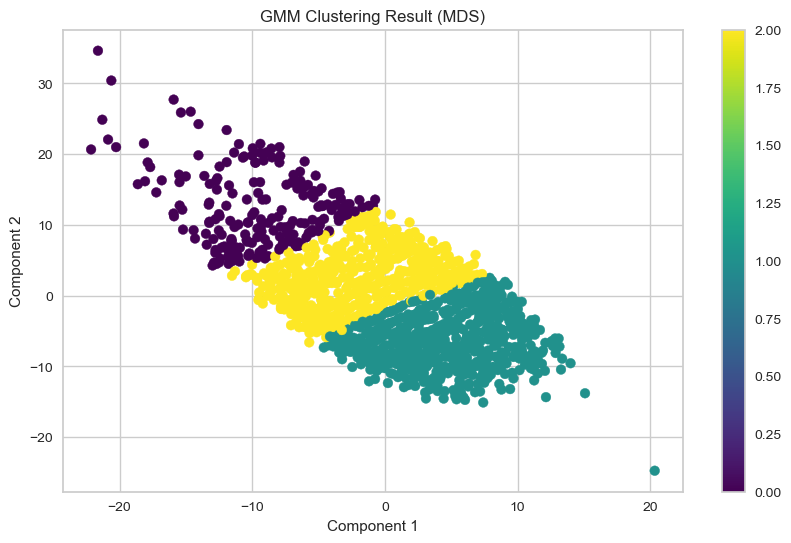

Hierarchical Clustering - Silhouette Score for MDS: 0.2502928945561336
Hierarchical Clustering - Davies-Bouldin Index for MDS: 1.0941316323799548
Hierarchical Clustering - Calinski-Harabasz Index for MDS: 1055.0874054514306


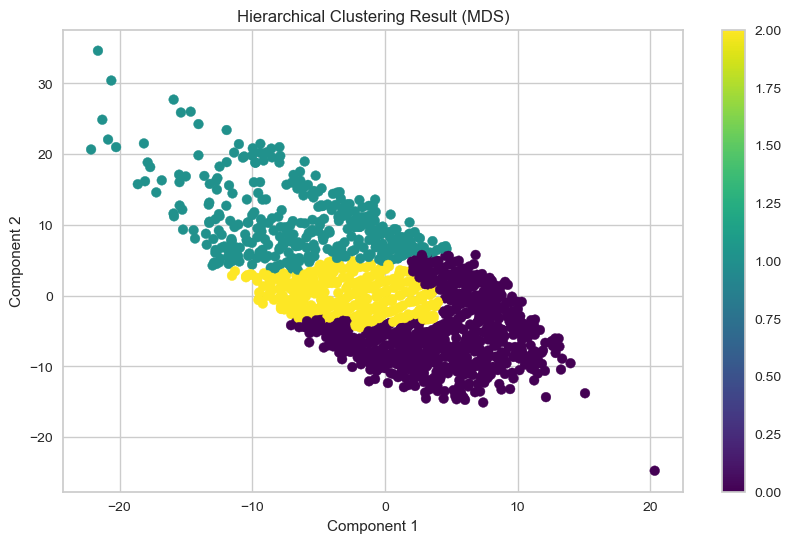

DBSCAN - Silhouette Score for MDS: -0.20019450503836914
DBSCAN - Davies-Bouldin Index for MDS: 2.9959832003630447
DBSCAN - Calinski-Harabasz Index for MDS: 5.911467227685965


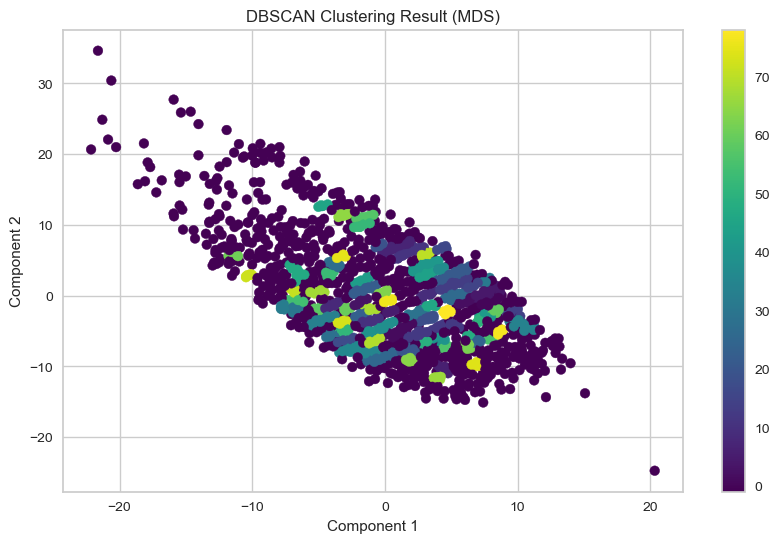

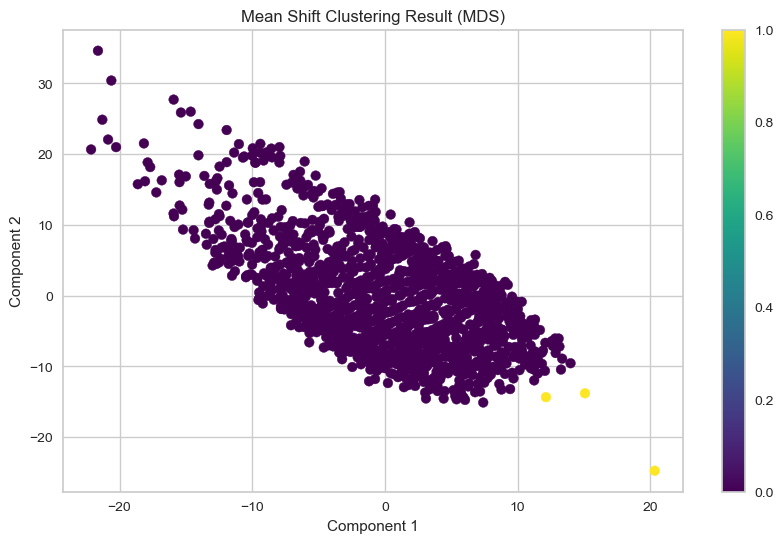

Affinity Propagation - Silhouette Score for MDS: 0.3276733739038798
Affinity Propagation - Davies-Bouldin Index for MDS: 0.7938280535247271
Affinity Propagation - Calinski-Harabasz Index for MDS: 1443.7164611847118


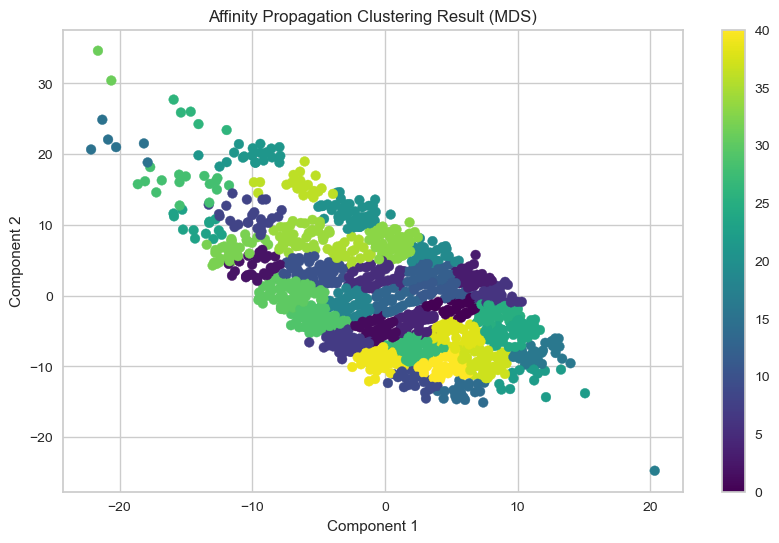

Birch - Silhouette Score for MDS: 0.34635014879980386
Birch - Davies-Bouldin Index for MDS: 0.8433555014613355
Birch - Calinski-Harabasz Index for MDS: 1062.581733994195


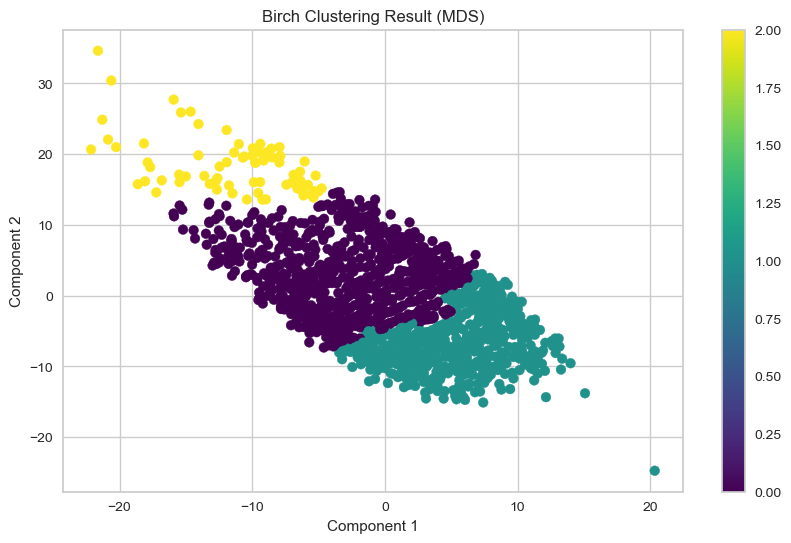

OPTICS - Silhouette Score for MDS: -0.11183035818690655
OPTICS - Davies-Bouldin Index for MDS: 1.725059543046855
OPTICS - Calinski-Harabasz Index for MDS: 12.542031432725189


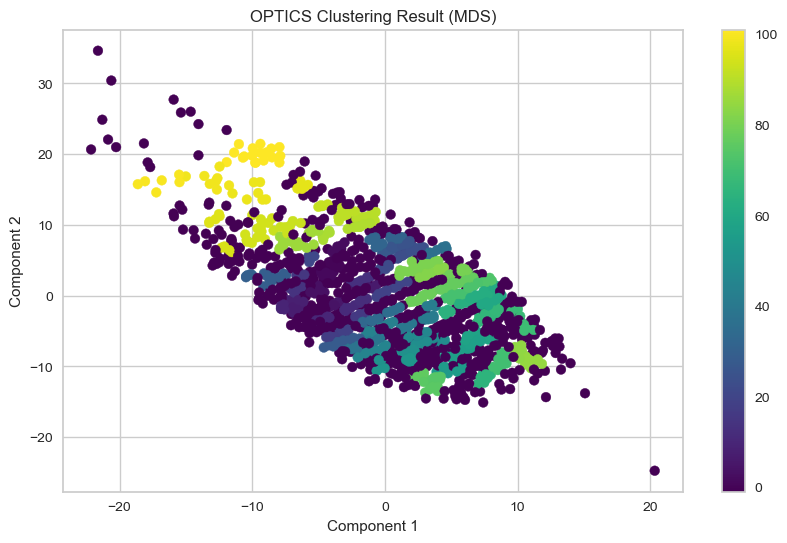

Spectral Clustering - Silhouette Score for MDS: 0.6002637778818681
Spectral Clustering - Davies-Bouldin Index for MDS: 0.27407304835433344
Spectral Clustering - Calinski-Harabasz Index for MDS: 10.273996720382767


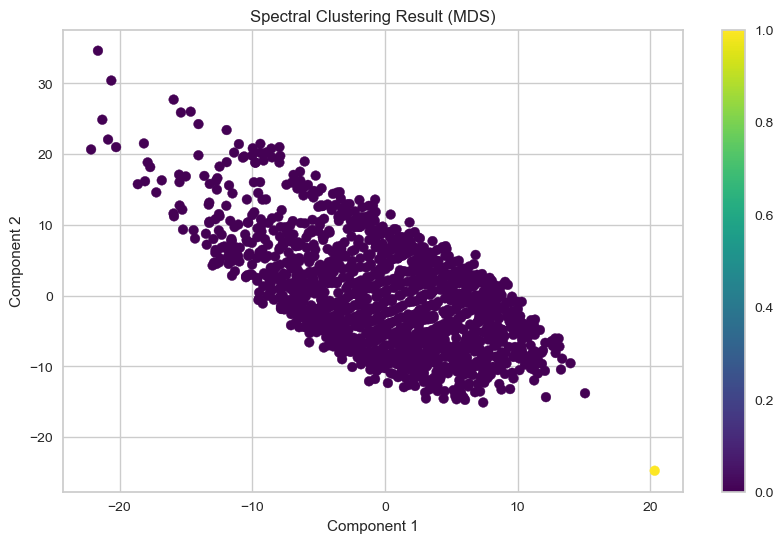

In [ ]:
evaluate_clustering(mds_result, 'MDS')

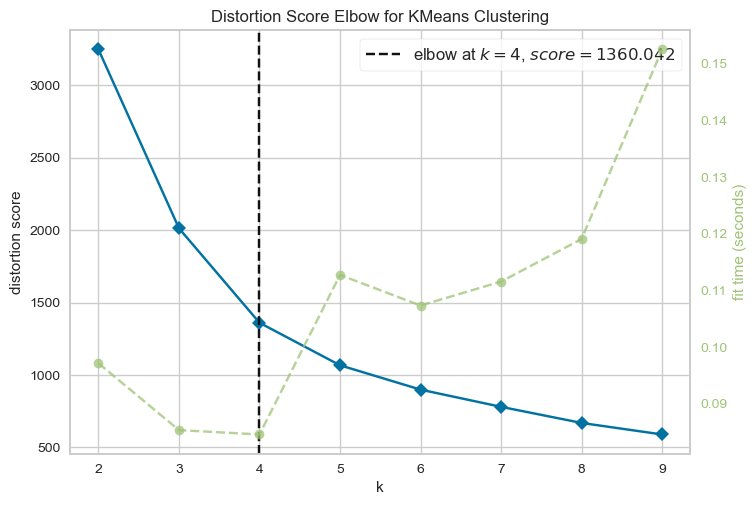

KMeans - Silhouette Score for MDS_MM: 0.4083412402311169
KMeans - Davies-Bouldin Index for MDS_MM: 0.7729318717371036
KMeans - Calinski-Harabasz Index for MDS_MM: 1452.9300252926416


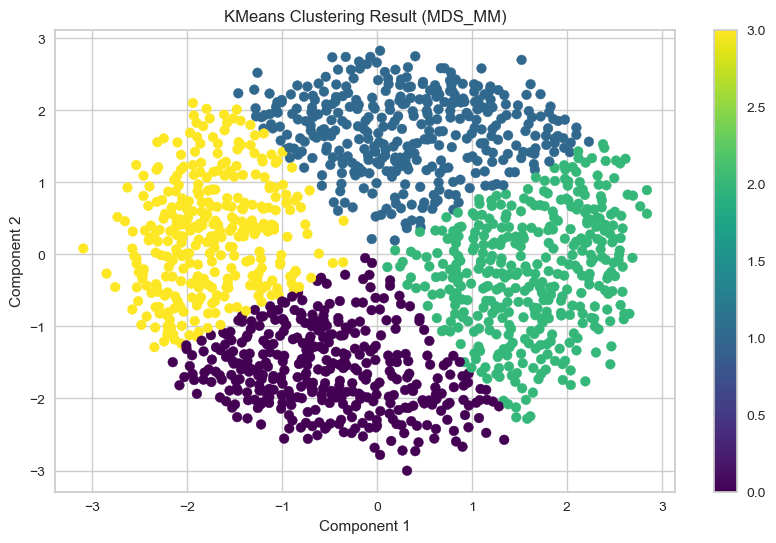

GMM - Silhouette Score for MDS_MM: 0.40831159482251705
GMM - Davies-Bouldin Index for MDS_MM: 0.8186173982054025
GMM - Calinski-Harabasz Index for MDS_MM: 1235.5757366113285


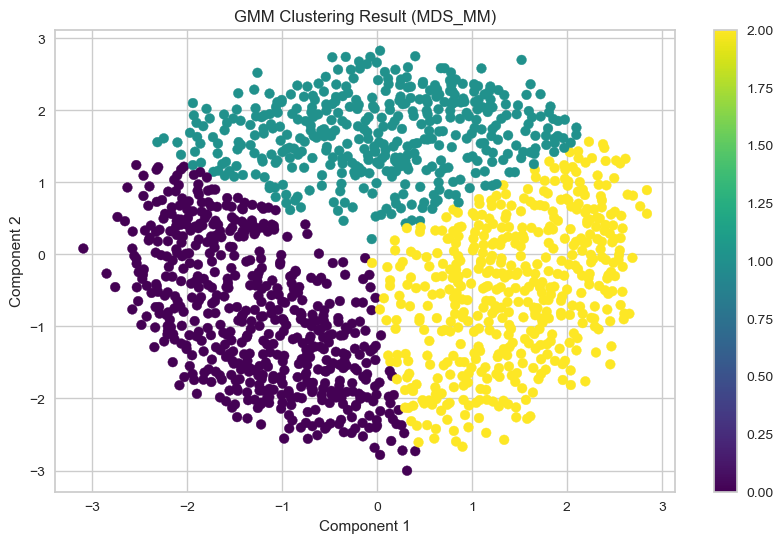

Hierarchical Clustering - Silhouette Score for MDS_MM: 0.35320587721843594
Hierarchical Clustering - Davies-Bouldin Index for MDS_MM: 0.8974830864492539
Hierarchical Clustering - Calinski-Harabasz Index for MDS_MM: 1011.1321875982063


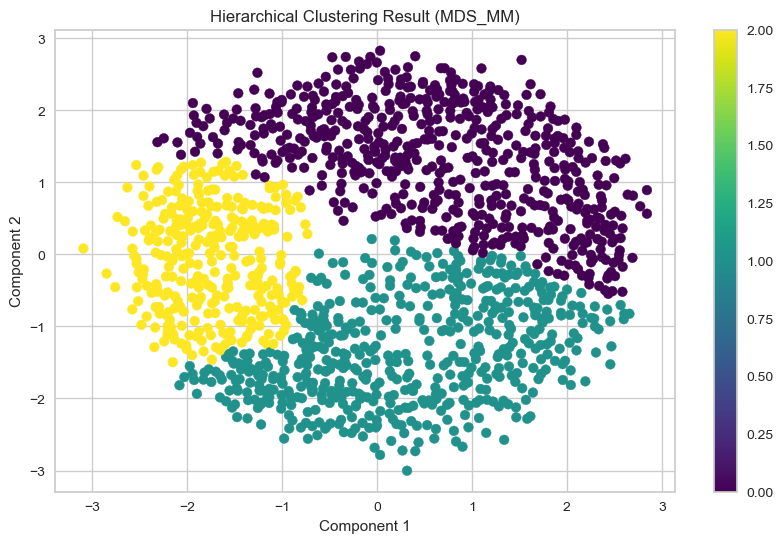

DBSCAN - Insufficient clusters for MDS_MM


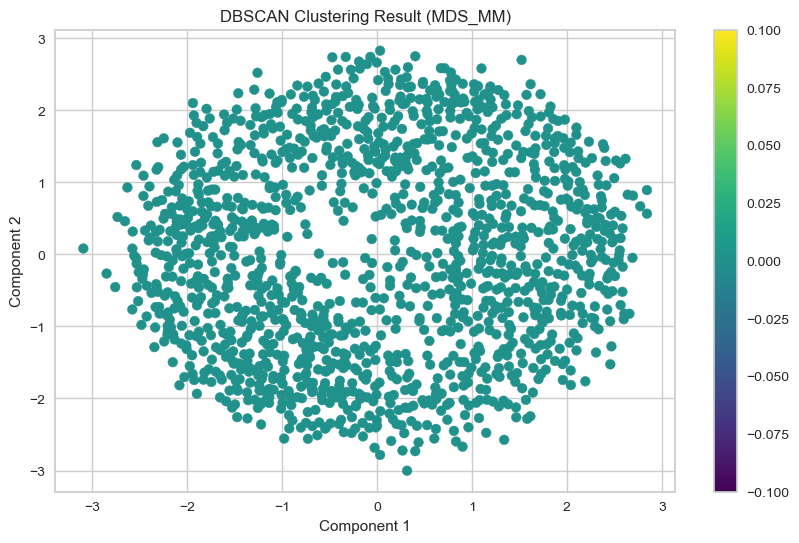

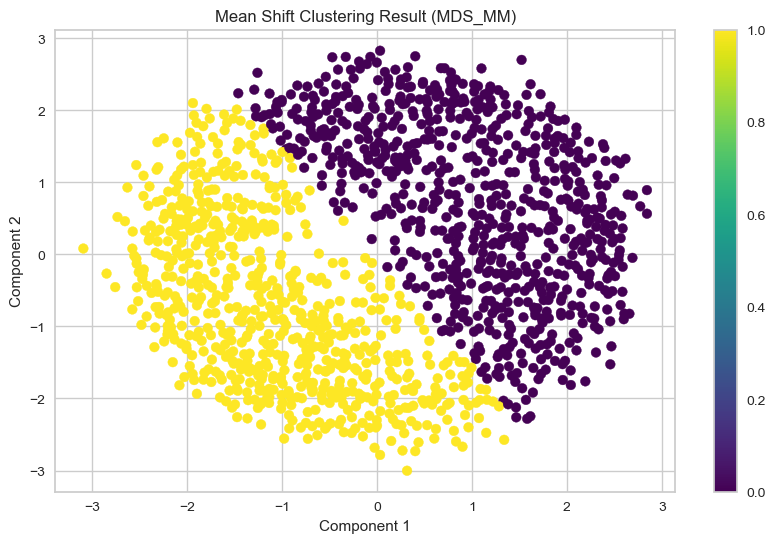

Affinity Propagation - Silhouette Score for MDS_MM: 0.30521358735046916
Affinity Propagation - Davies-Bouldin Index for MDS_MM: 0.8475908101792266
Affinity Propagation - Calinski-Harabasz Index for MDS_MM: 1365.0600122940095


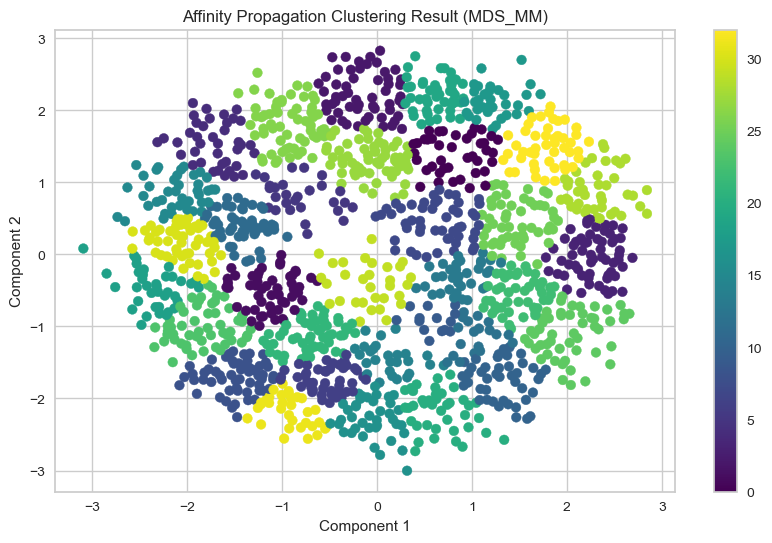

Birch - Silhouette Score for MDS_MM: 0.36986095355225257
Birch - Davies-Bouldin Index for MDS_MM: 0.8389551691557874
Birch - Calinski-Harabasz Index for MDS_MM: 1069.8709729926973


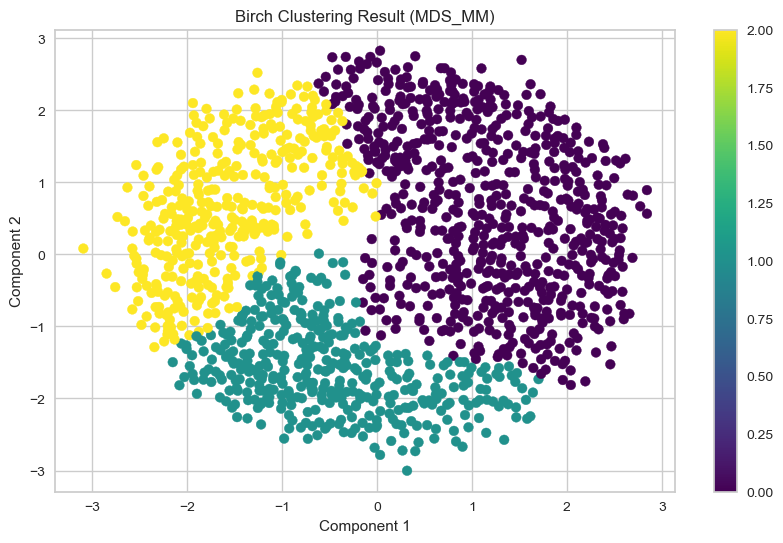

OPTICS - Silhouette Score for MDS_MM: -0.3234425194640021
OPTICS - Davies-Bouldin Index for MDS_MM: 1.2835706319214277
OPTICS - Calinski-Harabasz Index for MDS_MM: 10.33401256976053


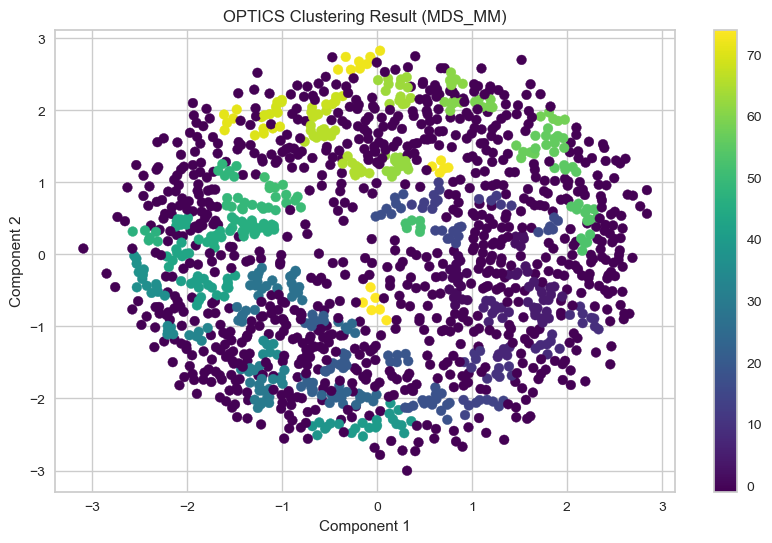

Spectral Clustering - Silhouette Score for MDS_MM: 0.4091764048309076
Spectral Clustering - Davies-Bouldin Index for MDS_MM: 0.7675180087094882
Spectral Clustering - Calinski-Harabasz Index for MDS_MM: 1449.2046856965135


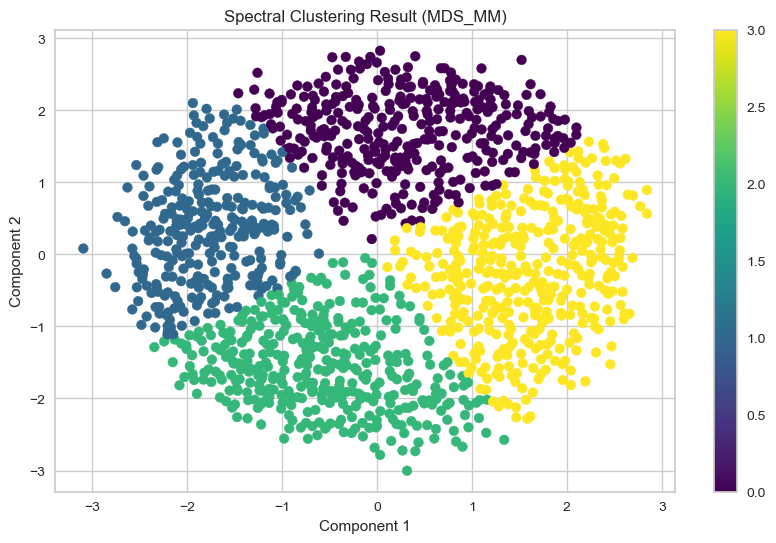

In [ ]:
evaluate_clustering(mds_result_MM, 'MDS_MM')

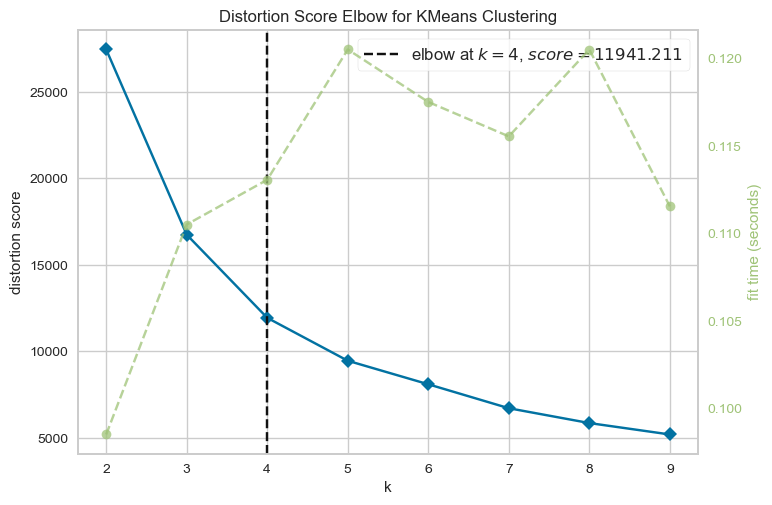

KMeans - Silhouette Score for MDS_S: 0.3788986285092465
KMeans - Davies-Bouldin Index for MDS_S: 0.8088694535185352
KMeans - Calinski-Harabasz Index for MDS_S: 1286.549904707777


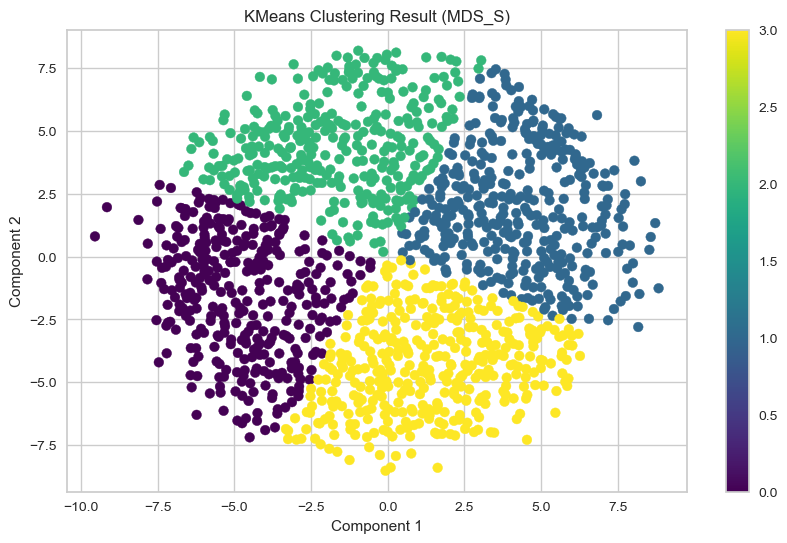

GMM - Silhouette Score for MDS_S: 0.3908014947504594
GMM - Davies-Bouldin Index for MDS_S: 0.8360514932779832
GMM - Calinski-Harabasz Index for MDS_S: 1161.3596797716887


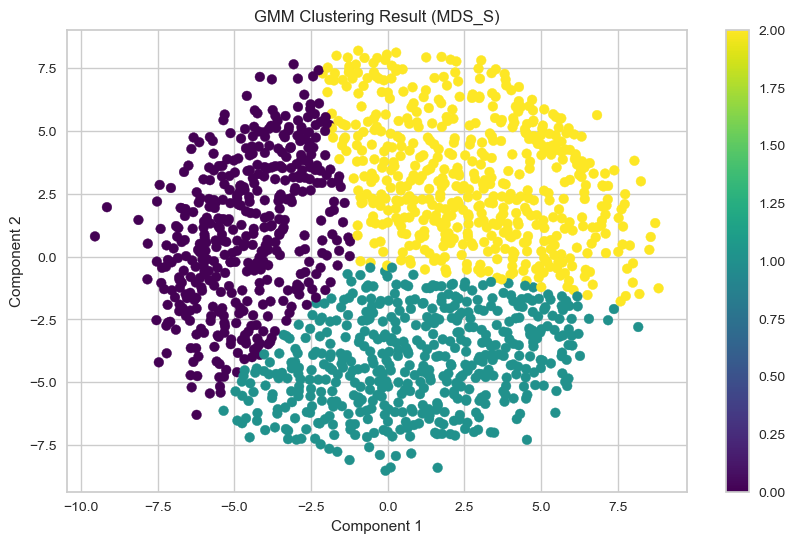

Hierarchical Clustering - Silhouette Score for MDS_S: 0.3315976655081429
Hierarchical Clustering - Davies-Bouldin Index for MDS_S: 0.9655648777513252
Hierarchical Clustering - Calinski-Harabasz Index for MDS_S: 924.7119741021114


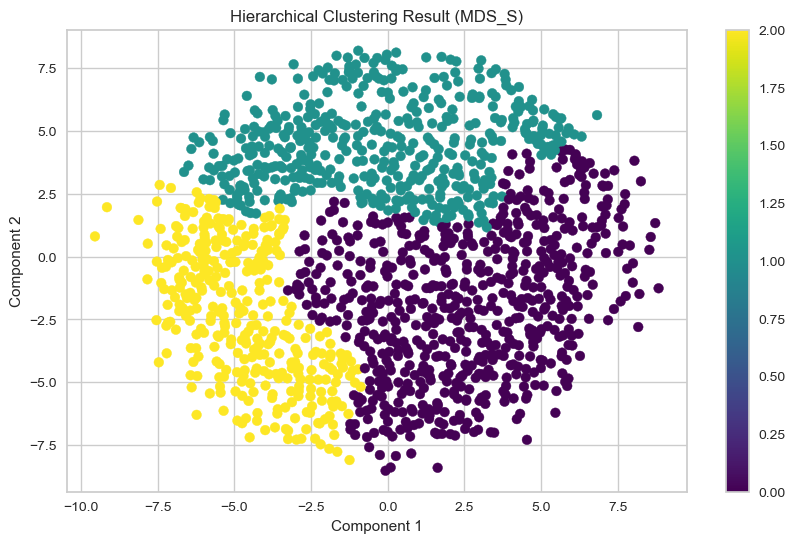

DBSCAN - Silhouette Score for MDS_S: -0.44756498990307225
DBSCAN - Davies-Bouldin Index for MDS_S: 3.0088432960894687
DBSCAN - Calinski-Harabasz Index for MDS_S: 30.63622668322174


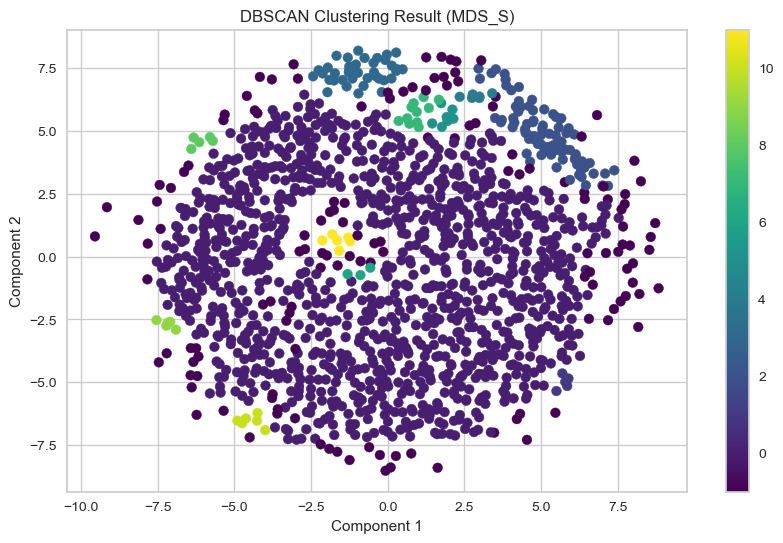

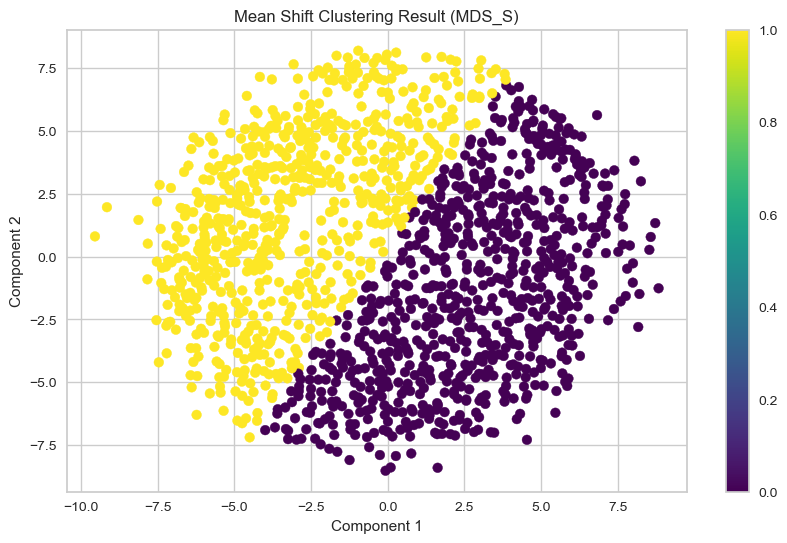

Affinity Propagation - Silhouette Score for MDS_S: 0.22131115493473694
Affinity Propagation - Davies-Bouldin Index for MDS_S: 0.5063055770269761
Affinity Propagation - Calinski-Harabasz Index for MDS_S: 280.79504824735955


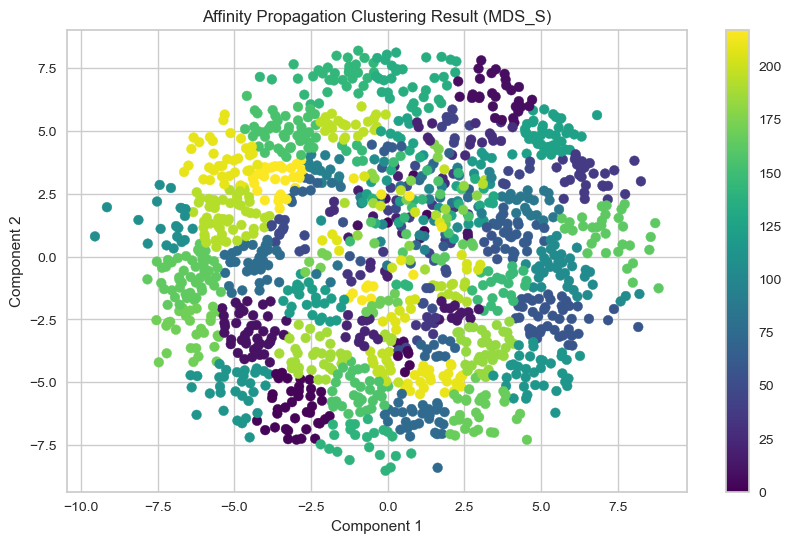

Birch - Silhouette Score for MDS_S: 0.3390328874209412
Birch - Davies-Bouldin Index for MDS_S: 0.9202226538335566
Birch - Calinski-Harabasz Index for MDS_S: 945.0485411329495


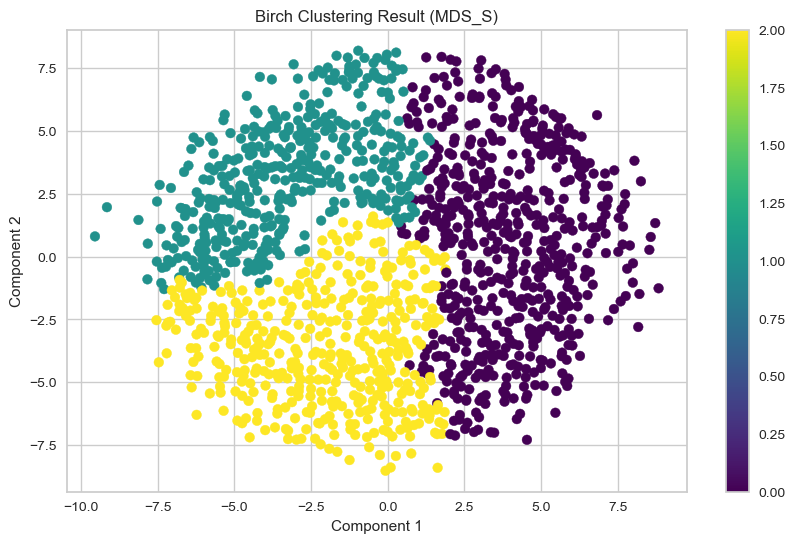

OPTICS - Silhouette Score for MDS_S: -0.338020840764151
OPTICS - Davies-Bouldin Index for MDS_S: 1.3900844214019976
OPTICS - Calinski-Harabasz Index for MDS_S: 10.79536133975124


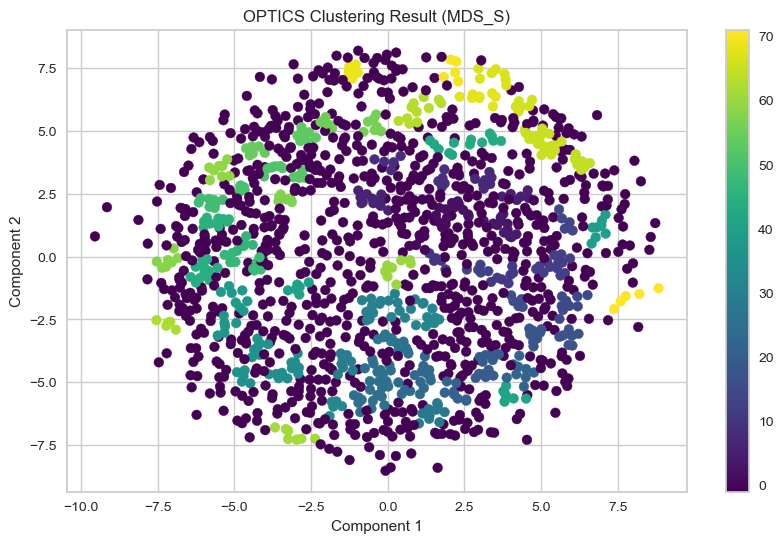

Spectral Clustering - Silhouette Score for MDS_S: 0.370915079934756
Spectral Clustering - Davies-Bouldin Index for MDS_S: 0.8073312849346441
Spectral Clustering - Calinski-Harabasz Index for MDS_S: 1236.617651691285


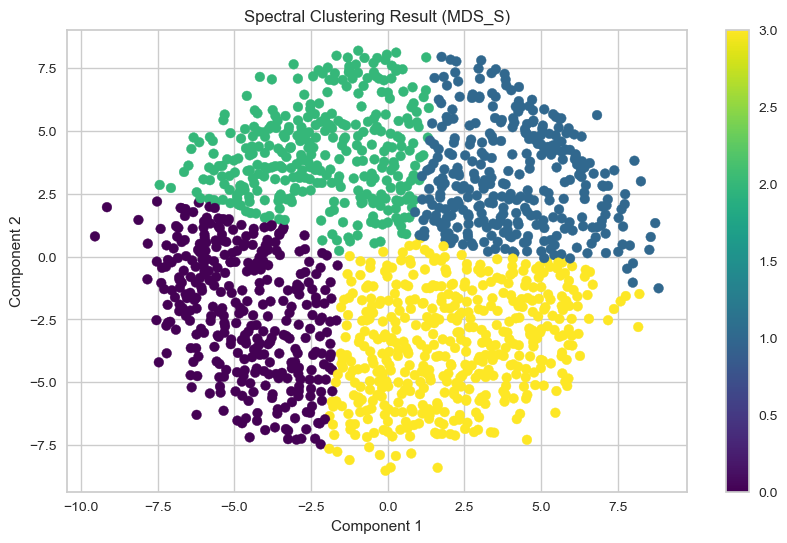

In [ ]:
evaluate_clustering(mds_result_S, 'MDS_S')

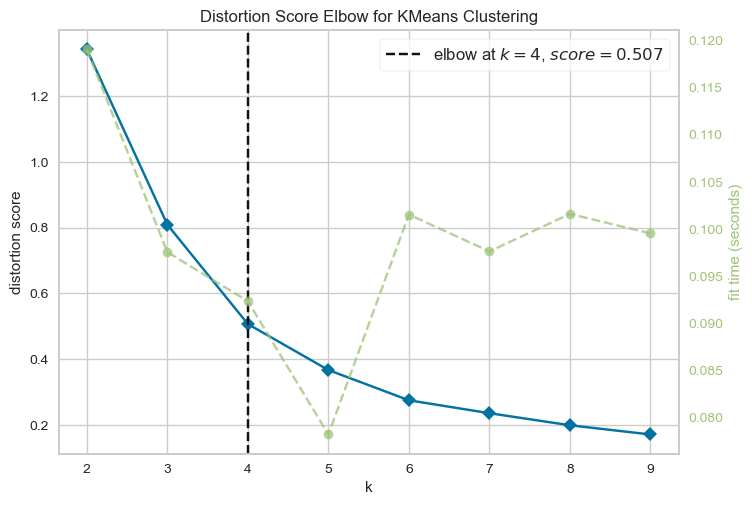

KMeans - Silhouette Score for LLE: 0.4704022126626958
KMeans - Davies-Bouldin Index for LLE: 0.6521071107418784
KMeans - Calinski-Harabasz Index for LLE: 1402.5301469153476


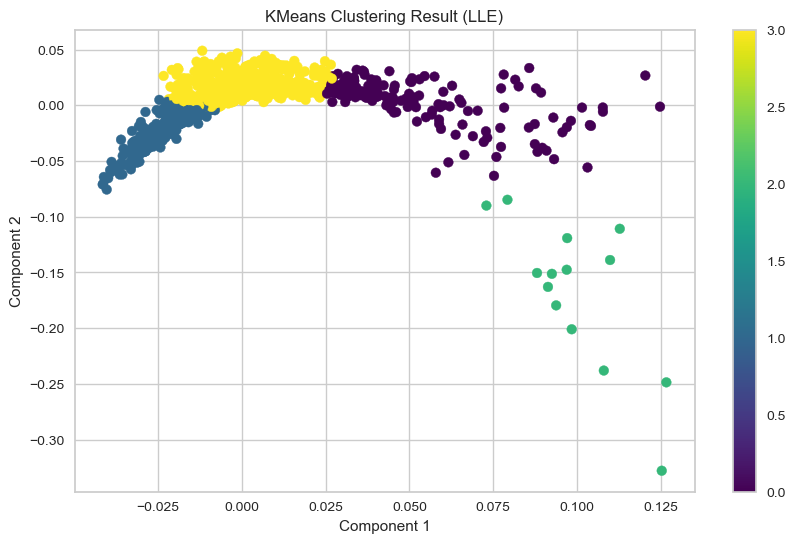

GMM - Silhouette Score for LLE: 0.372639417488063
GMM - Davies-Bouldin Index for LLE: 0.8717153218802038
GMM - Calinski-Harabasz Index for LLE: 828.0897426719877


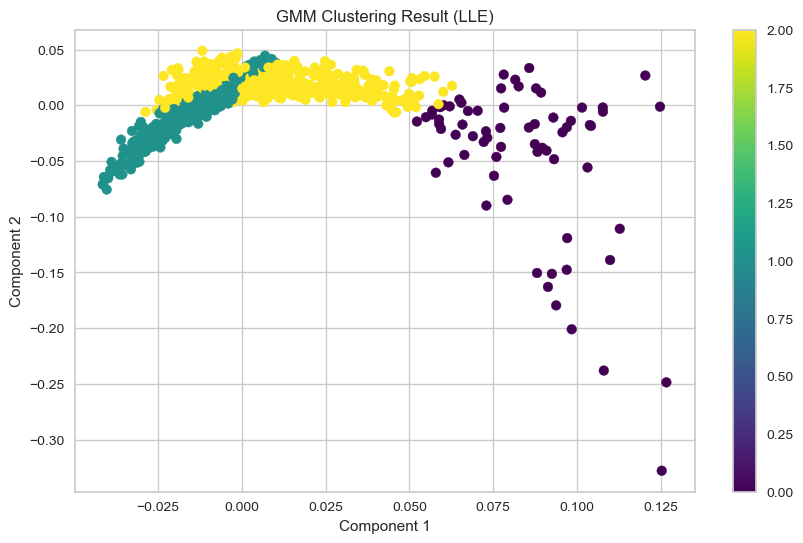

Hierarchical Clustering - Silhouette Score for LLE: 0.42444343721853367
Hierarchical Clustering - Davies-Bouldin Index for LLE: 0.6751173117447852
Hierarchical Clustering - Calinski-Harabasz Index for LLE: 927.6567770875799


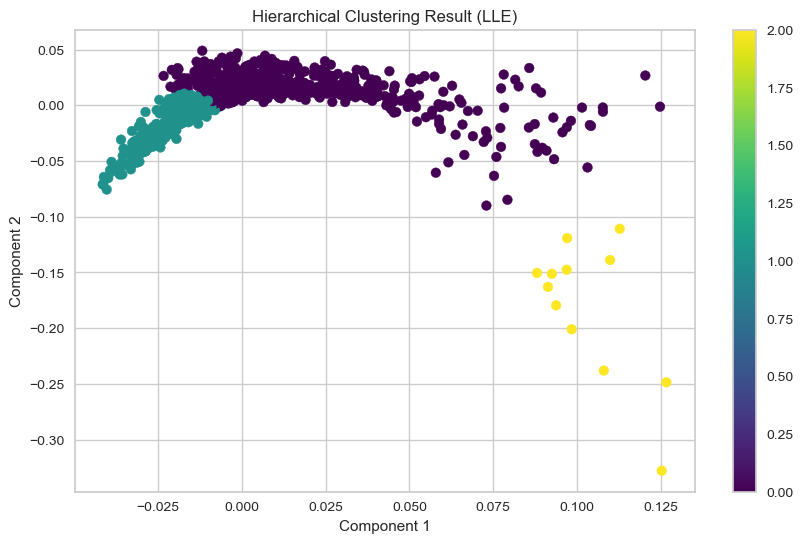

DBSCAN - Insufficient clusters for LLE


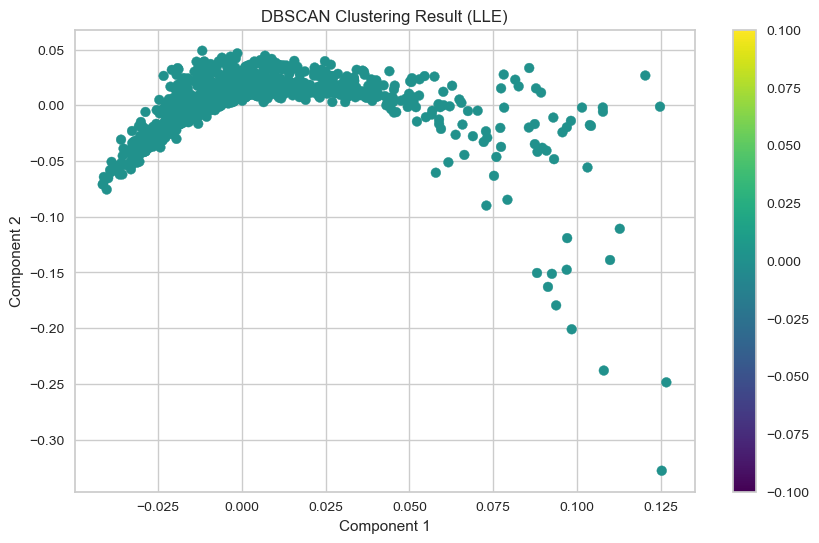

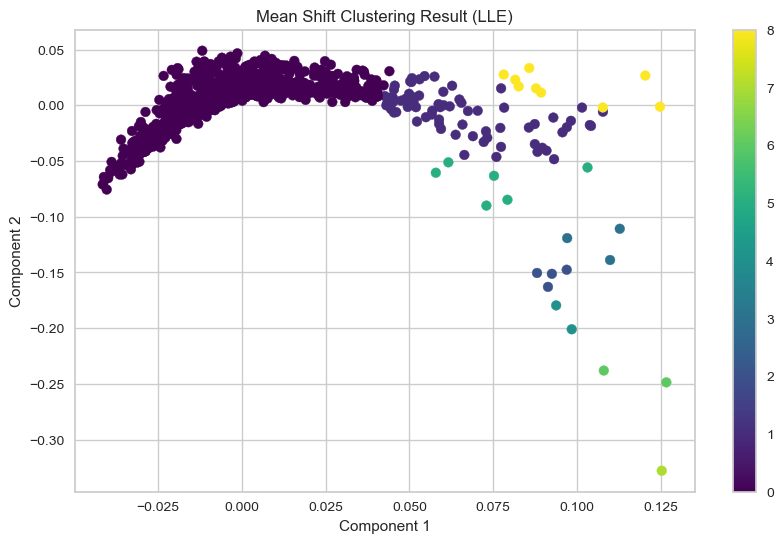

Affinity Propagation - Silhouette Score for LLE: 0.21330271646011786
Affinity Propagation - Davies-Bouldin Index for LLE: 0.602659581299365
Affinity Propagation - Calinski-Harabasz Index for LLE: 492.07505861460015


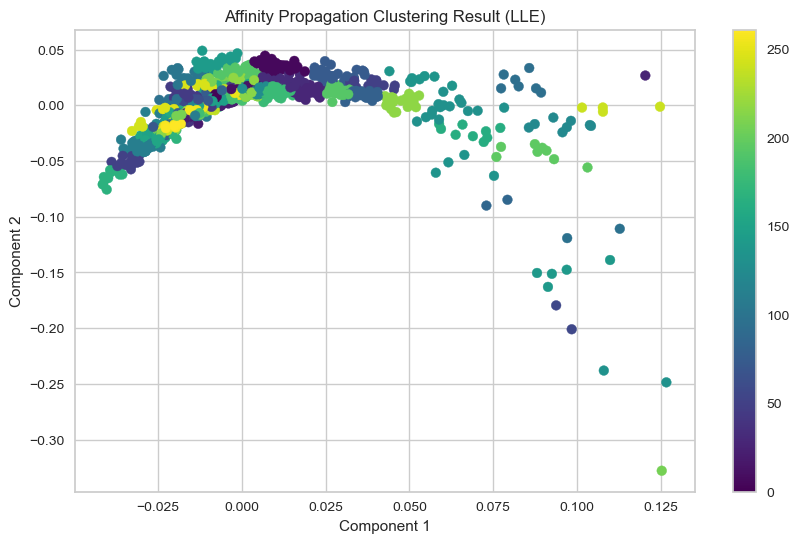

ValueError: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)

In [ ]:
evaluate_clustering(lle_result, 'LLE')

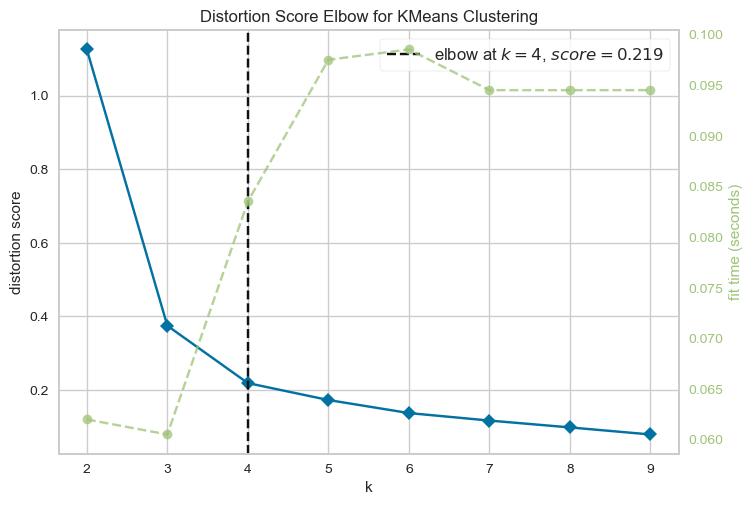

KMeans - Silhouette Score for LLE_S: 0.5505281322069984
KMeans - Davies-Bouldin Index for LLE_S: 0.5044285089356932
KMeans - Calinski-Harabasz Index for LLE_S: 3871.263745186021


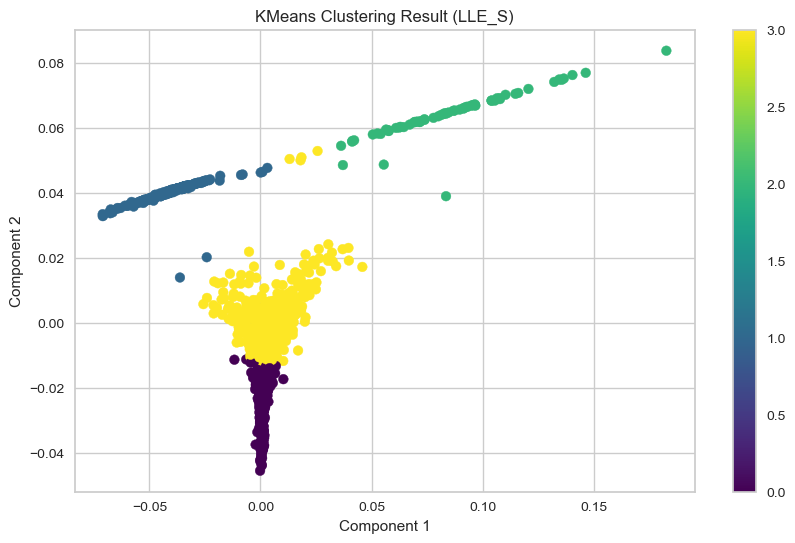

GMM - Silhouette Score for LLE_S: 0.7367940247928915
GMM - Davies-Bouldin Index for LLE_S: 0.3784510702026067
GMM - Calinski-Harabasz Index for LLE_S: 2847.2022629186604


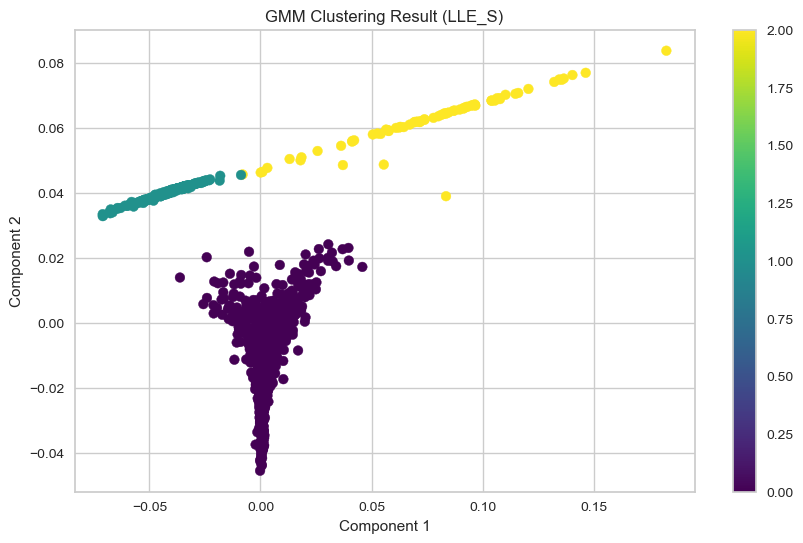

Hierarchical Clustering - Silhouette Score for LLE_S: 0.7373998783158754
Hierarchical Clustering - Davies-Bouldin Index for LLE_S: 0.3404160298927292
Hierarchical Clustering - Calinski-Harabasz Index for LLE_S: 3064.0839707156133


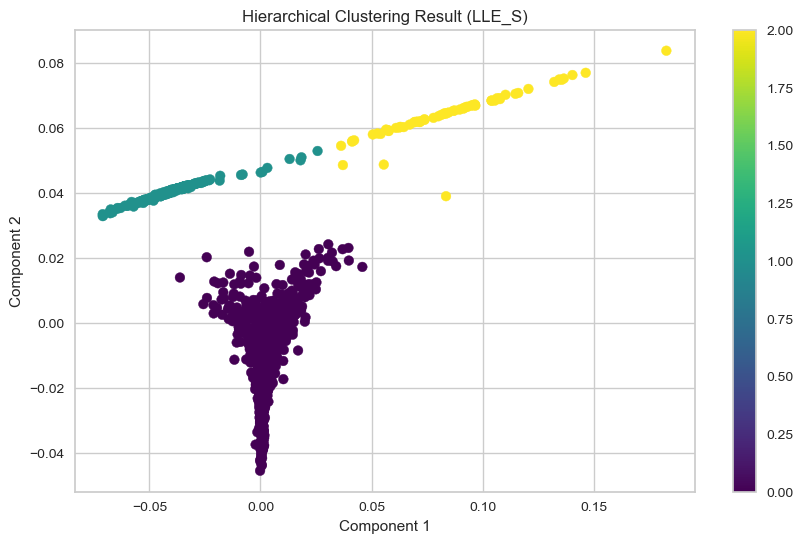

DBSCAN - Insufficient clusters for LLE_S


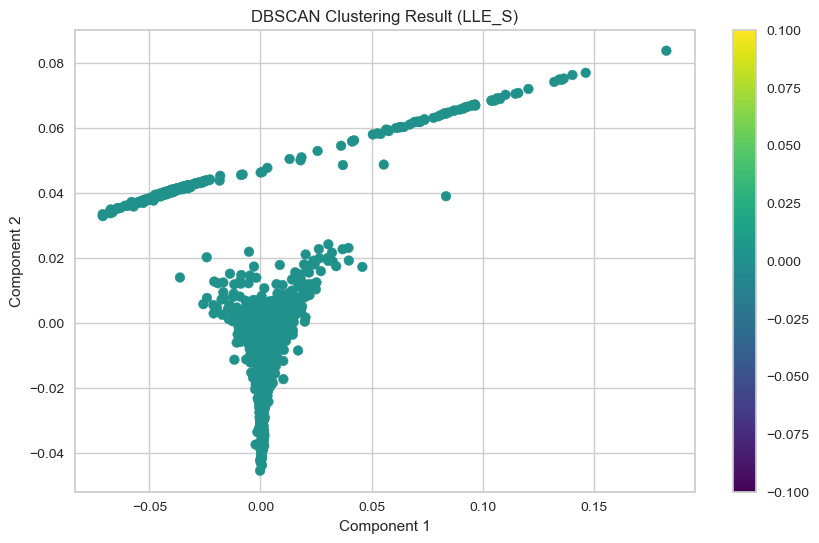

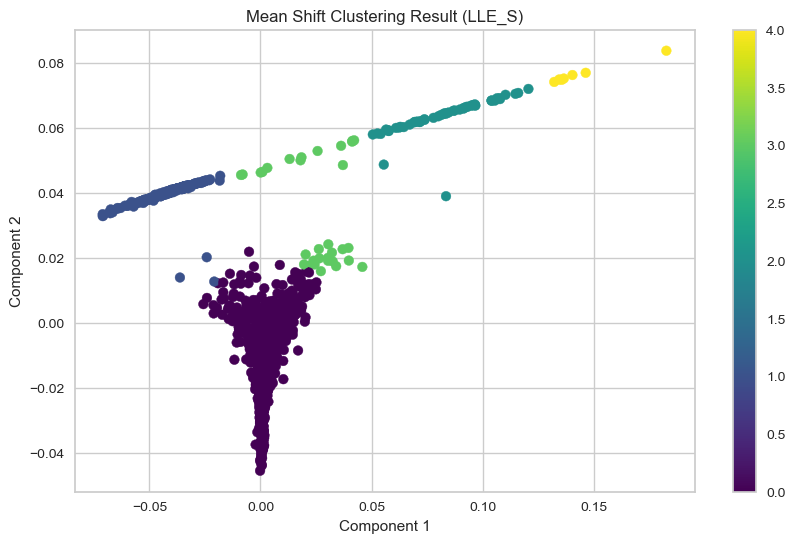

Affinity Propagation - Silhouette Score for LLE_S: 0.2900510814264247
Affinity Propagation - Davies-Bouldin Index for LLE_S: 0.33541598181761906
Affinity Propagation - Calinski-Harabasz Index for LLE_S: 937.1770794760439


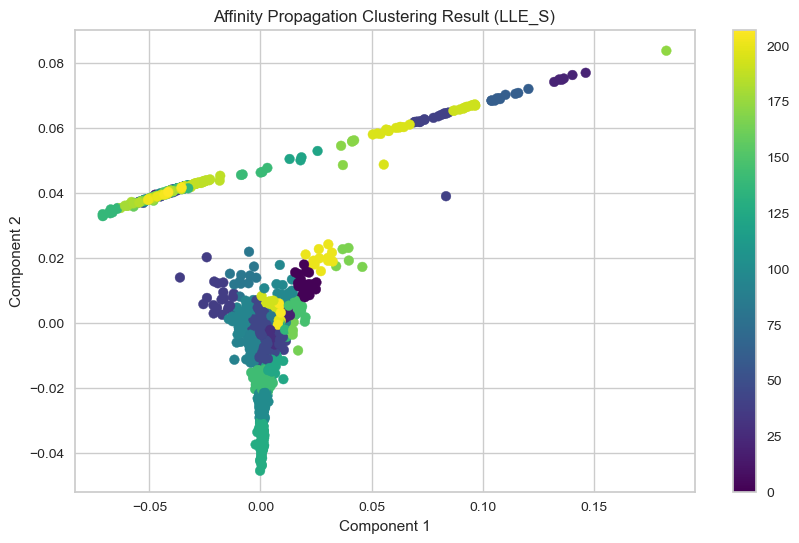

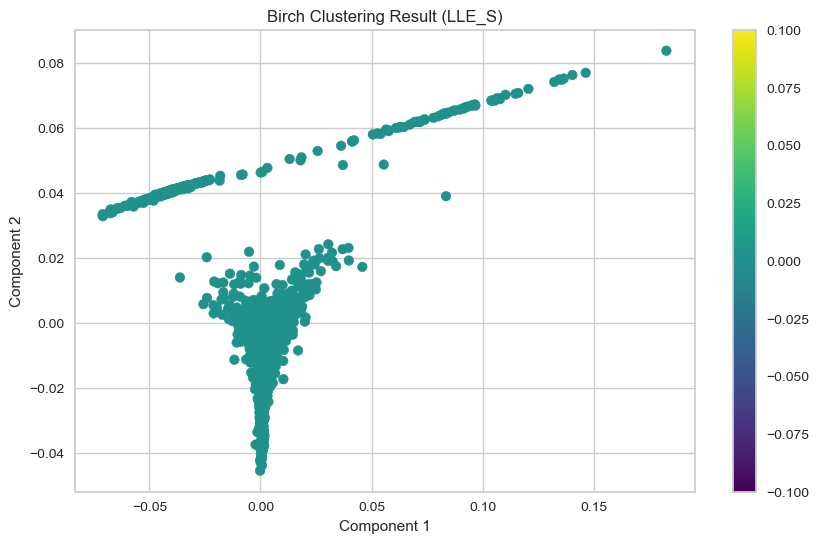

OPTICS - Silhouette Score for LLE_S: -0.17669988628569616
OPTICS - Davies-Bouldin Index for LLE_S: 2.88432313331323
OPTICS - Calinski-Harabasz Index for LLE_S: 32.63736530594003


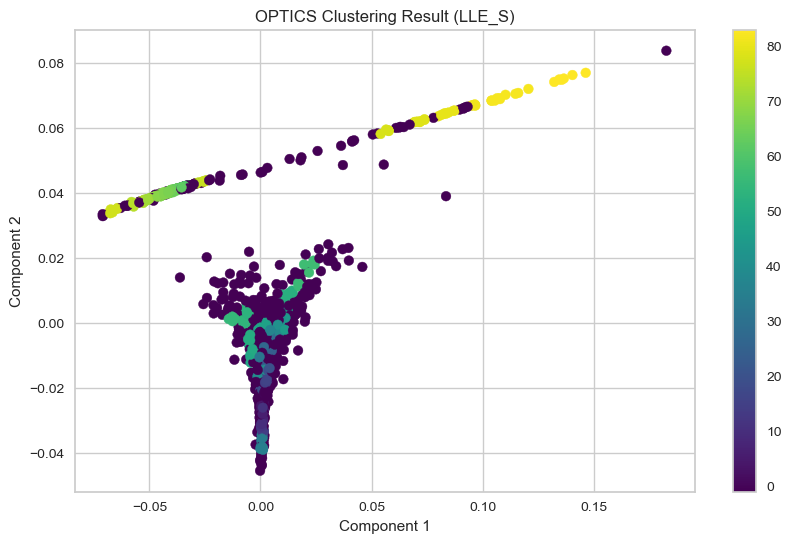

Spectral Clustering - Silhouette Score for LLE_S: 0.5513529154794354
Spectral Clustering - Davies-Bouldin Index for LLE_S: 0.4868747447687649
Spectral Clustering - Calinski-Harabasz Index for LLE_S: 3785.721259240398


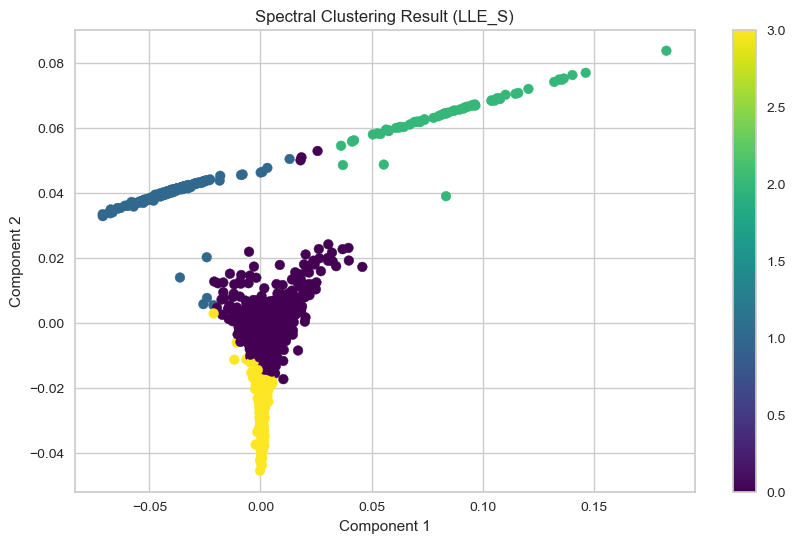

In [ ]:
evaluate_clustering(lle_result_S, 'LLE_S')

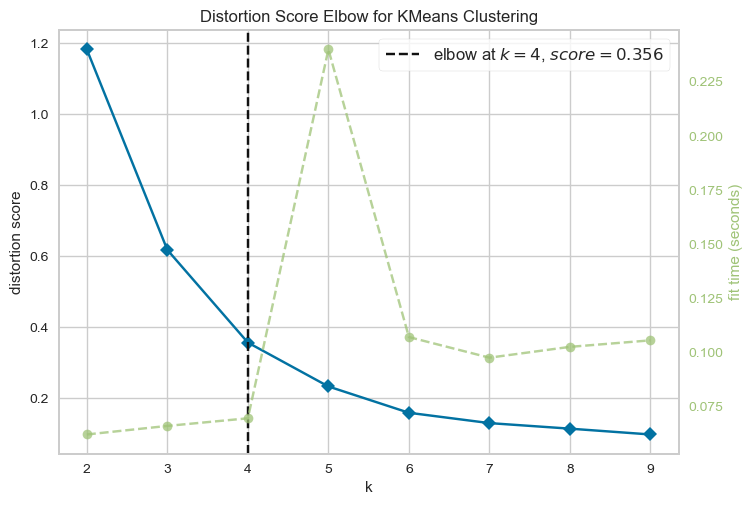

KMeans - Silhouette Score for LLE_MM: 0.5834717807020448
KMeans - Davies-Bouldin Index for LLE_MM: 0.5140339215801055
KMeans - Calinski-Harabasz Index for LLE_MM: 2197.57971807833


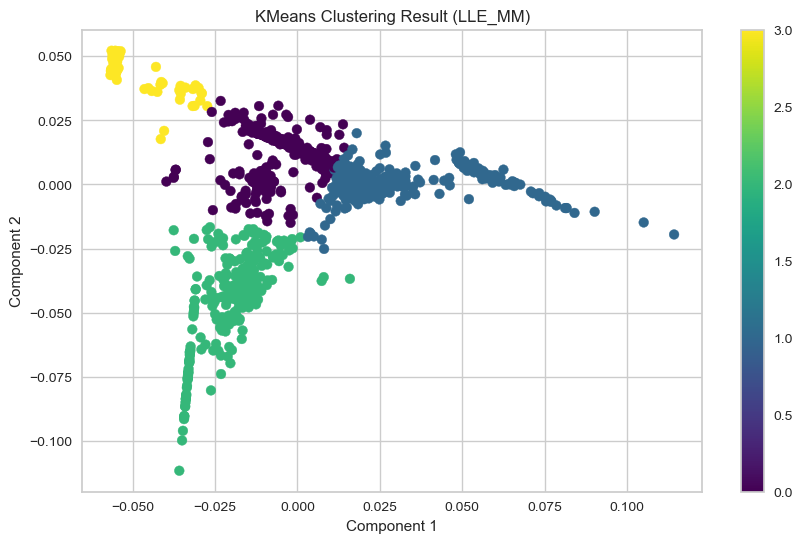

GMM - Silhouette Score for LLE_MM: 0.2908483565409514
GMM - Davies-Bouldin Index for LLE_MM: 1.097379362491777
GMM - Calinski-Harabasz Index for LLE_MM: 698.042273027209


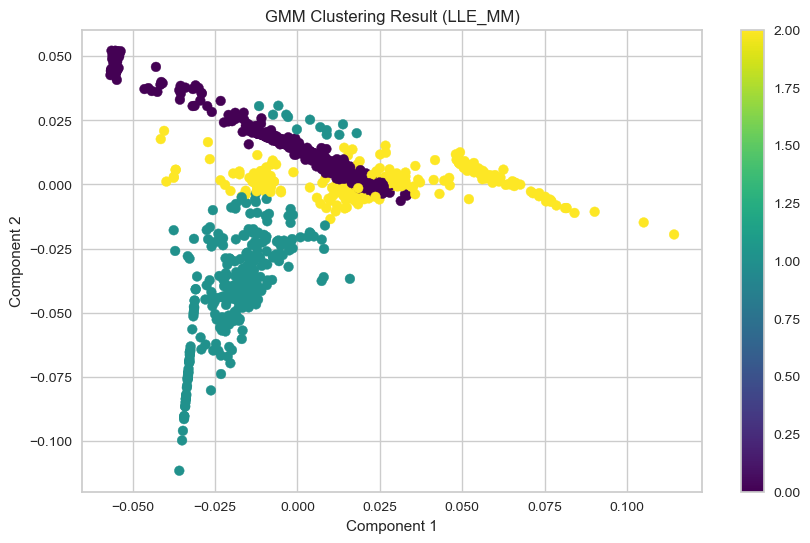

Hierarchical Clustering - Silhouette Score for LLE_MM: 0.4733791223148306
Hierarchical Clustering - Davies-Bouldin Index for LLE_MM: 0.7431513118844769
Hierarchical Clustering - Calinski-Harabasz Index for LLE_MM: 1358.0981224903178


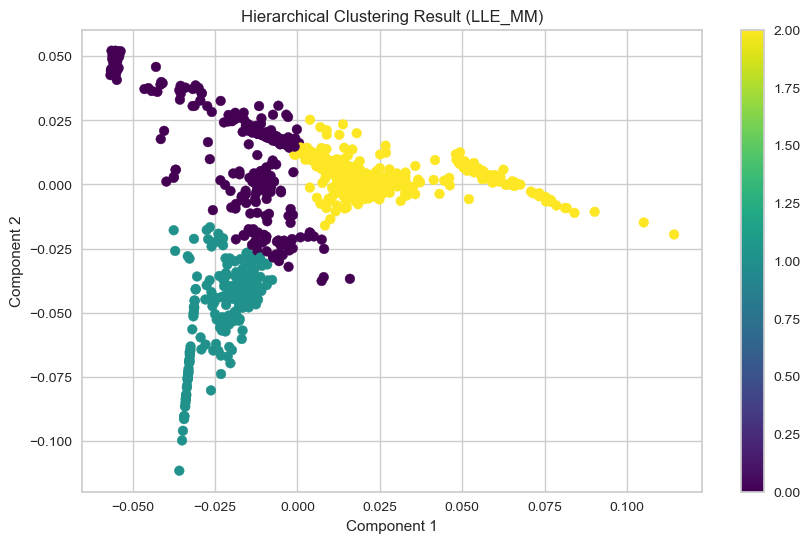

DBSCAN - Insufficient clusters for LLE_MM


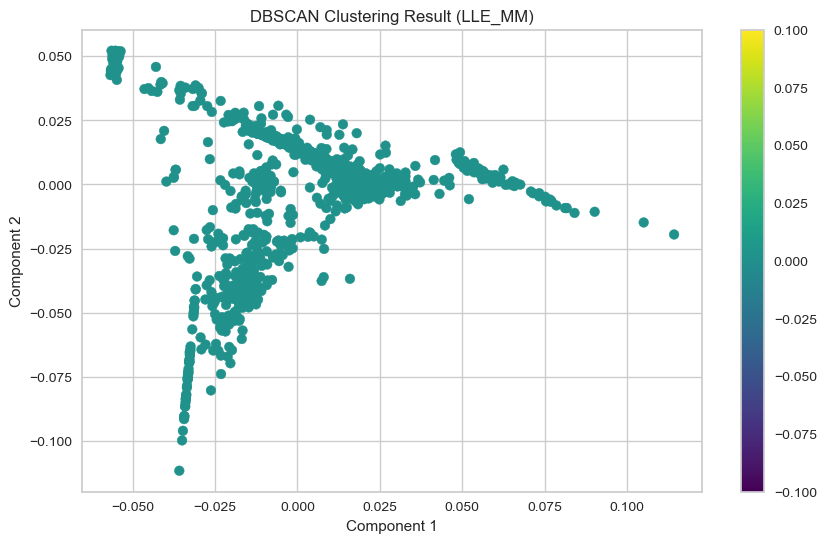

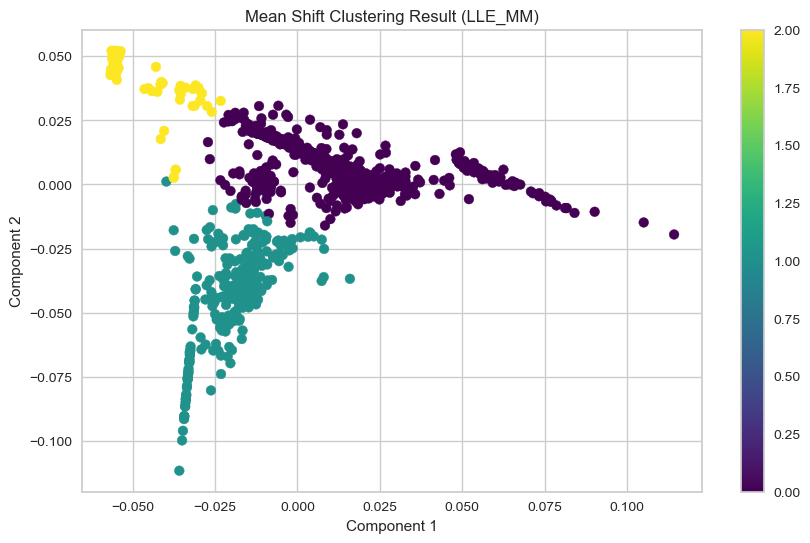

Affinity Propagation - Silhouette Score for LLE_MM: 0.23749761593592075
Affinity Propagation - Davies-Bouldin Index for LLE_MM: 0.4489217479778468
Affinity Propagation - Calinski-Harabasz Index for LLE_MM: 192.00207032167296


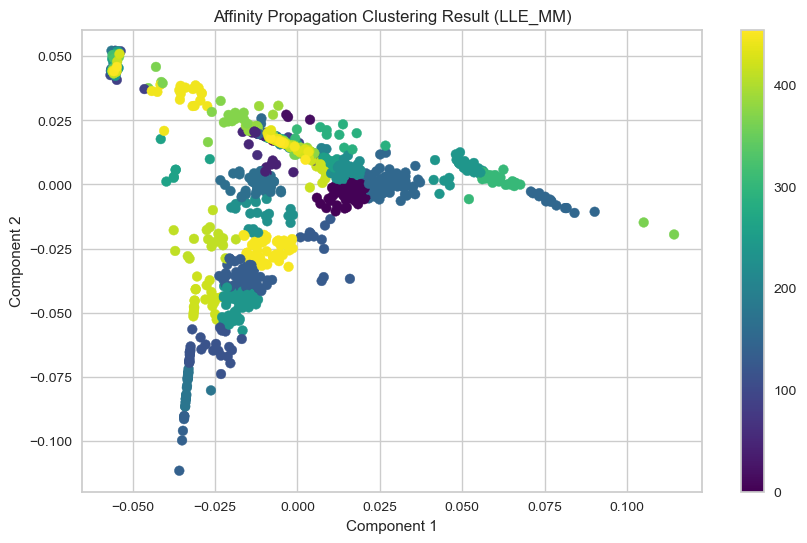

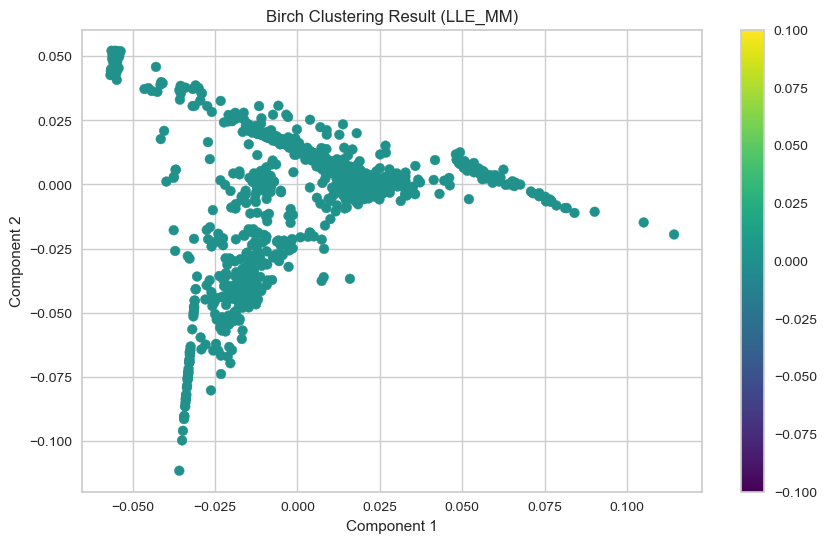

OPTICS - Silhouette Score for LLE_MM: -0.16081417926246952
OPTICS - Davies-Bouldin Index for LLE_MM: 1.324639203159993
OPTICS - Calinski-Harabasz Index for LLE_MM: 21.93555338550184


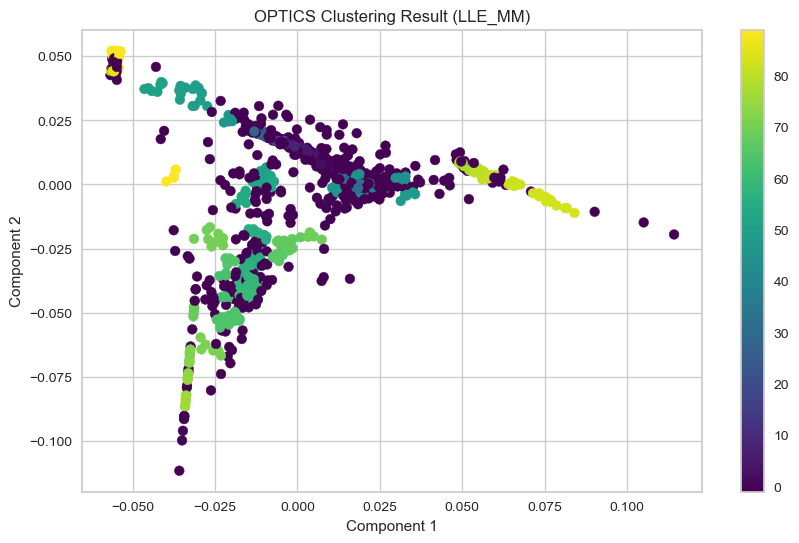

Spectral Clustering - Silhouette Score for LLE_MM: 0.4999157437282618
Spectral Clustering - Davies-Bouldin Index for LLE_MM: 0.6226105847132635
Spectral Clustering - Calinski-Harabasz Index for LLE_MM: 1834.8782615198393


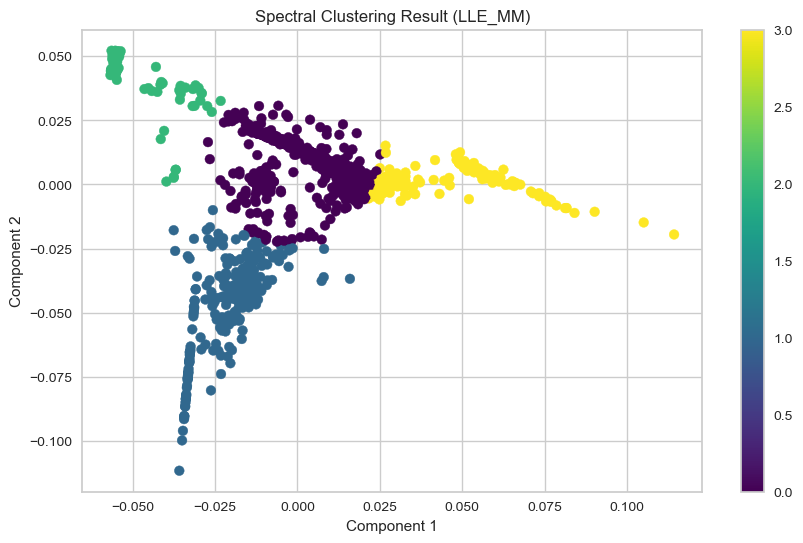

In [ ]:
evaluate_clustering(lle_result_MM, 'LLE_MM')

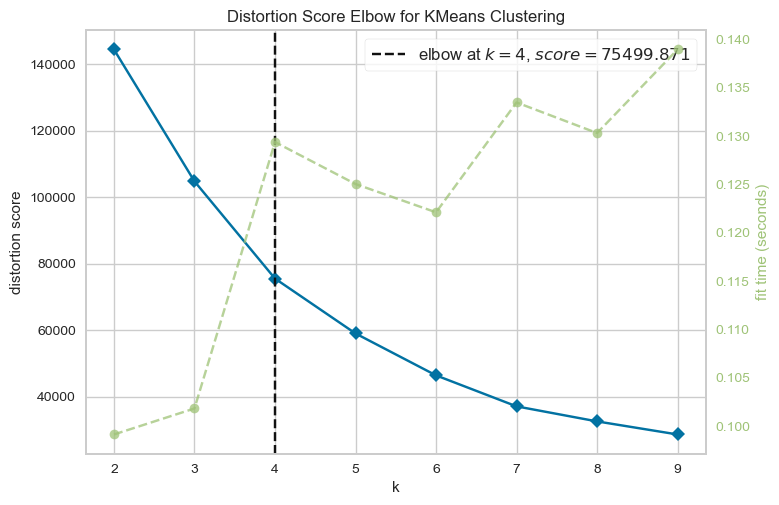

KMeans - Silhouette Score for Isomap: 0.4263441616521091
KMeans - Davies-Bouldin Index for Isomap: 0.7819385894961032
KMeans - Calinski-Harabasz Index for Isomap: 1465.9651857929484


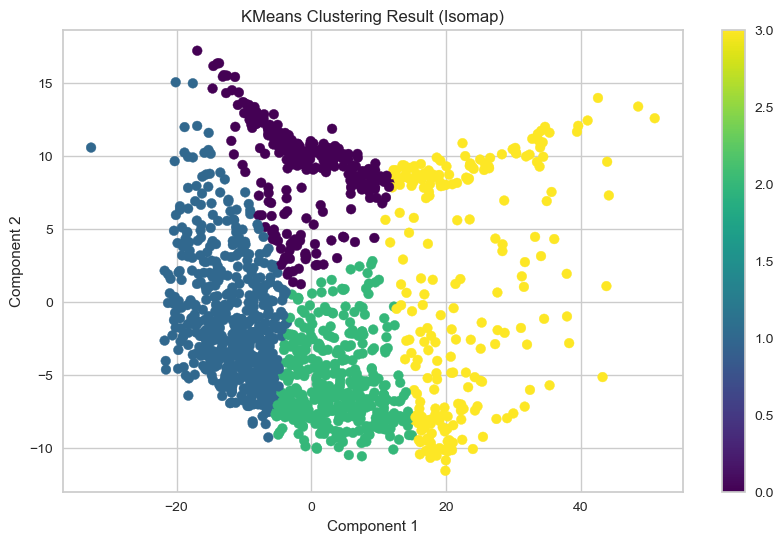

GMM - Silhouette Score for Isomap: 0.2609370587934862
GMM - Davies-Bouldin Index for Isomap: 1.256942025829784
GMM - Calinski-Harabasz Index for Isomap: 645.4963469913964


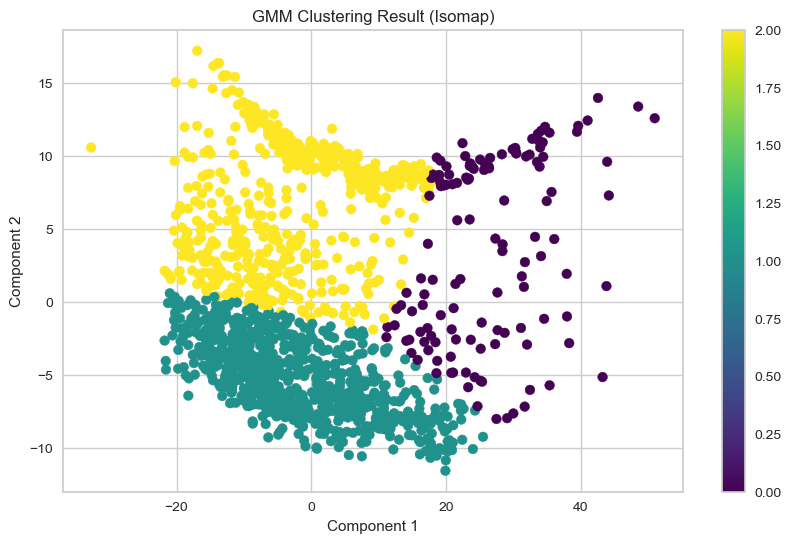

Hierarchical Clustering - Silhouette Score for Isomap: 0.3819286850494503
Hierarchical Clustering - Davies-Bouldin Index for Isomap: 0.8872409585680315
Hierarchical Clustering - Calinski-Harabasz Index for Isomap: 1221.0340880900008


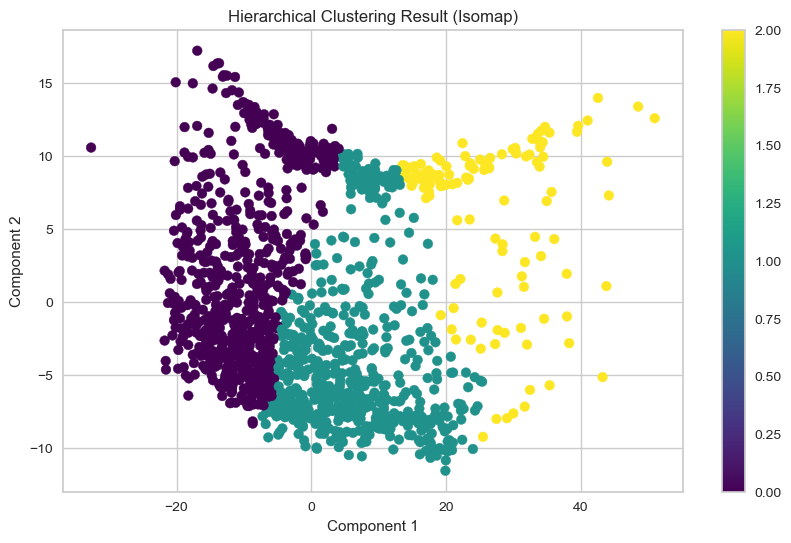

DBSCAN - Silhouette Score for Isomap: -0.412738711159899
DBSCAN - Davies-Bouldin Index for Isomap: 1.3361431854754897
DBSCAN - Calinski-Harabasz Index for Isomap: 7.658055592761535


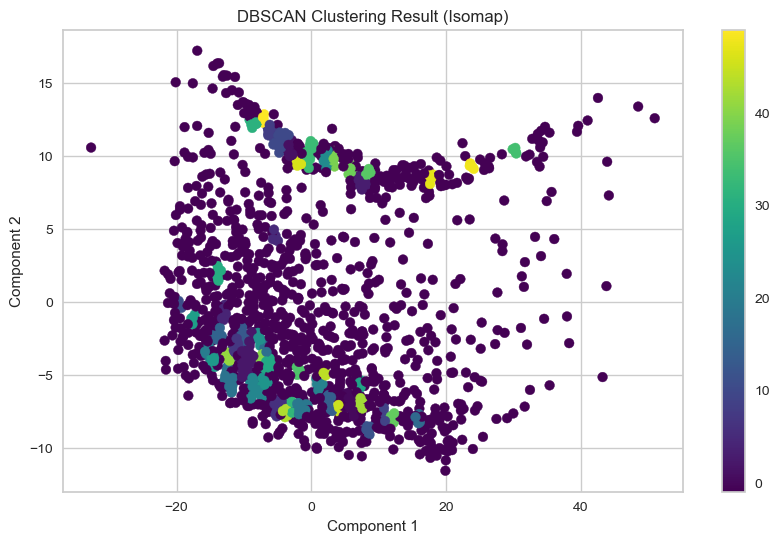

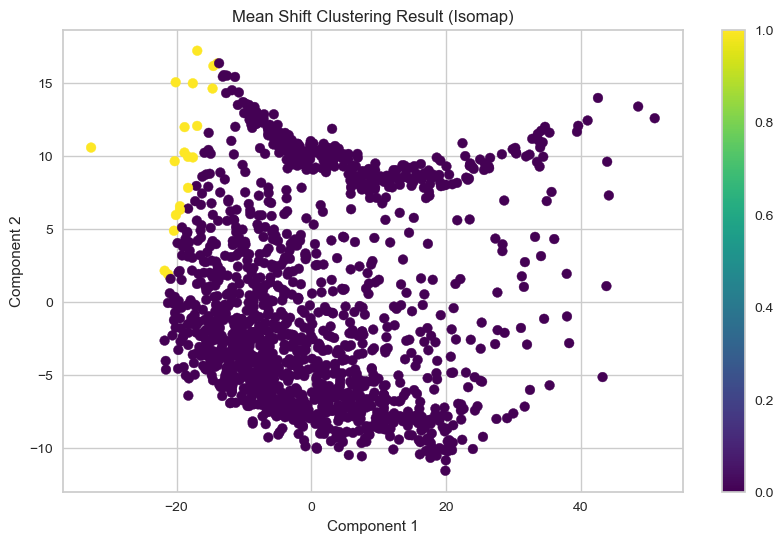

Affinity Propagation - Silhouette Score for Isomap: 0.28265432986347955
Affinity Propagation - Davies-Bouldin Index for Isomap: 0.7102417390048706
Affinity Propagation - Calinski-Harabasz Index for Isomap: 518.561308299728


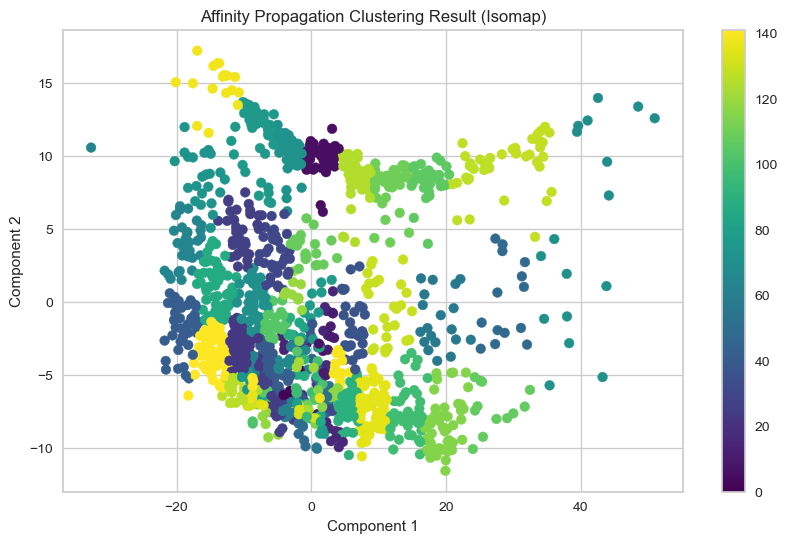

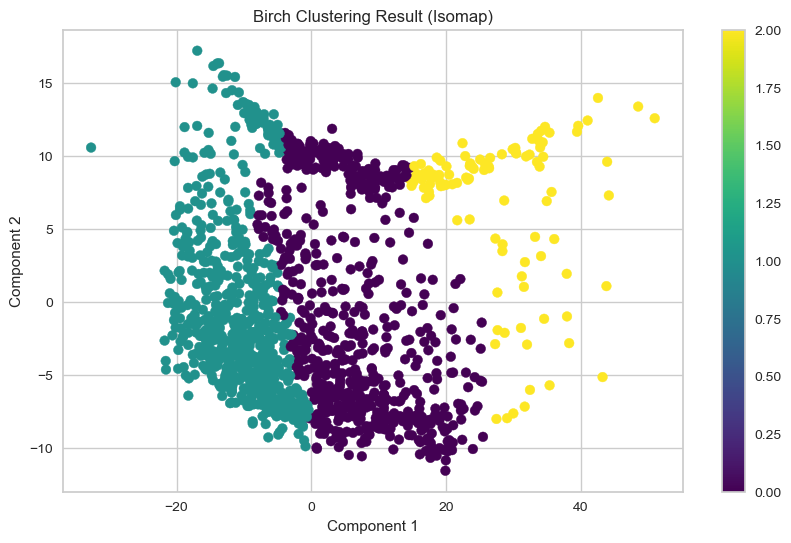

OPTICS - Silhouette Score for Isomap: -0.20878034953608984
OPTICS - Davies-Bouldin Index for Isomap: 1.4355805215225192
OPTICS - Calinski-Harabasz Index for Isomap: 12.654302660004477


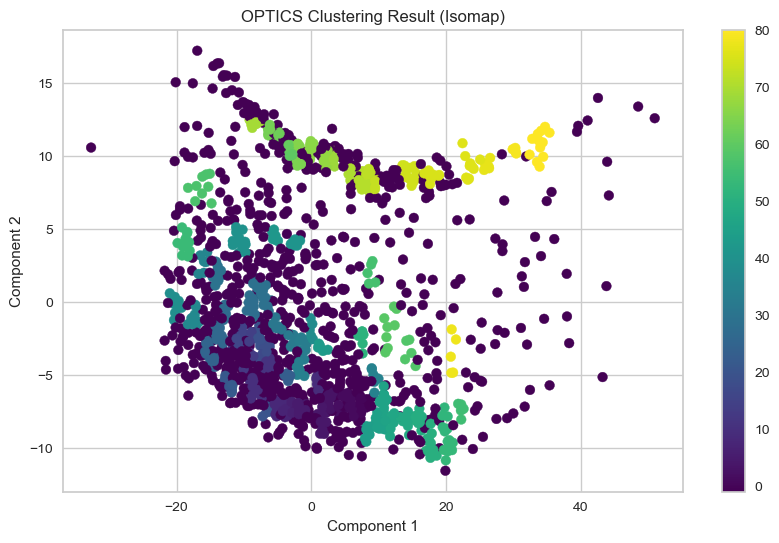

Spectral Clustering - Silhouette Score for Isomap: 0.36451802972323155
Spectral Clustering - Davies-Bouldin Index for Isomap: 0.37115079865618145
Spectral Clustering - Calinski-Harabasz Index for Isomap: 33.202088683226286


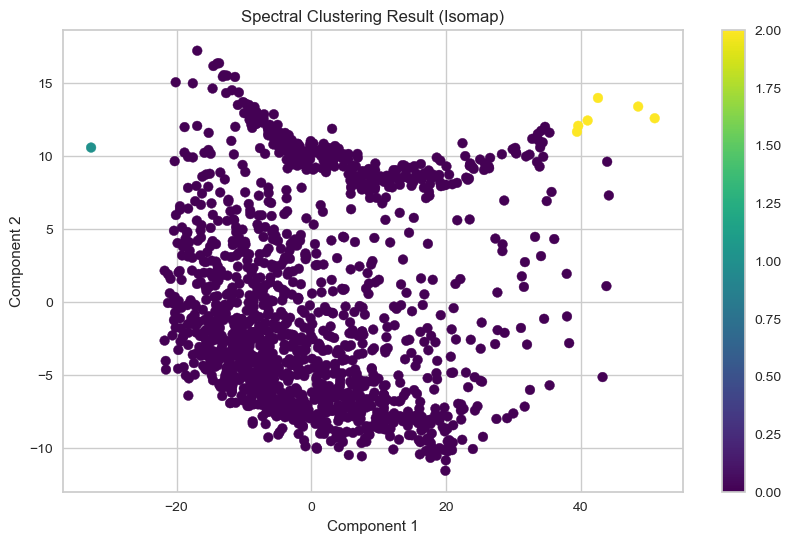

In [ ]:
evaluate_clustering(isomap_result, 'Isomap')

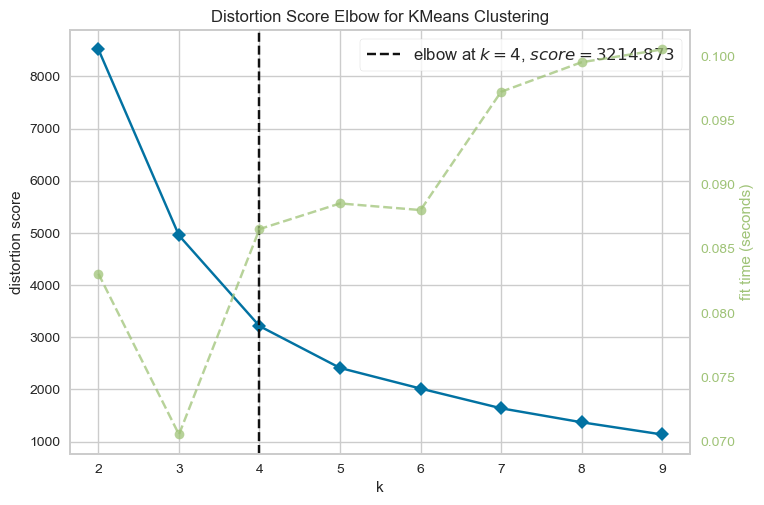

KMeans - Silhouette Score for Isomap_MM: 0.49527984631825084
KMeans - Davies-Bouldin Index for Isomap_MM: 0.7103187905903166
KMeans - Calinski-Harabasz Index for Isomap_MM: 1881.392488676194


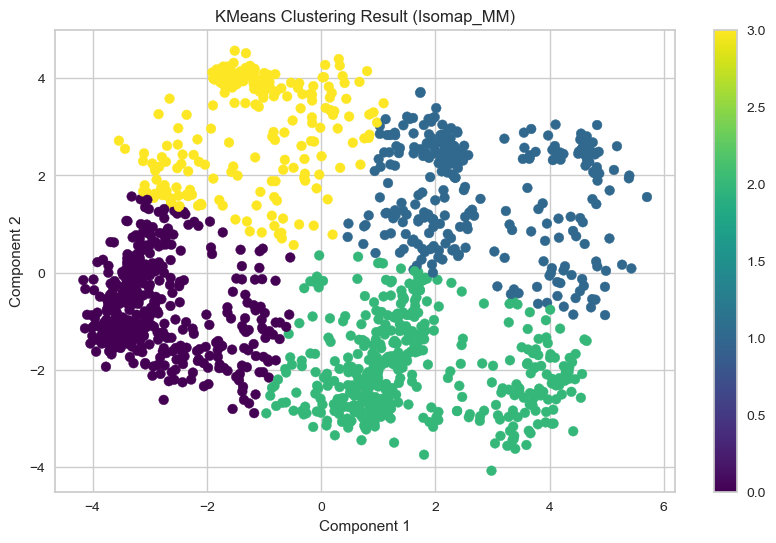

GMM - Silhouette Score for Isomap_MM: 0.4173759605260191
GMM - Davies-Bouldin Index for Isomap_MM: 0.8433761950452904
GMM - Calinski-Harabasz Index for Isomap_MM: 1187.8133221206326


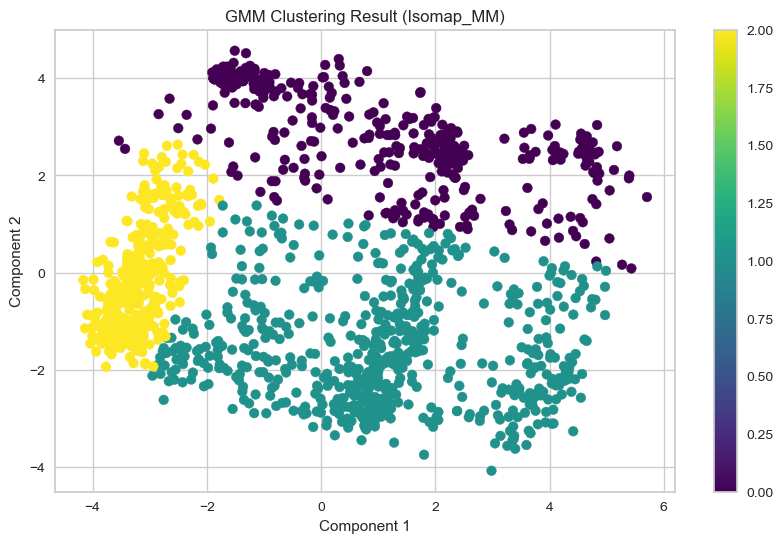

Hierarchical Clustering - Silhouette Score for Isomap_MM: 0.4148409731274964
Hierarchical Clustering - Davies-Bouldin Index for Isomap_MM: 0.8293446497645288
Hierarchical Clustering - Calinski-Harabasz Index for Isomap_MM: 1196.6353228238288


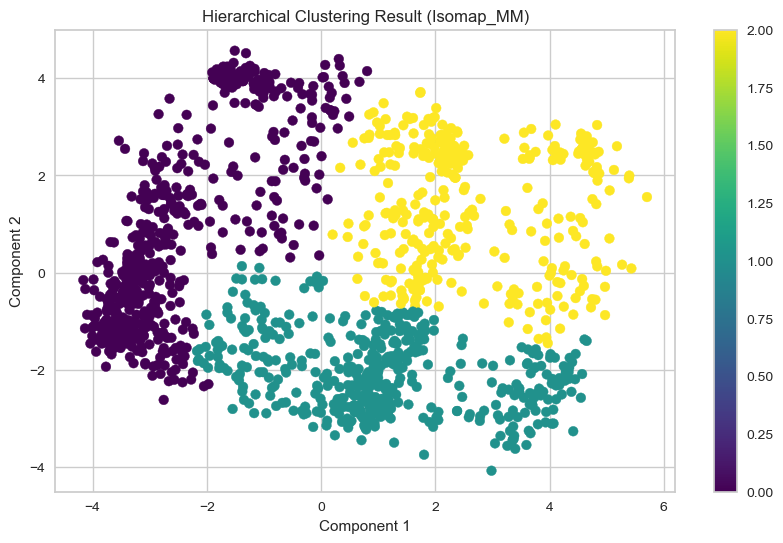

DBSCAN - Silhouette Score for Isomap_MM: -0.2891719901193461
DBSCAN - Davies-Bouldin Index for Isomap_MM: 10.289198320026975
DBSCAN - Calinski-Harabasz Index for Isomap_MM: 1.2728228287653955


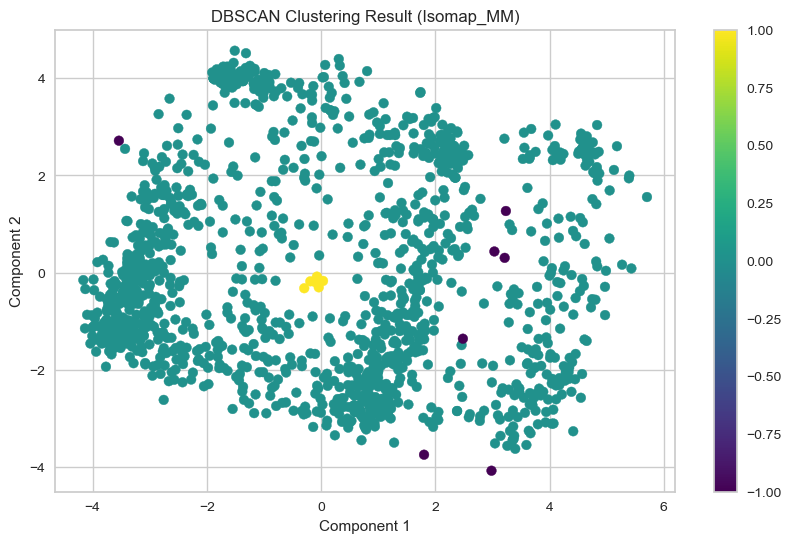

Mean Shift - Silhouette Score for Isomap_MM: 0.4823255592736119
Mean Shift - Davies-Bouldin Index for Isomap_MM: 0.7859191392657454
Mean Shift - Calinski-Harabasz Index for Isomap_MM: 1553.390191124159


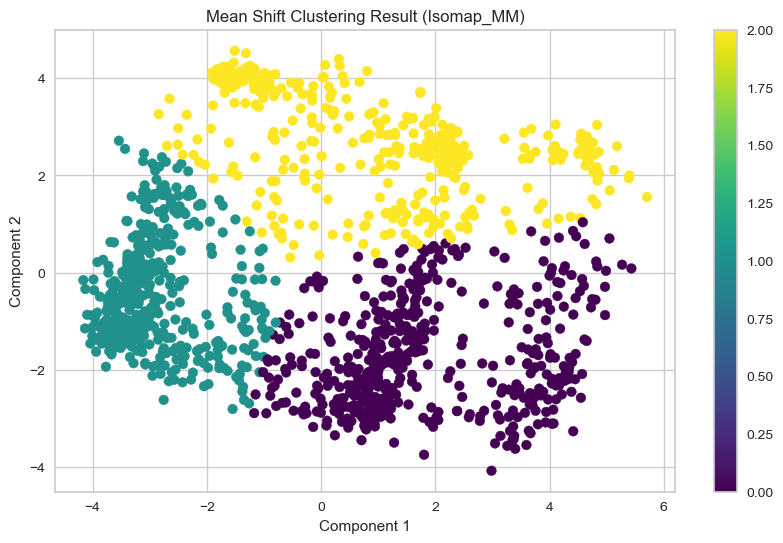

Affinity Propagation - Silhouette Score for Isomap_MM: 0.2895552698411337
Affinity Propagation - Davies-Bouldin Index for Isomap_MM: 0.5873358471453185
Affinity Propagation - Calinski-Harabasz Index for Isomap_MM: 331.1382406452606


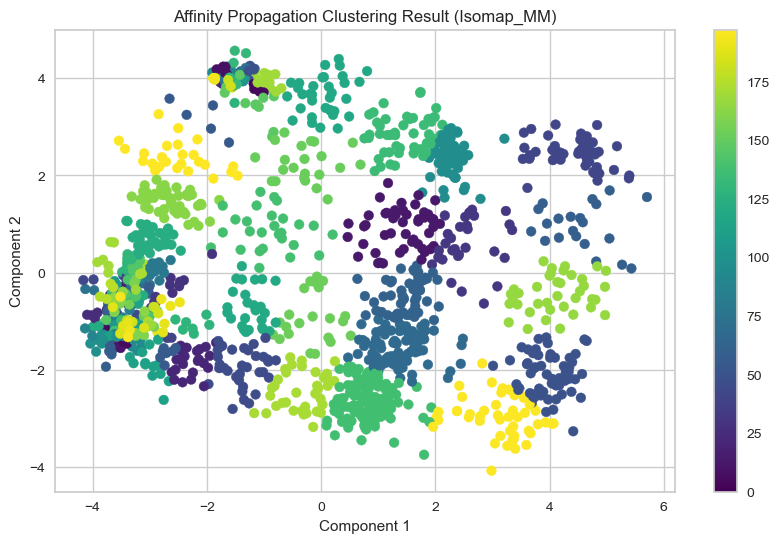

Birch - Silhouette Score for Isomap_MM: 0.43351516605040225
Birch - Davies-Bouldin Index for Isomap_MM: 0.8248677034406492
Birch - Calinski-Harabasz Index for Isomap_MM: 1300.6049481639238


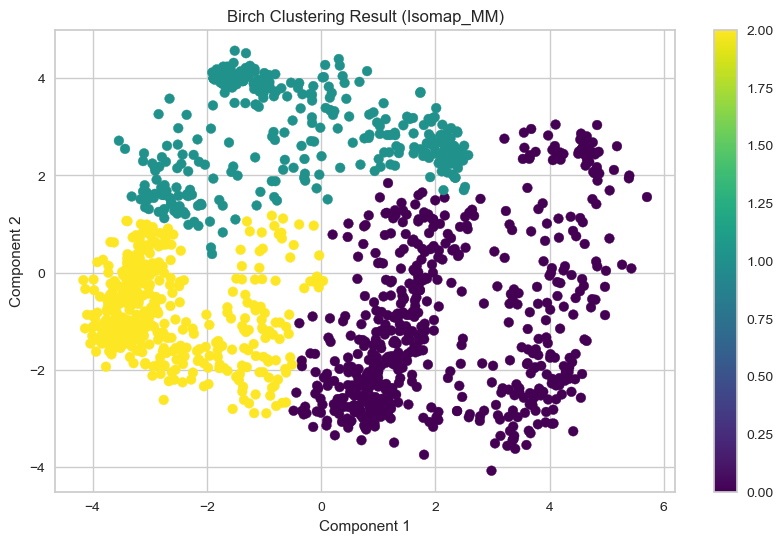

OPTICS - Silhouette Score for Isomap_MM: -0.2434353941191244
OPTICS - Davies-Bouldin Index for Isomap_MM: 1.562386580748415
OPTICS - Calinski-Harabasz Index for Isomap_MM: 13.454817305082212


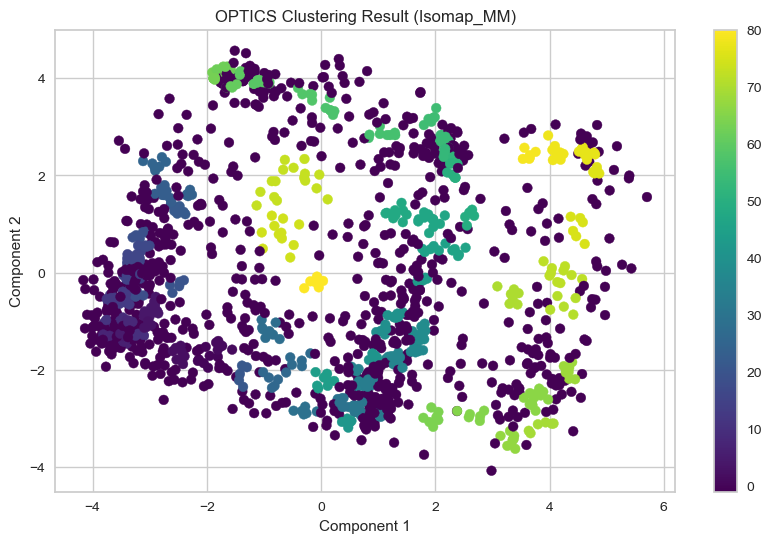

Spectral Clustering - Silhouette Score for Isomap_MM: 0.48442468920545023
Spectral Clustering - Davies-Bouldin Index for Isomap_MM: 0.6694242676026894
Spectral Clustering - Calinski-Harabasz Index for Isomap_MM: 1682.0275319147509


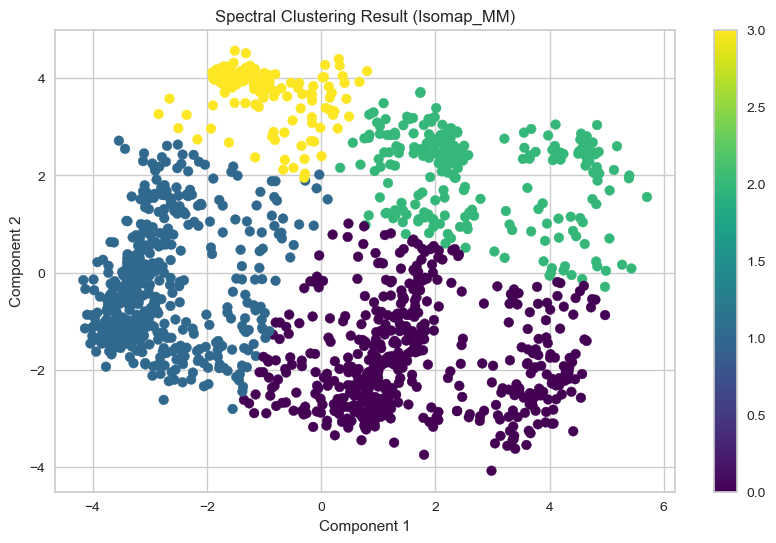

In [ ]:
evaluate_clustering(isomap_result_MM, 'Isomap_MM')

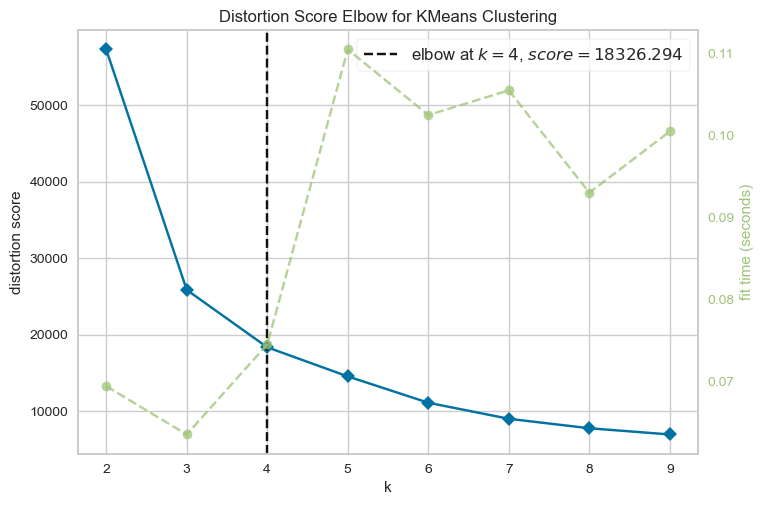

KMeans - Silhouette Score for Isomap_S: 0.5434943704354908
KMeans - Davies-Bouldin Index for Isomap_S: 0.6343427933604895
KMeans - Calinski-Harabasz Index for Isomap_S: 2251.3317561191543


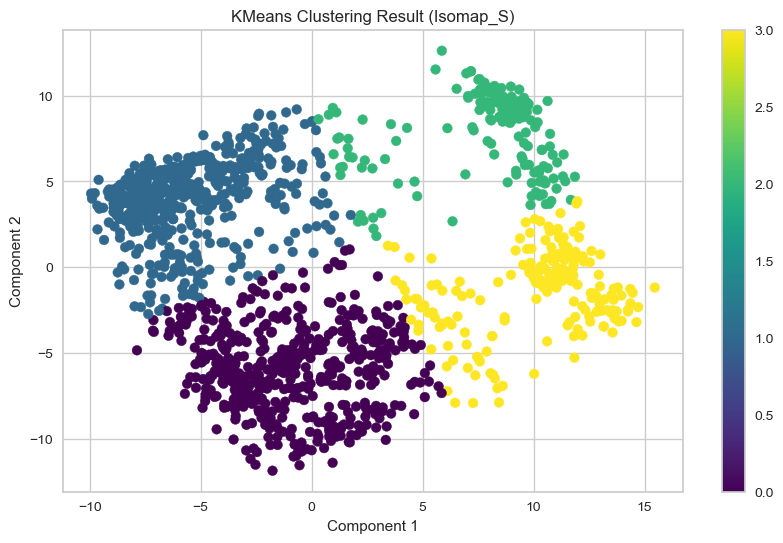

GMM - Silhouette Score for Isomap_S: 0.5072817781010155
GMM - Davies-Bouldin Index for Isomap_S: 0.6774659239922403
GMM - Calinski-Harabasz Index for Isomap_S: 1844.2821940532458


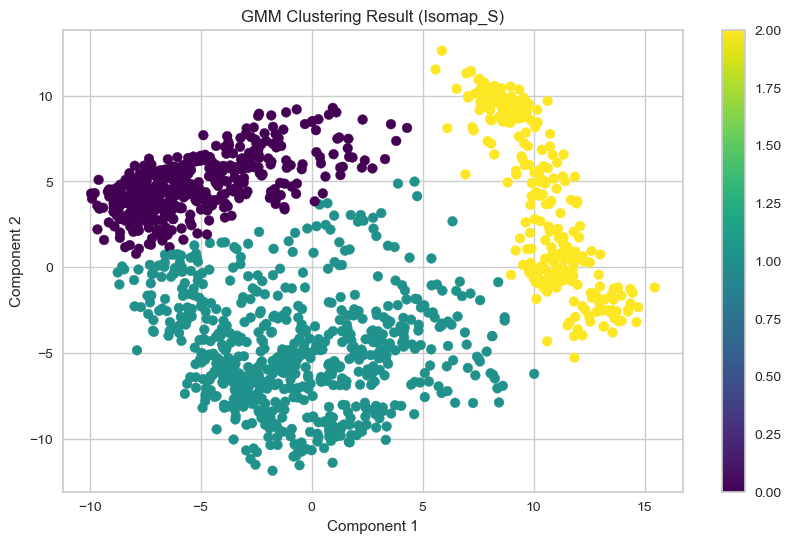

Hierarchical Clustering - Silhouette Score for Isomap_S: 0.5289207605284194
Hierarchical Clustering - Davies-Bouldin Index for Isomap_S: 0.6606781987294884
Hierarchical Clustering - Calinski-Harabasz Index for Isomap_S: 2025.6885420650667


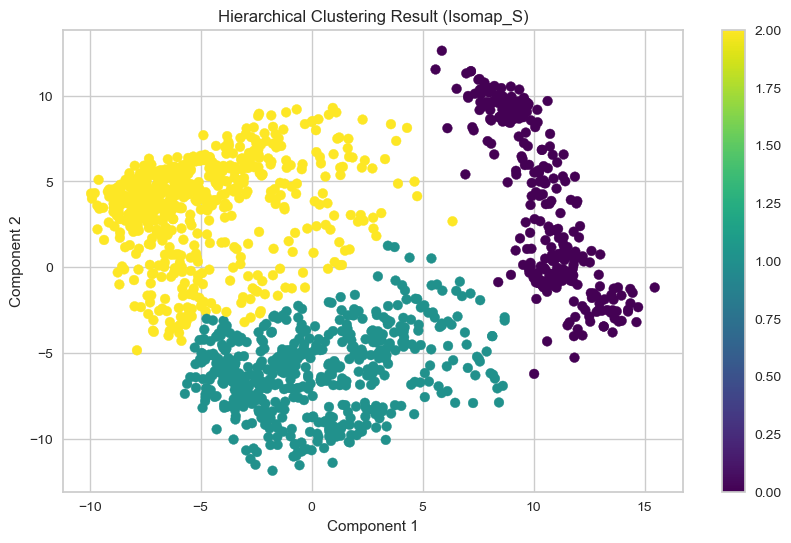

DBSCAN - Silhouette Score for Isomap_S: -0.07548840319121874
DBSCAN - Davies-Bouldin Index for Isomap_S: 1.2722257329828297
DBSCAN - Calinski-Harabasz Index for Isomap_S: 148.288434420965


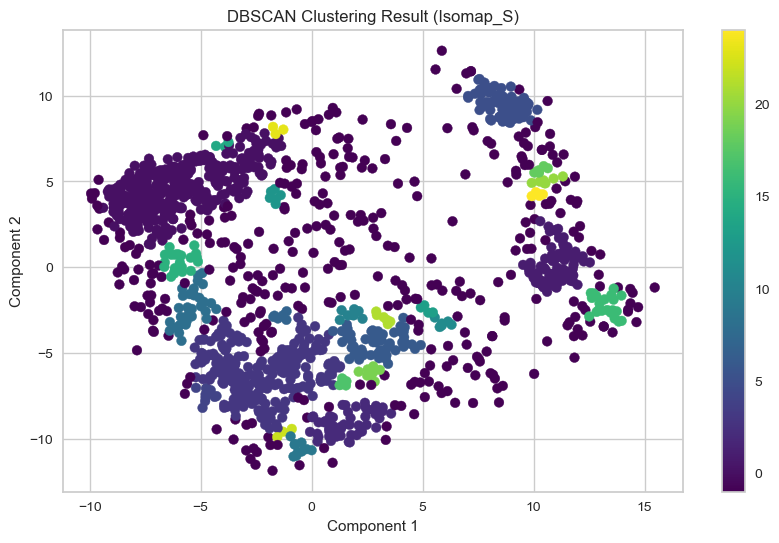

Mean Shift - Silhouette Score for Isomap_S: 0.5279251711122784
Mean Shift - Davies-Bouldin Index for Isomap_S: 0.6423377422876726
Mean Shift - Calinski-Harabasz Index for Isomap_S: 2021.6382645859228


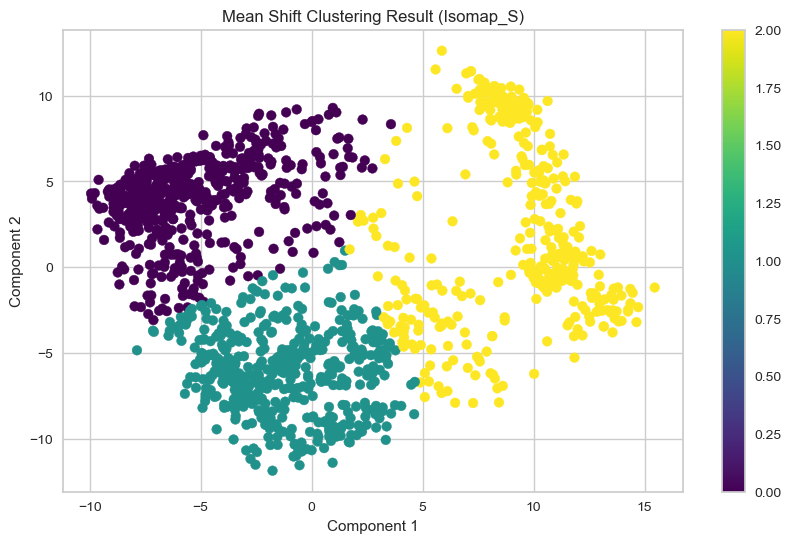

Affinity Propagation - Silhouette Score for Isomap_S: 0.30356665291519475
Affinity Propagation - Davies-Bouldin Index for Isomap_S: 0.7448064029967855
Affinity Propagation - Calinski-Harabasz Index for Isomap_S: 670.3893470074485


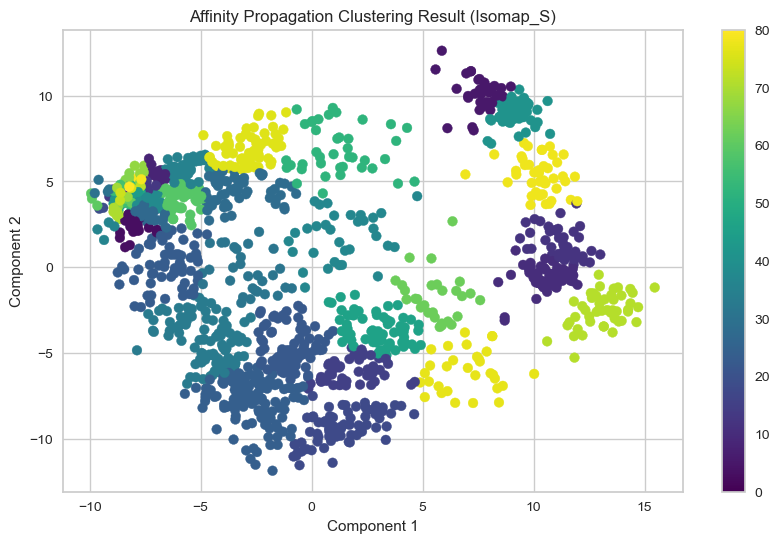

Birch - Silhouette Score for Isomap_S: 0.48557331352204897
Birch - Davies-Bouldin Index for Isomap_S: 0.6906648478348836
Birch - Calinski-Harabasz Index for Isomap_S: 1703.6409026954152


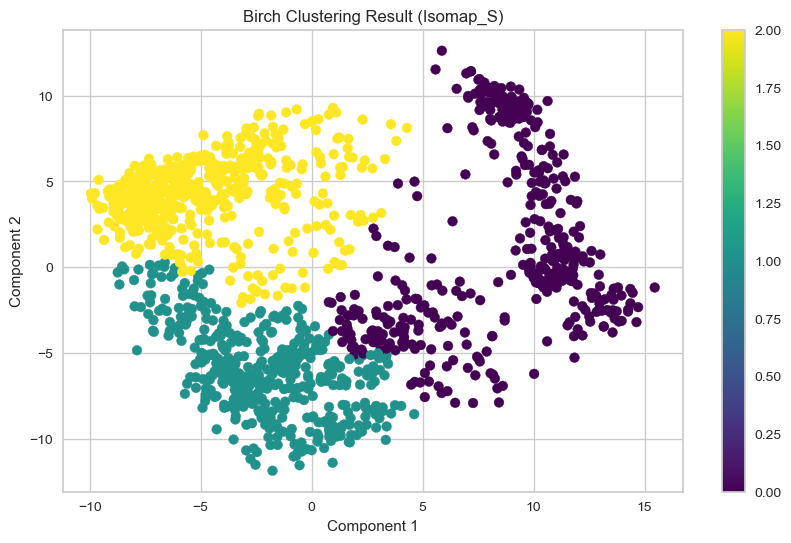

OPTICS - Silhouette Score for Isomap_S: -0.2620297288551094
OPTICS - Davies-Bouldin Index for Isomap_S: 1.25859221021193
OPTICS - Calinski-Harabasz Index for Isomap_S: 12.571861571902977


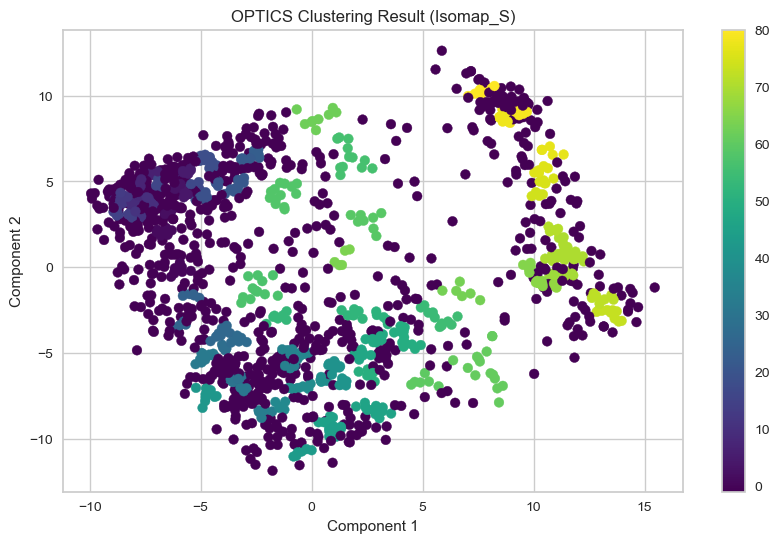

Spectral Clustering - Silhouette Score for Isomap_S: 0.531518960749847
Spectral Clustering - Davies-Bouldin Index for Isomap_S: 0.5582692665618476
Spectral Clustering - Calinski-Harabasz Index for Isomap_S: 1908.8655472982075


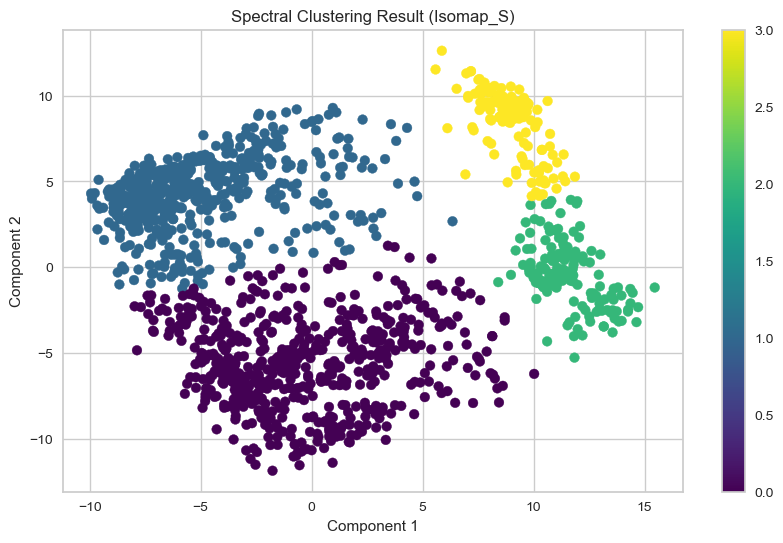

In [ ]:
evaluate_clustering(isomap_result_S, 'Isomap_S')

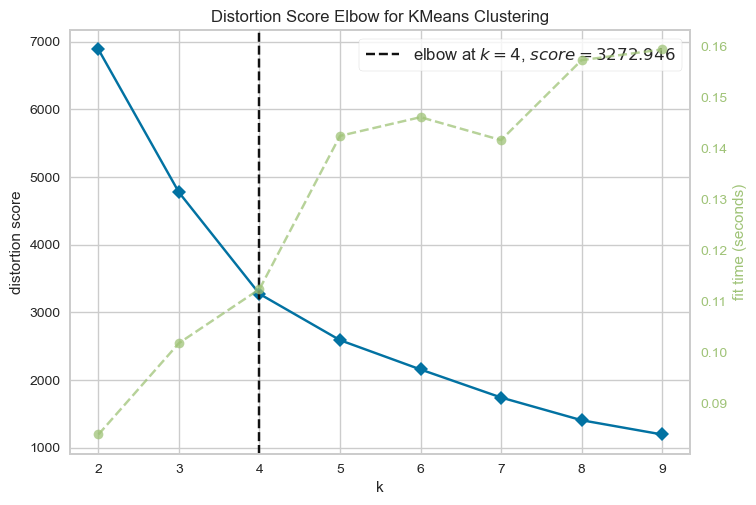

KMeans - Silhouette Score for UMAP: 0.42897018790245056
KMeans - Davies-Bouldin Index for UMAP: 0.7831509911910862
KMeans - Calinski-Harabasz Index for UMAP: 1718.656027089146


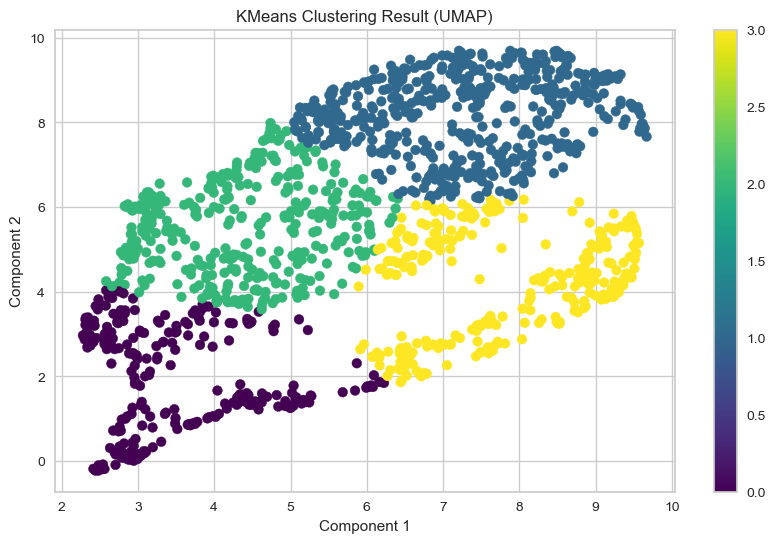

GMM - Silhouette Score for UMAP: 0.42338064312934875
GMM - Davies-Bouldin Index for UMAP: 0.8835319965968457
GMM - Calinski-Harabasz Index for UMAP: 1510.1098286922804


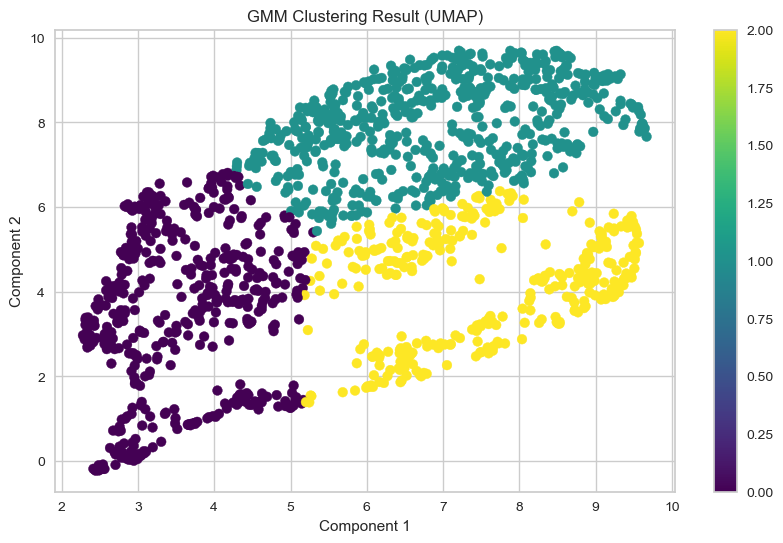

Hierarchical Clustering - Silhouette Score for UMAP: 0.41906124353408813
Hierarchical Clustering - Davies-Bouldin Index for UMAP: 0.7904380637796748
Hierarchical Clustering - Calinski-Harabasz Index for UMAP: 1300.6957020547063


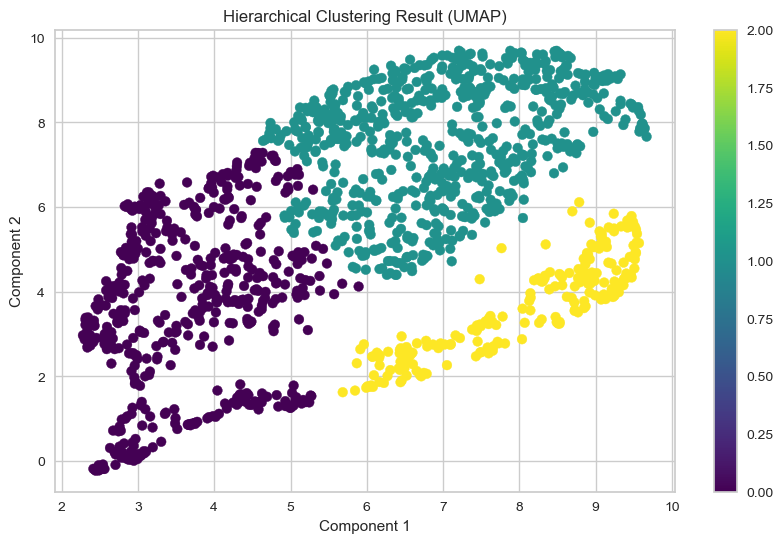

DBSCAN - Silhouette Score for UMAP: -0.09815220534801483
DBSCAN - Davies-Bouldin Index for UMAP: 1.6419172681212137
DBSCAN - Calinski-Harabasz Index for UMAP: 1.502905598198391


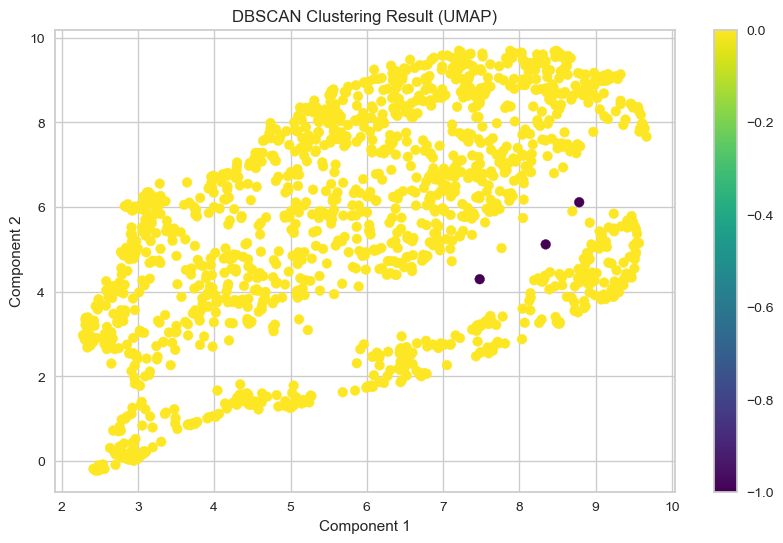

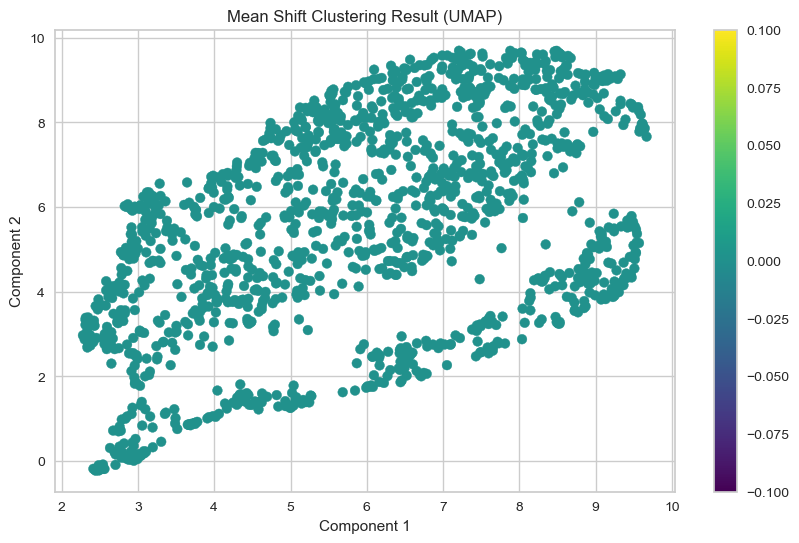

Affinity Propagation - Silhouette Score for UMAP: 0.39407533407211304
Affinity Propagation - Davies-Bouldin Index for UMAP: 0.796546544663919
Affinity Propagation - Calinski-Harabasz Index for UMAP: 2443.1314379085056


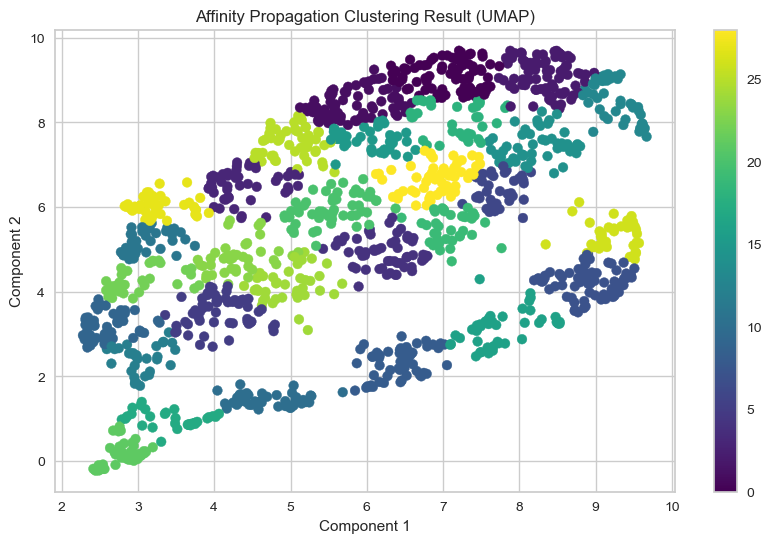

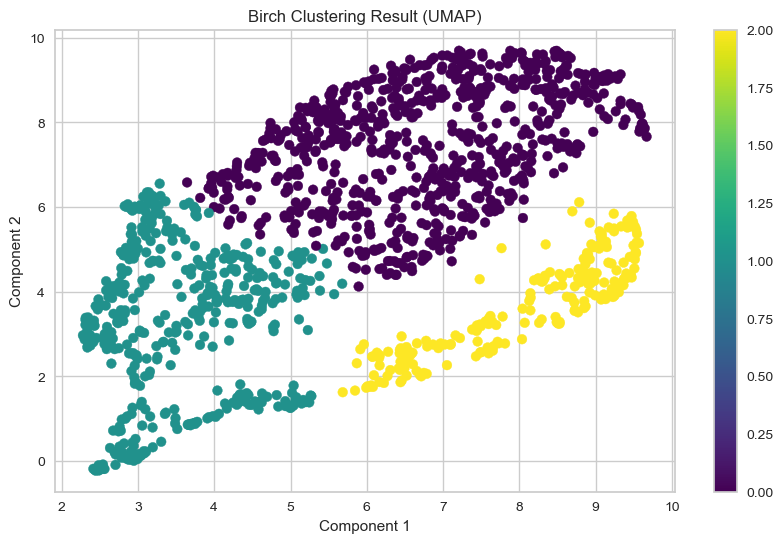

OPTICS - Silhouette Score for UMAP: -0.04364490136504173
OPTICS - Davies-Bouldin Index for UMAP: 2.899551802216002
OPTICS - Calinski-Harabasz Index for UMAP: 19.477014491354534


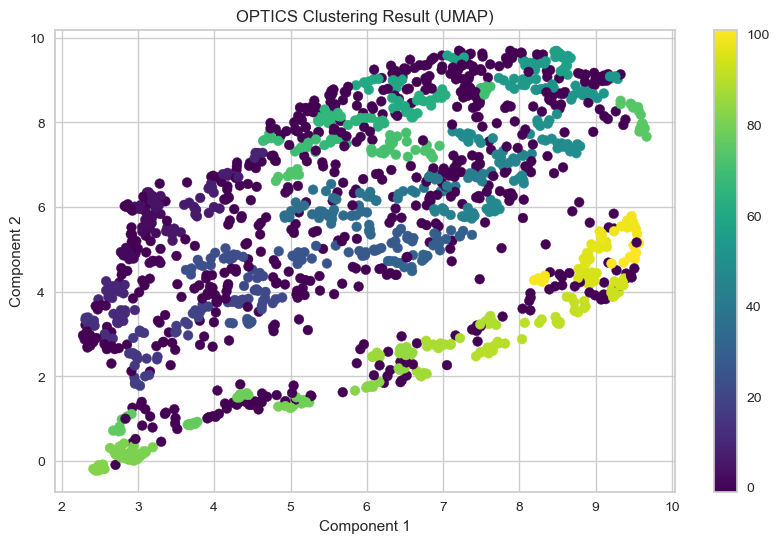

Spectral Clustering - Silhouette Score for UMAP: 0.42841213941574097
Spectral Clustering - Davies-Bouldin Index for UMAP: 0.7155337952625564
Spectral Clustering - Calinski-Harabasz Index for UMAP: 1403.666315705138


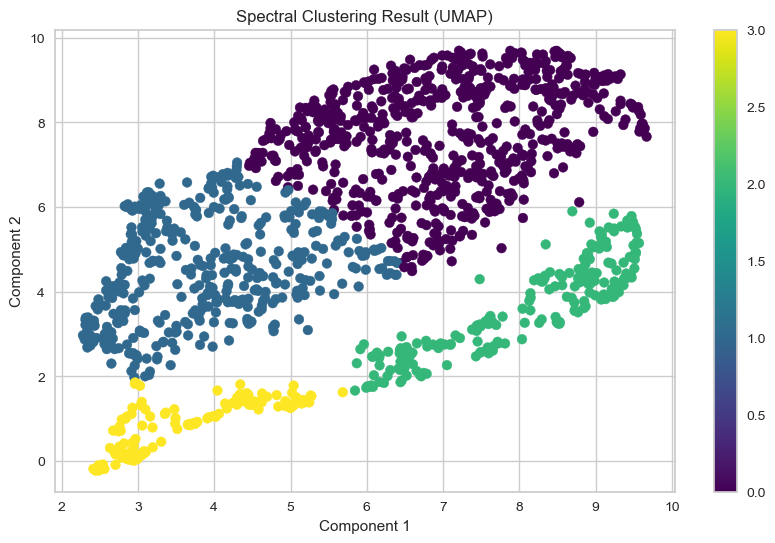

In [ ]:
evaluate_clustering(umap_result, 'UMAP')

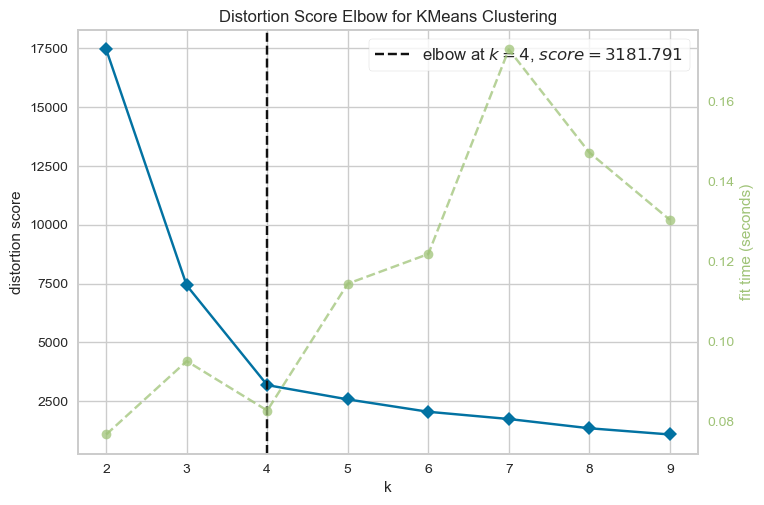

KMeans - Silhouette Score for UMAP_MM: 0.6617298722267151
KMeans - Davies-Bouldin Index for UMAP_MM: 0.46953454741942435
KMeans - Calinski-Harabasz Index for UMAP_MM: 6208.865507448227


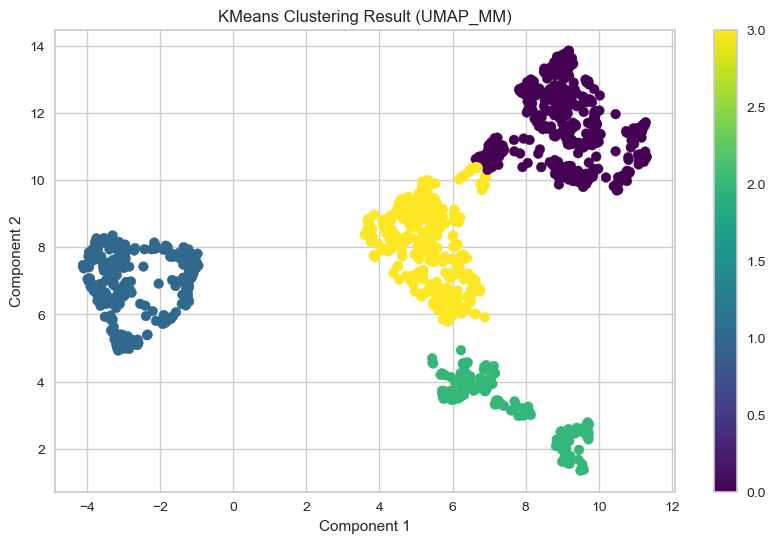

GMM - Silhouette Score for UMAP_MM: 0.6182420253753662
GMM - Davies-Bouldin Index for UMAP_MM: 0.5970903533516584
GMM - Calinski-Harabasz Index for UMAP_MM: 3583.7297566300317


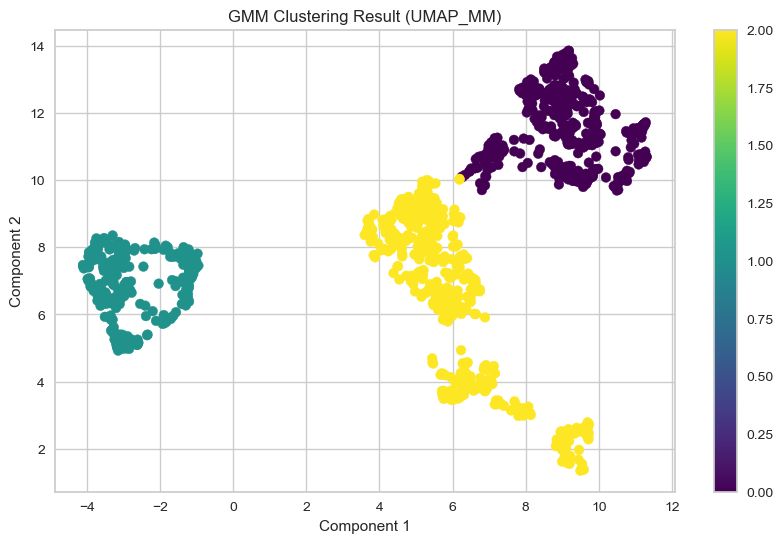

Hierarchical Clustering - Silhouette Score for UMAP_MM: 0.6182112693786621
Hierarchical Clustering - Davies-Bouldin Index for UMAP_MM: 0.5977104476253334
Hierarchical Clustering - Calinski-Harabasz Index for UMAP_MM: 3588.0320011629524


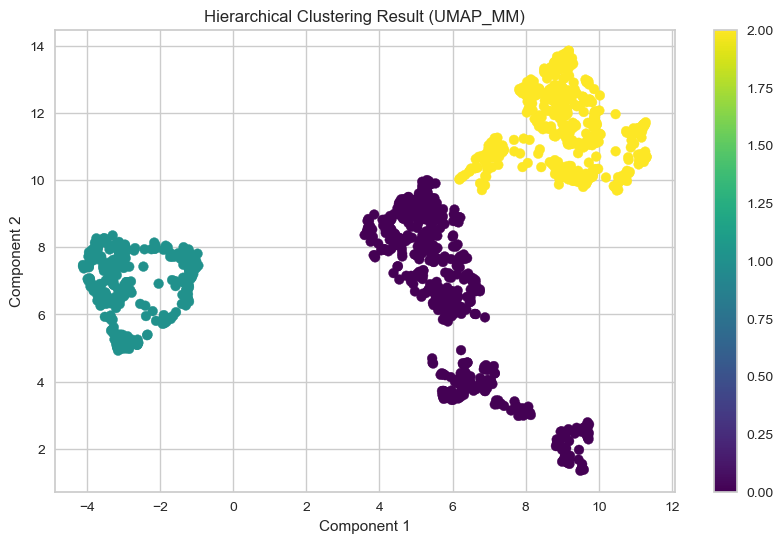

DBSCAN - Silhouette Score for UMAP_MM: 0.6510269641876221
DBSCAN - Davies-Bouldin Index for UMAP_MM: 0.4376760793932159
DBSCAN - Calinski-Harabasz Index for UMAP_MM: 5580.359557864309


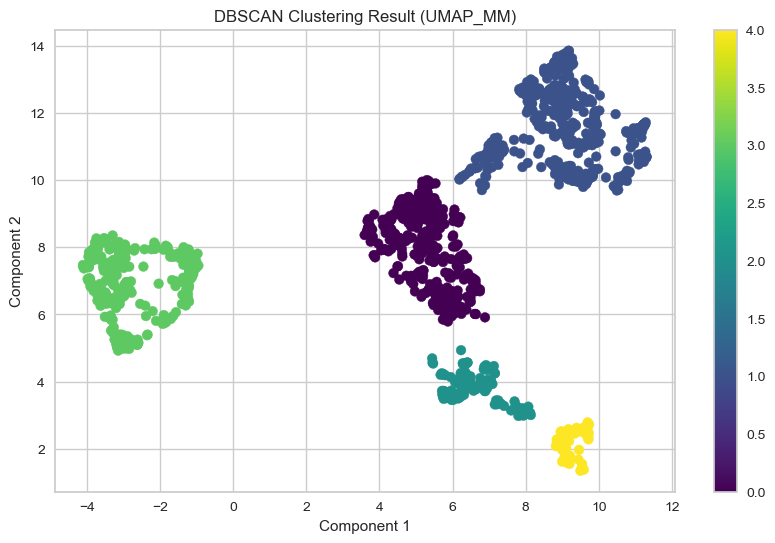

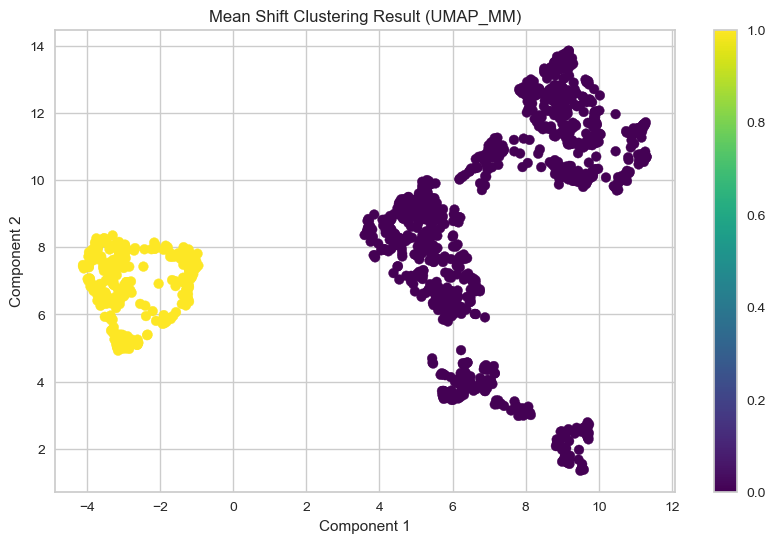

Affinity Propagation - Silhouette Score for UMAP_MM: 0.2943018674850464
Affinity Propagation - Davies-Bouldin Index for UMAP_MM: 0.1882771761795495
Affinity Propagation - Calinski-Harabasz Index for UMAP_MM: 89.89076276790253


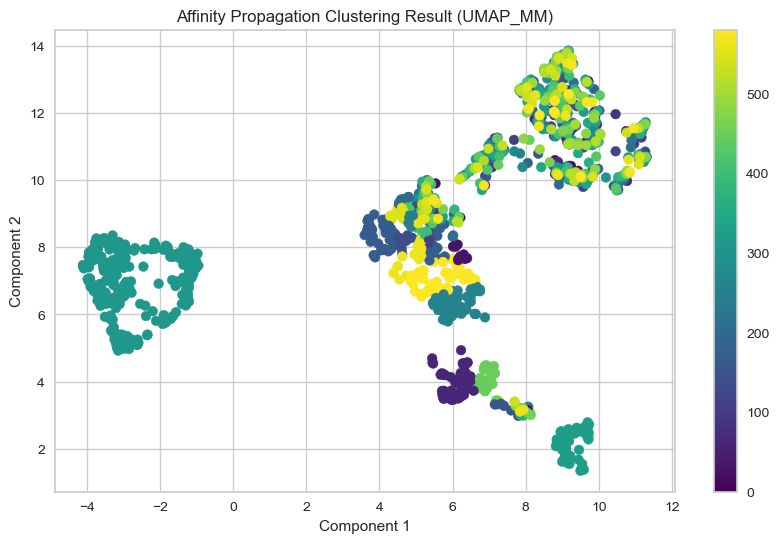

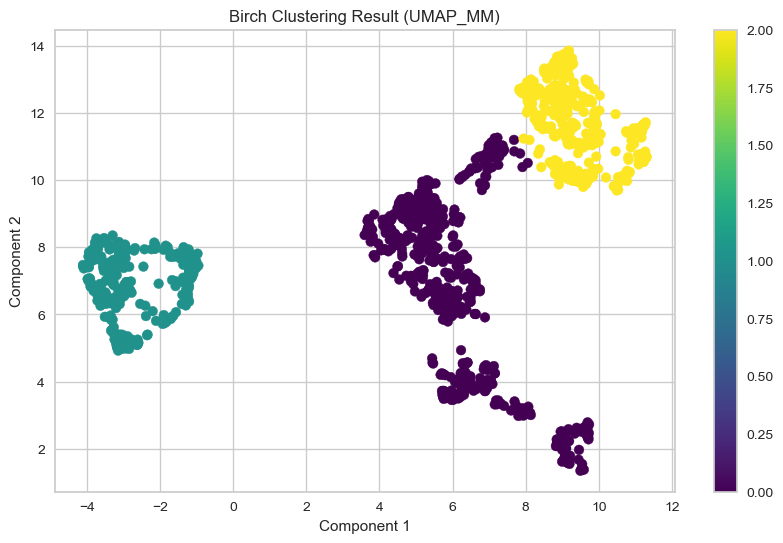

OPTICS - Silhouette Score for UMAP_MM: 0.07787907868623734
OPTICS - Davies-Bouldin Index for UMAP_MM: 2.42576906647787
OPTICS - Calinski-Harabasz Index for UMAP_MM: 26.554057511623665


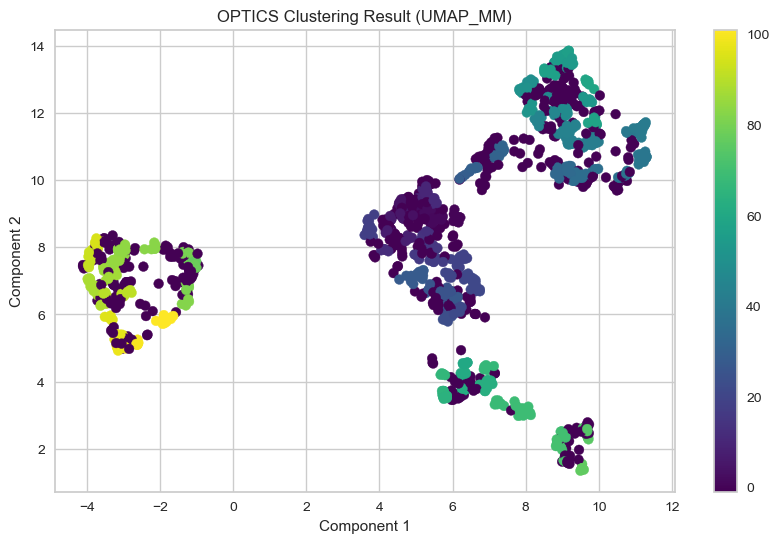

Spectral Clustering - Silhouette Score for UMAP_MM: 0.6614550948143005
Spectral Clustering - Davies-Bouldin Index for UMAP_MM: 0.468036102180299
Spectral Clustering - Calinski-Harabasz Index for UMAP_MM: 6197.319074350879


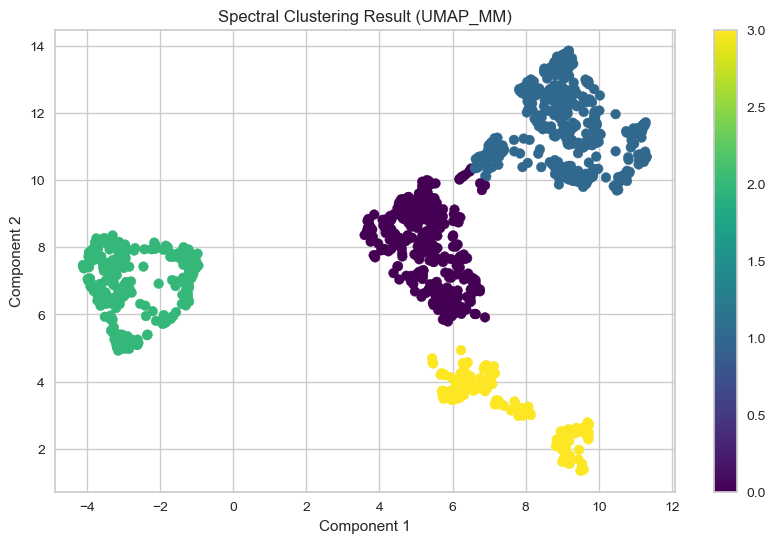

In [ ]:
evaluate_clustering(umap_result_MM, 'UMAP_MM')

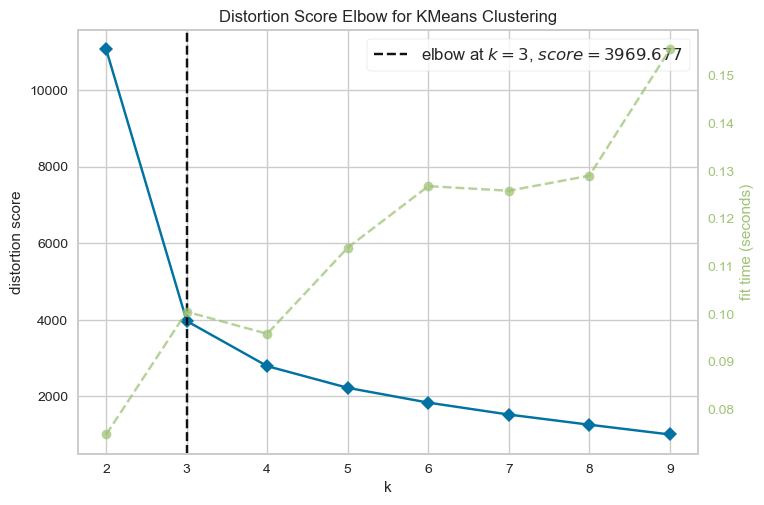

KMeans - Silhouette Score for UMAP_S: 0.6069411635398865
KMeans - Davies-Bouldin Index for UMAP_S: 0.5590284399671234
KMeans - Calinski-Harabasz Index for UMAP_S: 4434.117753830421


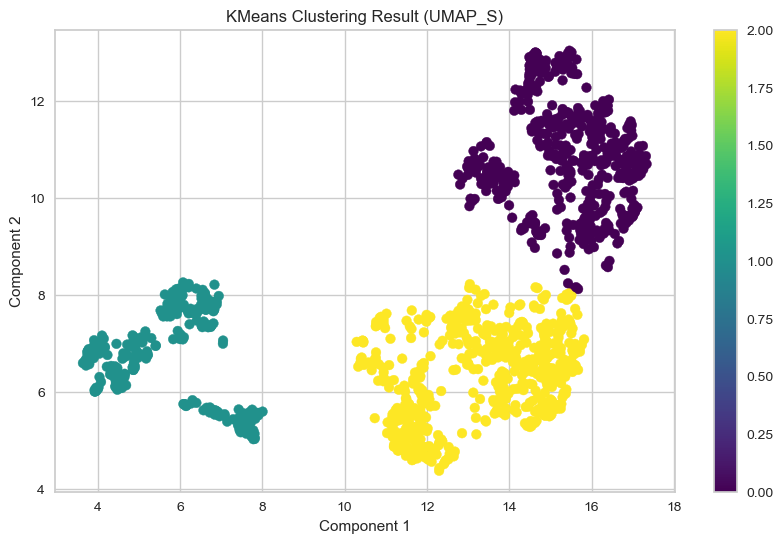

GMM - Silhouette Score for UMAP_S: 0.6068882942199707
GMM - Davies-Bouldin Index for UMAP_S: 0.5586372806260415
GMM - Calinski-Harabasz Index for UMAP_S: 4427.166992397636


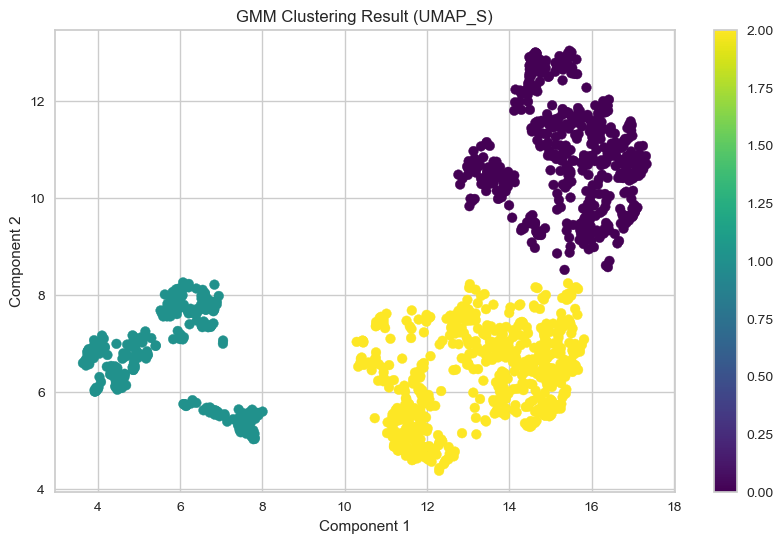

Hierarchical Clustering - Silhouette Score for UMAP_S: 0.6068882942199707
Hierarchical Clustering - Davies-Bouldin Index for UMAP_S: 0.5586372806260415
Hierarchical Clustering - Calinski-Harabasz Index for UMAP_S: 4427.166992397636


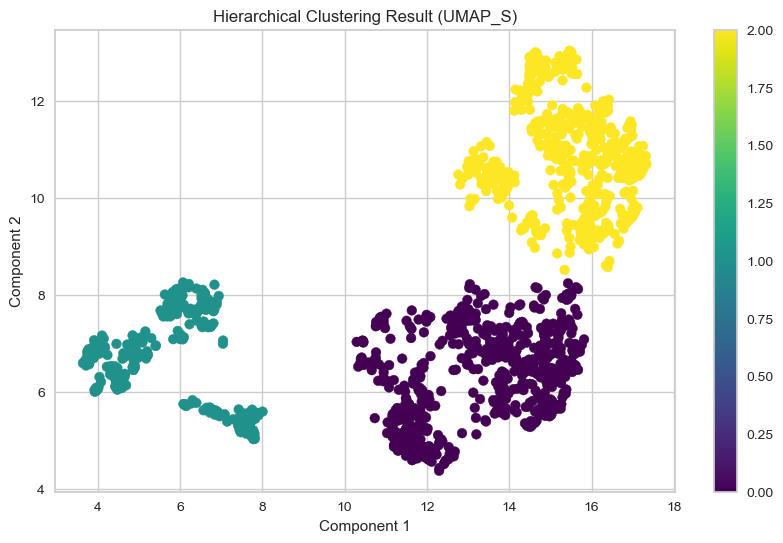

DBSCAN - Silhouette Score for UMAP_S: 0.48310768604278564
DBSCAN - Davies-Bouldin Index for UMAP_S: 0.5687231163148079
DBSCAN - Calinski-Harabasz Index for UMAP_S: 1199.7955954430229


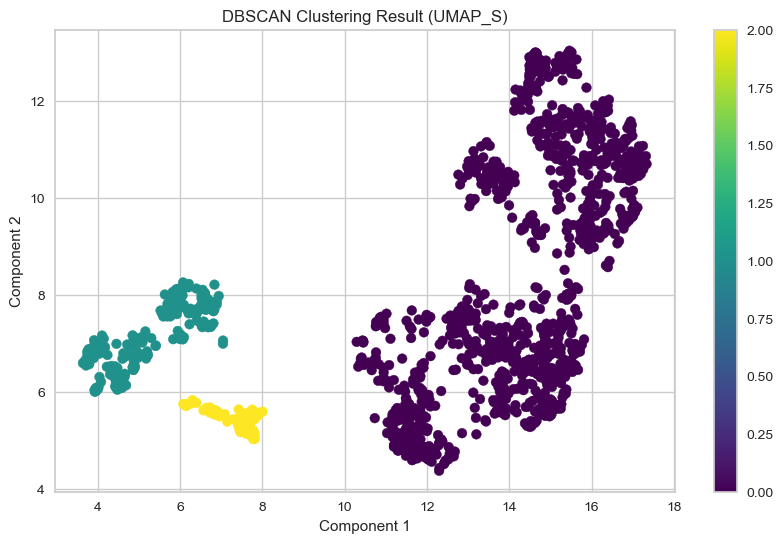

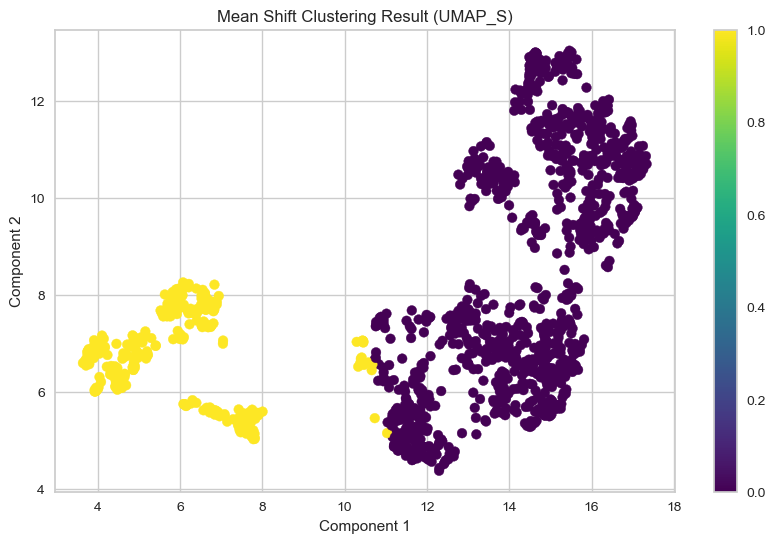

Affinity Propagation - Silhouette Score for UMAP_S: 0.27767643332481384
Affinity Propagation - Davies-Bouldin Index for UMAP_S: 0.40585418594732714
Affinity Propagation - Calinski-Harabasz Index for UMAP_S: 392.5697668127746


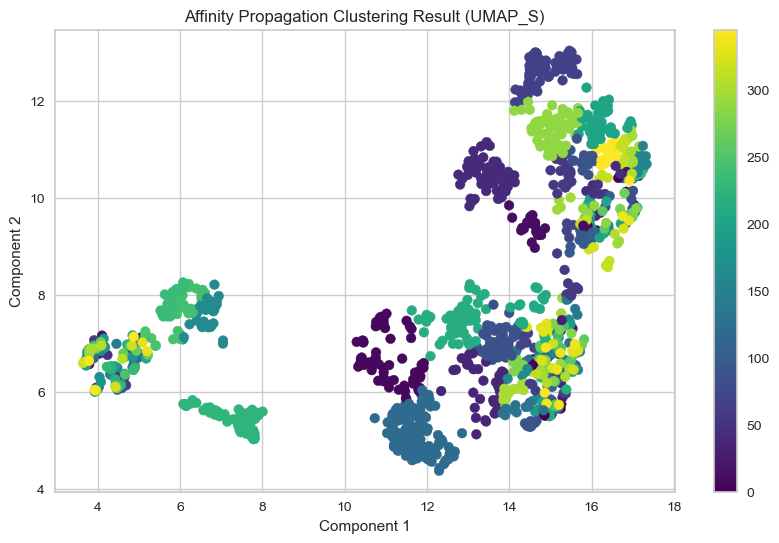

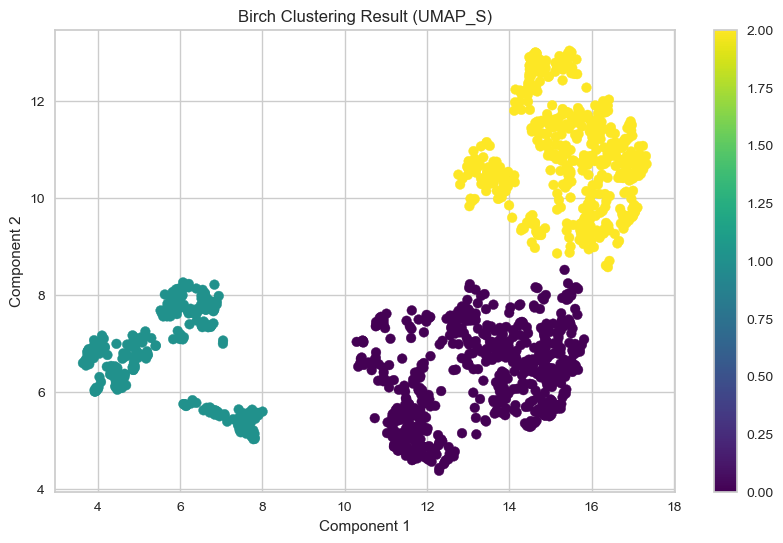

OPTICS - Silhouette Score for UMAP_S: -0.048602037131786346
OPTICS - Davies-Bouldin Index for UMAP_S: 1.2589959913814543
OPTICS - Calinski-Harabasz Index for UMAP_S: 22.74528943942105


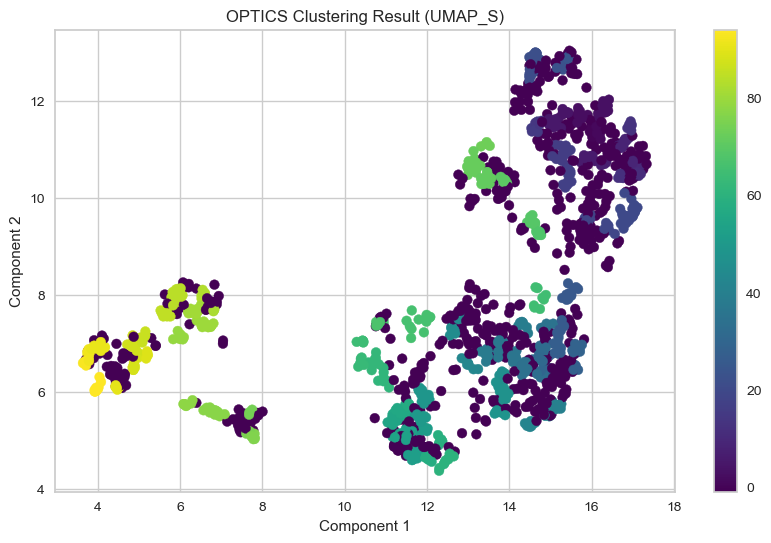

Spectral Clustering - Silhouette Score for UMAP_S: 0.6068882942199707
Spectral Clustering - Davies-Bouldin Index for UMAP_S: 0.5586372806260415
Spectral Clustering - Calinski-Harabasz Index for UMAP_S: 4427.166992397636


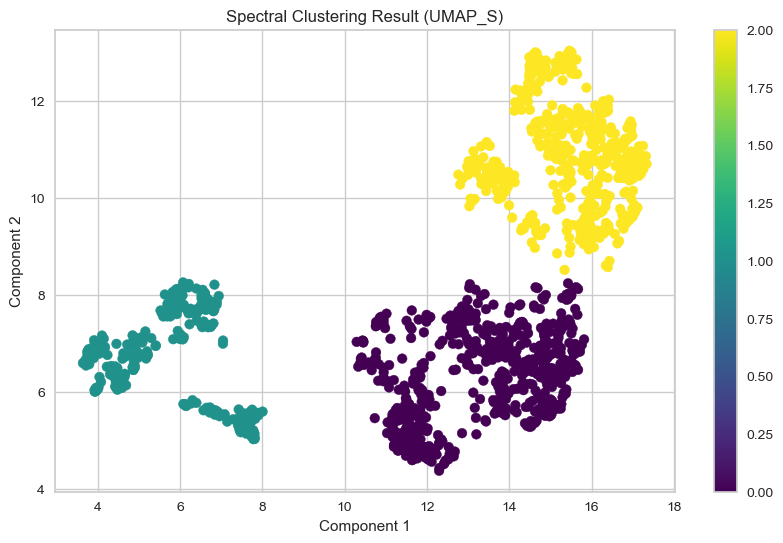

In [ ]:
evaluate_clustering(umap_result_S, 'UMAP_S')

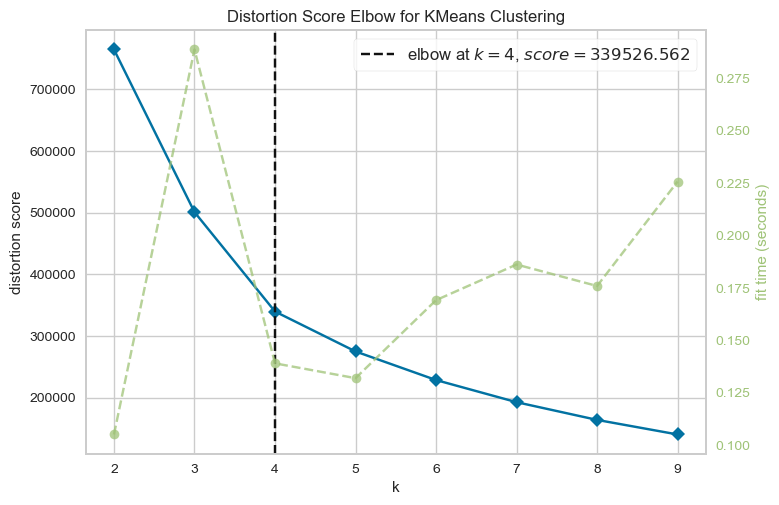

KMeans - Silhouette Score for t-SNE: 0.42611512541770935
KMeans - Davies-Bouldin Index for t-SNE: 0.7509330342062241
KMeans - Calinski-Harabasz Index for t-SNE: 1661.5151367536732


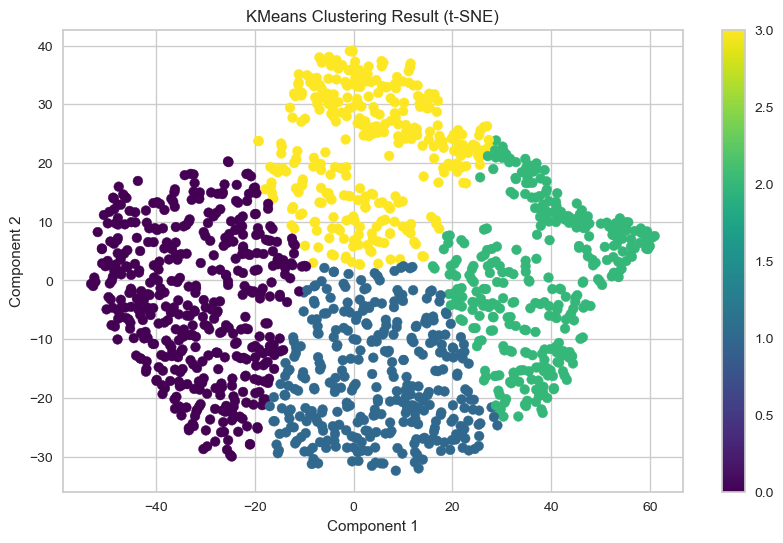

GMM - Silhouette Score for t-SNE: 0.418405145406723
GMM - Davies-Bouldin Index for t-SNE: 0.8534211576965016
GMM - Calinski-Harabasz Index for t-SNE: 1446.0047888277975


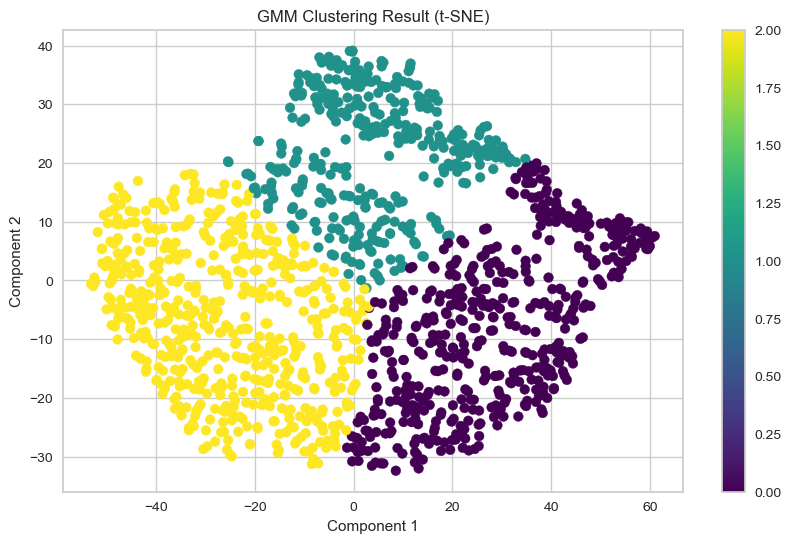

Hierarchical Clustering - Silhouette Score for t-SNE: 0.3290972113609314
Hierarchical Clustering - Davies-Bouldin Index for t-SNE: 1.122387628316079
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE: 1019.7356391663075


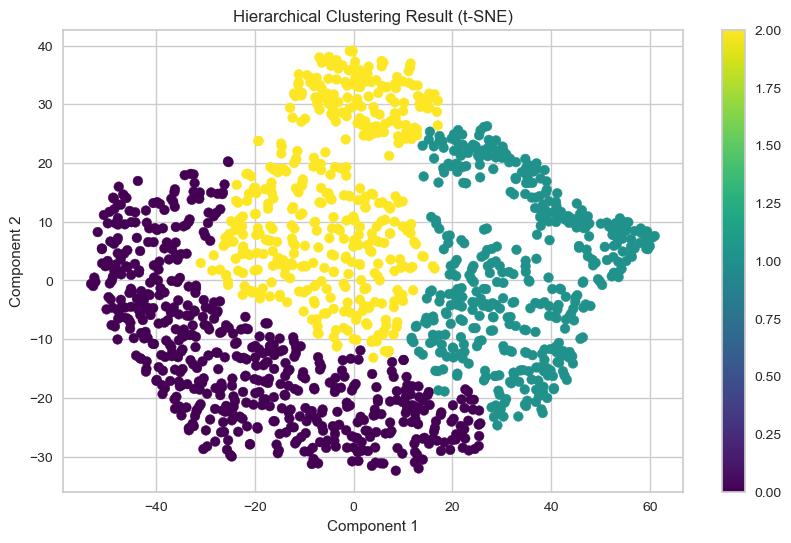

DBSCAN - Insufficient clusters for t-SNE


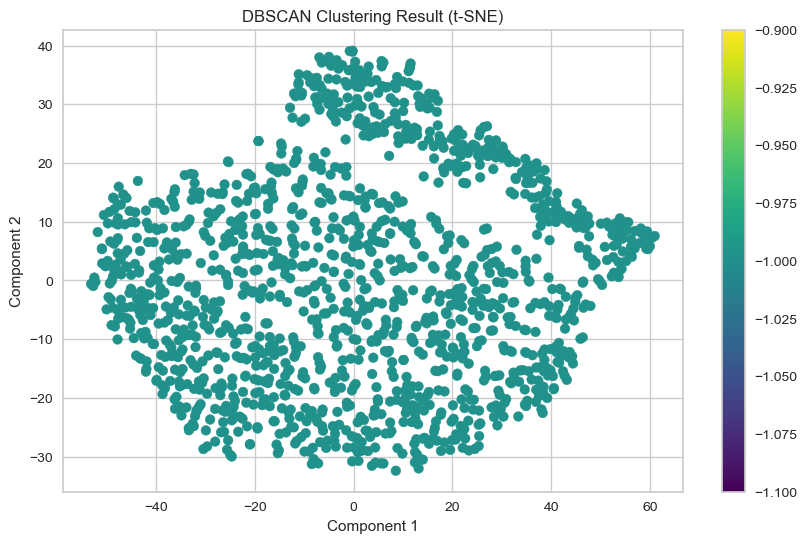

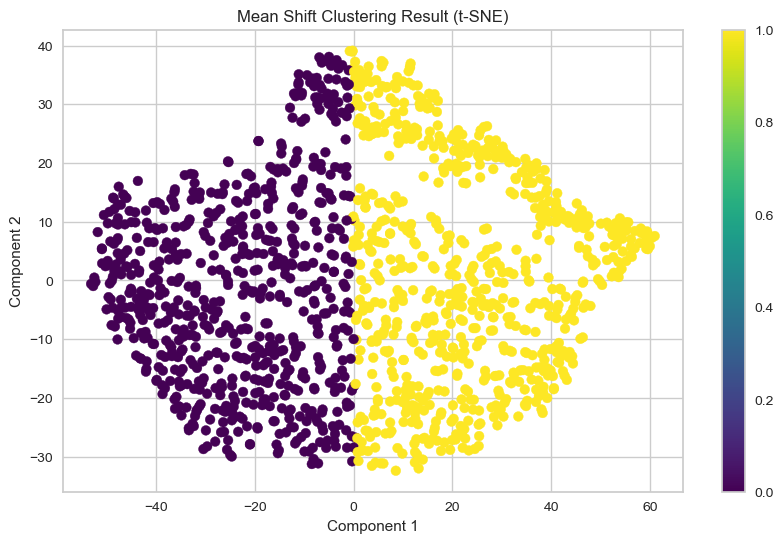

Affinity Propagation - Silhouette Score for t-SNE: 0.3304436206817627
Affinity Propagation - Davies-Bouldin Index for t-SNE: 0.8406550131210263
Affinity Propagation - Calinski-Harabasz Index for t-SNE: 1765.2417272505759


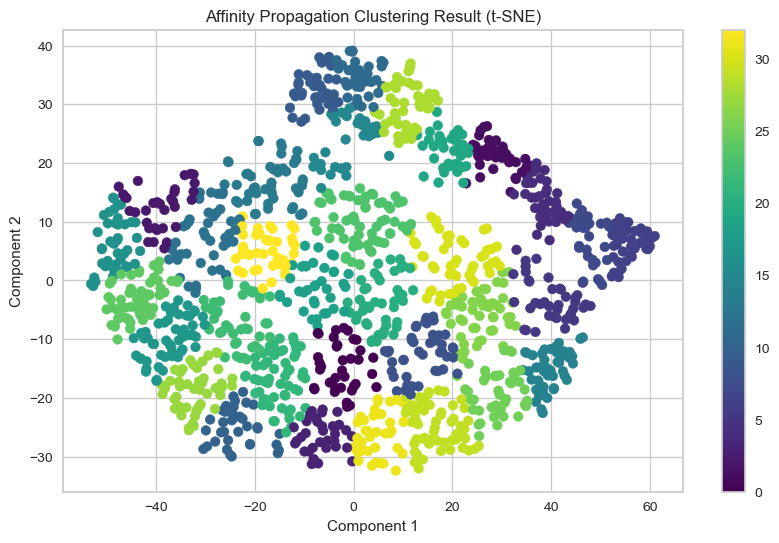

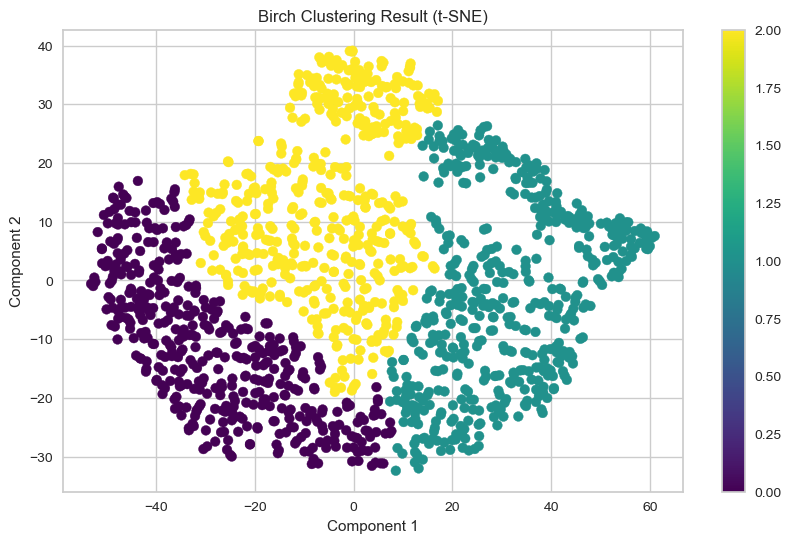

OPTICS - Silhouette Score for t-SNE: -0.15910106897354126
OPTICS - Davies-Bouldin Index for t-SNE: 1.298200989905629
OPTICS - Calinski-Harabasz Index for t-SNE: 18.3686904789995


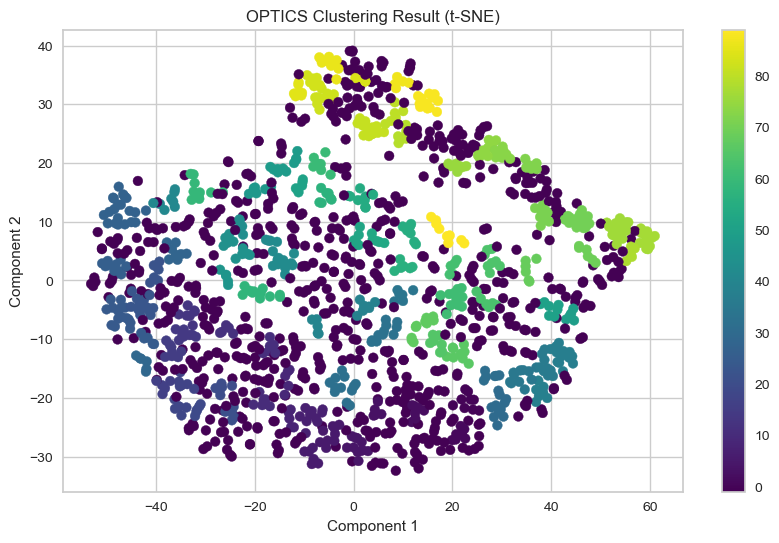

Spectral Clustering - Silhouette Score for t-SNE: -0.015732884407043457
Spectral Clustering - Davies-Bouldin Index for t-SNE: 1.003177910676075
Spectral Clustering - Calinski-Harabasz Index for t-SNE: 175.0032661596864


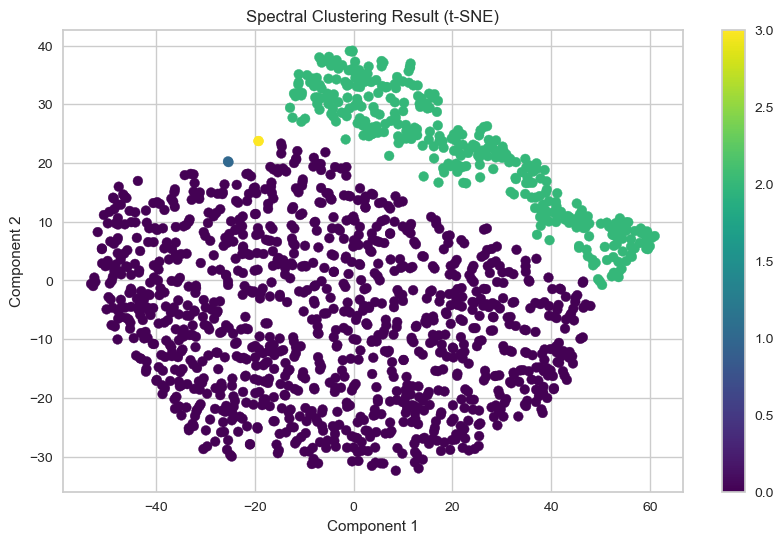

In [ ]:
evaluate_clustering(tsne_result, 't-SNE')

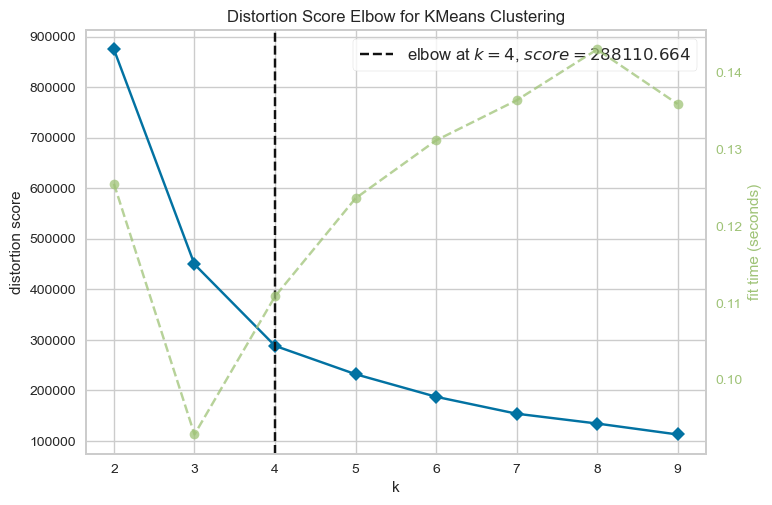

KMeans - Silhouette Score for t-SNE_MM: 0.5081744194030762
KMeans - Davies-Bouldin Index for t-SNE_MM: 0.6778902483891875
KMeans - Calinski-Harabasz Index for t-SNE_MM: 1993.5443996994584


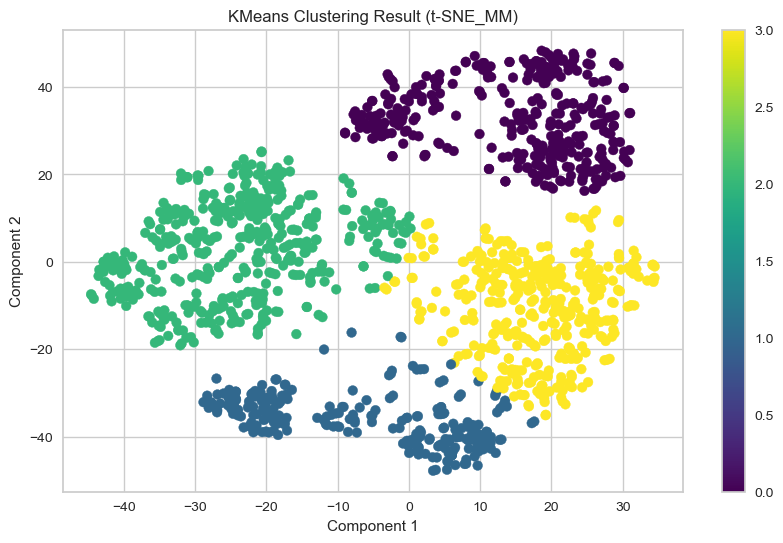

GMM - Silhouette Score for t-SNE_MM: 0.47928884625434875
GMM - Davies-Bouldin Index for t-SNE_MM: 0.7783300953122348
GMM - Calinski-Harabasz Index for t-SNE_MM: 1573.6696351426658


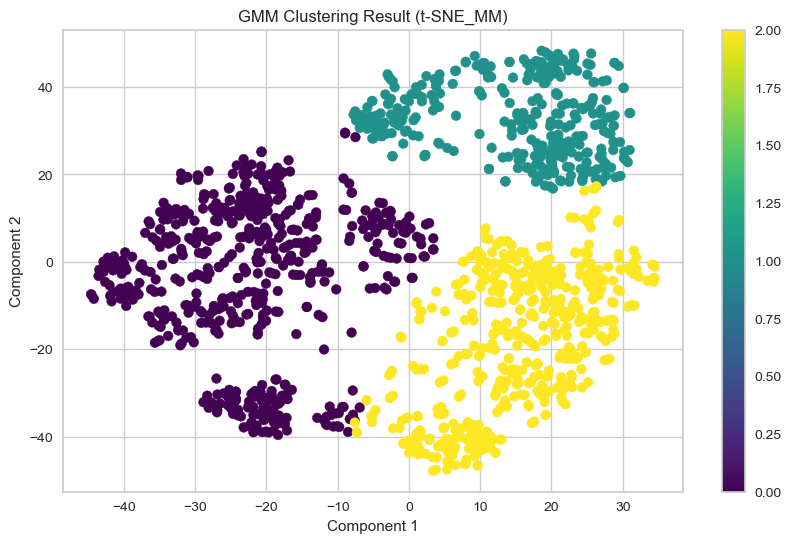

Hierarchical Clustering - Silhouette Score for t-SNE_MM: 0.47748002409935
Hierarchical Clustering - Davies-Bouldin Index for t-SNE_MM: 0.7830488847460931
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE_MM: 1548.6272890395794


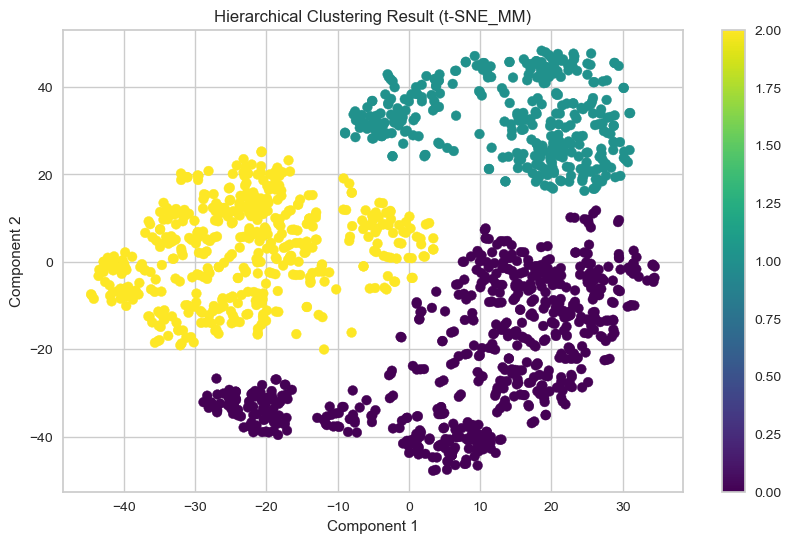

DBSCAN - Insufficient clusters for t-SNE_MM


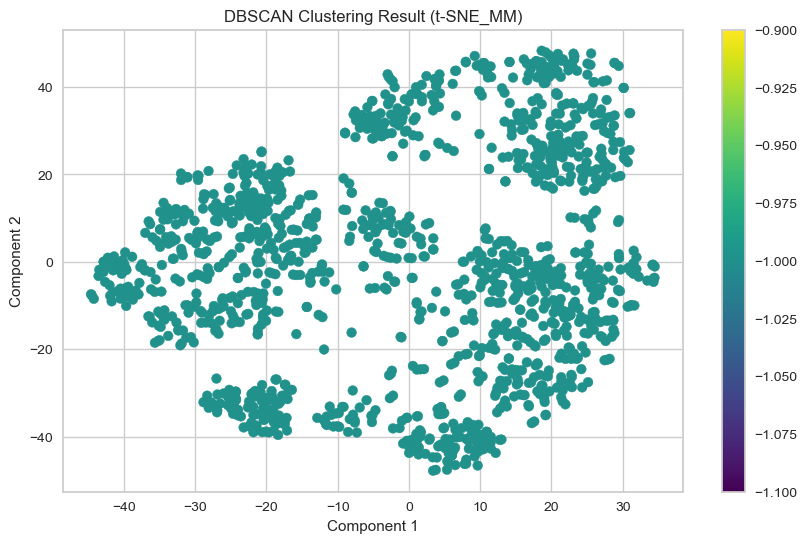

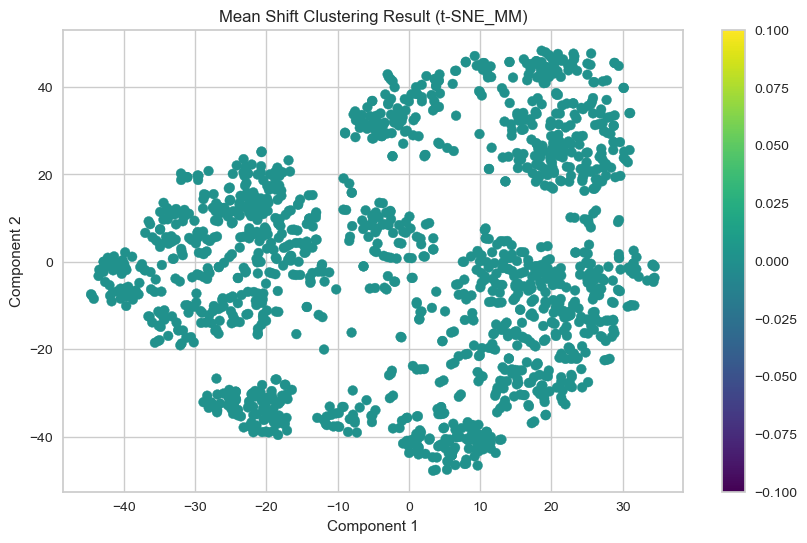

Affinity Propagation - Silhouette Score for t-SNE_MM: 0.3975120484828949
Affinity Propagation - Davies-Bouldin Index for t-SNE_MM: 0.8406088856583155
Affinity Propagation - Calinski-Harabasz Index for t-SNE_MM: 2366.3730176561567


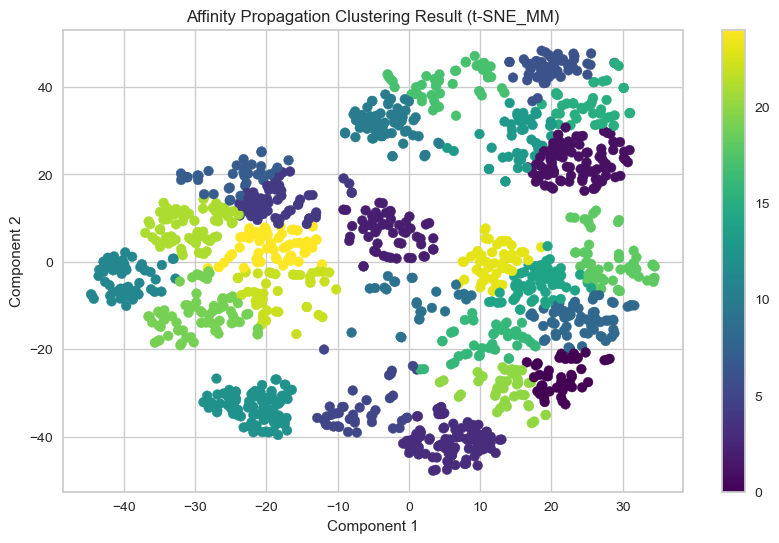

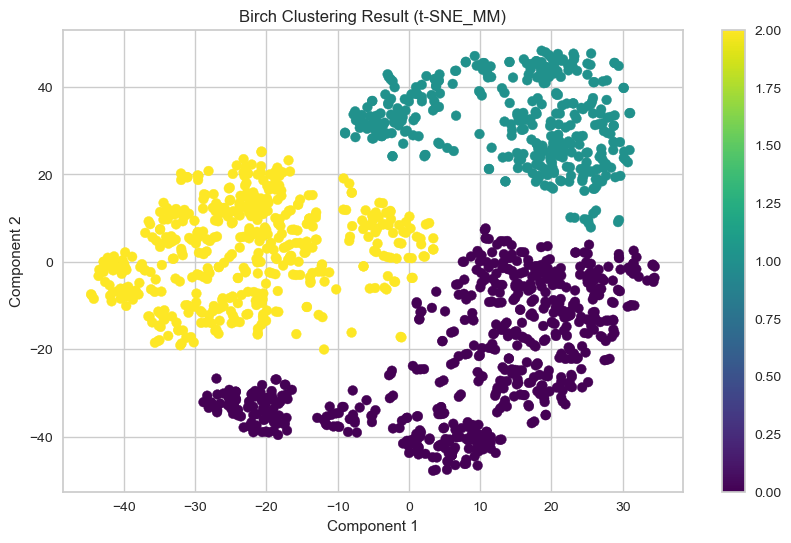

OPTICS - Silhouette Score for t-SNE_MM: -0.08067148923873901
OPTICS - Davies-Bouldin Index for t-SNE_MM: 1.325044844886853
OPTICS - Calinski-Harabasz Index for t-SNE_MM: 18.344422126922456


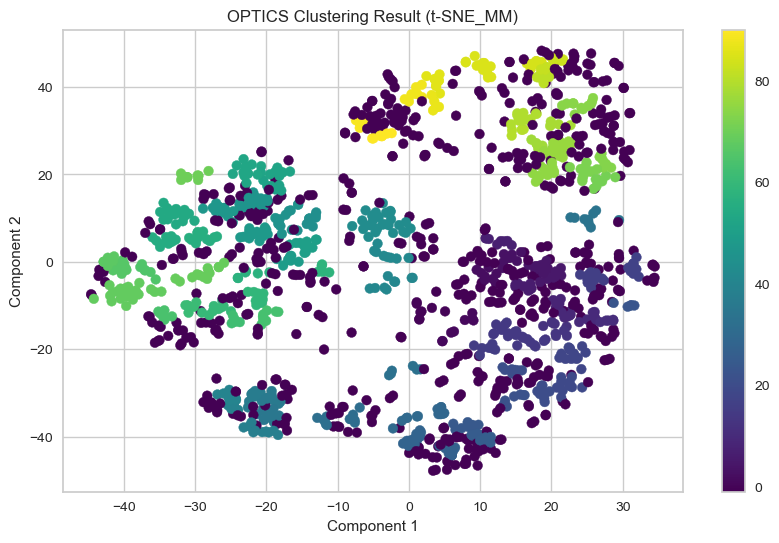

Spectral Clustering - Silhouette Score for t-SNE_MM: -0.2300674468278885
Spectral Clustering - Davies-Bouldin Index for t-SNE_MM: 1.5143604249572515
Spectral Clustering - Calinski-Harabasz Index for t-SNE_MM: 0.4382168257198731


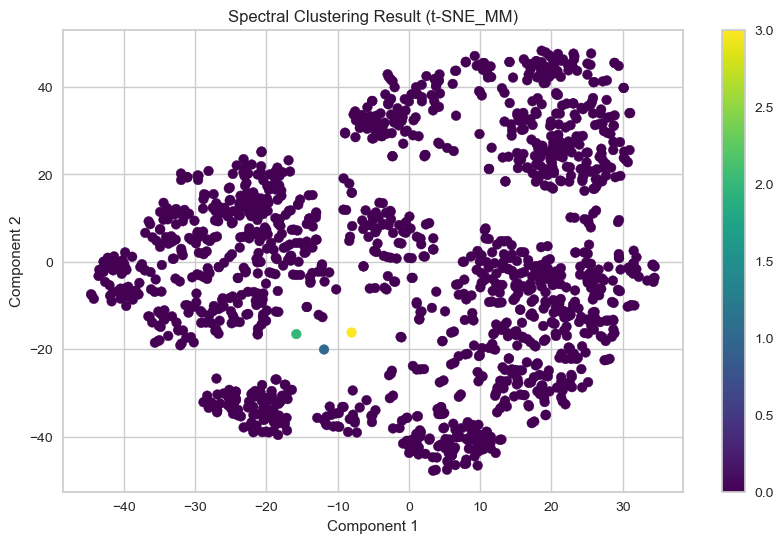

In [ ]:
evaluate_clustering(tsne_result_MM, 't-SNE_MM')

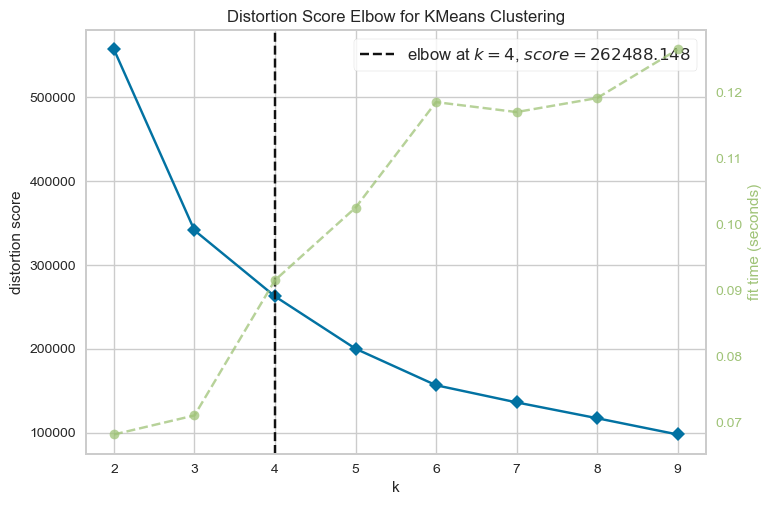

KMeans - Silhouette Score for t-SNE_S: 0.4244062304496765
KMeans - Davies-Bouldin Index for t-SNE_S: 0.828405510113725
KMeans - Calinski-Harabasz Index for t-SNE_S: 1975.5721481565147


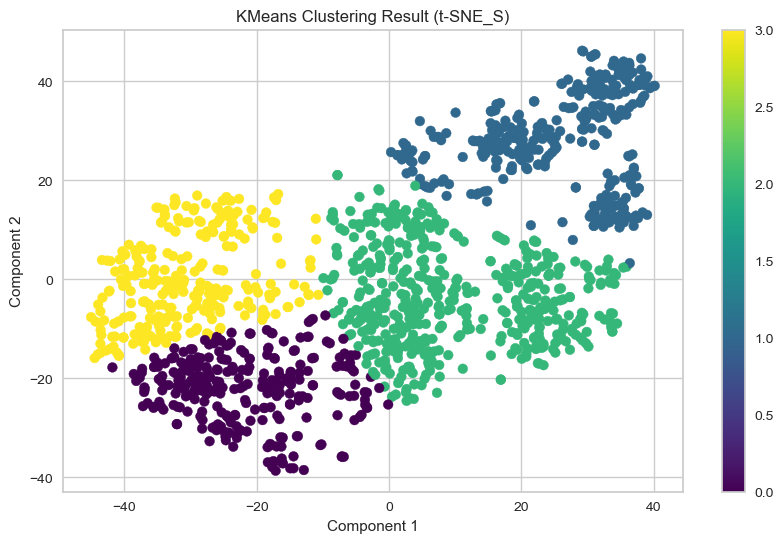

GMM - Silhouette Score for t-SNE_S: 0.41457873582839966
GMM - Davies-Bouldin Index for t-SNE_S: 0.7869633081047805
GMM - Calinski-Harabasz Index for t-SNE_S: 1657.5449735851128


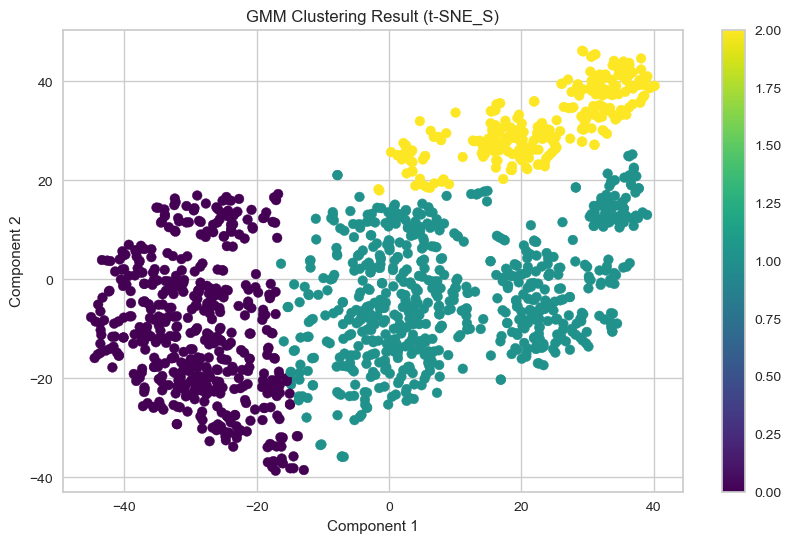

Hierarchical Clustering - Silhouette Score for t-SNE_S: 0.46031463146209717
Hierarchical Clustering - Davies-Bouldin Index for t-SNE_S: 0.7785914740781381
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE_S: 2099.6457208307747


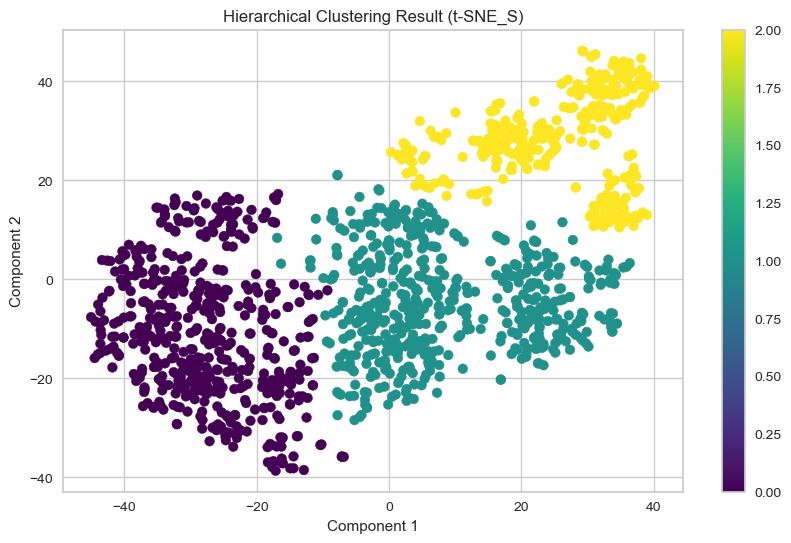

DBSCAN - Insufficient clusters for t-SNE_S


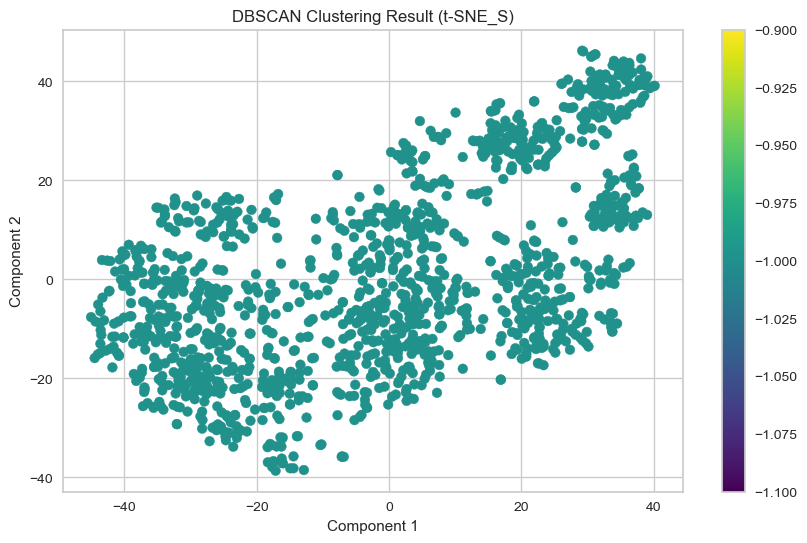

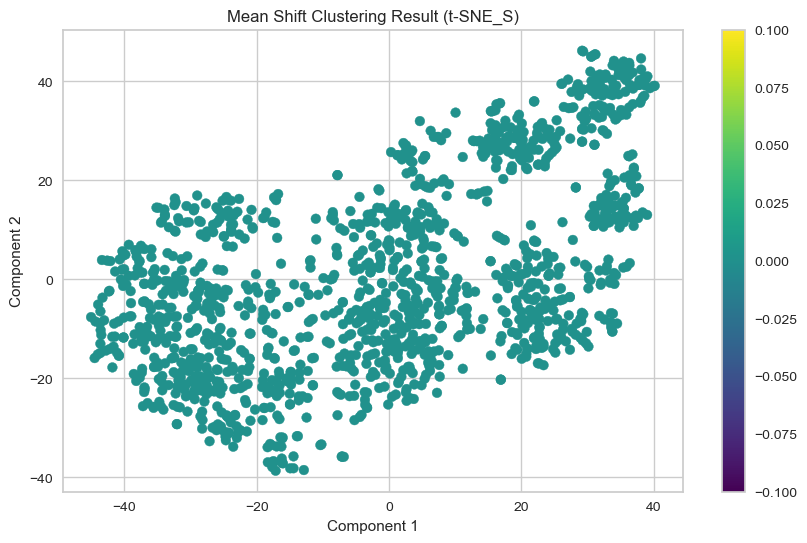

Affinity Propagation - Silhouette Score for t-SNE_S: 0.2871762812137604
Affinity Propagation - Davies-Bouldin Index for t-SNE_S: 0.5550271562979829
Affinity Propagation - Calinski-Harabasz Index for t-SNE_S: 422.65317309752567


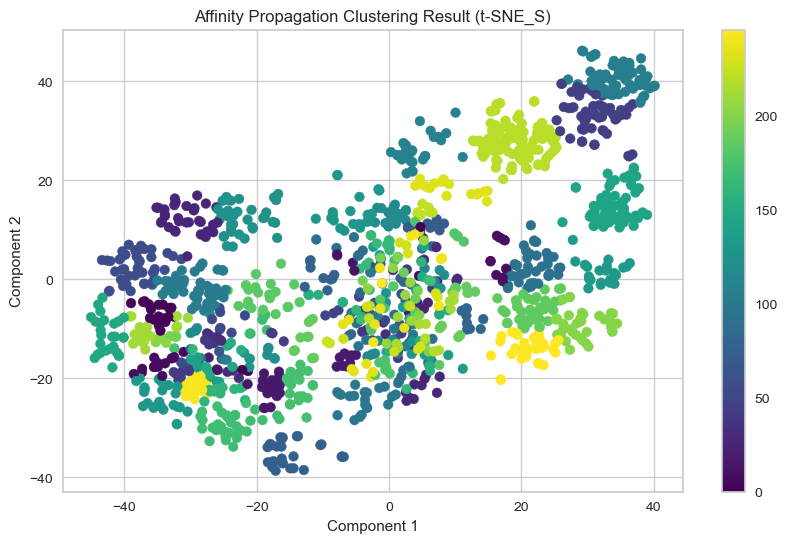

Birch - Silhouette Score for t-SNE_S: 0.4488488435745239
Birch - Davies-Bouldin Index for t-SNE_S: 0.7908574001949912
Birch - Calinski-Harabasz Index for t-SNE_S: 2003.8824691378002


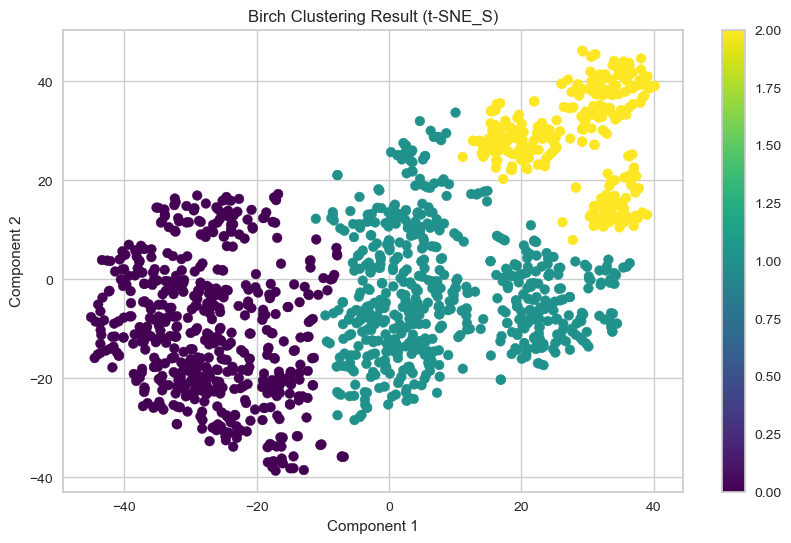

OPTICS - Silhouette Score for t-SNE_S: -0.12758788466453552
OPTICS - Davies-Bouldin Index for t-SNE_S: 1.6382185641408213
OPTICS - Calinski-Harabasz Index for t-SNE_S: 17.628336457461895


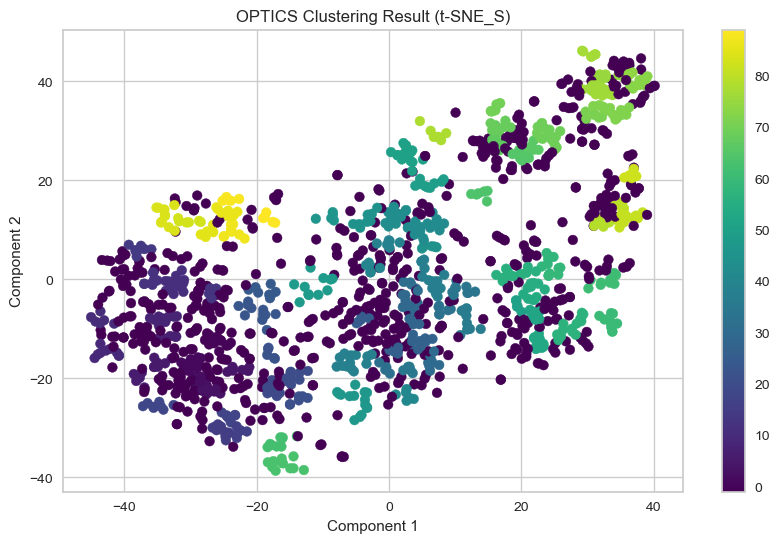

Spectral Clustering - Silhouette Score for t-SNE_S: -0.21413858234882355
Spectral Clustering - Davies-Bouldin Index for t-SNE_S: 4.787658136960327
Spectral Clustering - Calinski-Harabasz Index for t-SNE_S: 4.829008311691066


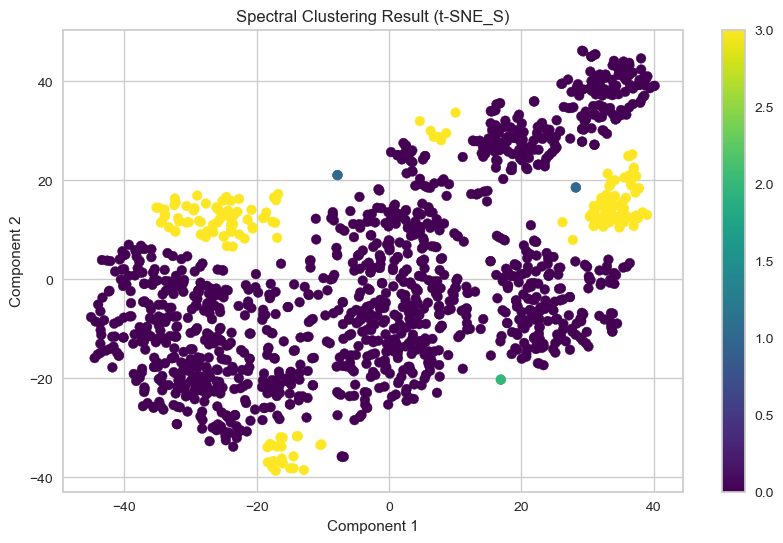

In [ ]:
evaluate_clustering(tsne_result_S, 't-SNE_S')

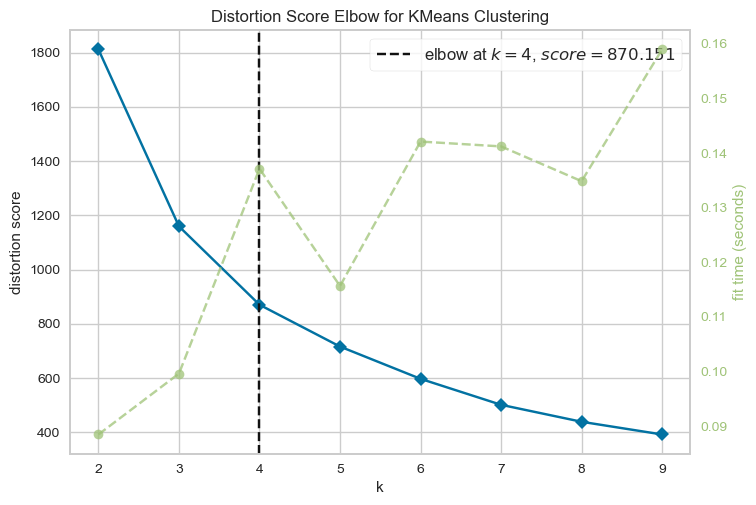

KMeans - Silhouette Score for ICA: 0.3895663146479333
KMeans - Davies-Bouldin Index for ICA: 0.8473647440647298
KMeans - Calinski-Harabasz Index for ICA: 1092.5566422846448


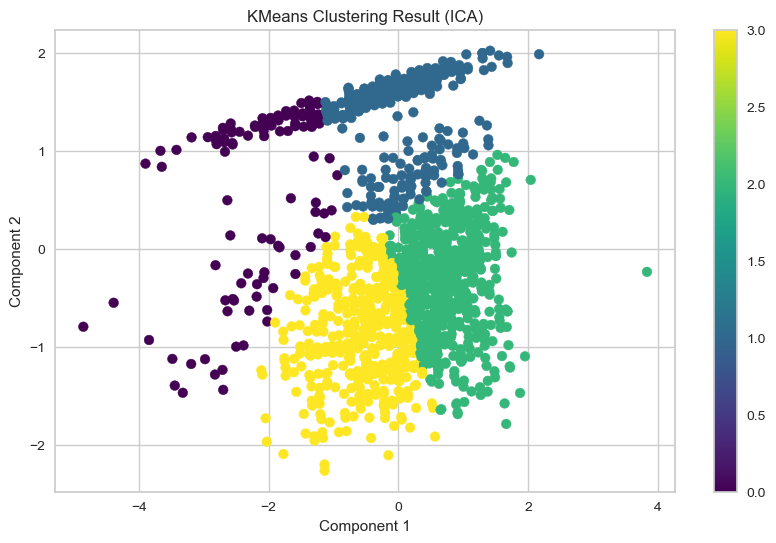

GMM - Silhouette Score for ICA: 0.39717204391728
GMM - Davies-Bouldin Index for ICA: 0.8804863964495869
GMM - Calinski-Harabasz Index for ICA: 895.5525378445475


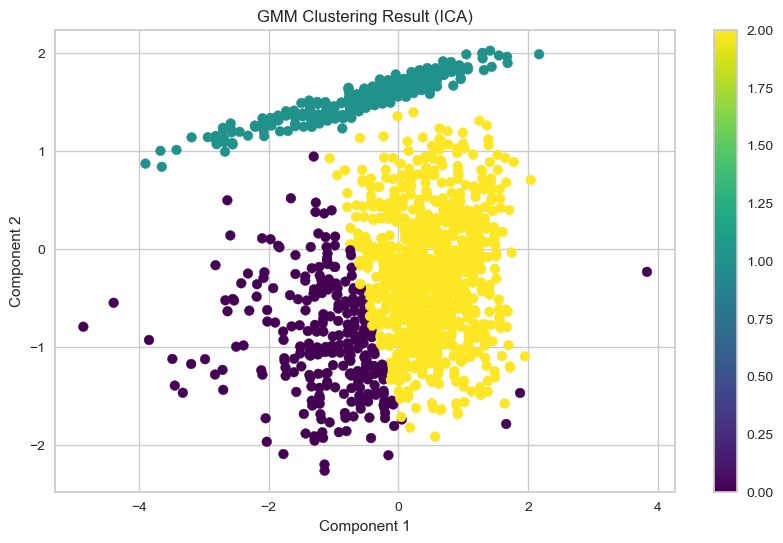

Hierarchical Clustering - Silhouette Score for ICA: 0.3578297786804624
Hierarchical Clustering - Davies-Bouldin Index for ICA: 0.9442047412029275
Hierarchical Clustering - Calinski-Harabasz Index for ICA: 837.7893451524795


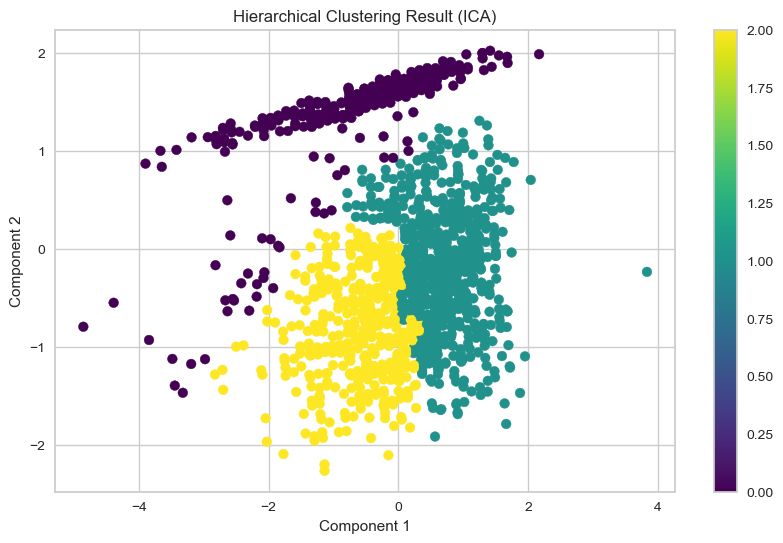

DBSCAN - Silhouette Score for ICA: 0.6080687377240264
DBSCAN - Davies-Bouldin Index for ICA: 2.660599777639953
DBSCAN - Calinski-Harabasz Index for ICA: 5.322974844799613


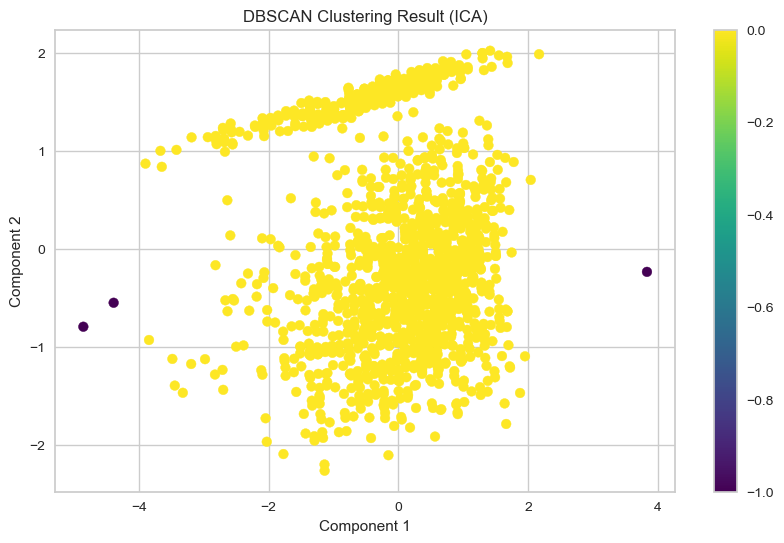

Mean Shift - Silhouette Score for ICA: 0.48495105949469536
Mean Shift - Davies-Bouldin Index for ICA: 0.8441683217488574
Mean Shift - Calinski-Harabasz Index for ICA: 9.824648473279124


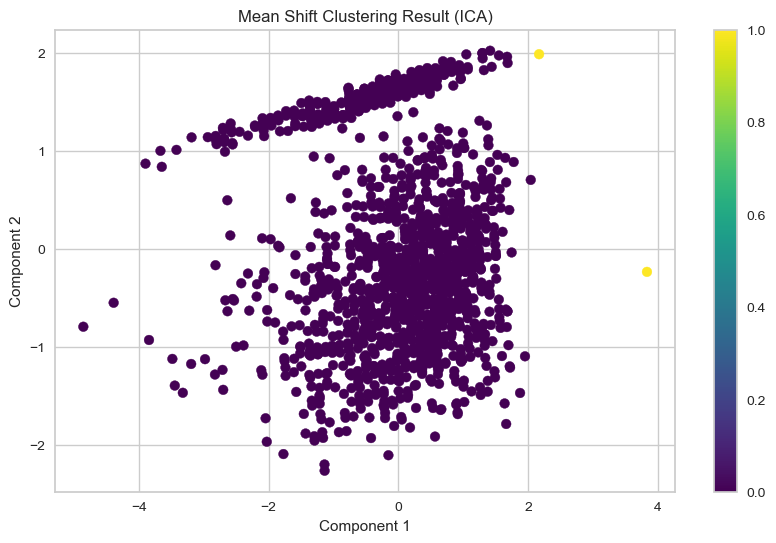

Affinity Propagation - Silhouette Score for ICA: 0.17918359340064768
Affinity Propagation - Davies-Bouldin Index for ICA: 0.5031854340095637
Affinity Propagation - Calinski-Harabasz Index for ICA: 149.82704772322793


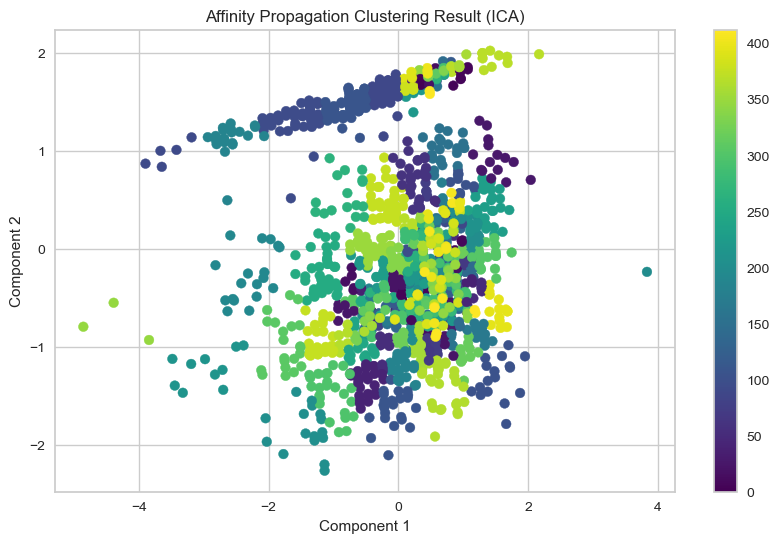

Birch - Silhouette Score for ICA: 0.30983775545841286
Birch - Davies-Bouldin Index for ICA: 1.0007269422439438
Birch - Calinski-Harabasz Index for ICA: 666.6475996177286


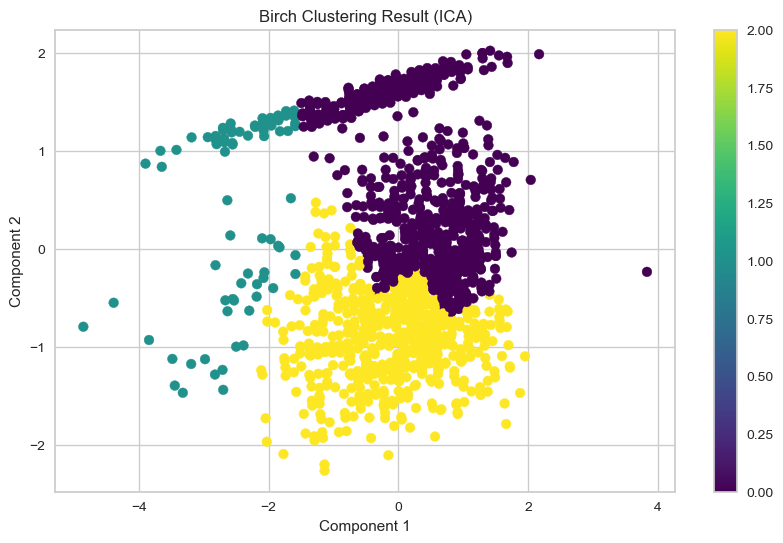

OPTICS - Silhouette Score for ICA: -0.052730576593599573
OPTICS - Davies-Bouldin Index for ICA: 1.949899959920612
OPTICS - Calinski-Harabasz Index for ICA: 14.48300680091431


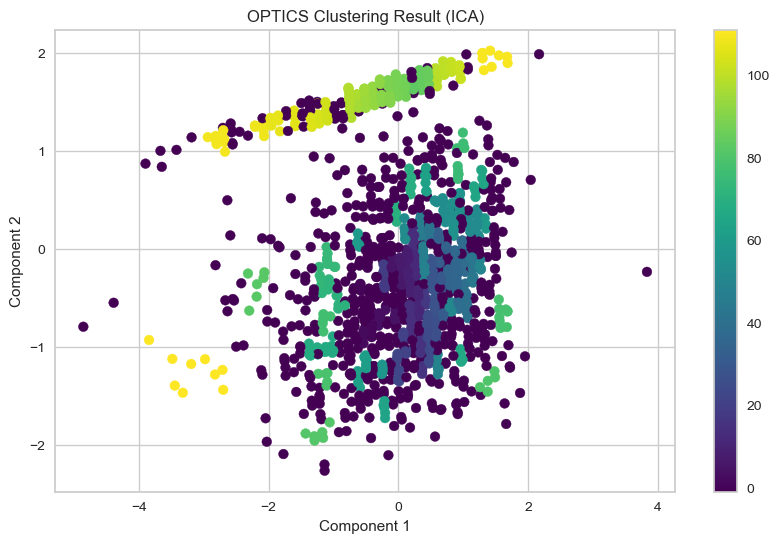

Spectral Clustering - Silhouette Score for ICA: 0.39097714540100864
Spectral Clustering - Davies-Bouldin Index for ICA: 0.6328284808006654
Spectral Clustering - Calinski-Harabasz Index for ICA: 421.82718011365023


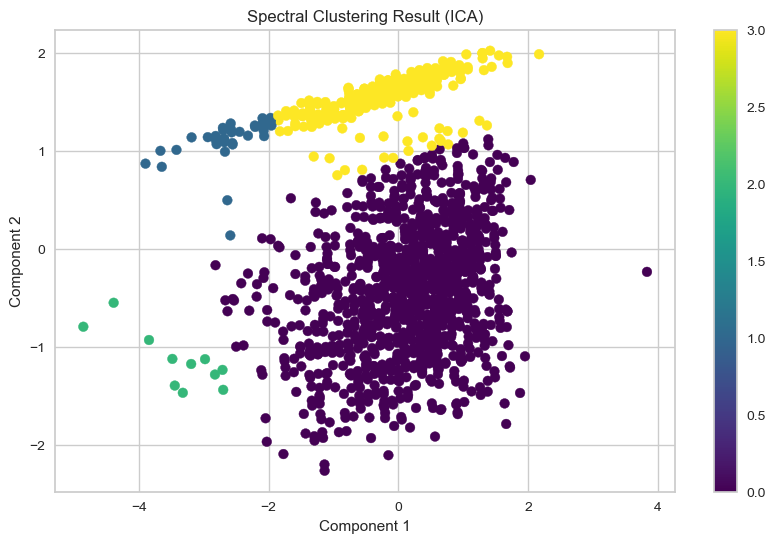

In [ ]:
evaluate_clustering(ica_result, 'ICA')

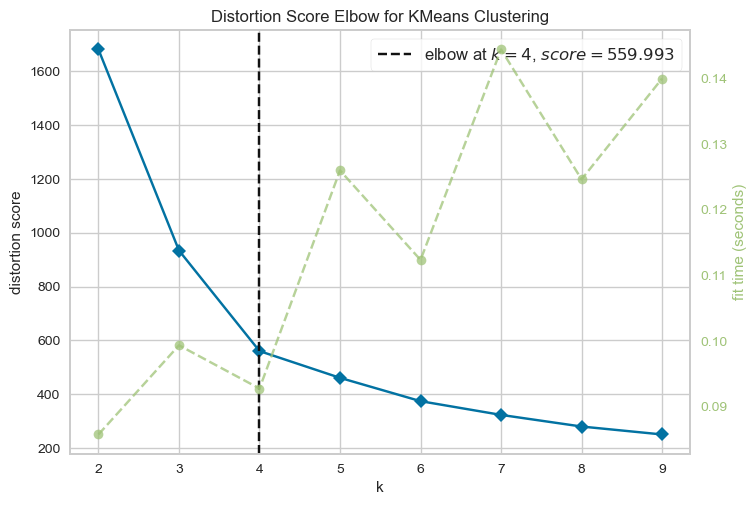

KMeans - Silhouette Score for ICA_MM: 0.4972909576121734
KMeans - Davies-Bouldin Index for ICA_MM: 0.6336460659619356
KMeans - Calinski-Harabasz Index for ICA_MM: 1961.50170798984


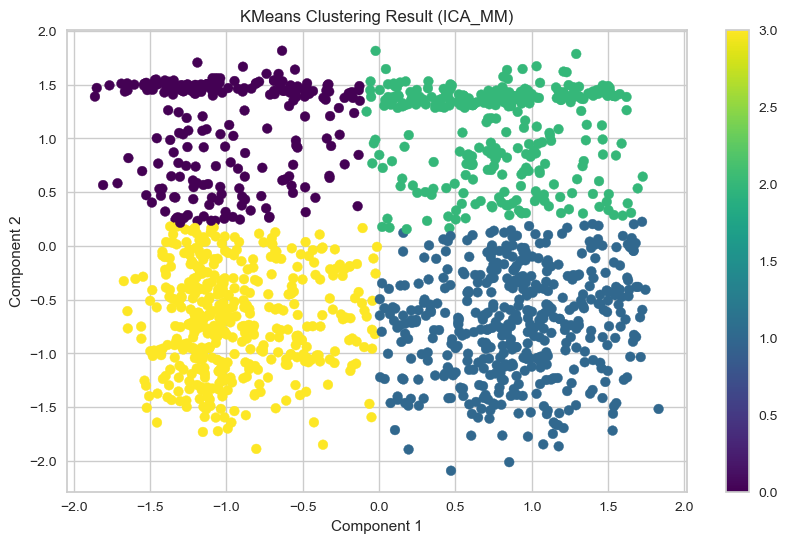

GMM - Silhouette Score for ICA_MM: 0.4024649829645683
GMM - Davies-Bouldin Index for ICA_MM: 0.8494556558684478
GMM - Calinski-Harabasz Index for ICA_MM: 1091.6539008928216


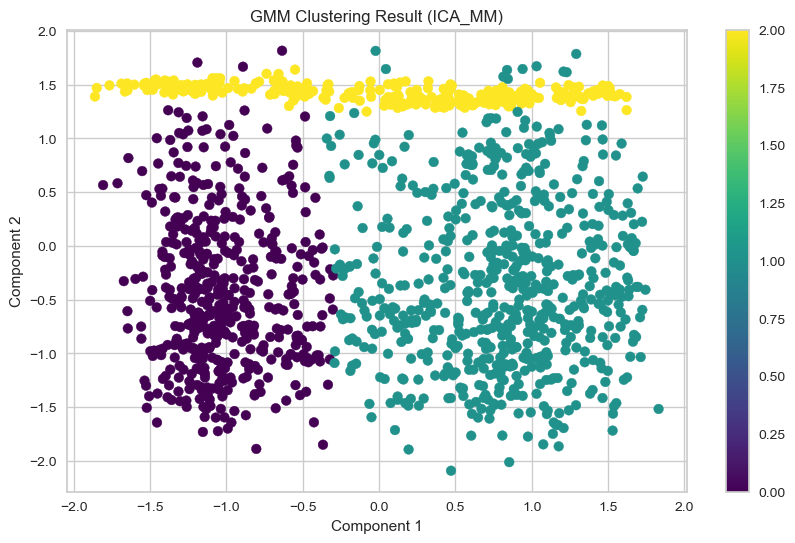

Hierarchical Clustering - Silhouette Score for ICA_MM: 0.4389899892151693
Hierarchical Clustering - Davies-Bouldin Index for ICA_MM: 0.7874393340853096
Hierarchical Clustering - Calinski-Harabasz Index for ICA_MM: 1329.7124595931573


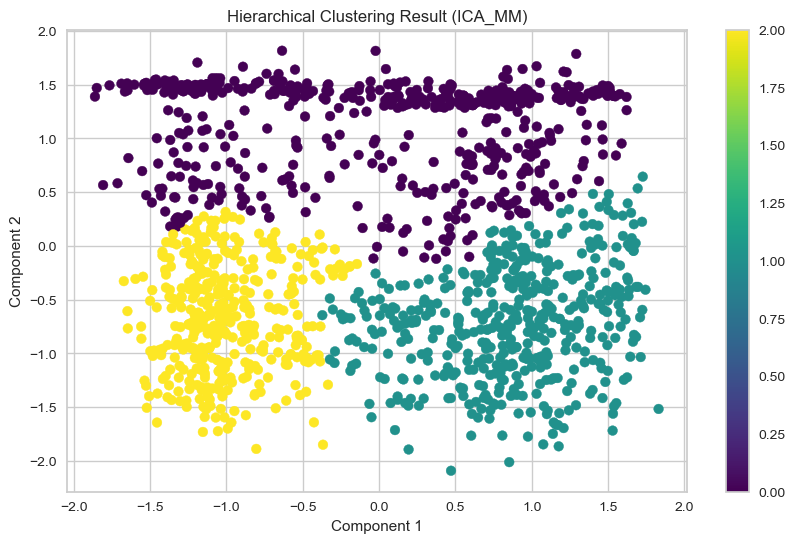

DBSCAN - Insufficient clusters for ICA_MM


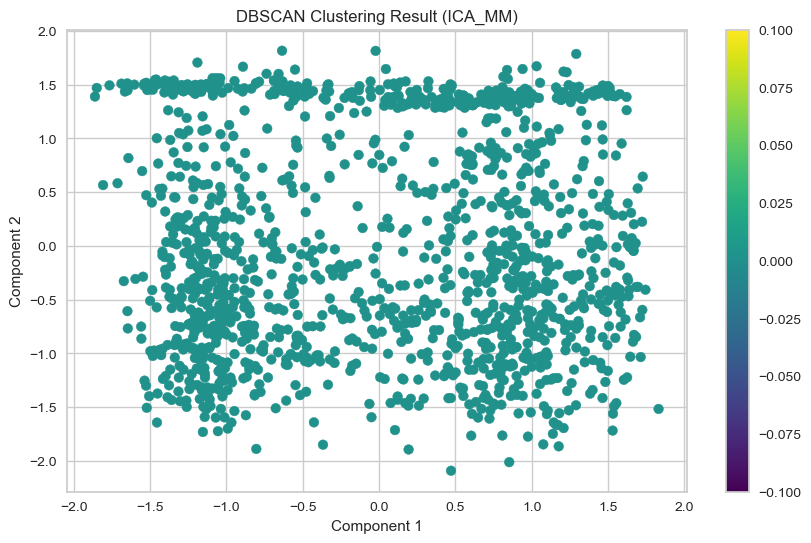

Mean Shift - Silhouette Score for ICA_MM: 0.40644930494914766
Mean Shift - Davies-Bouldin Index for ICA_MM: 1.080486504185889
Mean Shift - Calinski-Harabasz Index for ICA_MM: 1007.6620765618217


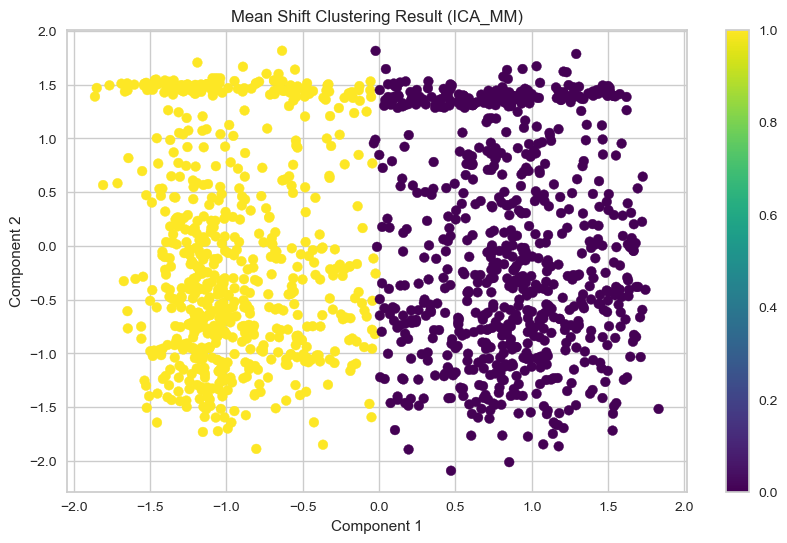

Affinity Propagation - Silhouette Score for ICA_MM: 0.3046378739278467
Affinity Propagation - Davies-Bouldin Index for ICA_MM: 0.6671355607614068
Affinity Propagation - Calinski-Harabasz Index for ICA_MM: 608.6147133075808


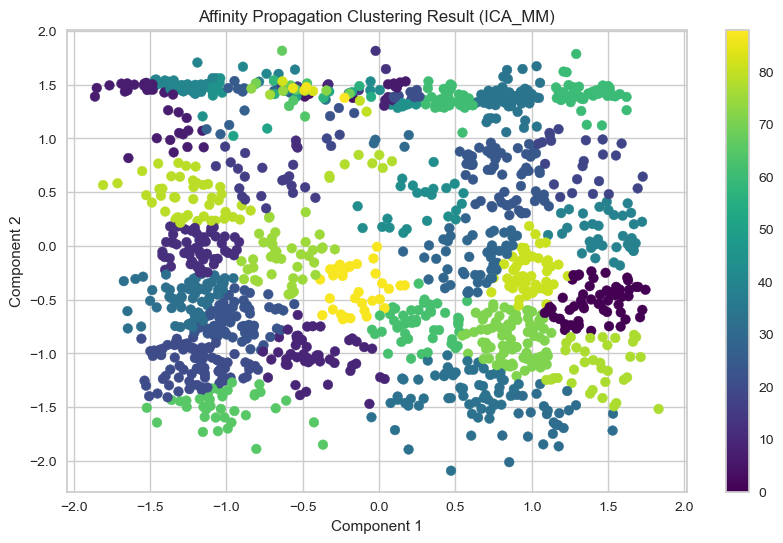

Birch - Silhouette Score for ICA_MM: 0.45122112636036515
Birch - Davies-Bouldin Index for ICA_MM: 0.7726095025128897
Birch - Calinski-Harabasz Index for ICA_MM: 1376.1131219490896


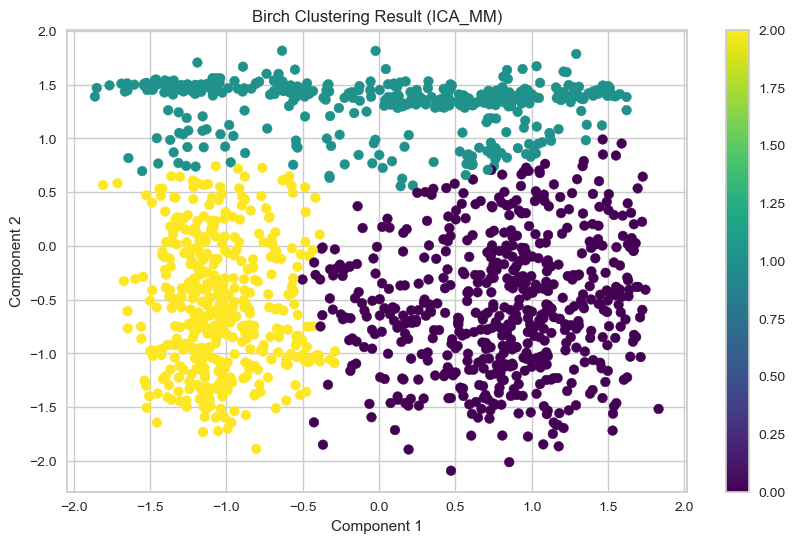

OPTICS - Silhouette Score for ICA_MM: -0.10150530934494584
OPTICS - Davies-Bouldin Index for ICA_MM: 1.3454208283995157
OPTICS - Calinski-Harabasz Index for ICA_MM: 15.548844662992147


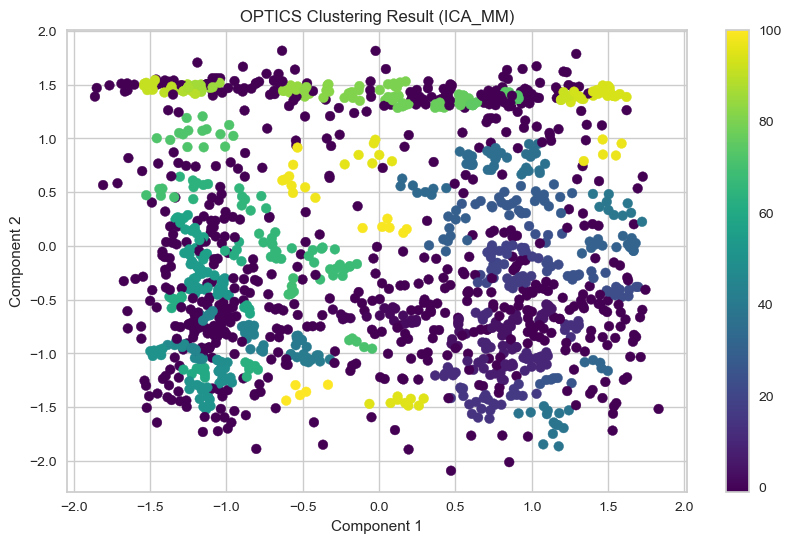

Spectral Clustering - Silhouette Score for ICA_MM: 0.4954893393725949
Spectral Clustering - Davies-Bouldin Index for ICA_MM: 0.6291393101130216
Spectral Clustering - Calinski-Harabasz Index for ICA_MM: 1859.6814870427672


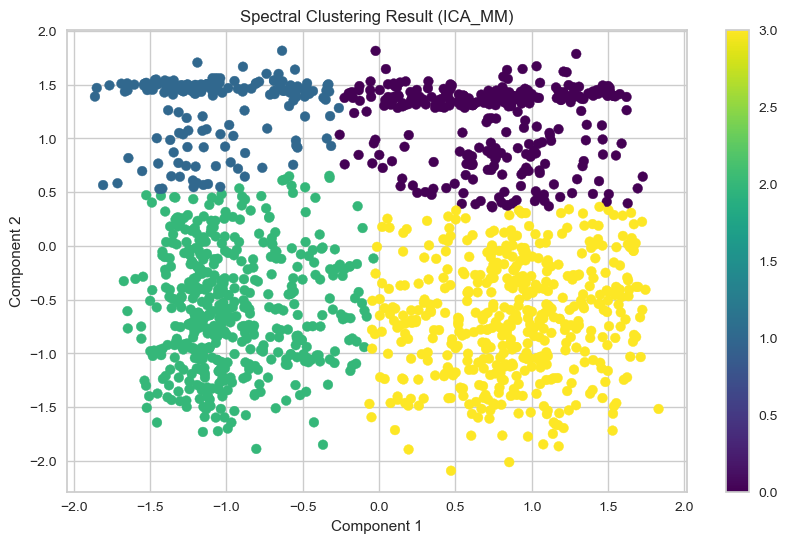

In [ ]:
evaluate_clustering(ica_result_MM, 'ICA_MM')

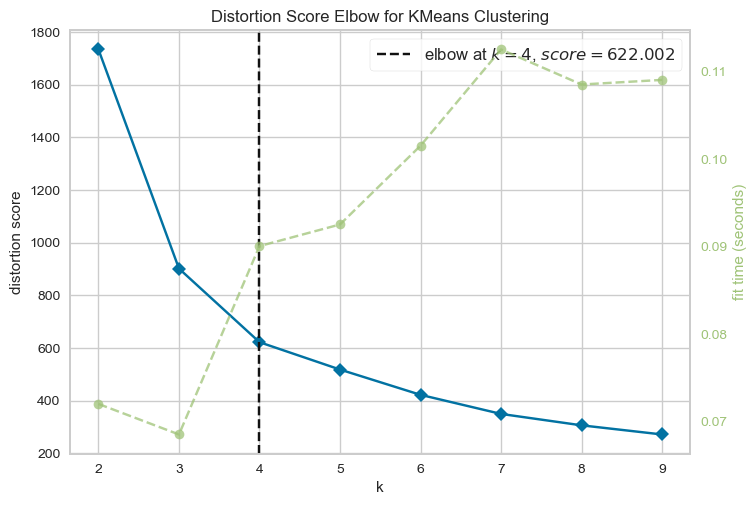

KMeans - Silhouette Score for ICA_S: 0.4762527490586744
KMeans - Davies-Bouldin Index for ICA_S: 0.6917452769254261
KMeans - Calinski-Harabasz Index for ICA_S: 1718.4682924598953


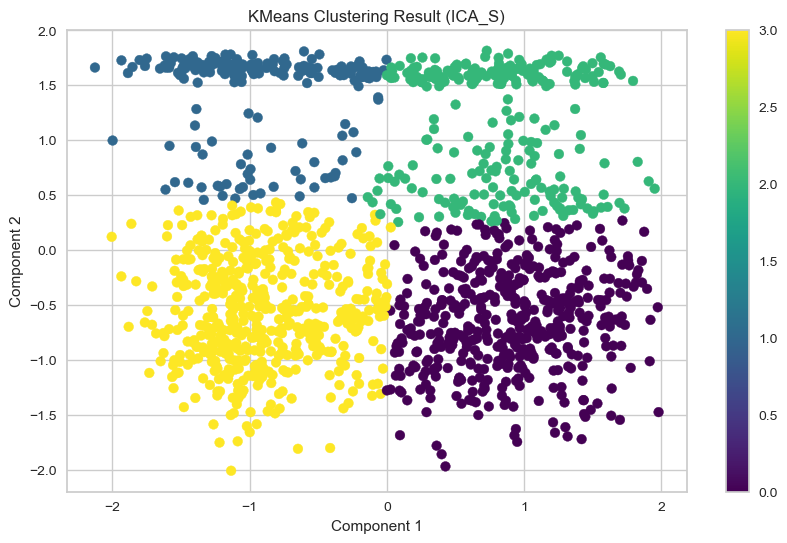

GMM - Silhouette Score for ICA_S: 0.45337444495338547
GMM - Davies-Bouldin Index for ICA_S: 0.7652579791167757
GMM - Calinski-Harabasz Index for ICA_S: 1354.0845866799284


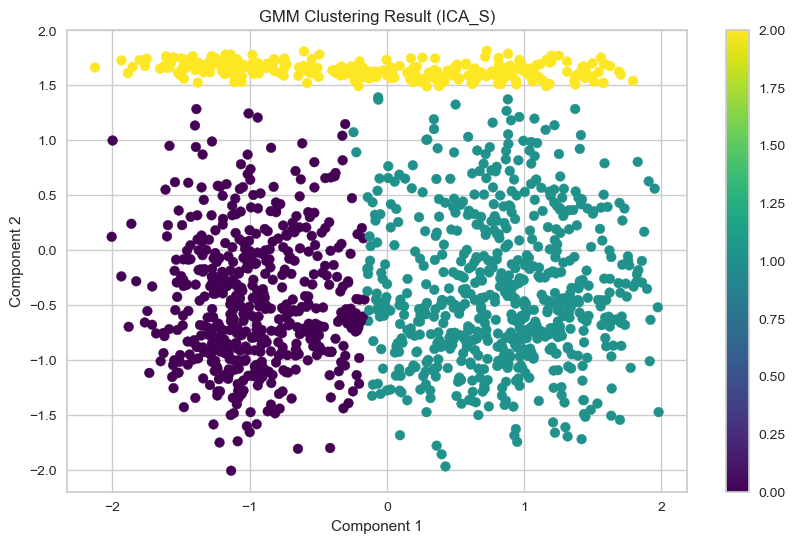

Hierarchical Clustering - Silhouette Score for ICA_S: 0.40837194219634443
Hierarchical Clustering - Davies-Bouldin Index for ICA_S: 0.8290505187852935
Hierarchical Clustering - Calinski-Harabasz Index for ICA_S: 1194.0415866395365


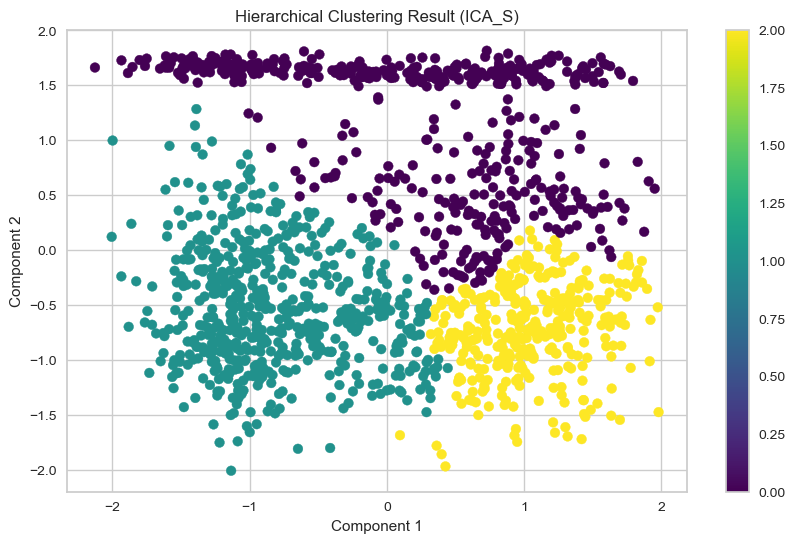

DBSCAN - Insufficient clusters for ICA_S


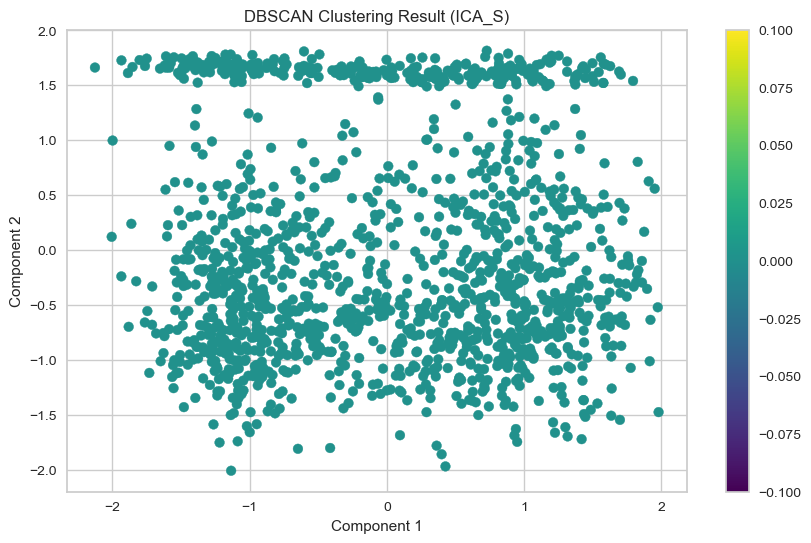

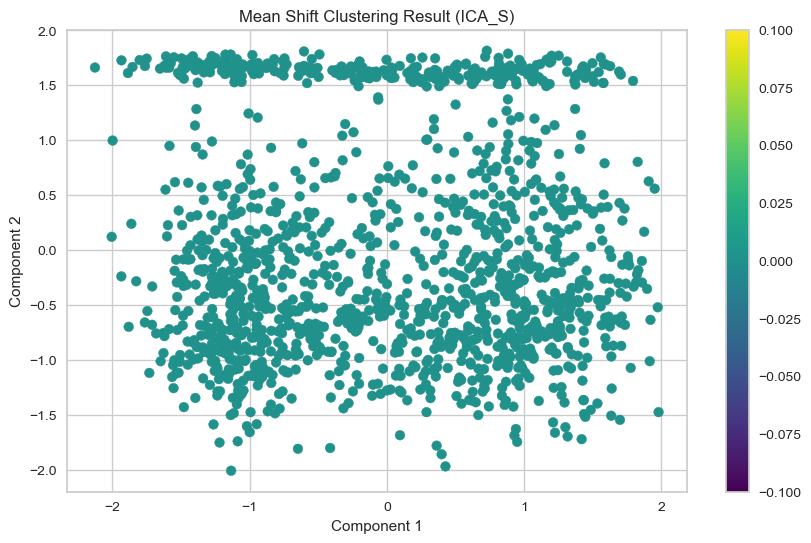

Affinity Propagation - Silhouette Score for ICA_S: 0.2644253899809782
Affinity Propagation - Davies-Bouldin Index for ICA_S: 0.6558922391676435
Affinity Propagation - Calinski-Harabasz Index for ICA_S: 408.23481651375795


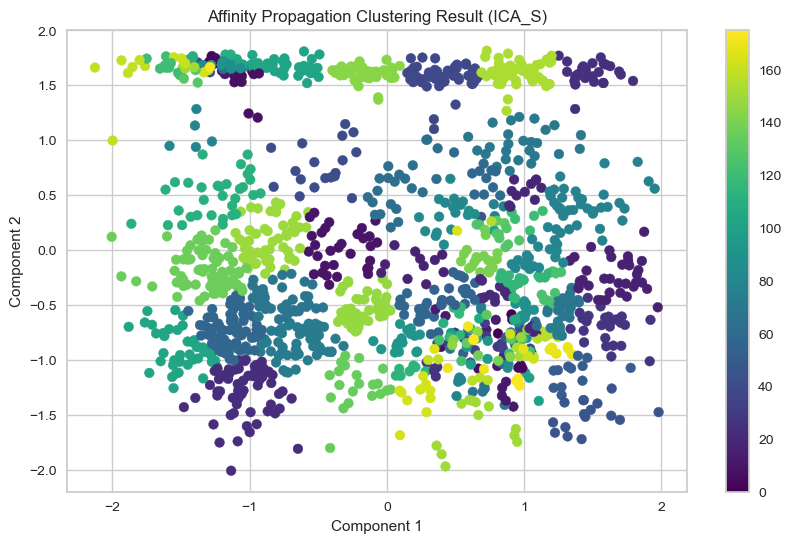

Birch - Silhouette Score for ICA_S: 0.45630754817300867
Birch - Davies-Bouldin Index for ICA_S: 0.7551941375116252
Birch - Calinski-Harabasz Index for ICA_S: 1404.5458957957544


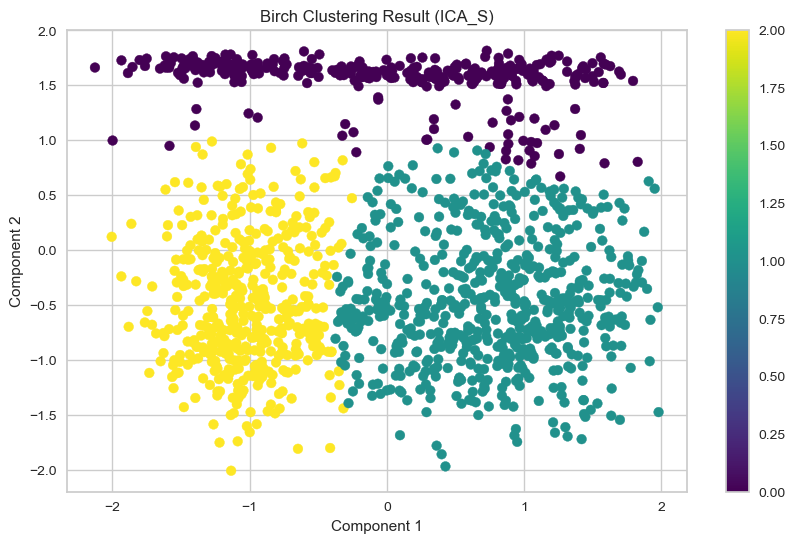

OPTICS - Silhouette Score for ICA_S: -0.16947386014770052
OPTICS - Davies-Bouldin Index for ICA_S: 1.6998149645982654
OPTICS - Calinski-Harabasz Index for ICA_S: 13.969523491025162


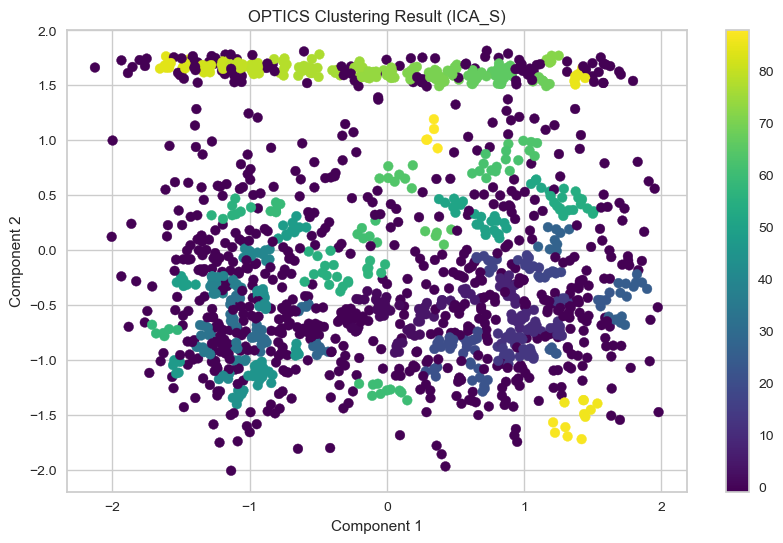

Spectral Clustering - Silhouette Score for ICA_S: 0.47643892442845903
Spectral Clustering - Davies-Bouldin Index for ICA_S: 0.6411028632910557
Spectral Clustering - Calinski-Harabasz Index for ICA_S: 1549.4051437902745


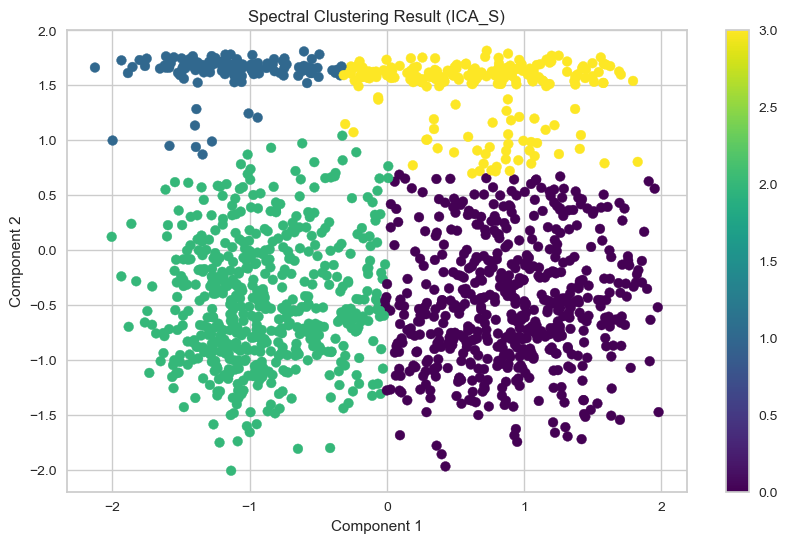

In [ ]:
evaluate_clustering(ica_result_S, 'ICA_S')

In [ ]:
'''
Explanation of Data Quality
Selected Features: Provides specific insights by focusing on key features, which helps in better cluster separation and compactness.
Standard Scaled Features: Ensures that all features contribute equally to the clustering process, enhancing the clustering performance.
MinMax Scaled Features: Scales features to a specific range, which is beneficial for algorithms sensitive to the magnitude of data, like KMeans and DBSCAN, leading to improved clustering results.
'''

'\nExplanation of Data Quality\nSelected Features: Provides specific insights by focusing on key features, which helps in better cluster separation and compactness.\nStandard Scaled Features: Ensures that all features contribute equally to the clustering process, enhancing the clustering performance.\nMinMax Scaled Features: Scales features to a specific range, which is beneficial for algorithms sensitive to the magnitude of data, like KMeans and DBSCAN, leading to improved clustering results.\n'